# Explore the CAZome of _Pectobacterium_ and _Dickeya_ genomes

This notebook explores the size and composition of 200 complete Refseq _Pectobacterium_ and _Dickeya_ CAZomes.

## Table of Contents


**Exploration of the entire CAZome:**  

0. [Imports](#imports)
    * Load packages
    * Load in data
1. [CAZome size](#cazome-size)
    * Compare the number of CAZymes
    * Compare the proportion of the proteome represented by the CAZomes
2. [CAZy classes](#cazy-classes)
    * The number of CAZymes per CAZy class
    * Mean (+/- SD) number of CAZymes per CAZy class per genus
3. [CAZy families](#cazy-families)
    * Calculate CAZy family frequencies per genome
    * Plot a clustermap of CAZy family frequencies
4. [Core CAZome](#core-cazome)
    * Identify families that are present in all genomes
    * Calculate the frequency of families in the core CAZome
    * [_Pectobacterium_](#pecto-core-cazome) core CAZome
    * [_Dickeya_](#dic-core-cazome)
5. [Always co-occurring families](#co-occurring)
    * Identify CAZy families that are always present in the genome together
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus
    * Build an upset plot of co-occurring CAZy families
    * Compile a matrix with the indcidence data for each group of co-occurring CAZy families
6. [Principal Component Analysis (PCA)](#pca)
    * Explore the association between the host range, global distribution and composition of the CAZome
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus
    
        
**Exploration of intracellular and extracellular CAZomes:**
1. [CAZome size](#cazome-size-IE)
    * Compare the number of CAZymes
    * Compare the proportion of the proteome represented by the CAZomes
2. [CAZy classes](#cazy-classes-IE)
    * The number of CAZymes per CAZy class
    * Mean (+/- SD) number of CAZymes per CAZy class per genus
3. [CAZy families](#cazy-families-IE)
    * Calculate CAZy family frequencies per genome
    * Plot a clustermap of CAZy family frequencies
4. [Core CAZome](#core-cazome-IE)
    * Identify families that are present in all genomes
    * Calculate the frequency of families in the core CAZome
    * [_Pectobacterium_](#pecto-core-cazome-IE) core CAZome
    * [_Dickeya_](#dic-core-cazome-IE)
5. [Always co-occurring families](#co-occurring-IE)
    * Identify CAZy families that are always present in the genome together
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus
    * Build an upset plot of co-occurring CAZy families
    * Compile a matrix with the indcidence data for each group of co-occurring CAZy families
6. [Principal Component Analysis (PCA)](#pca-IE)
    * Explore the association between the host range, global distribution and composition of the CAZome
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus


<a id="imports"></a>
## 0. Imports

### Packages

In [1]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import random
import re
import statsmodels.api as sm

from copy import copy
from matplotlib.patches import Patch
from pathlib import Path
import upsetplot
import adjustText
import upsetplot

from Bio import SeqIO
from saintBioutils.utilities.file_io.get_paths import get_file_paths
from saintBioutils.utilities.file_io import make_output_directory
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from statsmodels.formula.api import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd, MultiComparison
from tqdm.notebook import tqdm

%matplotlib inline

In [2]:
# loading and parsing data
from cazomevolve.cazome.explore.parse_data import (
    load_fgp_data,
    load_tax_data,
    add_tax_data_from_tax_df,
    add_tax_column_from_row_index,
)

# functions for exploring the sizes of CAZomes
from cazomevolve.cazome.explore.cazome_sizes import (
    calc_proteome_representation,
    count_items_in_cazome,
    get_proteome_sizes,
)

# explore the frequency of CAZymes per CAZy class
from cazomevolve.cazome.explore.cazy_classes import calculate_class_sizes

# explore the frequencies of CAZy families and identify the co-cazome
from cazomevolve.cazome.explore.cazy_families import (
    build_fam_freq_df,
    build_row_colours,
    build_family_clustermap,
    identify_core_cazome,
    plot_fam_boxplot,
    build_fam_mean_freq_df,
    get_group_specific_fams,
    build_family_clustermap_multi_legend,
)

# functions to identify and explore CAZy families that are always present together
from cazomevolve.cazome.explore.cooccurring_families import (
    identify_cooccurring_fams_corrM,
    calc_cooccuring_fam_freqs,
    identify_cooccurring_fam_pairs,
    add_to_upsetplot_membership,
    build_upsetplot,
    get_upsetplot_grps,
    add_upsetplot_grp_freqs,
    build_upsetplot_matrix,
)

# functions to perform PCA
from cazomevolve.cazome.explore.pca import (
    perform_pca,
    plot_explained_variance,
    plot_scree,
    plot_pca,
    plot_loadings,
)

### Data 

**CAZy family annotations: The GFP file**

Load tab delimited list of cazy families, genomes and protein accessions, by providing the path to the 'gfp file' to `load_gfp_data()`.

Each unique protein-family pair is represented on a separate line. Owing to a protein potentially containing multiple CAZyme domains and thus can be annotated with multiple CAZy families, a single protein can be present on multiple rows in the `gfp_df`.

In [8]:
fgp_file = "../data/cazomes/fam_genome_protein_list"
fgp_df = load_fgp_data(fgp_file)
fgp_df.head(3)

,Family,Genome,Protein
0,GH8,GCF_000365365.1,WP_024104087.1
1,GT51,GCF_000365365.1,WP_024104265.1
2,PL38,GCF_000365365.1,WP_024104266.1


In [4]:
len(set(fgp_df['Protein']))

12487

**Taxonomy data:**

Load in CSV of tax data from generated by `cazevolve_add_taxs`, by providing a path to the file to `load_tax_data()`, and specify which tax ranks (kingdom, phylum, etc.) are included in the CSV file.

In [9]:
tax_csv_path = "../data/cazomes/fg_genome_taxs.csv"
tax_df = load_tax_data(tax_csv_path, genus=True, species=True)
tax_df.head(3)

,Genome,Genus,Species
0,GCF_003382595.2,Pectobacterium,aquaticum
1,GCF_003628695.1,Pectobacterium,parmentieri
2,GCF_000808515.1,Pectobacterium,carotovorum


**Compile all data into a single dataframe:**

Build dataframe of:
* CAZy family annotations
* Genomic accession
* Taxonomic infomration - splitting each taxonomy rank (i.e. ranks) into a separate column. E.g.:
    * Genus
    * Species

In [10]:
fgp_df = add_tax_data_from_tax_df(
    fgp_df,
    tax_df,
    genus=True,
    species=True,
)
fgp_df.head(3)

,Family,Genome,Protein,Genus,Species
0,GH8,GCF_000365365.1,WP_024104087.1,Dickeya,dianthicola
1,GT51,GCF_000365365.1,WP_024104265.1,Dickeya,dianthicola
2,PL38,GCF_000365365.1,WP_024104266.1,Dickeya,dianthicola


<a id="cazome-size"> </a>
# 1. CAZome size

Calculate the number of CAZymes per genome (defined as the number of unique protein accessions per genome).

In total, calculate:
* The number of CAZymes per genome
* The mean number of CAZymes per genome per genus
* The proportion of the proteome represented by the CAZome
* The mean proportion of the proteome represented by the CAZome

Use the `count_items_in_cazome()` function to retrieve the number of CAZymes and the number of CAZy families per genome, and the mean counts per genus.

In [8]:
print(f"The dataset includes {len(set(fgp_df['Family']))} unique CAZy families")

The dataset includes 103 unique CAZy families


In [9]:
# Calculate CAZymes per genome
cazome_sizes_dict, cazome_sizes_df = count_items_in_cazome(fgp_df, 'Protein', 'Genus', round_by=2)
cazome_sizes_df

Gathering CAZy families per genome: 100%|██████████████████████████████████████████████████████████████████████████████████████████| 32975/32975 [00:02<00:00, 15858.23it/s]
Calculating num of Protein per genome and per Genus: 100%|██████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 1317.00it/s]


,Genus,MeanProteins,SdProteins,NumOfGenomes
0,Dickeya,113.57,6.20,90
1,Pectobacterium,111.63,7.39,188
2,Musicola,93.00,1.00,2
3,Hafnia,88.00,0.00,1


In [10]:
# Calculate CAZy families per genome
cazome_fam_dict, cazome_fams_df = count_items_in_cazome(fgp_df, 'Family', 'Genus', round_by=2)
cazome_fams_df

Gathering CAZy families per genome: 100%|██████████████████████████████████████████████████████████████████████████████████████████| 32975/32975 [00:02<00:00, 16175.62it/s]
Calculating num of Family per genome and per Genus: 100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 3644.84it/s]


,Genus,MeanFamilys,SdFamilys,NumOfGenomes
0,Dickeya,60.06,2.98,90
1,Pectobacterium,60.55,2.59,188
2,Musicola,51.00,0.00,2
3,Hafnia,46.00,0.00,1


Identify the total number of CAZymes

In [11]:
print(f"The total number of CAZymes is {len(set(fgp_df['Protein']))}")

# exclude the Hafnia genome because it is an outgroup for the phylotree
pd_gf_df = fgp_df[fgp_df['Genus'] != 'Hafnia']
print(f"The total number of Pectobacterium and Dickeya CAZymes is {len(set(pd_gf_df['Protein']))}")

p_gf_df = fgp_df[fgp_df['Genus'] == 'Pectobacterium']
print(f"The total number of Pectobacterium CAZymes is {len(set(p_gf_df['Protein']))}")

d_gf_df = fgp_df[fgp_df['Genus'] == 'Dickeya']
print(f"The total number of Dickeya CAZymes is {len(set(d_gf_df['Protein']))}")

The total number of CAZymes is 12487
The total number of Pectobacterium and Dickeya CAZymes is 12399
The total number of Pectobacterium CAZymes is 8591
The total number of Dickeya CAZymes is 3710


In [12]:
# Get the size of the proteome (the number of protein acc) per genome
grp = 'Genus'
proteome_dir = "../data/proteomes"
proteome_dict = get_proteome_sizes(proteome_dir, fgp_df, grp)

Getting proteome sizes: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████| 281/281 [00:13<00:00, 21.29it/s]


In [13]:
# Calculate the mean proteome size by genus and the proportion of the proteome represented by the CAZome
proteome_perc_df = calc_proteome_representation(proteome_dict, cazome_sizes_dict, grp, round_by=2)
proteome_perc_df

Calc proteome perc: 100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:00<00:00, 2659.25it/s]


,Genus,MeanProteomeSize,SdProteomeSize,MeanProteomePerc,SdProteomePerc,NumOfGenomes
0,Dickeya,4107.53,140.33,2.76,0.08,90
1,Pectobacterium,4207.19,189.81,2.65,0.11,188
2,Musicola,3877.50,45.50,2.40,0.00,2
3,Hafnia,4297.00,0.00,2.05,0.00,1


Calculate the CAZyme to CAZy family ratio.

In [14]:
cazome_fams_df

,Genus,MeanFamilys,SdFamilys,NumOfGenomes
0,Dickeya,60.06,2.98,90
1,Pectobacterium,60.55,2.59,188
2,Musicola,51.00,0.00,2
3,Hafnia,46.00,0.00,1


## Test for significant difference to the _Pectobacteriaceae_ dataset

This previous analysis using the GenBank genomes of _Pectobacteriaceae_ can be found [here](https://github.com/HobnobMancer/SI_Hobbs_et_al_2023_Pecto).

Screen for genomes in both datasets.

In [15]:
# load data set from previous analysis 
pecto_df = pd.read_csv("../data/pecto_study/proteome_cazome_sizes.csv", index_col="Unnamed: 0")
pecto_df['Dataset'] = ['GenBank'] * len(pecto_df)
pecto_df.head(2)

,Genus,Genome,ProteomeSize,CAZomeSize,PercentageCAZome,NumOfFams,Dataset
0,Pectobacterium,GCA_003382565.3,3910,96,2.455243,60,GenBank
1,Pectobacterium,GCA_013488025.1,4201,117,2.785051,65,GenBank


In [16]:
common_genomes = [genome.replace("GCF_", "GCA_") for genome in fgp_df['Genome'] if genome in list(pecto_df['Genome'])]
len(common_genomes)

0

### Test for differences in proteome size - i.e. number of proteins.

In [17]:
proteome_data = []
for genus in proteome_dict:
    for genome in proteome_dict[genus]:
        proteome_data.append([genus, proteome_dict[genus][genome]['numOfProteins']])
proteome_df = pd.DataFrame(proteome_data, columns=['Genus','NumOfProteins'])
proteome_df['Dataset'] = ['Refseq'] * len(proteome_df)
proteome_df.head(2)

,Genus,NumOfProteins,Dataset
0,Pectobacterium,4363,Refseq
1,Pectobacterium,4212,Refseq


In [18]:
gbk_proteome_df = pecto_df[['Genus','ProteomeSize','Dataset']]
gbk_proteome_df.columns = ['Genus', 'NumOfProteins', 'Dataset']

proteome_df2 = pd.concat([proteome_df, gbk_proteome_df])
proteome_df2 = proteome_df2[proteome_df2['Genus'].isin(['Pectobacterium', 'Dickeya', 'Musicola'])]

for genus in ['Pectobacterium', 'Dickeya', 'Musicola']:
    model = ols('NumOfProteins ~ Dataset', data=proteome_df2[proteome_df2['Genus'] == genus]).fit()
    anova_table = sm.stats.anova_lm(model)
    print(f'{genus}:\n', anova_table, '\n')
    
model = ols('NumOfProteins ~ Dataset', data=proteome_df2).fit()
anova_table = sm.stats.anova_lm(model)
print(f'Complete Dataset:\n', anova_table, '\n')

Pectobacterium:
              df        sum_sq        mean_sq         F    PR(>F)
Dataset     1.0  3.752373e+05  375237.324919  8.565285  0.003552
Residual  618.0  2.707402e+07   43809.089828       NaN       NaN 

Dickeya:
              df        sum_sq        mean_sq          F    PR(>F)
Dataset     1.0  3.010294e+05  301029.408876  13.137932  0.000341
Residual  294.0  6.736421e+06   22912.997678        NaN       NaN 

Musicola:
            df        sum_sq       mean_sq         F    PR(>F)
Dataset   1.0  17480.333333  17480.333333  4.217591  0.109233
Residual  4.0  16578.500000   4144.625000       NaN       NaN 

Complete Dataset:
              df        sum_sq        mean_sq          F    PR(>F)
Dataset     1.0  6.862679e+05  686267.870915  17.626064  0.000029
Residual  920.0  3.582005e+07   38934.834720        NaN       NaN 



### Test for differences in the precentage of the proteome in the CAZome

In [19]:
prot_perc_df_data = []
for genus in cazome_sizes_dict:
    for genome in cazome_sizes_dict[genus]:
        cazome_size = cazome_sizes_dict[genus][genome]['numOfProteins']
        proteome_size = proteome_dict[genus][genome]['numOfProteins']
        percentage = (cazome_size / proteome_size) * 100
        prot_perc_df_data.append([genus, percentage, 'Refseq'])
prot_perc_df = pd.DataFrame(prot_perc_df_data, columns=['Genus','PercentageCAZome','Dataset'])
prot_perc_df.head(2)

,Genus,PercentageCAZome,Dataset
0,Dickeya,2.630932,Refseq
1,Dickeya,2.778437,Refseq


In [20]:
prot_perc_df2 = pd.concat([prot_perc_df, pecto_df[['Genus','PercentageCAZome','Dataset']]])
prot_perc_df2 = prot_perc_df2[prot_perc_df2['Genus'].isin(['Pectobacterium', 'Dickeya', 'Musicola'])]

for genus in ['Pectobacterium', 'Dickeya', 'Musicola']:
    model = ols('PercentageCAZome ~ Dataset', data=prot_perc_df2[prot_perc_df2['Genus'] == genus]).fit()
    anova_table = sm.stats.anova_lm(model)
    print(f'{genus}:\n', anova_table, '\n')
    
model = ols('PercentageCAZome ~ Dataset', data=prot_perc_df2).fit()
anova_table = sm.stats.anova_lm(model)
print(f'Complete Dataset:\n', anova_table, '\n')

Pectobacterium:
              df     sum_sq   mean_sq         F    PR(>F)
Dataset     1.0   0.009888  0.009888  0.525433  0.468808
Residual  618.0  11.629477  0.018818       NaN       NaN 

Dickeya:
              df    sum_sq   mean_sq          F        PR(>F)
Dataset     1.0  0.661959  0.661959  65.513332  1.540597e-14
Residual  294.0  2.970632  0.010104        NaN           NaN 

Musicola:
            df    sum_sq   mean_sq         F    PR(>F)
Dataset   1.0  0.010229  0.010229  4.368303  0.104825
Residual  4.0  0.009367  0.002342       NaN       NaN 

Complete Dataset:
              df     sum_sq   mean_sq          F    PR(>F)
Dataset     1.0   0.299726  0.299726  17.214325  0.000036
Residual  920.0  16.018505  0.017411        NaN       NaN 



### Test for differences in the size of the CAZome - i.e. number of proteins

In [21]:
cazome_data = []
for genus in cazome_sizes_dict:
    for genome in cazome_sizes_dict[genus]:
        cazome_data.append([genus, cazome_sizes_dict[genus][genome]['numOfProteins']])
cazome_df = pd.DataFrame(cazome_data, columns=['Genus','CAZomeSize'])
cazome_df['Dataset'] = ['Refseq'] * len(cazome_df)
cazome_df.head(2)

,Genus,CAZomeSize,Dataset
0,Dickeya,107,Refseq
1,Dickeya,117,Refseq


In [22]:
cazome_df2 = pd.concat([cazome_df, pecto_df[['Genus','CAZomeSize','Dataset']]])
cazome_df2 = cazome_df2[cazome_df2['Genus'].isin(['Pectobacterium', 'Dickeya', 'Musicola'])]

for genus in ['Pectobacterium', 'Dickeya', 'Musicola']:
    model = ols('CAZomeSize ~ Dataset', data=cazome_df2[cazome_df2['Genus'] == genus]).fit()
    anova_table = sm.stats.anova_lm(model)
    print(f'{genus}:\n', anova_table, '\n')
    
model = ols('CAZomeSize ~ Dataset', data=cazome_df2).fit()
anova_table = sm.stats.anova_lm(model)
print(f'Complete Dataset:\n', anova_table, '\n')

Pectobacterium:
              df        sum_sq     mean_sq         F    PR(>F)
Dataset     1.0    134.382936  134.382936  2.180414  0.140286
Residual  618.0  38088.488032   61.631858       NaN       NaN 

Dickeya:
              df        sum_sq     mean_sq         F    PR(>F)
Dataset     1.0    362.726948  362.726948  8.575372  0.003674
Residual  294.0  12435.813592   42.298686       NaN       NaN 

Musicola:
            df  sum_sq  mean_sq         F   PR(>F)
Dataset   1.0    0.75   0.7500  0.131868  0.73488
Residual  4.0   22.75   5.6875       NaN      NaN 

Complete Dataset:
              df        sum_sq    mean_sq         F    PR(>F)
Dataset     1.0      1.228294   1.228294  0.021163  0.884367
Residual  920.0  53395.735915  58.038843       NaN       NaN 



### Test for differences in the number of CAZy families

In [23]:
cazfam_data = []
for genus in cazome_fam_dict:
    for genome in cazome_fam_dict[genus]:
        cazfam_data.append([genus, cazome_fam_dict[genus][genome]['numOfFamilys']])
cazfam_df = pd.DataFrame(cazfam_data, columns=['Genus','NumOfFams'])
cazfam_df['Dataset'] = ['Refseq'] * len(cazfam_df)
cazfam_df.head(2)

,Genus,NumOfFams,Dataset
0,Dickeya,60,Refseq
1,Dickeya,62,Refseq


In [24]:
cazfam_df2 = pd.concat([cazfam_df, pecto_df[['Genus','NumOfFams','Dataset']]])
cazfam_df2 = cazfam_df2[cazfam_df2['Genus'].isin(['Pectobacterium', 'Dickeya', 'Musicola'])]

for genus in ['Pectobacterium', 'Dickeya', 'Musicola']:
    model = ols('NumOfFams ~ Dataset', data=cazfam_df2[cazfam_df2['Genus'] == genus]).fit()
    anova_table = sm.stats.anova_lm(model)
    print(f'{genus}:\n', anova_table, '\n')
    
model = ols('NumOfFams ~ Dataset', data=cazfam_df2).fit()
anova_table = sm.stats.anova_lm(model)
print(f'Complete Dataset:\n', anova_table, '\n')

Pectobacterium:
              df       sum_sq     mean_sq          F        PR(>F)
Dataset     1.0   304.846550  304.846550  29.263941  9.041038e-08
Residual  618.0  6437.792159   10.417139        NaN           NaN 

Dickeya:
              df       sum_sq    mean_sq         F    PR(>F)
Dataset     1.0    63.516593  63.516593  6.920771  0.008969
Residual  294.0  2698.236785   9.177676       NaN       NaN 

Musicola:
            df  sum_sq  mean_sq    F    PR(>F)
Dataset   1.0    0.75   0.7500  4.0  0.116117
Residual  4.0    0.75   0.1875  NaN       NaN 

Complete Dataset:
              df        sum_sq    mean_sq        F    PR(>F)
Dataset     1.0     97.650202  97.650202  8.11126  0.004497
Residual  920.0  11075.738084  12.038846      NaN       NaN 



## Test for statistically significant differences between the genera

In [25]:
make_output_directory(Path('../results/'), force=True, nodelete=True)
make_output_directory(Path('../results/cazome_size'), force=True, nodelete=True)

Output directory ../results exists, nodelete is True. Adding output to output directory.
Output directory ../results/cazome_size exists, nodelete is True. Adding output to output directory.


### Number of proteins in the proteome

In [26]:
genera = ['Pectobacterium','Dickeya','Musicola']

In [27]:
proteome_df = proteome_df[proteome_df['Genus'].isin(genera)]
model = ols('NumOfProteins ~ Genus', data=proteome_df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
Genus,7.801422e+05,2.0,12.638222,0.000006
Residual,8.549438e+06,277.0,NaN,NaN


In [28]:
# statistically significantly differente so run tukey HSD to see which genera differ
proteome_size_turkey = pairwise_tukeyhsd(
    endog=proteome_df['NumOfProteins'],
    groups=proteome_df['Genus'],
    alpha=0.05,   # cut off
)
prot_size_turkey_df = pd.DataFrame(
    proteome_size_turkey._results_table[1:],
    columns=proteome_size_turkey._results_table.data[0]
)
prot_size_turkey_df.to_csv("../results/cazome_size/proteome_size_turkey_results.csv")
prot_size_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-230.0333,0.1613,-525.9929,65.9262,False
1,Dickeya,Pectobacterium,99.6582,0.0,46.5945,152.7218,True
2,Musicola,Pectobacterium,329.6915,0.0237,35.4137,623.9693,True


### Percentage of the proteome in the CAZome

In [29]:
prot_perc_df = prot_perc_df[prot_perc_df['Genus'].isin(genera)]
    
model = ols('PercentageCAZome ~ Genus', data=prot_perc_df).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,0.915057,0.457528,42.748579,6.603287e-17
Residual,277.0,2.964668,0.010703,NaN,NaN


In [30]:
# statistically significantly differente so run tukey HSD to see which genera differ
prot_perc_turkey = pairwise_tukeyhsd(
    endog=prot_perc_df['PercentageCAZome'],
    groups=prot_perc_df['Genus'],
    alpha=0.05,   # cut off
)
prot_perc_turkey_df = pd.DataFrame(
    prot_perc_turkey._results_table[1:],
    columns=prot_perc_turkey._results_table.data[0]
)
prot_perc_turkey_df.to_csv("../results/cazome_size/proteome_perc_turkey_results.csv")
prot_perc_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.3648,0.0,-0.5391,-0.1905,True
1,Dickeya,Pectobacterium,-0.1109,0.0,-0.1421,-0.0796,True
2,Musicola,Pectobacterium,0.2539,0.0019,0.0806,0.4272,True


### CAZome size

In [31]:
cazome_df = cazome_df[cazome_df['Genus'].isin(genera)]

model = ols('CAZomeSize ~ Genus', data=cazome_df).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,964.095897,482.047948,9.721132,0.000083
Residual,277.0,13735.775532,49.587637,NaN,NaN


In [32]:
# statistically significantly differente so run tukey HSD to see which genera differ
cazome_turkey = pairwise_tukeyhsd(
    endog=cazome_df['CAZomeSize'],
    groups=cazome_df['Genus'],
    alpha=0.05,   # cut off
)
cazome_turkey_df = pd.DataFrame(
    cazome_turkey._results_table[1:],
    columns=cazome_turkey._results_table.data[0]
)
cazome_turkey_df.to_csv("../results/cazome_size/cazome_turkey_results.csv")
cazome_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-20.5667,0.0002,-32.4295,-8.7038,True
1,Dickeya,Pectobacterium,-1.9337,0.0833,-4.0606,0.1932,False
2,Musicola,Pectobacterium,18.633,0.0007,6.8375,30.4285,True


### CAZy families

In [33]:
cazfam_df = cazfam_df[cazfam_df['Genus'].isin(genera)]

model = ols('NumOfFams ~ Genus', data=cazfam_df).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,190.234693,95.117346,12.807519,0.000005
Residual,277.0,2057.190307,7.426680,NaN,NaN


In [34]:
# statistically significantly differente so run tukey HSD to see which genera differ
cazfam_turkey = pairwise_tukeyhsd(
    endog=cazfam_df['NumOfFams'],
    groups=cazfam_df['Genus'],
    alpha=0.05,   # cut off
)
cazfam_turkey_df = pd.DataFrame(
    cazfam_turkey._results_table[1:],
    columns=cazfam_turkey._results_table.data[0]
)
cazfam_turkey_df.to_csv("../results/cazome_size/cazome_families_tukey_results.csv")
cazfam_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-9.0556,0.0,-13.6465,-4.4646,True
1,Dickeya,Pectobacterium,0.4976,0.3296,-0.3255,1.3208,False
2,Musicola,Pectobacterium,9.5532,0.0,4.9883,14.118,True


<a id="cazy-classes"> </a>
# 2. CAZy classes

Calculate the number of CAZymes (identified as the number of unique protein accessions) per CAZy class. Also, calculate the mean size of CAZy classes (i.e. the mean number of unique protein accessions per CAZy class in each genome) per genus.

The results are added to a dataframe, which is written to `results/cazy_class_sizes.csv`, and was used to generate a proportiona area plot using [RawGraphs](https://app.rawgraphs.io/).

In [57]:
# make output dir for results, will not delete data if dir already exists
make_output_directory(Path('../results/cazy_classes/'), force=True, nodelete=True)

class_df, class_size_dict = calculate_class_sizes(fgp_df, 'Genus', round_by=2)
filtered_class_df = class_df[class_df['Genus'] != 'Hafnia']
filtered_class_df.to_csv('../results/cazy_classes/cazy_class_sizes.csv')
class_df

Output directory ../results/cazy_classes exists, nodelete is True. Adding output to output directory.


NameError: name 'fgp_df' is not defined

In [90]:
def build_class_freq_df(fgp_df, grp, round_by=None, CAZY_CLASSES = ['GH', 'GT', 'PL', 'CE', 'AA', 'CBM']):
    """Calculate the mean (+- SD) of CAZymes per CAZy class per grp.

    Num of CAZymes is the number of unique protein accessions.

    :param fgp_df: pandas df, columns = ['Family', 'Genome', 'Protein', 'Genus', 'Species']
    :param grp: str, tax rank to group genomes by, e.g. 'Genus' or 'Species'
    :param round_by: int, num of dp to round the mean and sd to, if None does not round

    Return
    * df columns ['CAZyClass', grp, 'MeanCazyClass', 'SdCazyClass', 'NumOfGenomes']
    * dict cazy_class_size_dict
    """
    cazy_class_size_dict = {}  # {genus: {genome: {class: freq}}}

    # calculate total CAZymes per genome - used to calculate the percentage of the cazome
    # made up of each CAZy class
    class_freq_data = {}  # {genus: {genome: {class: freq}}}

    for ri in tqdm(range(len(fgp_df)), desc="Getting CAZy class sizes"):
        prot_id = fgp_df.iloc[ri]['Protein']
        fam = fgp_df.iloc[ri]['Family']
        grp_name = fgp_df.iloc[ri][grp]
        genome = fgp_df.iloc[ri]['Genome']
        cazy_class = re.match(r"\D{2,3}", fam).group()
        
        try:
            class_freq_data[grp_name]
        except KeyError:
            class_freq_data[grp_name] = {}
        
        try:
            class_freq_data[grp_name][genome][cazy_class] += 1
            class_freq_data[grp_name][genome]['CAZymes'].add(prot_id)
        except KeyError:
            class_freq_data[grp_name][genome] = {'GH': 0, 'GT': 0, 'PL': 0, 'CE': 0, 'AA': 0, 'CBM': 0, 'CAZymes': set()}
            class_freq_data[grp_name][genome][cazy_class] += 1
            class_freq_data[grp_name][genome]['CAZymes'].add(prot_id)
    
    cazy_class_data = []
    for grp in class_freq_data:
        for genome in class_freq_data[grp]:
            for cazy_class in class_freq_data[grp][genome]:
                if cazy_class == 'CAZymes':
                    cazy_class_data.append([grp, genome, cazy_class, len(class_freq_data[grp][genome][cazy_class])])
                else:
                    cazy_class_data.append([grp, genome, cazy_class, class_freq_data[grp][genome][cazy_class]])

    cazy_class_df = pd.DataFrame(cazy_class_data, columns=['Group', 'Genome', 'CAZyClass', 'Frequency'])

    return cazy_class_df

In [120]:
def calc_class_means(fgp_df, grp_type, round_by=None, CAZY_CLASSES = ['GH', 'GT', 'PL', 'CE', 'AA', 'CBM']):
    """Calculate the mean (+- SD) of CAZymes per CAZy class per grp.

    Num of CAZymes is the number of unique protein accessions.

    :param fgp_df: pandas df, columns = ['Family', 'Genome', 'Protein', 'Genus', 'Species']
    :param grp: str, tax rank to group genomes by, e.g. 'Genus' or 'Species'
    :param round_by: int, num of dp to round the mean and sd to, if None does not round

    Return
    * df columns ['CAZyClass', grp, 'MeanCazyClass', 'SdCazyClass', 'NumOfGenomes']
    * dict cazy_class_size_dict
    """
    cazy_class_size_dict = {}  # {genus: {genome: {class: freq}}}

    # calculate total CAZymes per genome - used to calculate the percentage of the cazome
    # made up of each CAZy class
    class_freq_data = {}  # {genus: {genome: {class: freq}}}

    for ri in tqdm(range(len(fgp_df)), desc="Getting CAZy class sizes"):
        prot_id = fgp_df.iloc[ri]['Protein']
        fam = fgp_df.iloc[ri]['Family']
        grp_name = fgp_df.iloc[ri][grp_type]
        genome = fgp_df.iloc[ri]['Genome']
        cazy_class = re.match(r"\D{2,3}", fam).group()
        
        try:
            class_freq_data[grp_name]
        except KeyError:
            class_freq_data[grp_name] = {}
        
        try:
            class_freq_data[grp_name][genome][cazy_class] += 1
            class_freq_data[grp_name][genome]['CAZymes'].add(prot_id)
        except KeyError:
            class_freq_data[grp_name][genome] = {'GH': 0, 'GT': 0, 'PL': 0, 'CE': 0, 'AA': 0, 'CBM': 0, 'CAZymes': set()}
            class_freq_data[grp_name][genome][cazy_class] += 1
            class_freq_data[grp_name][genome]['CAZymes'].add(prot_id)
    
    cazy_class_data = []
    for grp in ['Musicola', 'Dickeya', 'Pectobacterium']:
        for genome in class_freq_data[grp]:
            for cazy_class in class_freq_data[grp][genome]:
                if cazy_class == 'CAZymes':
                    cazy_class_data.append([grp, genome, cazy_class, len(class_freq_data[grp][genome][cazy_class])])
                else:
                    cazy_class_data.append([grp, genome, cazy_class, class_freq_data[grp][genome][cazy_class]])

    cazy_class_df = pd.DataFrame(cazy_class_data, columns=['Group', 'Genome', 'CAZyClass', 'Frequency'])

    cazy_class_data = []
    for grp in ['Musicola', 'Dickeya', 'Pectobacterium']:
        grp_rows = cazy_class_df[cazy_class_df['Group'] == grp]
        for cazy_class in CAZY_CLASSES:
            grp_class_rows = grp_rows[grp_rows['CAZyClass'] == cazy_class]

            freqs = []  # freqs of cazy clsses for this genus
            percs = []

            for ri in range(len(grp_class_rows)):
                freq = grp_class_rows.iloc[ri]['Frequency']
                genome = grp_class_rows.iloc[ri]['Genome']
                cazyme_count = grp_rows[(grp_rows['Genome'] == genome) & (grp_rows['CAZyClass'] == 'CAZymes')].iloc[0]['Frequency']
                perc = (freq / cazyme_count) * 100

                freqs.append(freq)
                percs.append(perc)

            freqs = list(grp_class_rows['Frequency'])

            genus_mean_class_freq = np.mean(freqs)
            genus_mean_class_prec = np.mean(percs)

            genus_sd_class_freq = np.std(freqs)
            genus_sd_class_prec = np.std(percs)

            if round_by is not None:
                genus_mean_class_freq = round(genus_mean_class_freq, round_by)
                genus_mean_class_prec = round(genus_mean_class_prec, round_by)
                genus_sd_class_freq = round(genus_sd_class_freq, round_by)
                genus_sd_class_prec = round(genus_sd_class_prec, round_by)

            cazy_class_data.append(
                [cazy_class, grp,
                 genus_mean_class_freq, genus_sd_class_freq,
                 genus_mean_class_prec, genus_sd_class_prec,
                 len(set(grp_rows['Genome']))]
            )

    col_names = ['CAZyClass', grp_type, 'MeanCazyClass', 'SdCazyClass', 'MeanClassPerc', 'SdClassPerc', 'NumOfGenomes']
    class_df = pd.DataFrame(cazy_class_data, columns=col_names)
    
    return class_df, class_freq_data

In [121]:
class_mean_df, class_freq_dict = calc_class_means(fgp_df, 'Genus', round_by=2)
class_mean_df = class_mean_df[class_mean_df['Genus'] != 'Hafnia']
class_mean_df.to_csv('../results/cazy_classes/cazy_class_sizes.csv')
class_mean_df

Getting CAZy class sizes:   0%|          | 0/32975 [00:00<?, ?it/s]

,CAZyClass,Genus,MeanCazyClass,SdCazyClass,MeanClassPerc,SdClassPerc,NumOfGenomes
0,GH,Musicola,36.00,1.00,38.70,0.66,2
1,GT,Musicola,35.00,0.00,37.64,0.40,2
2,PL,Musicola,12.00,0.00,12.90,0.14,2
3,CE,Musicola,6.00,0.00,6.45,0.07,2
4,AA,Musicola,0.00,0.00,0.00,0.00,2
5,CBM,Musicola,8.00,0.00,8.60,0.09,2
6,GH,Dickeya,42.14,3.60,37.09,2.09,90
7,GT,Dickeya,40.93,3.34,36.09,2.84,90
8,PL,Dickeya,16.96,1.71,14.92,1.27,90
9,CE,Dickeya,7.02,0.68,6.19,0.56,90


In [135]:
class_freq_df = build_class_freq_df(fgp_df, 'Genus', round_by=None)
class_freq_df = class_freq_df[class_freq_df['CAZyClass'] != 'CAZymes']
class_freq_df.columns = ['Genus', 'Genome', 'CAZyClass', 'Frequency']
class_freq_df = class_freq_df[class_freq_df['Genus'] != 'Hafnia']
class_freq_df.head(3)

Getting CAZy class sizes:   0%|          | 0/32975 [00:00<?, ?it/s]

,Genus,Genome,CAZyClass,Frequency
0,Dickeya,GCF_000365365.1,GH,44
1,Dickeya,GCF_000365365.1,GT,34
2,Dickeya,GCF_000365365.1,PL,15


## ANOVAs test for significant differeces between CAZy class frequencies

### Two-way ANOVA

In [136]:
model = ols('Frequency ~ CAZyClass * Genus', data=class_freq_df).fit()
anova_table = sm.stats.anova_lm(model, typ=2)
anova_table

,sum_sq,df,F,PR(>F)
CAZyClass,453033.335714,5.0,18199.341776,0.000000e+00
Genus,145.459777,2.0,14.608595,5.136755e-07
CAZyClass:Genus,6542.252465,10.0,131.408308,4.278632e-202
Residual,8274.380615,1662.0,NaN,NaN


In [137]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df['Frequency'],
    groups=class_freq_df['CAZyClass'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,AA,CBM,10.1714,0.0,9.4506,10.8923,True
1,AA,CE,6.4357,0.0,5.7148,7.1566,True
2,AA,GH,46.1571,0.0,45.4363,46.878,True
3,AA,GT,35.375,0.0,34.6541,36.0959,True
4,AA,PL,15.0464,0.0,14.3256,15.7673,True
5,CBM,CE,-3.7357,0.0,-4.4566,-3.0148,True
6,CBM,GH,35.9857,0.0,35.2648,36.7066,True
7,CBM,GT,25.2036,0.0,24.4827,25.9244,True
8,CBM,PL,4.875,0.0,4.1541,5.5959,True
9,CE,GH,39.7214,0.0,39.0006,40.4423,True


### _Pectobacterium_

In [98]:
class_freq_df_pec = class_freq_df[class_freq_df['Genus'] == 'Pectobacterium']

model = ols('Frequency ~ CAZyClass', data=class_freq_df_pec).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
CAZyClass,5.0,315387.432624,63077.486525,12537.420751,0.0
Residual,1122.0,5644.936170,5.031137,NaN,NaN


In [99]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_pec['Frequency'],
    groups=class_freq_df_pec['CAZyClass'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_pec_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,AA,CBM,10.2926,0.0,9.6321,10.953,True
1,AA,CE,6.4096,0.0,5.7492,7.07,True
2,AA,GH,48.4362,0.0,47.7757,49.0966,True
3,AA,GT,32.9681,0.0,32.3077,33.6285,True
4,AA,PL,14.4149,0.0,13.7545,15.0753,True
5,CBM,CE,-3.883,0.0,-4.5434,-3.2226,True
6,CBM,GH,38.1436,0.0,37.4832,38.804,True
7,CBM,GT,22.6755,0.0,22.0151,23.336,True
8,CBM,PL,4.1223,0.0,3.4619,4.7828,True
9,CE,GH,42.0266,0.0,41.3662,42.687,True


In [132]:
aa_genomes = set()
non_aa_genomes = set()
for genome in set(class_freq_df_pec['Genome']):
    aa_freq = class_freq_df_pec[(
        class_freq_df_pec['Genome'] == genome
    ) & (
        class_freq_df_pec['CAZyClass'] == 'AA'
    )]['Frequency'].values
    if aa_freq[0] == 0:
        non_aa_genomes.add(genome)
    else:
        aa_genomes.add(genome)
print(len(aa_genomes), len(non_aa_genomes), ((len(non_aa_genomes) / len(set(class_freq_df_pec['Genome'])))*100))

150 38 20.212765957446805


### _Dickeya_

In [100]:
class_freq_df_dic = class_freq_df[class_freq_df['Genus'] == 'Dickeya']

model = ols('Frequency ~ CAZyClass', data=class_freq_df_dic).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
CAZyClass,5.0,141794.488889,28358.897778,5763.64286,0.0
Residual,534.0,2627.444444,4.920308,NaN,NaN


In [101]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_dic['Frequency'],
    groups=class_freq_df_dic['CAZyClass'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_dic_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,AA,CBM,9.9667,0.0,9.0209,10.9124,True
1,AA,CE,6.5,0.0,5.5543,7.4457,True
2,AA,GH,41.6222,0.0,40.6765,42.568,True
3,AA,GT,40.4111,0.0,39.4654,41.3568,True
4,AA,PL,16.4333,0.0,15.4876,17.3791,True
5,CBM,CE,-3.4667,0.0,-4.4124,-2.5209,True
6,CBM,GH,31.6556,0.0,30.7098,32.6013,True
7,CBM,GT,30.4444,0.0,29.4987,31.3902,True
8,CBM,PL,6.4667,0.0,5.5209,7.4124,True
9,CE,GH,35.1222,0.0,34.1765,36.068,True


In [130]:
aa_genomes = set()
non_aa_genomes = set()
for genome in set(class_freq_df_dic['Genome']):
    aa_freq = class_freq_df_dic[(class_freq_df_dic['Genome'] == genome) & (class_freq_df_dic['CAZyClass'] == 'AA')]['Frequency'].values
    if aa_freq[0] == 0:
        non_aa_genomes.add(genome)
    else:
        aa_genomes.add(genome)
print(len(aa_genomes), len(non_aa_genomes), ((len(non_aa_genomes) / len(set(class_freq_df_dic['Genome'])))*100))

0 43 47.77777777777778


### _Musicola_

In [104]:
class_freq_df_mus = class_freq_df[class_freq_df['Genus'] == 'Musicola']

model = ols('Frequency ~ CAZyClass', data=class_freq_df_mus).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
CAZyClass,5.0,2393.666667,478.733333,1436.2,3.814803e-09
Residual,6.0,2.000000,0.333333,NaN,NaN


In [105]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_mus['Frequency'],
    groups=class_freq_df_mus['CAZyClass'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_mus_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,AA,CBM,8.0,0.0001,5.7022,10.2978,True
1,AA,CE,6.0,0.0004,3.7022,8.2978,True
2,AA,GH,36.0,0.0,33.7022,38.2978,True
3,AA,GT,35.0,0.0,32.7022,37.2978,True
4,AA,PL,12.0,0.0,9.7022,14.2978,True
5,CBM,CE,-2.0,0.0874,-4.2978,0.2978,False
6,CBM,GH,28.0,0.0,25.7022,30.2978,True
7,CBM,GT,27.0,0.0,24.7022,29.2978,True
8,CBM,PL,4.0,0.0035,1.7022,6.2978,True
9,CE,GH,30.0,0.0,27.7022,32.2978,True


## GH one-way ANOVA

In [141]:
class_freq_df_gh = class_freq_df[class_freq_df['CAZyClass'] == 'GH']
class_freq_df_gh = class_freq_df_gh[class_freq_df_gh['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_gh).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,3301.491912,1650.745956,137.837882,2.826798e-42
Residual,277.0,3317.350946,11.975996,NaN,NaN


In [142]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_gh['Frequency'],
    groups=class_freq_df_gh['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GH_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-6.1444,0.0361,-11.9743,-0.3146,True
1,Dickeya,Pectobacterium,7.0949,0.0,6.0497,8.1402,True
2,Musicola,Pectobacterium,13.2394,0.0,7.4426,19.0361,True


## GT one-way ANOVA

In [143]:
class_freq_df_gt = class_freq_df[class_freq_df['CAZyClass'] == 'GT']
class_freq_df_gt = class_freq_df_gt[class_freq_df_gt['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_gt).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,3124.345821,1562.17291,111.85014,2.465573e-36
Residual,277.0,3868.764894,13.96666,NaN,NaN


In [139]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_gt['Frequency'],
    groups=class_freq_df_gt['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GT_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-5.9333,0.0695,-12.2291,0.3624,False
1,Dickeya,Pectobacterium,-7.1621,0.0,-8.2908,-6.0333,True
2,Musicola,Pectobacterium,-1.2287,0.8888,-7.4887,5.0313,False


## PL one-way ANOVA

In [146]:
class_freq_df_pl = class_freq_df[class_freq_df['CAZyClass'] == 'PL']
class_freq_df_pl = class_freq_df_pl[class_freq_df_pl['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_pl).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,212.115696,106.057848,49.803328,3.333965e-19
Residual,277.0,589.880733,2.129533,NaN,NaN


In [147]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_pl['Frequency'],
    groups=class_freq_df_pl['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_PL_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-4.9556,0.0,-7.4139,-2.4972,True
1,Dickeya,Pectobacterium,-1.7375,0.0,-2.1782,-1.2967,True
2,Musicola,Pectobacterium,3.2181,0.006,0.7737,5.6625,True


## CE one-way ANOVA

In [150]:
class_freq_df_ce = class_freq_df[class_freq_df['CAZyClass'] == 'CE']
class_freq_df_ce = class_freq_df_ce[class_freq_df_ce['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_ce).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,4.840797,2.420399,3.328207,0.037297
Residual,277.0,201.444917,0.727238,NaN,NaN


In [151]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_ce['Frequency'],
    groups=class_freq_df_ce['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CE_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-1.0222,0.216,-2.4588,0.4144,False
1,Dickeya,Pectobacterium,0.1905,0.1911,-0.067,0.4481,False
2,Musicola,Pectobacterium,1.2128,0.114,-0.2157,2.6412,False


## AA one-way ANOVA

In [152]:
class_freq_df_aa = class_freq_df[class_freq_df['CAZyClass'] == 'AA']
class_freq_df_aa = class_freq_df_aa[class_freq_df_aa['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_aa).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,5.812074,2.906037,14.859112,7.413376e-07
Residual,277.0,54.173641,0.195573,NaN,NaN


In [153]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_aa['Frequency'],
    groups=class_freq_df_aa['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_AA_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.5222,0.2259,-1.2672,0.2228,False
1,Dickeya,Pectobacterium,0.281,0.0,0.1474,0.4145,True
2,Musicola,Pectobacterium,0.8032,0.0299,0.0624,1.544,True


## CBM one-way ANOVA

In [148]:
class_freq_df_cbm = class_freq_df[class_freq_df['CAZyClass'] == 'CBM']
class_freq_df_cbm = class_freq_df_cbm[class_freq_df_cbm['Genus'] != 'Hafnia']
model = ols('Frequency ~ Genus', data=class_freq_df_cbm).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,39.105944,19.552972,22.31031,1.038293e-09
Residual,277.0,242.765485,0.876410,NaN,NaN


In [149]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=class_freq_df_cbm['Frequency'],
    groups=class_freq_df_cbm['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CBM_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-2.4889,0.0007,-4.066,-0.9118,True
1,Dickeya,Pectobacterium,0.6069,0.0,0.3241,0.8896,True
2,Musicola,Pectobacterium,3.0957,0.0,1.5276,4.6639,True


<a id="cazy-families"> </a>
# 3. CAZy families

### CAZy family frequency dataframe

Calculate the number of CAZymes per CAZy family presented in each genome, where the number of CAZymes is the number of unqiue protein accessions. This value may be greater than the number of CAZymes in the genome because a CAZyme may be annotated with multiple CAZy families.

In [11]:
fam_freq_df = build_fam_freq_df(fgp_df, ['Genus', 'Species'])
make_output_directory(Path('../results/cazy_families/'), force=True, nodelete=True)
fam_freq_df.to_csv("../results/cazy_families/cazy_fam_freqs.csv")
fam_freq_df

The dataset contains 103 CAZy families


Counting fam frequencies: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 281/281 [00:11<00:00, 24.48it/s]
Output directory ../results/cazy_families exists, nodelete is True. Adding output to output directory.


,Genome,Genus,Species,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
0,GCF_003628715.1,Pectobacterium,parmentieri,0,0,1,1,1,0,0,...,0,0,2,1,1,1,0,1,1,2
1,GCF_001187965.2,Dickeya,fangzhongdai,0,1,2,0,0,0,1,...,0,0,1,1,1,2,0,1,1,3
2,GCF_016944315.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,...,0,0,2,1,1,2,0,1,1,2
3,GCF_016950195.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,...,1,0,2,1,1,2,0,1,1,2
4,GCF_013488025.1,Pectobacterium,carotovorum,0,1,1,1,1,0,0,...,0,0,2,1,1,2,0,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
276,GCF_003932035.1,Pectobacterium,versatile A,0,1,1,1,1,0,0,...,0,0,2,1,1,2,0,1,1,2
277,GCF_016949215.1,Pectobacterium,brasiliense A,0,1,1,1,1,0,0,...,0,0,2,1,1,1,0,1,1,2
278,GCF_000808295.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,...,0,0,2,1,0,2,0,1,1,2
279,GCF_002904105.1,Pectobacterium,carotovorum,0,1,1,1,1,0,0,...,1,0,2,1,1,2,0,1,1,2


Look at the number of families for each genus, and for AA the number of genomes the families are present in.

In [17]:
aa_families = [_ for _ in fam_freq_df.columns if _.startswith('AA')]
aa_families

['AA10', 'AA3']

In [18]:
set(fam_freq_df['AA10'])

{0, 1}

In [19]:
set(fam_freq_df['AA3'])

{0, 1}

In [20]:
aa_dict = {}  # {genus: {AA10: int, AA3: int, 'both': int}}
for ri in range(len(fam_freq_df)):
    genus = fam_freq_df.iloc[ri]['Genus']
    try:
        aa_dict[genus]
    except KeyError:
        aa_dict[genus] = {'AA10': 0, 'AA3': 0, 'both': 0}
    for aa in aa_families:
        if fam_freq_df.iloc[ri][aa] != 0:
            aa_dict[genus][aa] += 1
    if (fam_freq_df.iloc[ri]['AA10'] != 0) and (fam_freq_df.iloc[ri]['AA3'] != 0):
        print(fam_freq_df.iloc[ri]['Genome'], fam_freq_df.iloc[ri]['Genus'], fam_freq_df.iloc[ri]['Species'])
        aa_dict[genus]['both'] += 1
aa_dict

GCF_000738125.1 Pectobacterium brasiliense


{'Dickeya': {'AA10': 0, 'AA3': 47, 'both': 0},
 'Pectobacterium': {'AA10': 2, 'AA3': 149, 'both': 1},
 'Musicola': {'AA10': 0, 'AA3': 0, 'both': 0},
 'Hafnia': {'AA10': 0, 'AA3': 0, 'both': 0}}

In [21]:
for cazy_class in ['GH', 'GT', 'PL', 'CE', 'AA', 'CBM']:
    class_families = aa_families = [_ for _ in fam_freq_df.columns if _.startswith(cazy_class)]
    print(f"{len(class_families)} families from CAZy class {cazy_class} overall")
    for genus in set(fam_freq_df['Genus']):
        class_families = []
        genus_df = fam_freq_df[fam_freq_df['Genus'] == genus]
        for col in genus_df.columns:
            if col.startswith(cazy_class):
                if {0} != set(genus_df[col]):
                    class_families.append(col)
        print(f"For {genus}: {len(class_families)} families from CAZy class {cazy_class} overall")

44 families from CAZy class GH overall
For Hafnia: 22 families from CAZy class GH overall
For Musicola: 22 families from CAZy class GH overall
For Dickeya: 33 families from CAZy class GH overall
For Pectobacterium: 38 families from CAZy class GH overall
28 families from CAZy class GT overall
For Hafnia: 16 families from CAZy class GT overall
For Musicola: 15 families from CAZy class GT overall
For Dickeya: 19 families from CAZy class GT overall
For Pectobacterium: 27 families from CAZy class GT overall
12 families from CAZy class PL overall
For Hafnia: 2 families from CAZy class PL overall
For Musicola: 5 families from CAZy class PL overall
For Dickeya: 10 families from CAZy class PL overall
For Pectobacterium: 10 families from CAZy class PL overall
7 families from CAZy class CE overall
For Hafnia: 3 families from CAZy class CE overall
For Musicola: 6 families from CAZy class CE overall
For Dickeya: 7 families from CAZy class CE overall
For Pectobacterium: 6 families from CAZy class CE

## Clustermaps

Build clustermap of CAZy family frequencies, with additional row colours marking the genus classification of each genome (i.e. each row).

**Prepare the dataframe of CAZy family frequencies:**

In this case, also exclude the _Hafnia_ genome because it was used as an out group for the phylogenetic tree.

In [14]:
# Drop Hafnia genome
fam_freq_df_pd = copy(fam_freq_df)
fam_freq_df_pd = fam_freq_df_pd[fam_freq_df_pd['Genus'] != 'Hafnia']
fam_freq_df_pd.head(1)

,Genome,Genus,Species,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
0,GCF_003628715.1,Pectobacterium,parmentieri,0,0,1,1,1,0,0,...,0,0,2,1,1,1,0,1,1,2


Additionally, index `fam_freq_df` so that each row name contains the genome, Genus and Species, so that the genomic accession, genus and species is included in the clustermap.

In [15]:
# index the taxonomy data and genome (ggs=genome_genus_species)
fam_freq_df_ggs = copy(fam_freq_df_pd)  # so does not alter fam_freq_df
fam_freq_df_ggs = fam_freq_df_ggs.set_index(['Genome','Genus','Species'])
fam_freq_df_ggs.head(1)

,,,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,CBM48,CBM5,CBM50,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
Genome,Genus,Species,,,,,,,,,,,,,,,,,,,,,
GCF_003628715.1,Pectobacterium,parmentieri,0,0,1,1,1,0,0,2,0,5,...,0,0,2,1,1,1,0,1,1,2


**Colour scheme:**

Define a colour scheme to colour code the rows by, in this case by the genus of the species.

To do this, add a column containing the data to be used to colour code each row, e.g. a genus. This extra column is removed by `build_row_colours()`. The dataframe that is parsed to `build_row_colours()` must be the dataframe that is used to generate a clustermap, otherwise Seaborn will not be able to map the row oclours correctly and no row colours will be produced.

In [24]:
# define a colour scheme to colour code rows by genus
fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus'])  # add column to use for colour scheme, is removed
fam_freq_genus_row_colours, fam_g_lut = build_row_colours(fam_freq_df_ggs, 'Genus', 'Set2')

**Build a clustermap of CAZy family frequencies:**

Use the function `build_family_clustermap()` from `cazomevolve` to build clustermaps of the CAZy family frequencies, with different combinations of additional row colours. For example, the row colours could list the genus and/or species classification of each genome.

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


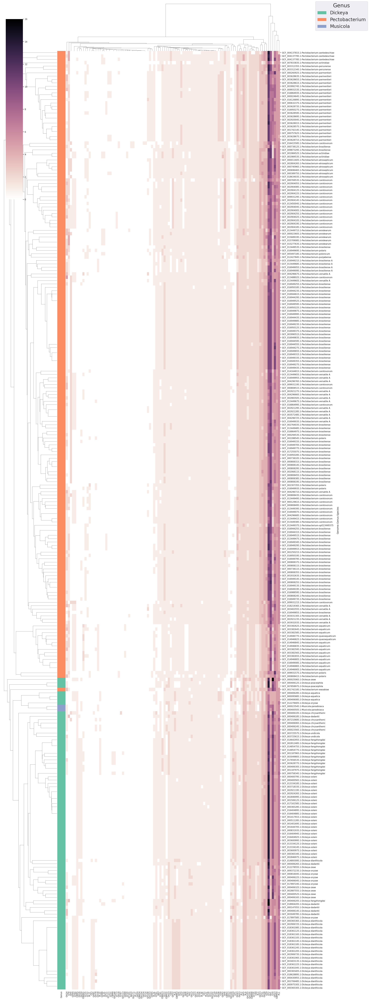

In [25]:
# make a figure that is full size, and all data is legible
build_family_clustermap(
    fam_freq_df_ggs,
    row_colours=fam_freq_genus_row_colours,
    fig_size=(25,73),
    file_path="../results/cazy_families/pd_fam_freq_clustermap.svg",
    file_format='svg',
    lut=fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.2,0.05),
    title_fontsize=28,
    legend_fontsize=24,
)

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


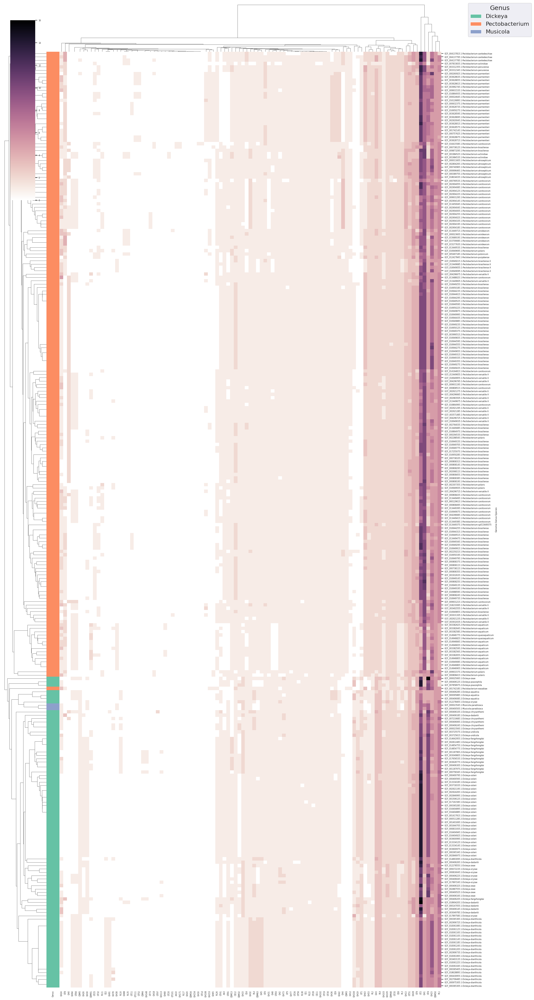

In [26]:
# make a figure the optimal size to fit in a paper
build_family_clustermap(
    fam_freq_df_ggs,
    row_colours=fam_freq_genus_row_colours,
    fig_size=(20,40),
    file_path="../results/cazy_families/paper_pd_fam_freq_clustermap.png",
    file_format='png',
    font_scale=0.5,
    lut=fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
)

### Add species classifications

Looking at the species names in the clustermap, there appears to be clustering of the genomes in a manner that correlates not only with their genus classificaiton but also their species classification. Therefore, add an additional row of row-colours, marking the species classification of each genome.

In [27]:
# define a colour scheme to colour code rows by SPECIES
fam_freq_df_ggs['Species'] = list(fam_freq_df_pd['Species'])  # add column to use for colour scheme, is removed
fam_freq_species_row_colours, fam_s_lut = build_row_colours(fam_freq_df_ggs, 'Species', 'rainbow')

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


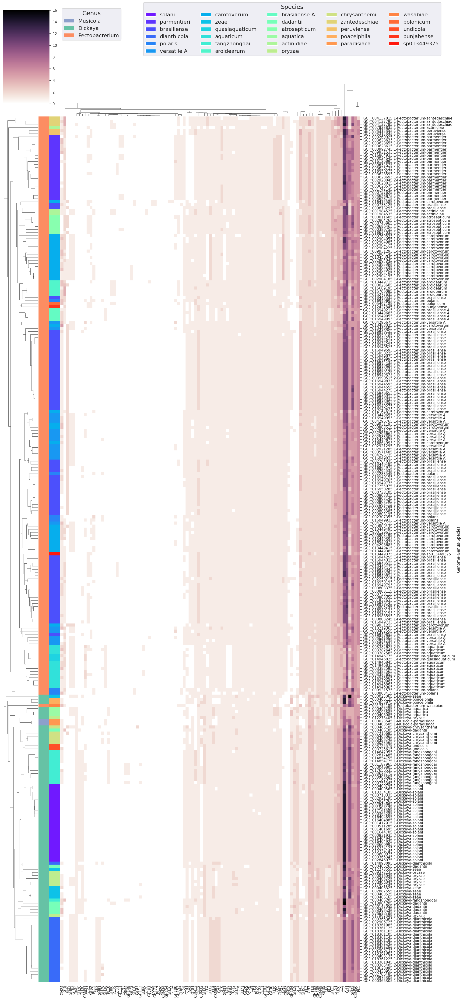

In [28]:
# make a figure the optimal size to fit in a paper
build_family_clustermap_multi_legend(
    df=fam_freq_df_ggs,
    row_colours=[fam_freq_genus_row_colours,fam_freq_species_row_colours],
    luts=[fam_g_lut, fam_s_lut],
    legend_titles=['Genus', 'Species'],
    bbox_to_anchors=[(0.2,1.045), (0.63,1.04)],
    legend_cols=[1,5],
    fig_size=(20,40),
    file_path="../results/cazy_families/paper_pd_genus_species_fam_freq_clustermap.png",
    file_format='png',
    font_scale=1,
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
    cbar_pos=(0.01, 0.96, 0.1, 0.1),  #left, bottom, width, height
)

In [29]:
# make a figure the optimal size to fit in a paper
build_family_clustermap_multi_legend(
    df=fam_freq_df_ggs,
    row_colours=[fam_freq_genus_row_colours,fam_freq_species_row_colours],
    luts=[fam_g_lut, fam_s_lut],
    legend_titles=['Genus', 'Species'],
    bbox_to_anchors=[(0.2,1.05), (0.63,1.05)],
    legend_cols=[1,5],
    fig_size=(60,90),
    file_path="../results/cazy_families/pd_genus_species_fam_freq_clustermap.pdf",
    file_format='pdf',
    font_scale=1,
    dendrogram_ratio=(0.1,0.03),
    title_fontsize=35,
    legend_fontsize=33,
    cbar_pos=(0.01, 0.98, 0.1, 0.08),  #left, bottom, width, height
)

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


### Genus specific CAZy families

Identify CAZy families that are only present in one group, e.g. one Genus, using the function `get_group_specific_fams` from `cazomevolve`.

Specifically, `get_group_specific_fams` returns two `dicts`:
1. Group specific families: `{group: {only unique fams}}`
2. All families per group: `{group: {all fams}}`

In [30]:
all_families = list(fam_freq_df_pd.columns)[3:]
# dict {group: {only unique fams}} and dict {group: {all fams}}
unique_grp_fams, group_fams = get_group_specific_fams(fam_freq_df_pd, 'Genus', all_families)
unique_grp_fams

Identifying Genus specific fams: 100%|█████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 15807.68it/s]


{'Dickeya': {'CBM4', 'CE2', 'GH113', 'GH148', 'GH26', 'GH91', 'GT97', 'PL10'},
 'Pectobacterium': {'AA10',
  'CBM3',
  'GH108',
  'GH12',
  'GH153',
  'GH16',
  'GH171',
  'GH18',
  'GH65',
  'GH68',
  'GT101',
  'GT11',
  'GT111',
  'GT14',
  'GT20',
  'GT25',
  'GT32',
  'GT52',
  'GT73',
  'PL11'}}

## Plot rare faction curves

Explore if CAZome saturation in terms of CAZy families has been found but plotting rare faction curves. Additionally, add on the data from the _Pectobacteriaceae_ data set to compare richness of the CAZome in terms of CAZy families between the GenBank and Refseq data sets.

In [74]:
def plot_rarefaction_curve(
    df,
    all_families,
    num_of_runs=100,
):
    """Build rare faction curve
    
    :param df: pandas df, cazy fam freq df
    :param all_families: list of CAZy families to be analysed
    :param num_of_runs: number of times to resample dataset
    
    Return 
    * rare faction plot
    * df of the number of families added with new additional genome
    * df of number of families in total fam pool with each additional genome
    """
    genomes = list(df['Genome'])
    
    run_outputs_addings = {}  # num of run: [num of new fams found ADDED a new genome to the pool]
    run_outputs_counts = {}  # num of run: [num of unique fams in total fam pool after adding a new genome to the pool]

    for run in tqdm(range(num_of_runs), desc="Counting added families"):
        random.shuffle(genomes)
        fams_to_parse = set(copy(all_families))

        num_added_families = [0]  # one item for each genome, int, num of new families added
        family_pool_size = [0]  # number of unqiue fams seen after adding each genome to the pool
        families = set()  # to track which families have been seen

        for genome in genomes:
            fams_added = 0  # num of fams added to total pool for this genome

            genome_row = df[df['Genome'] == genome]
            for fam in fams_to_parse:
                if genome_row[fam].values[0] > 0:  # fam in genome
                    if fam not in families:
                        fams_added += 1
                        families.add(fam)

            # parsed all families
            
            # record number of new families found in this genome
            num_added_families.append(fams_added)
            
            # record number of unique fams seen after analysing genomes so far
            family_pool_size.append(len(families))
            
            # find which families are in fams_to_parse but are not in families
            # do not reparse fams that have already been found
            fams_to_parse = fams_to_parse.difference(families)

        # parsed all genomes
        run_outputs_addings[run] = num_added_families
        run_outputs_counts[run] = family_pool_size

    run_outputs_df_addings = pd.DataFrame(run_outputs_addings)    
    run_outputs_df_counts = pd.DataFrame(run_outputs_counts)
    
    # calculate the averages
    run_count_avg = []  # avg num of fams after adding each genome
    genomes = list(range(1, len(run_outputs_df_counts)+1))
    for i in range(len(run_outputs_df_counts)):
        run_count_avg.append(np.mean(run_outputs_df_counts.iloc[i]))
        genomes.append
    run_avg_df = pd.DataFrame(
        {
            'Number of CAZy families': run_count_avg,
            'Number of genomes': genomes,
        }
    )
    
    # Generate plot
    # subplot 1 = all runs
    # subplot 2 = averages of all runs
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 7.5))

    #add DataFrames to subplots
    run_outputs_df_counts.plot(
        ax=axes[0],
        xlabel='Number of genomes',
        ylabel='Number of CAZy families',
        legend=False,
    );
    
    run_avg_df.plot(
        ax=axes[1],
        x='Number of genomes',
        y='Number of CAZy families',
        legend=False,
    );

    return fig, run_outputs_df_addings, run_outputs_df_counts

Build curve for all genomes in this refseq data set.

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

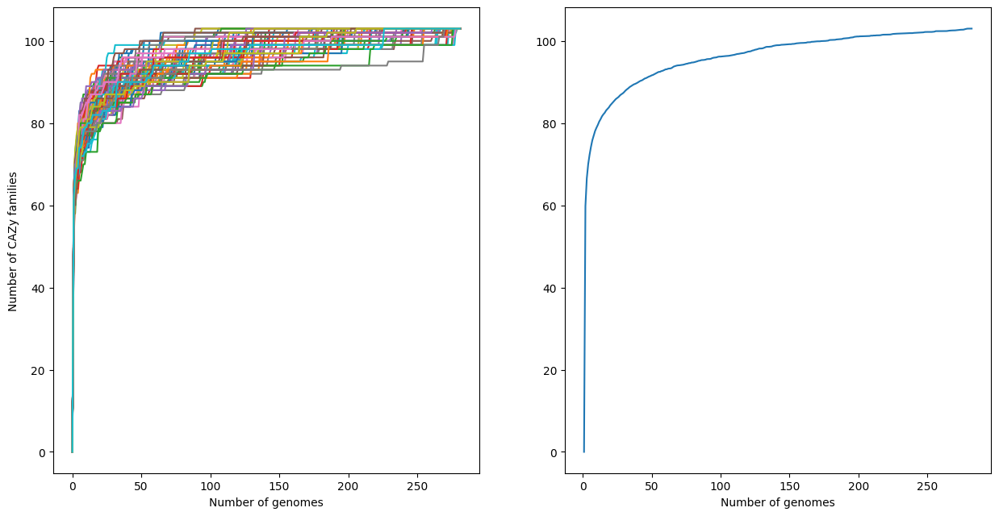

In [77]:
all_families = list(fam_freq_df_ggs.columns)
pecto_rarefact_plt, pecto_runs_addings, pecto_runs_counts = plot_rarefaction_curve(
    fam_freq_df,
    all_families,
)

Build curve for _Pectobacterium_.

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

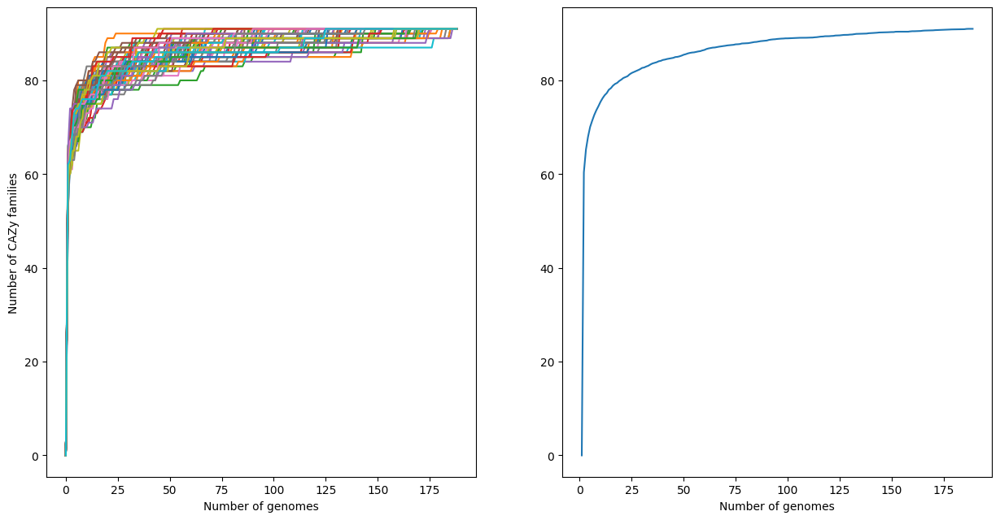

In [79]:
# calculate rare factions for Pectobacterium
pec_rarefact_plt, pec_runs_addings, pec_runs_counts = plot_rarefaction_curve(
    fam_freq_df[fam_freq_df['Genus']=='Pectobacterium'],
    all_families,
)

Build curve for _Dickeya_.

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

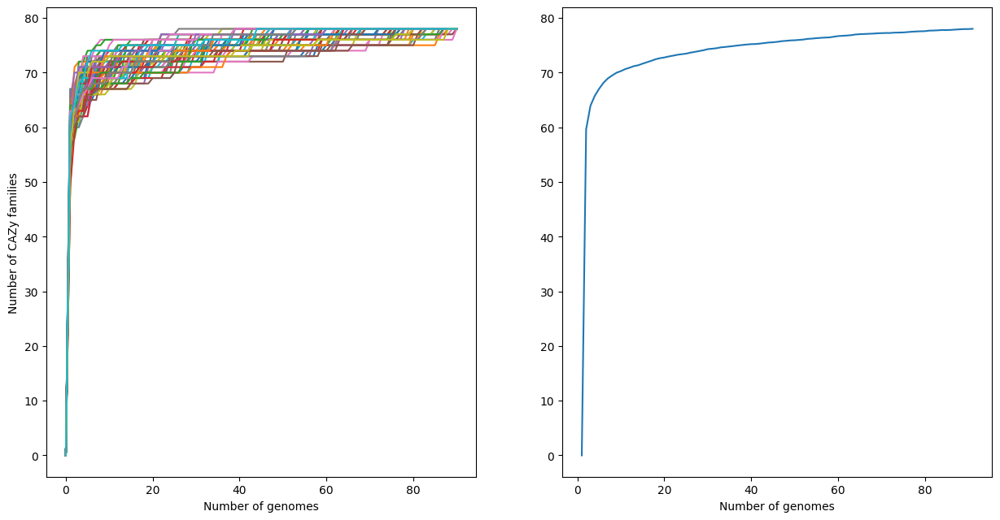

In [80]:
# calculate rare factions for Dickeya
dic_rarefact_plt, dic_runs_addings, dic_runs_counts = plot_rarefaction_curve(
    fam_freq_df[fam_freq_df['Genus']=='Dickeya'],
    all_families,
)

Build curve for _Musciola_.

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

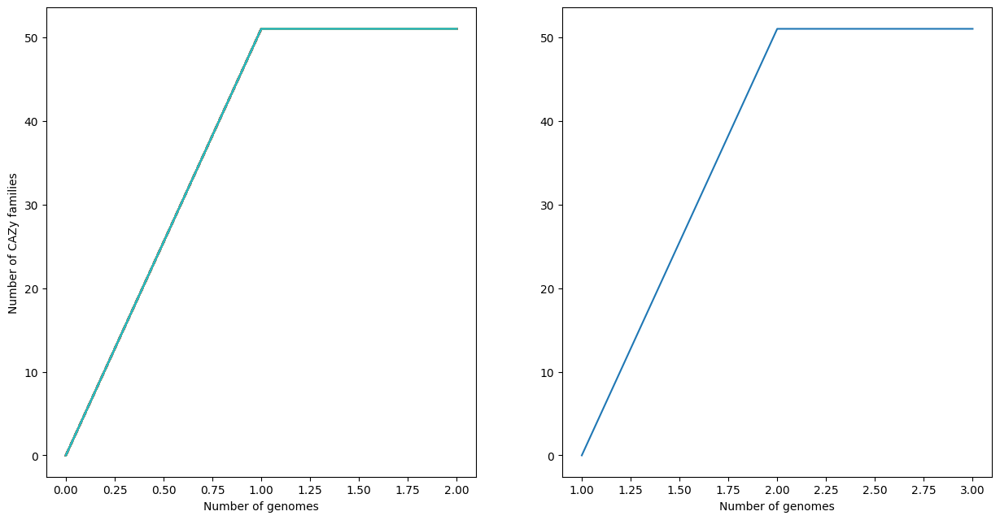

In [81]:
mus_rarefact_plt, mus_runs_addings, mus_runs_counts = plot_rarefaction_curve(
    fam_freq_df[fam_freq_df['Genus']=='Musicola'],
    all_families,
)

Load in data from the previous _Pectobacteriaceae_ study and generate rare faction curves for the genera that are common to both data sets.

In [87]:
pectobact_fam_freq_df = pd.read_csv("../data/pecto_study/cazy_fam_freqs.csv", index_col="Unnamed: 0")
pectobact_all_fams = list(pectobact_fam_freq_df.columns)[3:]
pectobact_fam_freq_df.head(1)

,Genome,Genus,Species,AA10,AA3,CBM0,CBM13,CBM18,CBM3,CBM32,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
0,GCA_025946765.1,Pectobacterium,cacticida,0,0,0,1,0,1,1,...,1,0,2,1,1,1,0,1,1,2


Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

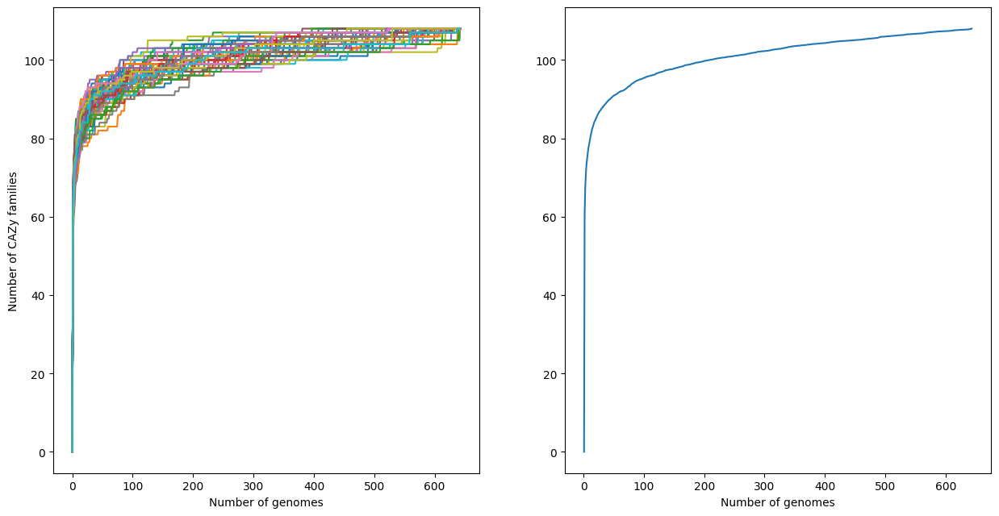

In [88]:
gbk_pecto_rarefact_plt, gbk_pecto_runs_addings, gbk_pecto_runs_counts = plot_rarefaction_curve(
    pectobact_fam_freq_df[pectobact_fam_freq_df['Genus'].isin(['Pectobacterium','Dickeya','Musicola'])],
    pectobact_all_fams,
)

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

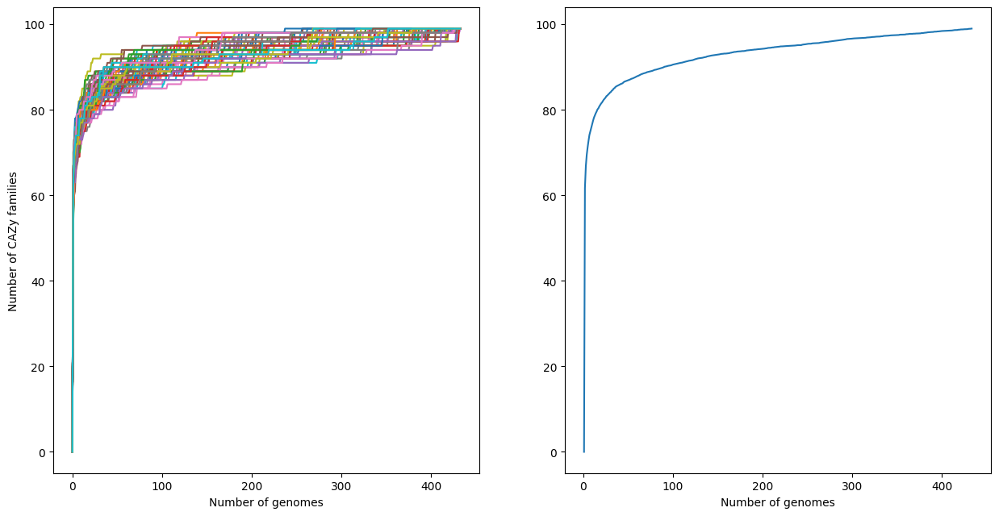

In [89]:
gbk_pec_rarefact_plt, gbk_pec_runs_addings, gbk_pec_runs_counts = plot_rarefaction_curve(
    pectobact_fam_freq_df[pectobact_fam_freq_df['Genus'] == 'Pectobacterium'],
    pectobact_all_fams,
)

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

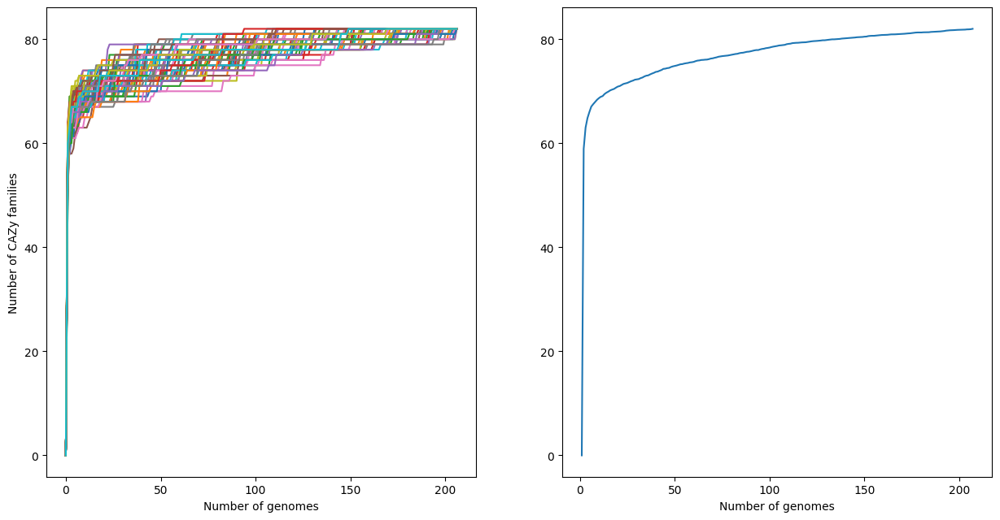

In [90]:
gbk_dic_rarefact_plt, gbk_dic_runs_addings, gbk_dic_runs_counts = plot_rarefaction_curve(
    pectobact_fam_freq_df[pectobact_fam_freq_df['Genus'] == 'Dickeya'],
    pectobact_all_fams,
)

Counting added families:   0%|          | 0/100 [00:00<?, ?it/s]

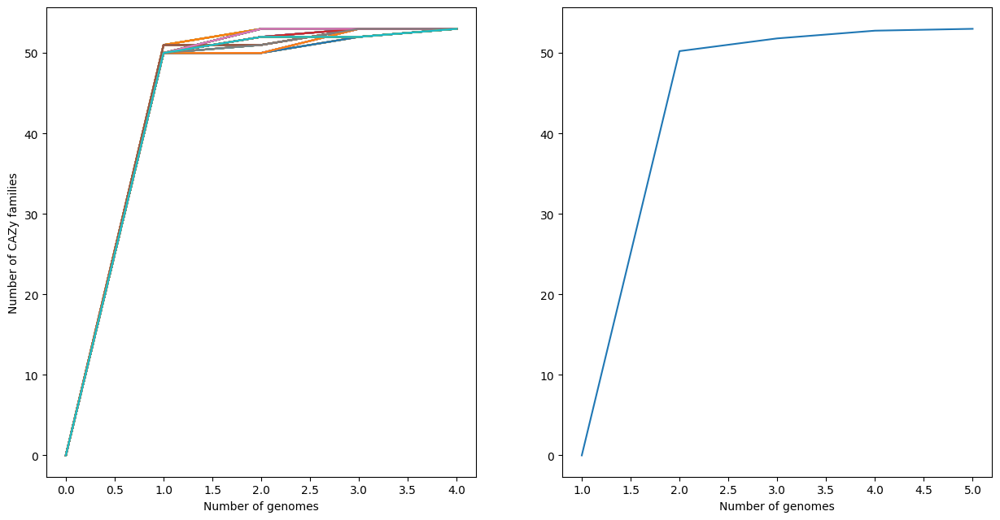

In [91]:
gbk_mus_rarefact_plt, gbk_mus_runs_addings, gbk_mus_runs_counts = plot_rarefaction_curve(
    pectobact_fam_freq_df[pectobact_fam_freq_df['Genus'] == 'Musicola'],
    pectobact_all_fams,
)

Combine all the data into one plot. Calculate the average for each set of runs and plot this as a single line, overlaying a shaded area that shows the extremes of the respective runs.

In [122]:
def calc_run_avg(run_outputs_df_counts):
    """Calc average num of families in total fam pool after adding a genome to the dataset"""
    run_count_avg = []  # avg num of fams after adding each genome
    genomes = list(range(1, len(run_outputs_df_counts)+1))
    
    for i in range(len(run_outputs_df_counts)):
        run_count_avg.append(np.mean(run_outputs_df_counts.iloc[i]))
        genomes.append
    run_avg_df = pd.DataFrame(
        {
            'Number of CAZy families': run_count_avg,
            'Number of genomes': genomes,
        }
    )
    
    return run_avg_df

def get_rarefact_extremes(run_counts, run_avgs):
    """Get extreme ranges of the runs, lower and upper, and x values for rare faction plot
   
    :param run_counts: df, output from rare faction calculation plots
    :param run_avgs: df, run averages - cols ['Number of CAZy families', 'Number of genomes']
   
    Return
    x num_genomes, y average runs, lower extremes y1, upper extremes y2,
    """
    lower_extreme = []
    upper_extreme = []
    num_genomes = list(range(1, len(run_counts)+1))
   
    for ri in range(len(run_counts)):
        row = list(run_counts.iloc[ri])
        row.sort()
        lower_extreme.append(row[0])
        upper_extreme.append(row[-1])
       
    return (
        num_genomes,
        list(run_avgs['Number of CAZy families']) + ([None] * (643 - len(run_avgs['Number of CAZy families']))),
        lower_extreme,
        upper_extreme,
    )

In [123]:
# calculate average num of fams in total fam pool after adding a new genome to the data set
pecto_run_avg = calc_run_avg(pecto_runs_counts)
pectobact_run_avg = calc_run_avg(pectobact_runs_counts)
dic_run_avg = calc_run_avg(dic_runs_counts)
mus_run_avg = calc_run_avg(mus_runs_counts)
gbk_pecto_run_avg = calc_run_avg(gbk_pecto_runs_counts)
gbk_pec_run_avg = calc_run_avg(gbk_pec_runs_counts)
gbk_dic_run_avg = calc_run_avg(gbk_dic_runs_counts)
gbk_mus_run_avg = calc_run_avg(gbk_mus_runs_counts)

pecto_x, pecto_y, pecto_y1, pecto_y2 = get_rarefact_extremes(pecto_runs_counts, pecto_run_avg)
pec_x, pec_y, pec_y1, pec_y2 = get_rarefact_extremes(
    pectobact_runs_counts,
    pectobact_run_avg,
)
dic_x, dic_y, dic_y1, dic_y2 = get_rarefact_extremes(dic_runs_counts, dic_run_avg)
mus_x, mus_y, mus_y1, mus_y2 = get_rarefact_extremes(mus_runs_counts, mus_run_avg)

gbk_pecto_x, gbk_pecto_y, gbk_pecto_y1, gbk_pecto_y2 = get_rarefact_extremes(gbk_pecto_runs_counts, gbk_pecto_run_avg)
gbk_pec_x, gbk_pec_y, gbk_pec_y1, gbk_pec_y2 = get_rarefact_extremes(
    gbk_pec_runs_counts,
    gbk_pec_run_avg,
)
gbk_dic_x, gbk_dic_y, gbk_dic_y1, gbk_dic_y2 = get_rarefact_extremes(gbk_dic_runs_counts, gbk_dic_run_avg)
gbk_mus_x, gbk_mus_y, gbk_mus_y1, gbk_mus_y2 = get_rarefact_extremes(gbk_mus_runs_counts, gbk_mus_run_avg)

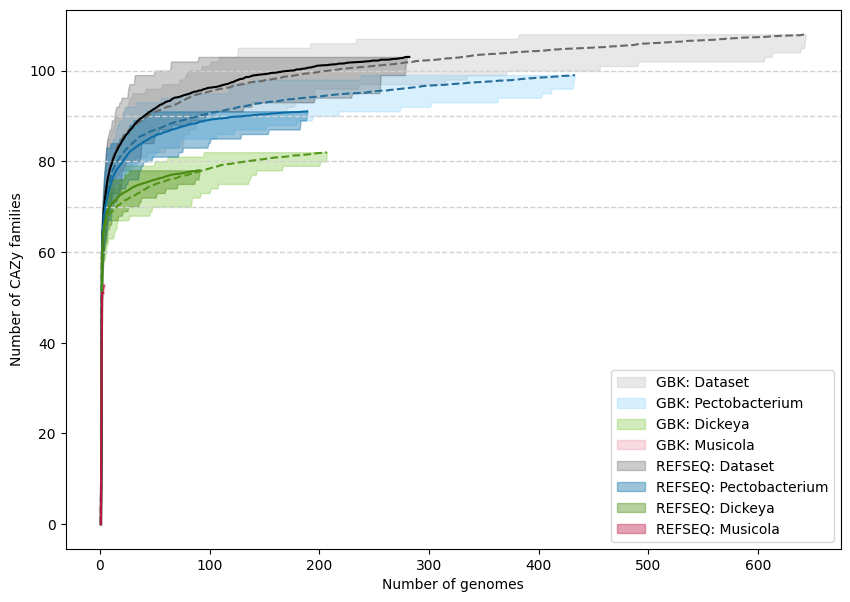

In [160]:
plt.figure(figsize=(10,7))

num_genomes = gbk_pecto_x

# blue #2976f2
# green # 57ab03
# purple #742dad
# orange #d16d1b

plt.axhline(y =60 , color = '#d1d1d1', linestyle = 'dashed', linewidth =1);
plt.axhline(y =70 , color = '#d1d1d1', linestyle = 'dashed', linewidth =1);
plt.axhline(y =80 , color = '#d1d1d1', linestyle = 'dashed', linewidth =1);
plt.axhline(y =90 , color = '#d1d1d1', linestyle = 'dashed', linewidth =1);
plt.axhline(y =100 , color = '#d1d1d1', linestyle = 'dashed', linewidth =1);

## GBK plots

plt.plot(
    num_genomes,
    gbk_pecto_y,
    color='#696969',
    linestyle='dashed',
);
plt.fill_between(gbk_pecto_x, gbk_pecto_y1, gbk_pecto_y2, color='#b5b5b5', alpha=.3, label='GBK: Dataset');

plt.plot(
    num_genomes,
    gbk_pec_y,
    color='#256e99',
    linestyle='dashed',
);
plt.fill_between(gbk_pec_x, gbk_pec_y1, gbk_pec_y2, color='#7ecefc', alpha=.3, label='GBK: Pectobacterium');

plt.plot(
    num_genomes,
    gbk_dic_y,
    color='#54961a',
    linestyle='dashed',
);
plt.fill_between(gbk_dic_x, gbk_dic_y1, gbk_dic_y2, color='#6cbf22', alpha=.3, label='GBK: Dickeya');

plt.plot(
    num_genomes,
    gbk_mus_y,
    color='#bf3d60',
    linestyle='dashed',
);
plt.fill_between(gbk_mus_x, gbk_mus_y1, gbk_mus_y2, color='#eb839f', alpha=.3, label='GBK: Musicola');

## ref seq plots

plt.plot(
    num_genomes,
    pecto_y,
    color='#000000',
)
plt.fill_between(pecto_x, pecto_y1, pecto_y2, color='#000000', alpha=.2, label='REFSEQ: Dataset');

plt.plot(
    num_genomes,
    pec_y,
    color='#0a6da6',
);
plt.fill_between(pec_x, pec_y1, pec_y2, color='#0a6da6', alpha=.4, label='REFSEQ: Pectobacterium');

plt.plot(
    num_genomes,
    dic_y,
    color='#4a8a0f',
);
plt.fill_between(dic_x, dic_y1, dic_y2, color='#4a8a0f', alpha=.4, label='REFSEQ: Dickeya');

plt.plot(
    num_genomes,
    mus_y,
    color='#ba1441',
);
plt.fill_between(mus_x, mus_y1, mus_y2, color='#ba1441', alpha=.4, label='REFSEQ: Musicola');



plt.xlabel('Number of genomes')
plt.ylabel('Number of CAZy families')

plt.legend();

plt.savefig(
    '../results/cazy_families/rarefactions_singleplot.pdf',
    bbox_inches='tight',
    format='pdf'
)

plt.show()

<a id="core-cazome"> </a>
# 4. The Core CAZome

Identify CAzy families that are present in every genome in the dataset using `identify_core_cazome()`, which takes the dataframe of CAZy family frequencies (with only CAZy families included in the columns, i.e no taxonomy columns). These families form the 'core CAZome'.

In [31]:
core_cazome = identify_core_cazome(fam_freq_df_ggs)

core_cazome = list(core_cazome)
core_cazome.sort()

print("The core CAZy families are:")
for fam in core_cazome:
    print('-', fam)

Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 103/103 [00:00<00:00, 10199.34it/s]

The core CAZy families are:
- CBM50
- CE8
- GH1
- GH103
- GH105
- GH13
- GH23
- GH28
- GH3
- GT19
- GT2
- GT30
- GT4
- GT51
- GT9
- PL1
- PL9


Build a one-dimensional box plot, using `plot_fam_boxplot()`, which plots the frequency of each CAZy family in the core CAZome across the dataset.

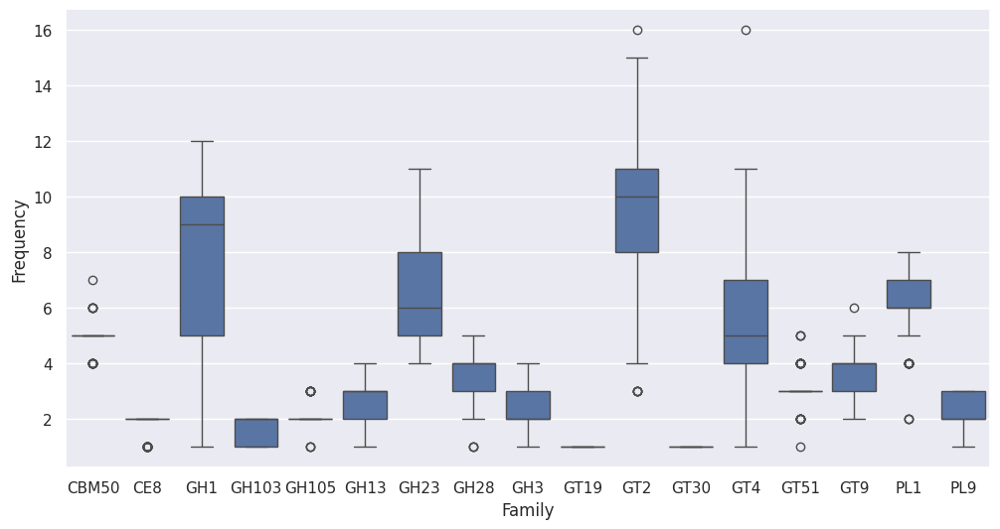

In [32]:
# filter the famil freq df to include only those families in the core CAZome
core_cazome_df = fam_freq_df_ggs[core_cazome]
plot_fam_boxplot(core_cazome_df, font_scale=0.8, fig_size=(12,6))

The boxplot shows the frequency of each CAZy family across all genomes in the dataframe. We can also break down this data by genus, and build a dataframe of Family, Genus (or tax rank of choice), genome, and frequency.

This dataframe can then be used to build a second dataframe of:
* Family
* Tax rank
* Mean frequency
* SD frequency
Which can be presented as is in a report, or imported into [RawGraphs](https://app.rawgraphs.io/) to build a matrix plot (aka a proporitonal area plot).

In [33]:
core_cazome_df_genus = copy(core_cazome_df)  # to ensure core_cazome_df is not altereted
core_cazome_df_genus = add_tax_column_from_row_index(core_cazome_df_genus, 'Genus', 1)
core_cazome_df_genus.head(1)

,,,CBM50,CE8,GH1,GH103,GH105,GH13,GH23,GH28,GH3,GT19,GT2,GT30,GT4,GT51,GT9,PL1,PL9,Genus
Genome,Genus,Species,,,,,,,,,,,,,,,,,,
GCF_003718335.1,Dickeya,solani,5,2,5,2,2,2,5,4,3,1,14,1,9,2,4,7,3,Dickeya


In [34]:
core_cazome_fggf_df, core_cazome_mean_freq_df = build_fam_mean_freq_df(
    core_cazome_df_genus,
    'Genus',
    round_by=2,
)
make_output_directory(Path("../results/core_cazome/"), nodelete=True, force=True)
core_cazome_mean_freq_df.to_csv("../results/core_cazome/core_cazome_freqs.csv")

core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|█████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 83.47it/s]
Output directory ../results/core_cazome exists, nodelete is True. Adding output to output directory.


,Family,Genus,MeanFreq,SdFreq
0,CBM50,Musicola,5.00,0.00
1,CE8,Musicola,1.00,0.00
2,GH1,Musicola,6.00,1.00
3,GH103,Musicola,1.00,0.00
4,GH105,Musicola,2.00,0.00
5,GH13,Musicola,2.00,0.00
6,GH23,Musicola,4.00,0.00
7,GH28,Musicola,2.00,0.00
8,GH3,Musicola,3.00,0.00
9,GT19,Musicola,1.00,0.00


### Genus specific core CAZomes

The identification of the core CAZome was completed for all _Pectobacterium_ and _Dickeya_ genomes.

The datafame of genomes can be filtered to contain only genomes for one genus (or a tax rank of choice). Afterwhich, the core CAZome for a specfic genus (or tax rank of choice).

In [35]:
# add a tax rank (e.g. genus) column so that the genomes can be grouped by their tax rank
fam_freq_df_ggs_genus = copy(fam_freq_df_ggs)  # to ensure core_cazome_df is not altereted
fam_freq_df_ggs_genus = add_tax_column_from_row_index(fam_freq_df_ggs_genus, 'Genus', 1)
fam_freq_df_ggs_genus.head(1)

,,,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,CBM48,CBM5,CBM50,...,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9,Genus
Genome,Genus,Species,,,,,,,,,,,,,,,,,,,,,
GCF_003718335.1,Dickeya,solani,0,1,1,0,0,0,0,2,1,5,...,0,1,1,1,2,0,0,1,3,Dickeya


<a id="pecto-core-cazome"> </a>
### _Pectobacterium_ Core CAZome

In [36]:
# filter for only pectobacterium genomes
pecto_freq_df_ggs_genus = fam_freq_df_ggs_genus[fam_freq_df_ggs_genus['Genus'] == 'Pectobacterium']
print(f"Analysing {len(pecto_freq_df_ggs_genus)} Pectobacterium genomes")

# Identify the core CAZome
pecto_core_cazome = identify_core_cazome(pecto_freq_df_ggs_genus)
print("The core CAZy families in Pectobacterium are:")
pecto_core_cazome = list(pecto_core_cazome)
pecto_core_cazome.sort()
for fam in pecto_core_cazome:
    print('-', fam)

Analysing 188 Pectobacterium genomes


Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 104/104 [00:00<00:00, 11935.52it/s]

The core CAZy families in Pectobacterium are:
- CBM32
- CBM50
- CE8
- CE9
- GH1
- GH103
- GH105
- GH13
- GH23
- GH28
- GH3
- GH43
- GT19
- GT2
- GT28
- GT30
- GT4
- GT51
- GT9
- Genus
- PL1
- PL2
- PL22
- PL3
- PL9


<a id="dic-core-cazome"> </a>
### _Dickeya_ Core CAZome

In [37]:
# filter for only dickeya genomes
dic_freq_df_ggs_genus = fam_freq_df_ggs_genus[fam_freq_df_ggs_genus['Genus'] == 'Dickeya']
print(f"Analysing {len(dic_freq_df_ggs_genus)} Dickeya genomes")

# Identify the core CAZome
dic_core_cazome = identify_core_cazome(dic_freq_df_ggs_genus)
print("The core CAZy families in Dickeya are:")
dic_core_cazome = list(dic_core_cazome)
dic_core_cazome.sort()
for fam in dic_core_cazome:
    print('-', fam)

Analysing 90 Dickeya genomes


Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 104/104 [00:00<00:00, 14176.39it/s]

The core CAZy families in Dickeya are:
- CBM48
- CBM50
- CE11
- CE12
- CE4
- CE8
- GH1
- GH102
- GH103
- GH104
- GH105
- GH13
- GH23
- GH28
- GH3
- GH31
- GH32
- GH33
- GH8
- GT1
- GT19
- GT2
- GT30
- GT35
- GT4
- GT41
- GT5
- GT51
- GT83
- GT9
- Genus
- PL1
- PL3
- PL9


### Combine the mean core CAZy family frequencies

For the genus specific families, calculate the mean frequency across the genomes using `build_fam_mean_freq_df()`, and append the resulting data to the `core_cazome_mean_freq_df` dataframe.

In [38]:
core_cazome_mean_freq_df.head(1)

,Family,Genus,MeanFreq,SdFreq
0,CBM50,Musicola,5.0,0.0


In [39]:
dic_freq_df_ggs_genus.head(1)
dic_only_core_fams = [fam for fam in dic_core_cazome if fam not in core_cazome]
dic_freq_df_ggs_genus_core_cazome = dic_freq_df_ggs_genus[dic_only_core_fams]

d_core_cazome_fggf_df, d_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    dic_freq_df_ggs_genus_core_cazome,
    'Genus',
    round_by=2,
)

pecto_freq_df_ggs_genus.head(1)
pecto_only_core_fams = [fam for fam in pecto_core_cazome if fam not in core_cazome]
pecto_freq_df_ggs_genus_core_cazome = pecto_freq_df_ggs_genus[pecto_only_core_fams]

p_core_cazome_fggf_df, p_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    pecto_freq_df_ggs_genus_core_cazome,
    'Genus',
    round_by=2,
)

pd_core_cazome_mean_freq_df = copy(core_cazome_mean_freq_df)
pd_core_cazome_mean_freq_df = pd.concat(
    [pd_core_cazome_mean_freq_df, d_core_cazome_mean_freq_df],
    ignore_index=True,
)
pd_core_cazome_mean_freq_df = pd.concat(
    [pd_core_cazome_mean_freq_df, p_core_cazome_mean_freq_df],
    ignore_index=True,
)

pd_core_cazome_mean_freq_df.to_csv("../results/core_cazome/pd_all_core_cazome_freqs.csv")
pd_core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 197.55it/s]


,Family,Genus,MeanFreq,SdFreq
0,CBM50,Musicola,5.00,0.00
1,CE8,Musicola,1.00,0.00
2,GH1,Musicola,6.00,1.00
3,GH103,Musicola,1.00,0.00
4,GH105,Musicola,2.00,0.00
...,...,...,...,...
69,GH43,Pectobacterium,2.29,0.68
70,GT28,Pectobacterium,1.00,0.00
71,PL2,Pectobacterium,1.98,0.13
72,PL22,Pectobacterium,1.00,0.00


<a id="co-occurring"> </a>
## 5. Families that always occur together

Identify CAZy families that are always present in the genome together - this approach does not tolerate one CAZy family ever appearing without the other family in the same genome.

In [40]:
# reminder of the structure of the df
fam_freq_df.head(1)

,Genome,Genus,Species,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
0,GCF_003718335.1,Dickeya,solani,0,1,1,0,0,0,0,...,0,0,1,1,1,2,0,0,1,3


In [41]:
# reminder of the structure of the df
fam_freq_df_pd.head(1)

,Genome,Genus,Species,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,...,PL11,PL17,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9
0,GCF_003718335.1,Dickeya,solani,0,1,1,0,0,0,0,...,0,0,1,1,1,2,0,0,1,3


**An iterative approach to identify co-occurring families:**

Iterate through the dataframe of CAZy family frequencies in _Pectobacterium_ and _Dickeya_ (`fam_freq_df_pd`) and identify the groups of always co-occurring CAZy families (i.e. those families that are always present together) and count the number of genomes in which the families are present together.

This is done using the `cazomevolve` function `calc_cooccuring_fam_freqs`, which returns a dictionary of groups of co-occurring CAZy families. The function takes as input:
1. The dataframe of CAZy family frequencies (it can include taxonomy information in columns)
2. A list of the CAZy families to analyse
3. (Optional) whether to include or exclude the core CAZome from the list of always co-occurring CAZy families.

In [42]:
cooccurring_fams_dict = calc_cooccuring_fam_freqs(
    fam_freq_df_pd,
    list(fam_freq_df_pd.columns[3:]),
    exclude_core_cazome=False,
)

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 145/145 [00:00<00:00, 272479.43it/s]


In [43]:
pd_fam_freq_df = fam_freq_df_pd[fam_freq_df_pd['Genus'].isin(['Pectobacterium','Dickeya'])]
pd_cooccurring_fams_dict = calc_cooccuring_fam_freqs(
    pd_fam_freq_df,
    list(fam_freq_df_pd.columns[3:]),
    exclude_core_cazome=False,
)
musicola_cooccurring_fams_dict = {}
for grpnum in cooccurring_fams_dict:
    fams = list(cooccurring_fams_dict[grpnum]['fams'])
    fams.sort()
    for num in pd_cooccurring_fams_dict:
        pd_fams = list(pd_cooccurring_fams_dict[num]['fams'])
        pd_fams.sort()
        if pd_fams == fams:
            freq = list(cooccurring_fams_dict[grpnum]['freqs'])[0] - list(pd_cooccurring_fams_dict[grpnum]['freqs'])[0]
            if freq > 0:
                musicola_cooccurring_fams_dict[grpnum] = {'fams': set(fams), 'freqs': {freq}}
musicola_cooccurring_fams_dict

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 162/162 [00:00<00:00, 288158.29it/s]


{3: {'fams': {'CE11', 'GH102', 'GH32'}, 'freqs': {2}},
 6: {'fams': {'GT0', 'GT26'}, 'freqs': {2}}}

Identify groups of co-occurring families in only _Pectobacterium_ or _Dickeya_ genomes.

In [44]:
# Pectobacterium
pecto_fam_freq_df = fam_freq_df_pd[fam_freq_df_pd['Genus'] == 'Pectobacterium']
pecto_cooccurring_fams_dict = calc_cooccuring_fam_freqs(pecto_fam_freq_df, list(pecto_fam_freq_df.columns[3:]), exclude_core_cazome=False)

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 292/292 [00:00<00:00, 307028.52it/s]


In [45]:
# Dickeya
dic_fam_freq_df = fam_freq_df_pd[fam_freq_df_pd['Genus'] == 'Dickeya']
dic_cooccurring_fams_dict = calc_cooccuring_fam_freqs(dic_fam_freq_df, list(dic_fam_freq_df.columns[3:]), exclude_core_cazome=False)

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 538/538 [00:00<00:00, 270827.60it/s]


### Build an upset plot of co-occurring CAZy families

Build an upsetplot (using the Python package `upsetplot`) to visulise the groups of always co-occurring CAZy families, additionally it will plot the number of genomes in which each group of co-occurring CAZy families were present.

First compile the data/membership for the upset plot by:
1. Creating an empty list to store the upset plot data
2. Adding to the empty list the data contained in each dictionary of co-occurring CAZy families by using the `add_to_upsetplot_membership()` function

In [46]:
upsetplot_membership = []
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, cooccurring_fams_dict)
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, pecto_cooccurring_fams_dict)
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, dic_cooccurring_fams_dict)
len(upsetplot_membership)

2084

Build the upset plot.

Output directory ../results/cooccurring_families exists, nodelete is True. Adding output to output directory.
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/upsetplot/plotting.py:662: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' 'black' 'black' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e' '#0000002e'
 '#0000002e' '#

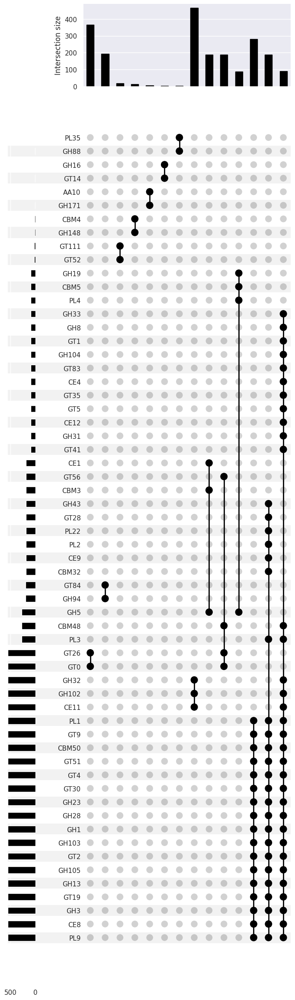

In [47]:
make_output_directory(Path("../results/cooccurring_families"), force=True, nodelete=True)
pecto_dic_upsetplot = build_upsetplot(
    upsetplot_membership,
    file_path='../results/cooccurring_families/pd_cooccurring_fams.svg',
)

**Break down the incidences per genus:**

The upset plot generates a bar chart showing the number of genomes that each group of co-occuring CAZy families appeared in. However, this plots the total number across each of the groups (i.e. _Pectobacterium_, _Dickeya_, and both).

To break down the indidence (i.e. the number of genomes that each group of co-occurring CAZy families were present in) per group, a dataframe listing each group of co-occurring CAZy families, the group (i.e. genus), and the respective frequency must be generated. This dataframe can then be used to generate a proportional area plot (or matrix plot), breaking down the incidence per group (i.e. genus).

The groups of co-occurring CAZy families must be listed in the same order as they are presented in the upset plot.

In [48]:
upset_plot_groups = get_upsetplot_grps(upsetplot_membership)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 14/14 [00:00<00:00, 51.85it/s]


Compiling the data of the incidence of each grp of co-occurring CAZy families per group of interest (e.g. per genus), into a single dataframe.

Create an empty list to store all data for the dataframe, then use `add_upsetplot_grp_freqs` to add data of the incidence per group of co-occurring CAZy families to the list. `build_upsetplot_matrix` is then used to build the dataframe.

In [49]:
cooccurring_grp_freq_data = []  # empty list to store data for the df

cooccurring_grp_freq_data = add_upsetplot_grp_freqs(
    upset_plot_groups,
    cooccurring_grp_freq_data,
    cooccurring_fams_dict,
    'All',
)
cooccurring_grp_freq_data = add_upsetplot_grp_freqs(
    upset_plot_groups,
    cooccurring_grp_freq_data,
    musicola_cooccurring_fams_dict,
    'Musicola',
)
cooccurring_grp_freq_data= add_upsetplot_grp_freqs(
    upset_plot_groups,
    cooccurring_grp_freq_data,
    pecto_cooccurring_fams_dict,
    'Pectobacterium',
)
cooccurring_grp_freq_data= add_upsetplot_grp_freqs(
    upset_plot_groups,
    cooccurring_grp_freq_data,
    dic_cooccurring_fams_dict,
    'Dickeya',
)

Compiling co-occurring families incidence data: 100%|████████████████████████████████████████████████████| 14/14 [00:00<00:00, 84733.41it/s]


Build a single dataframe of co-occurring families, freq and group (e.g. genus).

But also list the information for each group in the same order the groups of CAZy families are listed in the upset plot. This allows a proportional area plot to be generated (for example, by using [RawGraphs](https://app.rawgraphs.io/)), which can then be combined with the upset plot (for example, using [inkscape](https://inkscape.org/)).

In [50]:
# build the dataframe
cooccurring_fams_freq_df = build_upsetplot_matrix(
    cooccurring_grp_freq_data,
    'Genus',
    file_path='../results/cooccurring_families/cooccurring_fams_freqs.csv',
)
cooccurring_fams_freq_df

,Families,Genus,Incidence
0,GT0+GT26,All,278
1,GH94+GT84,All,97
2,GT52+GT111,All,9
3,GH148+CBM4,All,6
4,GH171+AA10,All,2
5,GT14+GH16,All,1
6,CE11+GH102+GH32,All,279
7,PL9+CE8+GH3+GT19+GH13+GH105+GT2+GH103+GH1+GH28...,All,280
8,GT0+GT26,Musicola,2
9,CE11+GH102+GH32,Musicola,2


<a id="pca"></a>
## 6. Principal Component Analysis (PCA)

Use principal component analysis to identify individual and groups of CAZy families that are strongly associated with divergence between the composition of _Pectobacterium_ and _Dickeya_ CAZomes in terms of CAZy family frequencies. 

Use the `cazomevolve` function `perform_pca()` to perform a PCA on a dataframe where each row is a genome, and each column the frequency of a unique CAZy family - the columns in the dataframe must only contain numerical data (i.e. no taxonomic data).

In [16]:
num_of_components = len(fam_freq_df_ggs.columns)
pd_pca, X_scaled = perform_pca(fam_freq_df_ggs, num_of_components)
pd_pca

PCA(n_components=103)

**Explained cumulative variance:**

Explore the amount of variance in the dataset that is captured by the dimensional reduction performed by the PCA.

Output directory ../results/pca/pecto_dic exists, nodelete is True. Adding output to output directory.


Number of features needed to explain 0.95 fraction of total variance is 44. 


<Figure size 640x480 with 0 Axes>

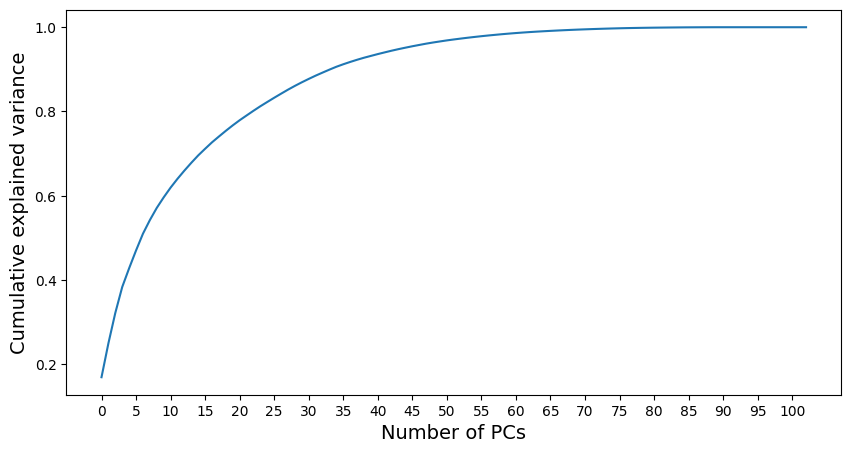

In [17]:
make_output_directory(Path("../results/pca/pecto_dic/"), force=True, nodelete=True)
cumExpVar = plot_explained_variance(
    pd_pca,
    num_of_components,
    file_path="../results/pca/pecto_dic/pd_pca_explained_variance.png",
)

In [53]:
print(f"{pd_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

100.0% of the variance in the data set was catpured by the PCA


**Variance captured per PC:**

Explore the variance in the data that is captured by each PC.

Explained variance for 1PC: 0.16914860399915857
Explained variance for 2PC: 0.08060946953629344
Explained variance for 3PC: 0.07220174489942308
Explained variance for 4PC: 0.061395559887963295
Explained variance for 5PC: 0.044497734639845625
Explained variance for 6PC: 0.04221132762829154
Explained variance for 7PC: 0.039740581262241656
Explained variance for 8PC: 0.03230394191366609
Explained variance for 9PC: 0.028967709178588995
Explained variance for 10PC: 0.025004059065160095


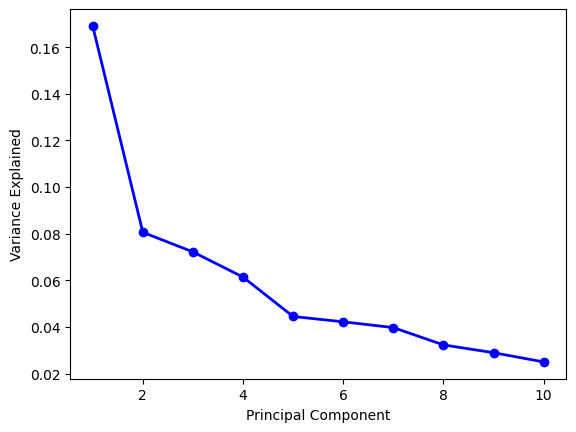

In [19]:
plot_scree(pd_pca, nComp=10, file_path="../results/pca/pecto_dic/pd_pca_scree.png")

PC1 captures a signficantly greater amount degree of the varaince in the data set than all other PCs.  
PCs 2-4 capture comparable degrees of the variance

## Scatter and loadings plots

To explore the variance captured by each PC, plot different combinations of PCs onto a scatter plot where each axis represents a different PC and each point on the plot is a genome in the data set, using the `plot_pca()` function.

`plot_pca()` takes 6 positional argumets:
1. PCA object from `peform_pca()`
2. Scaling object (X_scaled) from `perform_pca()`
3. The dataframe of CAZy family frequencies, if you want to colour code the genomes by a specific grouping (i.e. by Genus), an additional column containing the grouping information needs to be added to the dataframe (e.g. listing the genus per genome)
4. The number of the first PC to be plotted, e.g. 1 for PC1 - int
5. The number of the second PC to be plotted, e.g. 2 for PC2 - int
6. The method to colour code the genomes by (e.g. 'Genus') - needs to match the name of the column containing the data in the dataframe of CAZy family frequencies

Owing to the majoirty of the variance captured by the PCA being captured by PCs 1-4, all possible combinations of these PCs were explored.

## PCs 1 - 4 

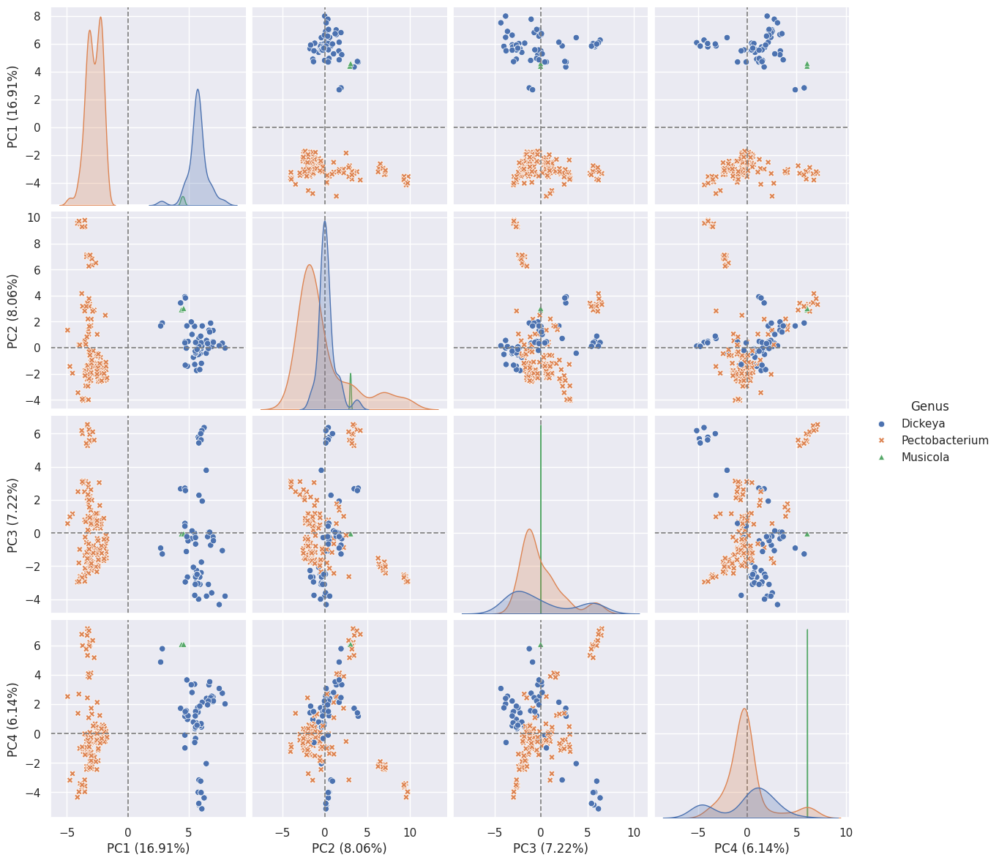

In [55]:
X_pca = pd_pca.transform(X_scaled)

fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus']) 

fam_freq_df_ggs_pc = copy(fam_freq_df_ggs)
colnames = []
for i in range(4):
    fam_freq_df_ggs_pc[f'PC{i+1} ({round(pd_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(pd_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Genus",
    diag_kind="kde",
    markers=['o','X', '^'],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/pca/pecto_dic/pd_pc_screen_genus.svg',
    bbox_inches='tight',
    format='svg'
)
plt.savefig(
    '../results/pca/pecto_dic/pd_pc_screen_genus.png',
    bbox_inches='tight',
    format='png'
)

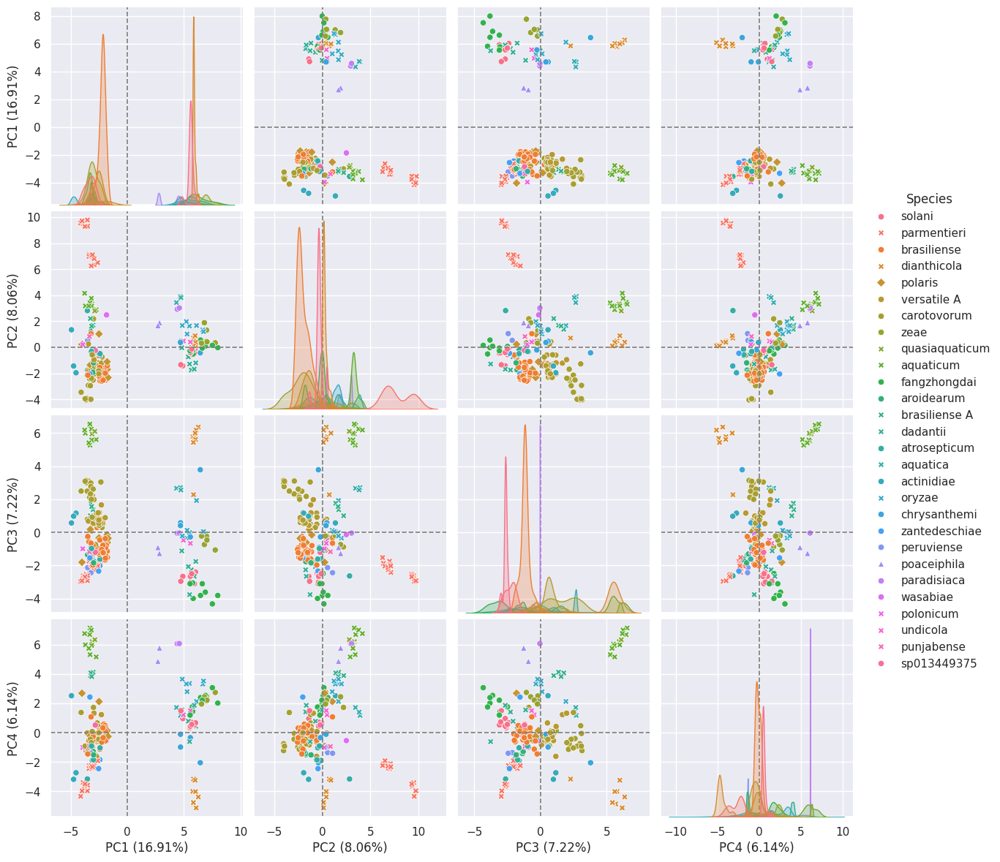

In [56]:
fam_freq_df_ggs_pc['Species'] = list(fam_freq_df_pd['Species']) 

g = sns.pairplot(
    fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Species",
    diag_kind="kde",
    markers=[
        'o', 'X', 'o', 'X', 'D', 'o', 'o', 'o', 'X',
        'X', 'o', 'o', 'X', 'X', 'o', 'X', 'o', 'X',
        'o', 'o', 'o', '^', 'o', 'o', 'X', 'X', 'X', 'o',
    ],
    height=3,
);
i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/pca/pecto_dic/pd_pc_screen_species.svg',
    bbox_inches='tight',
    format='svg'
)
plt.savefig(
    '../results/pca/pecto_dic/pd_pc_screen_species.png',
    bbox_inches='tight',
    format='png'
)

## PC1 vs PC2

### Pectobacterium and Dickeya: PC1 vs PC2

Not applying hue order
Not Applying style


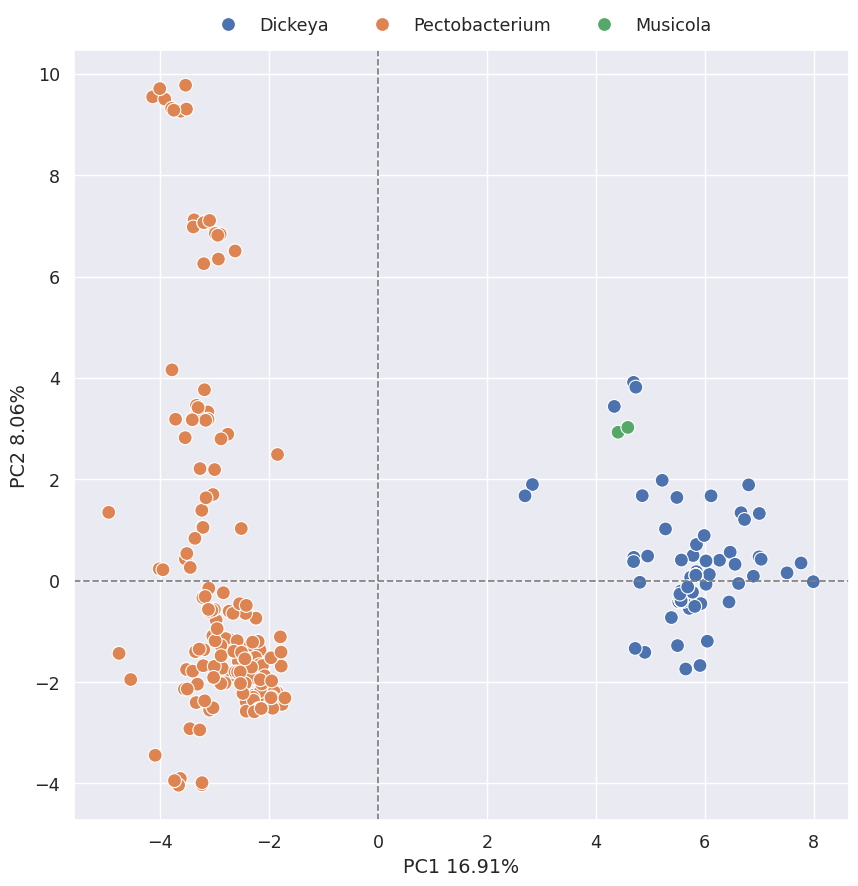

In [57]:
fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus'])  # add column to use for colour scheme

pc1_pc2_scatter_plt = plot_pca(
    pd_pca,
    X_scaled,
    fam_freq_df_ggs,
    1,
    2,
    'Genus',
    figsize=(10,10),
)

Label the four _Dickeya_ genomes that form their own cluster.

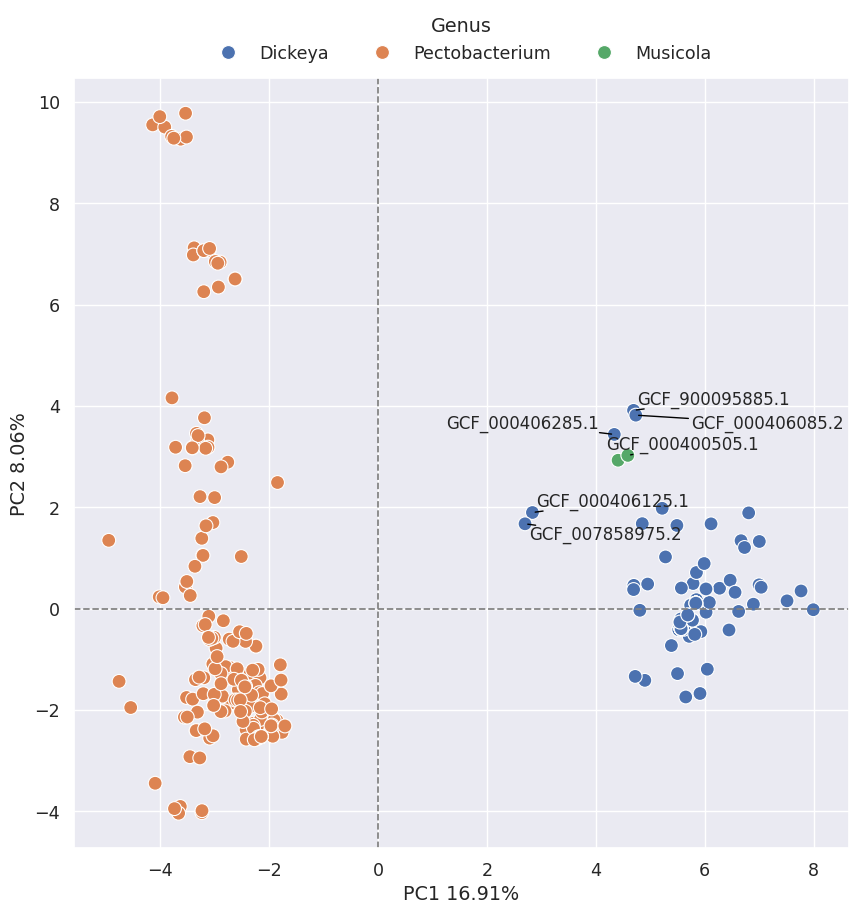

In [58]:
X_pca = pd_pca.transform(X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

g = sns.scatterplot(
    x=X_pca[:,0],
    y=X_pca[:,1],
    data=fam_freq_df_ggs,
    hue='Genus',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * pd_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * pd_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title='Genus', frameon=False);

genome_lbls = [_[0] for _ in fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if ((xval > 2) and (xval < 4)) or ((yval > 3) and (xval > 0))
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto_dic/pd_pc1_pc2_LABELLED.png', bbox_inches='tight', format='png')

### Label species of PC1 vs PC2: _Dickeya_

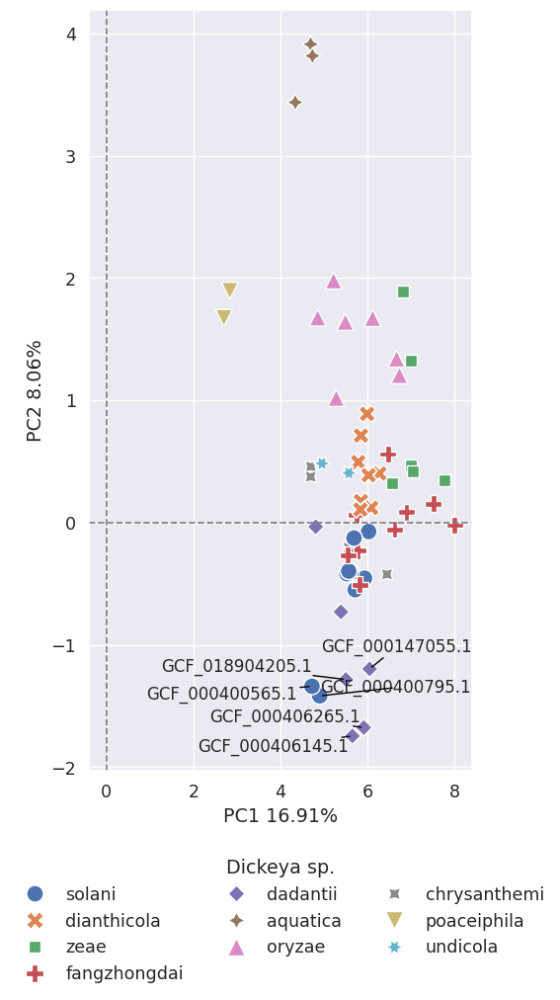

In [59]:
X_pca = pd_pca.transform(X_scaled)

plt.figure(figsize=(5,10))
sns.set(font_scale=1.15)

temp_d_fam_freq_df_ggs = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Dickeya']

g = sns.scatterplot(
    x=X_pca[:,0][fam_freq_df_ggs['Genus'] == 'Dickeya'],
    y=X_pca[:,1][fam_freq_df_ggs['Genus'] == 'Dickeya'],
    data=temp_d_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=150,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * pd_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * pd_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, -.3), ncol=3, title='Dickeya sp.', frameon=False);

genome_lbls = [_[0] for _ in fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if (((yval < -1) and (yval > -3) and (xval > 0)) or ((yval > 2) and (xval > 2) and (xval < 4.1)))
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto_dic/pd_pc1_pc2_dickeya_sp.png', bbox_inches='tight', format='png')

### Label species of PC1 vs PC2: _Pectobacterium_

Using GTDB classifications.

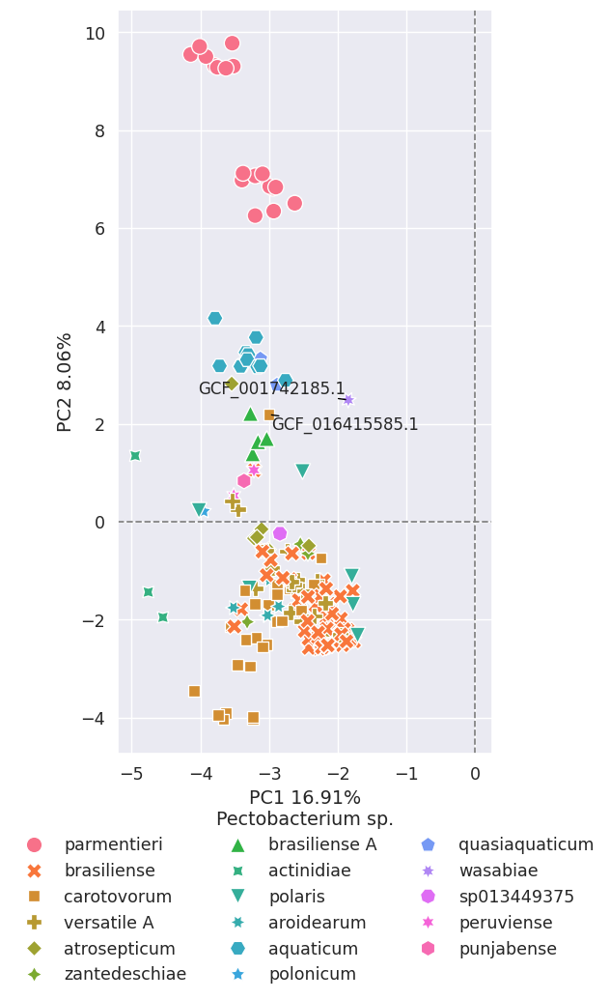

In [28]:
X_pca = pd_pca.transform(X_scaled)

plt.figure(figsize=(5,10))
sns.set(font_scale=1.15)

temp_d_fam_freq_df_ggs = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Pectobacterium']

g = sns.scatterplot(
    x=X_pca[:,0][fam_freq_df_ggs['Genus'] == 'Pectobacterium'],
    y=X_pca[:,1][fam_freq_df_ggs['Genus'] == 'Pectobacterium'],
    data=temp_d_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=140,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * pd_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * pd_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, -.33), ncol=3, title='Pectobacterium sp.', frameon=False);

genome_lbls = [_[0] for _ in fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if ((xval > -2) and (xval < 0) and (yval > 1)) or (lbl == 'GCF_016415585.1')
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto_dic/pd_pc1_pc2_pectobacterium_sp.svg', bbox_inches='tight', format='svg')

Find number of CAZymes in genome GCF_016415585.1.

In [41]:
fam_freq_df[fam_freq_df['Genome'] == 'GCF_016415585.1'][fam_freq_df.columns[3:]].values.sum()

115

Comparing the number of CAZymes found in the genome to the mean number of CAZymes found in _Pectobacterium_, the number of CAZyme features do not appear to have been underestimated (which otherwise could have contributed to the isolation of the genome).

For _Pectobacterium carotovorum_ species, use the **NCBI species classifications** instead of the GTDB taxonomic classifications for _P. carotovorum_.

In [30]:
fam_freq_df_ggs_ncbi = copy(fam_freq_df_ggs)
fam_freq_df_ggs_ncbi['Species'] = list(fam_freq_df_pd['Species'])

# get tax data for NCBI
ncbi_tax_csv_path = "../data/pectobact/cazomes/fg_genome_taxs.csv"
ncbi_tax_df = load_tax_data(ncbi_tax_csv_path, genus=True, species=True)

species_col = []
for ri in tqdm(range(len(fam_freq_df_ggs_ncbi)), desc="Getting P.carotovorum ncbi classifications"):
    if fam_freq_df_ggs_ncbi.iloc[ri].name[-1] == 'carotovorum':
        genome = fam_freq_df_ggs_ncbi.iloc[ri].name[0].replace("GCF", "GCA")
        species = ncbi_tax_df[ncbi_tax_df['Genome'] == genome]['Species'].values[0]
        species_col.append(species)
    else:
        species_col.append(fam_freq_df_ggs_ncbi.iloc[ri]['Species'])

fam_freq_df_ggs_ncbi['Species'] = species_col
fam_freq_df_ggs_ncbi.head(5)

Getting P.carotovorum ncbi classifications:   0%|          | 0/280 [00:00<?, ?it/s]

,,,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,CBM48,CBM5,CBM50,...,PL2,PL22,PL26,PL3,PL35,PL38,PL4,PL9,Genus,Species
Genome,Genus,Species,,,,,,,,,,,,,,,,,,,,,
GCF_003628715.1,Pectobacterium,parmentieri,0,0,1,1,1,0,0,2,0,5,...,2,1,1,1,0,1,1,2,Pectobacterium,parmentieri
GCF_001187965.2,Dickeya,fangzhongdai,0,1,2,0,0,0,1,2,1,5,...,1,1,1,2,0,1,1,3,Dickeya,fangzhongdai
GCF_016944315.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,2,0,5,...,2,1,1,2,0,1,1,2,Pectobacterium,brasiliense
GCF_016950195.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,2,0,5,...,2,1,1,2,0,1,1,2,Pectobacterium,brasiliense
GCF_013488025.1,Pectobacterium,carotovorum,0,1,1,1,1,0,0,2,0,5,...,2,1,1,2,0,1,1,2,Pectobacterium,carotovorum


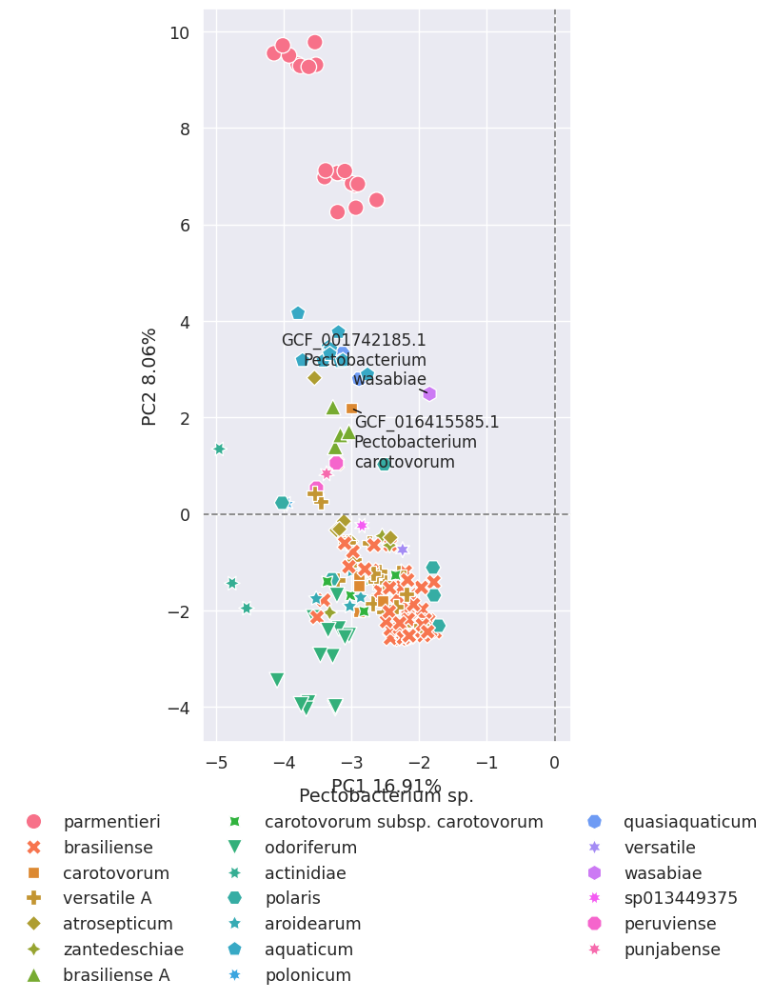

In [32]:
X_pca = pd_pca.transform(X_scaled)

plt.figure(figsize=(5,10))
sns.set(font_scale=1.15)

temp_d_fam_freq_df_ggs = fam_freq_df_ggs_ncbi[fam_freq_df_ggs_ncbi['Genus'] == 'Pectobacterium']

g = sns.scatterplot(
    x=X_pca[:,0][fam_freq_df_ggs_ncbi['Genus'] == 'Pectobacterium'],
    y=X_pca[:,1][fam_freq_df_ggs_ncbi['Genus'] == 'Pectobacterium'],
    data=temp_d_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=140,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * pd_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * pd_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, -.35), ncol=3, title='Pectobacterium sp.', frameon=False);

genome_lbls = ["\n".join(_) for _ in fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if ((xval > -2) and (xval < 0) and (yval > 1)) or (lbl.find('GCF_016415585.1') != -1)
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto_dic/pd_pc1_pc2_pectobacterium_sp_ncbi.png', bbox_inches='tight', format='png')

### Loadings plot of PC1 vs PC2

The loadings plot shows the degree of correlation between each variable (i.e. CAZy family) and each of the PCs.

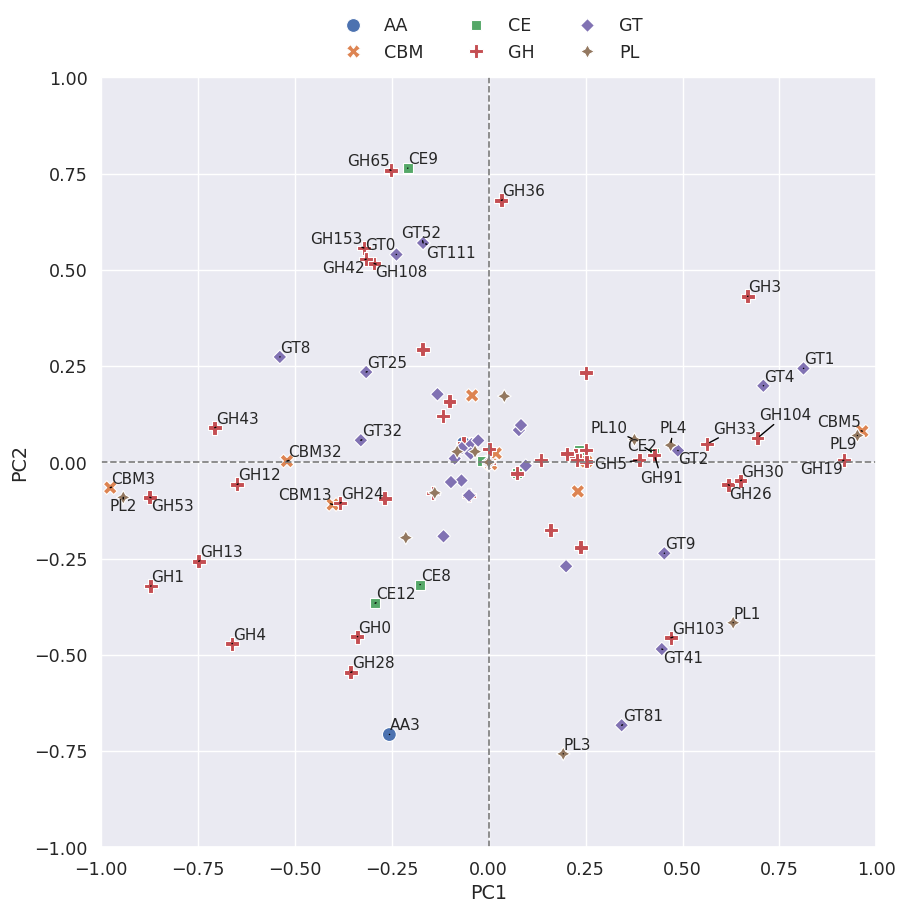

In [67]:
plot_loadings(
    pd_pca,
    fam_freq_df_ggs,
    1,
    2,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto_dic/pd_pc1_pc2_loadings_plot.pdf",
    file_format='pdf',
    font_size=11,
    style=True,
)

## Exploration of PC2-PC4 clustering of genomes.

PC1 separates out the genomes in a manner that correlates with their genus classification: _Pectobacterium_ genomes are locataed in the negative PC1 axis, and _Dickeya_ genomes are located in the positive PC1 axis.

PCs 2-4 do not correlate with the genus classification, and may correlate with geographical distribution, plant host range, or a combination of the two.

The geographical distribution, climate, and plant host range of each species was collated into a dataframe. Species with a similar geographical distribution, climate, and plant host range were assinged the same group number. 

The genomes were projected onto PCs 2-4 again, colour coding by distribution, climate, host range, and group number.

In [66]:
# load species data
sp_df = pd.read_csv("../data/pecto_dic/additional_data/pectobacterium_dickeya_niches-SI.csv")

fam_freq_df_ggs['Species'] = list(fam_freq_df_pd['Species'])
fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus'])

distribution_col, climate_col, host_col, grp_col = [], [], [], []
for i in tqdm(range(len(fam_freq_df_ggs)), desc="Adding species data"):
    species = fam_freq_df_ggs.iloc[i]['Species']
    if species == 'versatile A' or species =='Versatile':
        species = 'versatile'
    species_row = sp_df[sp_df['Species'] == species]
    
    try:
        distribution = species_row['Distribution'].values[0]
    except IndexError:
        distribution = None
        print(f"Could not find data for {species}")
    try:
        climate = species_row['Climate'].values[0]
    except IndexError:
        climate = None
        
    try:
        host = species_row['Plant hosts'].values[0]
    except IndexError:
        host = None
        
    try:
        grp = species_row['Group'].values[0]
    except IndexError:
        grp = None
        
    distribution_col.append(distribution)
    climate_col.append(climate)
    host_col.append(host)
    grp_col.append(str(grp))
    
fam_freq_df_ggs['Distribution'] = distribution_col
fam_freq_df_ggs['Climate'] = climate_col
fam_freq_df_ggs['Host'] = host_col
fam_freq_df_ggs['Group'] = grp_col

fam_freq_df_ggs.head(3)

Adding species data:   0%|          | 0/280 [00:00<?, ?it/s]

Could not find data for quasiaquaticum
Could not find data for quasiaquaticum
Could not find data for sp013449375


,,,AA10,AA3,CBM13,CBM3,CBM32,CBM34,CBM4,CBM48,CBM5,CBM50,...,PL35,PL38,PL4,PL9,Genus,Species,Distribution,Climate,Host,Group
Genome,Genus,Species,,,,,,,,,,,,,,,,,,,,,
GCF_003718335.1,Dickeya,solani,0,1,1,0,0,0,0,2,1,5,...,0,0,1,3,Dickeya,solani,Europe and Asia,Variable,Potato,7
GCF_000260925.1,Pectobacterium,parmentieri,0,0,1,1,1,0,0,2,1,5,...,0,1,1,2,Pectobacterium,parmentieri,Northern hemisphere,Variable,Potato,4
GCF_016949835.1,Pectobacterium,brasiliense,0,1,1,1,1,0,0,2,0,5,...,0,1,1,2,Pectobacterium,brasiliense,Global,Variable,Variable,1


In [67]:
c_grps = {
    '1': ['zeae', 'oryzae', 'poaceiphila', 'paradisiaca'],
    '2': ['versatile','polaris','aroidearum','aroidearum'],
    '3': ['fangzhongdai', 'dianthicola', 'solani', 'chrysanthemi'],
    '4': ['undicola'],
}

c_grp_col = []
for sp in list(fam_freq_df_pd['Species']):
    if sp in c_grps['1']:
        c_grp_col.append('1')
    elif sp in c_grps['2']:
        c_grp_col.append('2')
    elif sp in c_grps['3']:
        c_grp_col.append('3')
    elif sp in c_grps['4']:
        c_grp_col.append('4')
    else:
        c_grp_col.append('5')
        
fam_freq_df_ggs['Carbon-Metabolism'] = c_grp_col

Output directory ../results/pca/pecto_dic/niche_mapping exists, nodelete is True. Adding output to output directory.


Below: PC1 vs PC2 - Colour coded by Species
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC2 - Colour coded by Loadings
Below: PC1 vs PC2 - Colour coded by Distribution
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC2 - Colour coded by Climate
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC2 - Colour coded by Host
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC2 - Colour coded by Group
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC2 - Colour coded by Carbon-Metabolism
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC3 - Colour coded by Species
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC3 - Colour coded by Loadings
Below: PC1 vs PC3 - Colour coded by Distribution
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC3 - Colour coded by Cli

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/cazomevolve/cazome/explore/pca.py:210: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figsize)


Below: PC1 vs PC5 - Colour coded by Species
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC5 - Colour coded by Loadings
Below: PC1 vs PC5 - Colour coded by Distribution
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC5 - Colour coded by Climate
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC5 - Colour coded by Host
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC5 - Colour coded by Group
Not applying hue order
Applying style
Not applying style order
Below: PC1 vs PC5 - Colour coded by Carbon-Metabolism
Not applying hue order
Applying style
Not applying style order
Below: PC2 vs PC3 - Colour coded by Species
Not applying hue order
Applying style
Not applying style order
Below: PC2 vs PC3 - Colour coded by Loadings
Below: PC2 vs PC3 - Colour coded by Distribution
Not applying hue order
Applying style
Not applying style order
Below: PC2 vs PC3 - Colour coded by Cli

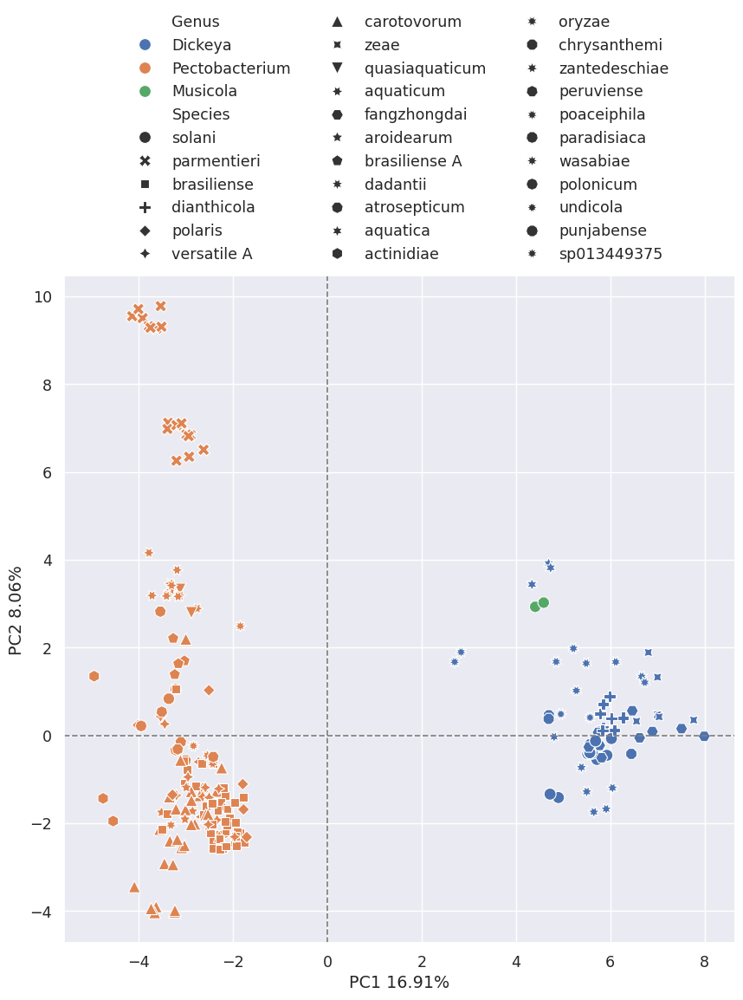

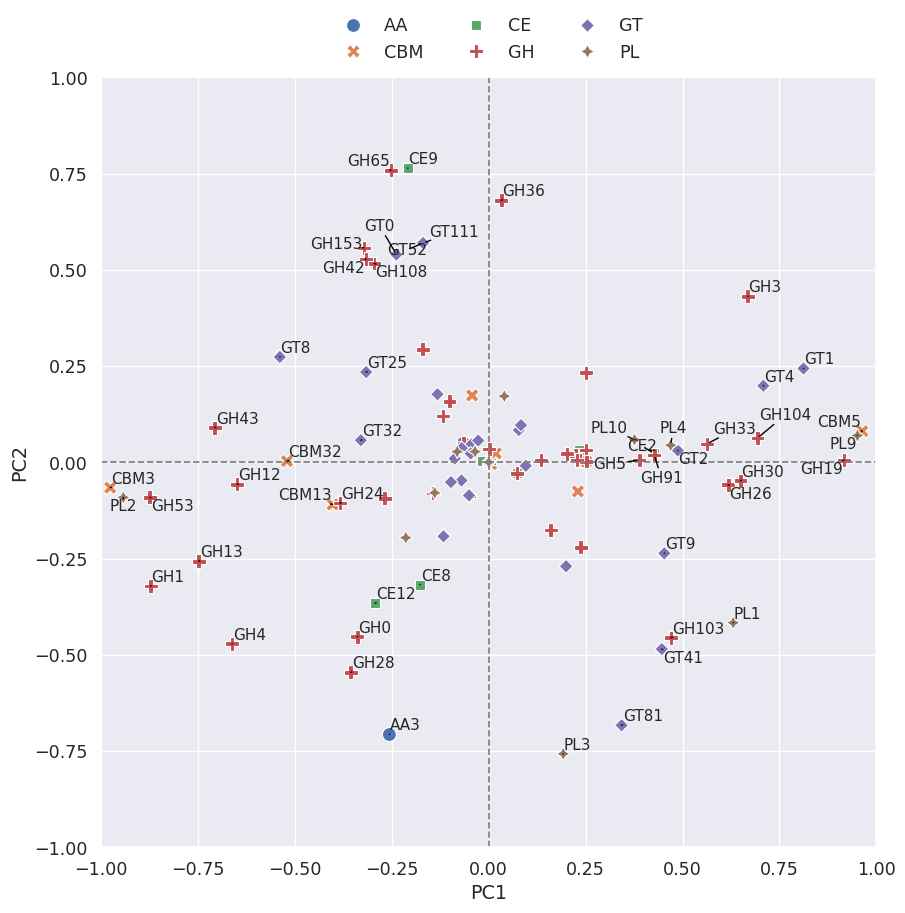

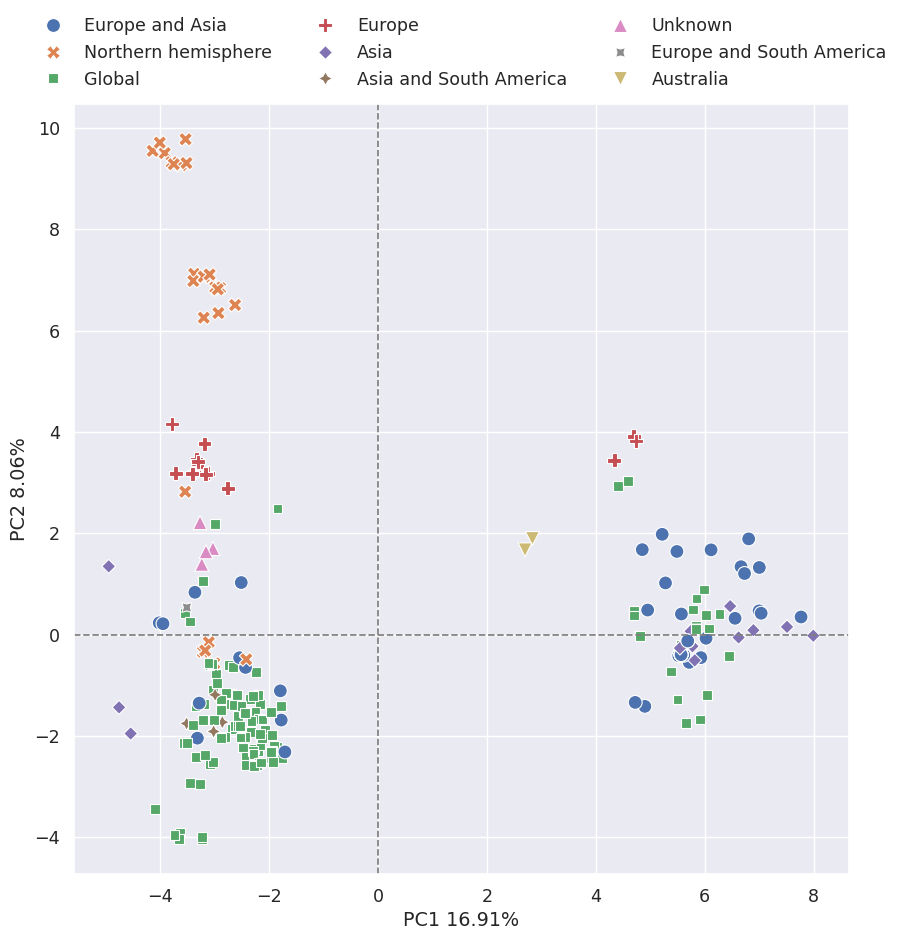

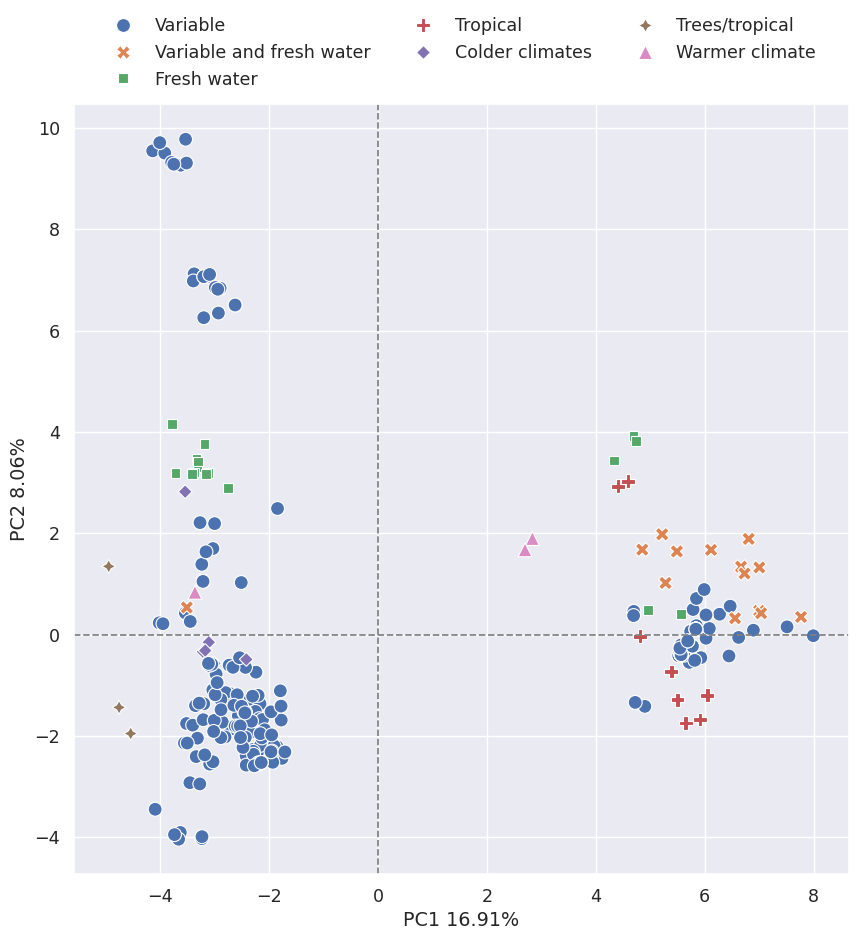

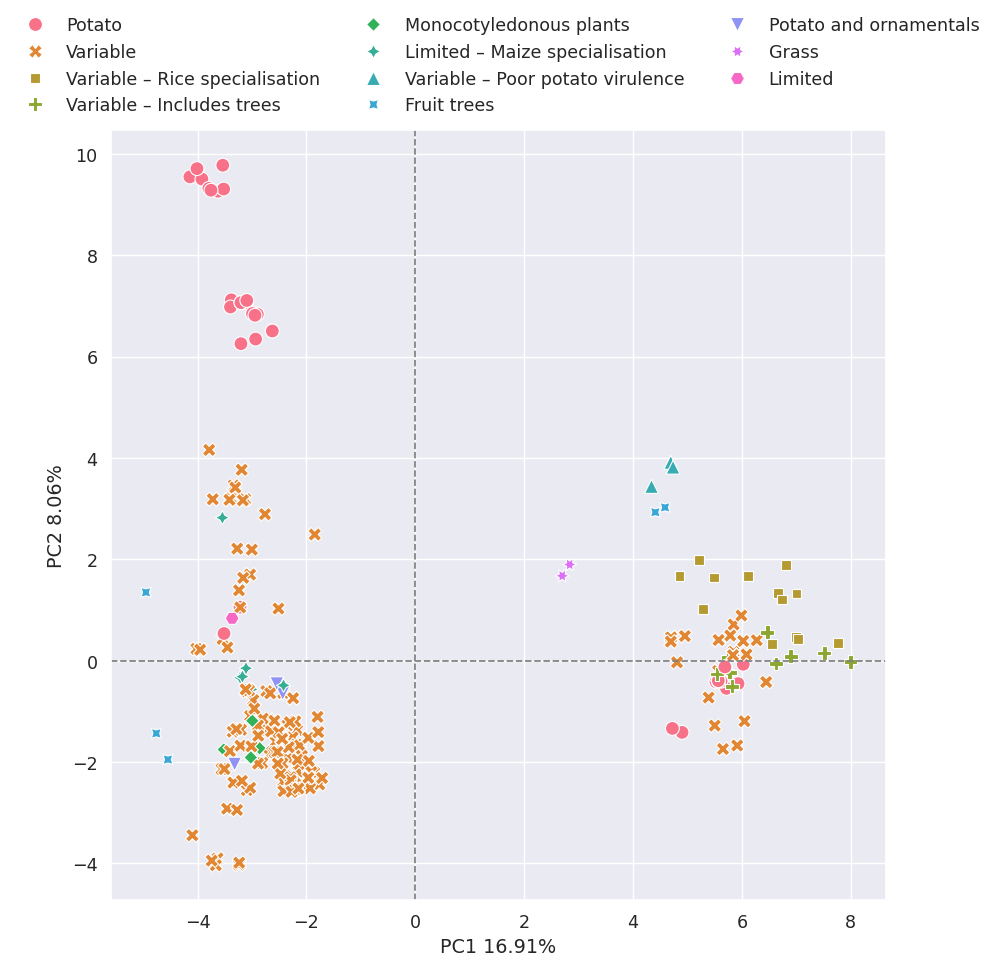

...

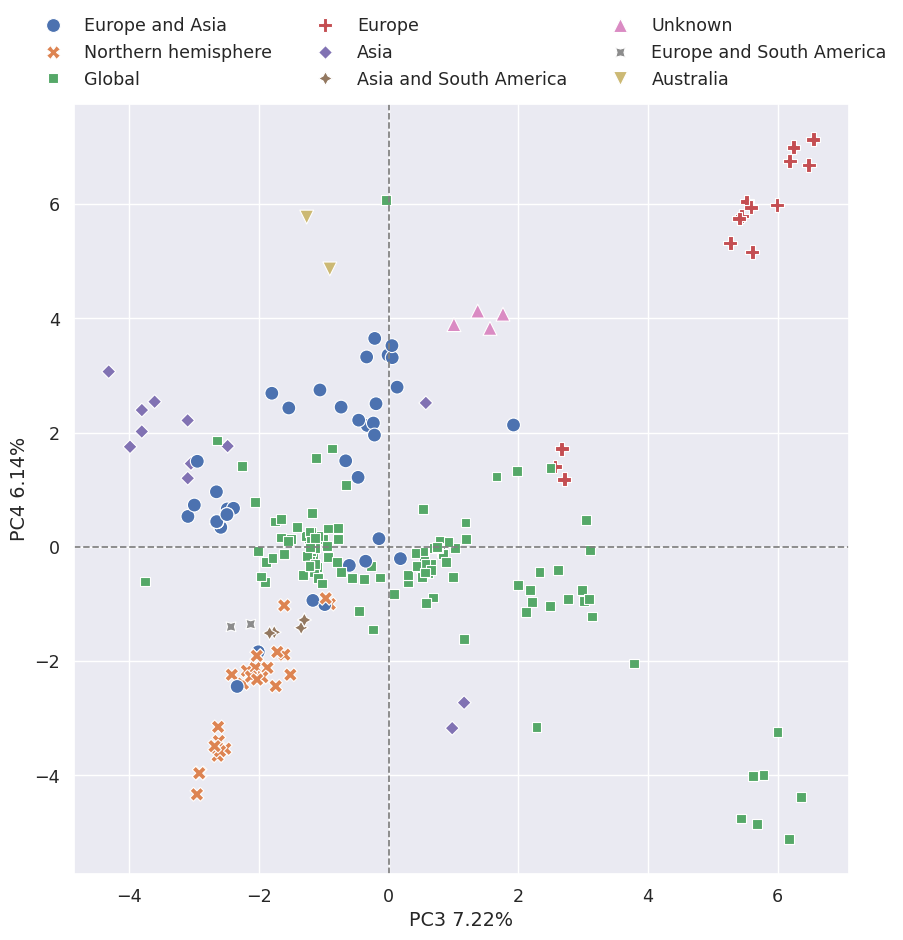

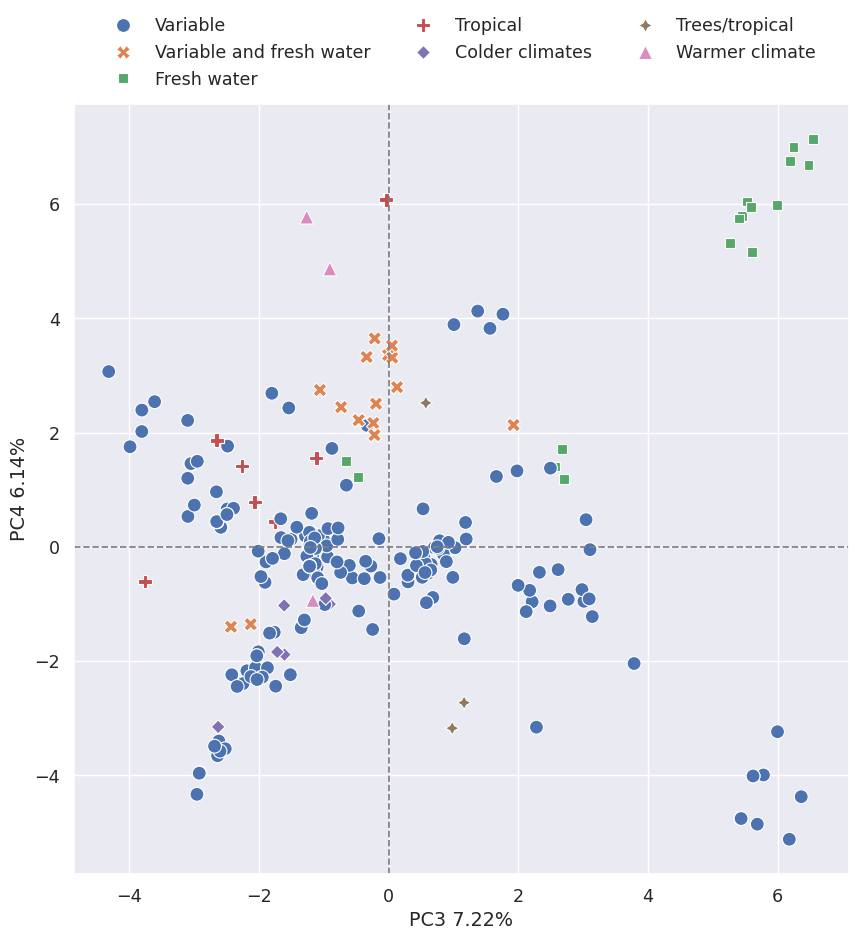

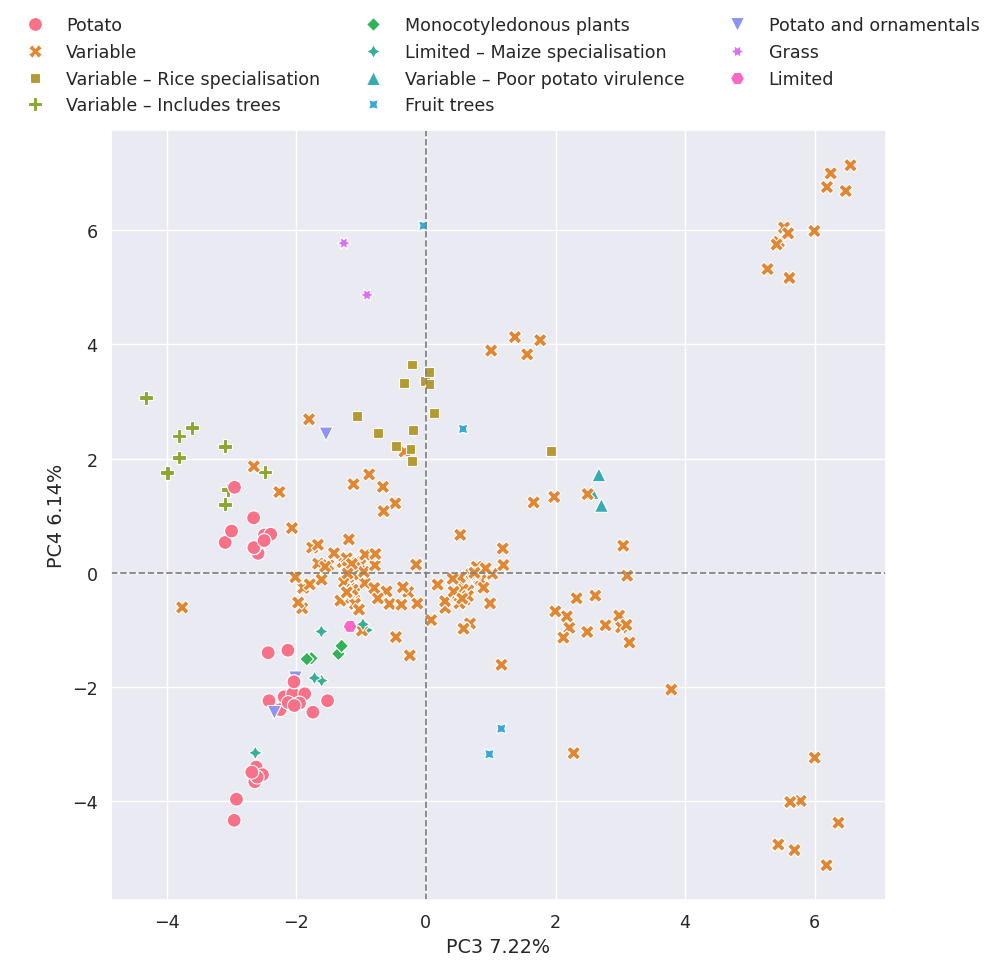

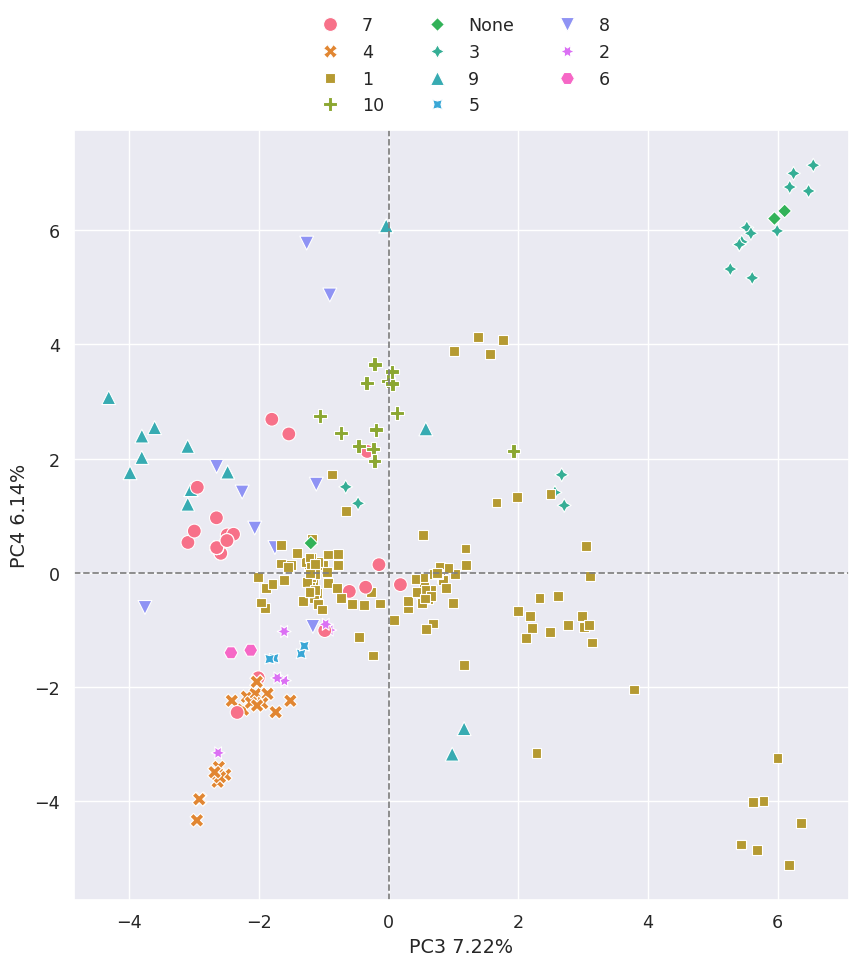

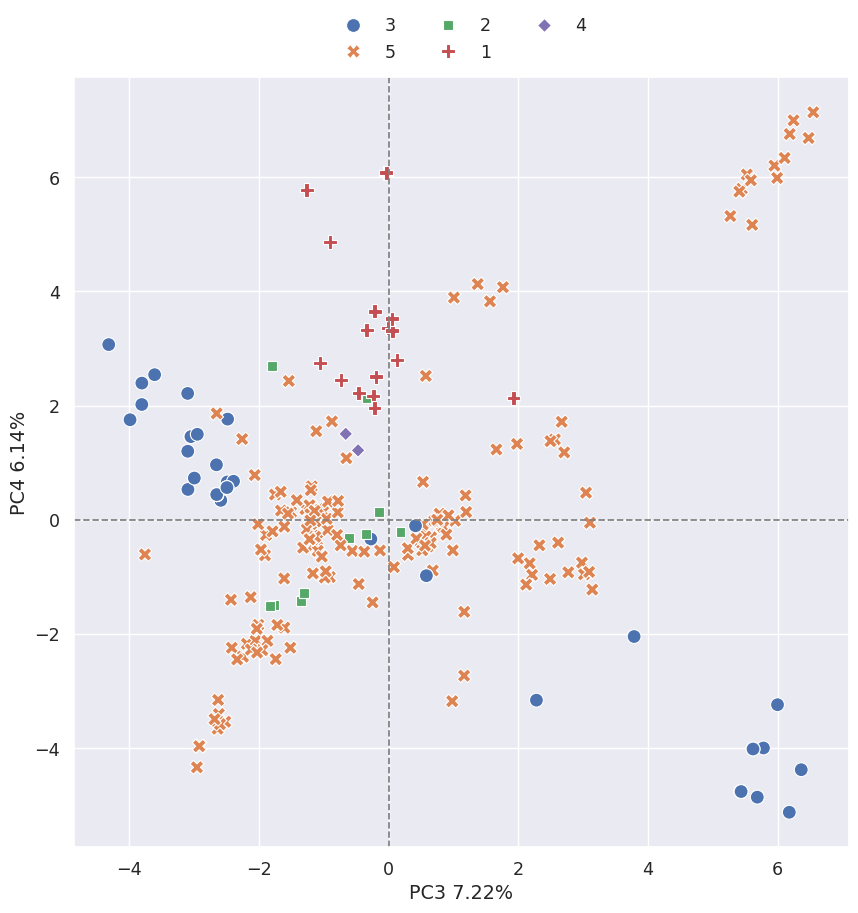

In [68]:
make_output_directory(Path("../results/pca/pecto_dic/niche_mapping/"), force=True, nodelete=True)

pc_pairs = [(1,2), (1,3), (1,4), (1,5), (2,3), (2,4), (3,4)]
columns = ['Species', 'Loadings', 'Distribution','Climate','Host','Group', 'Carbon-Metabolism']
fam_freq_df_ggs['Species'] = list(fam_freq_df_pd['Species'])
fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus'])

for pc_pair in pc_pairs:
    for col in columns:
        print(f"Below: PC{pc_pair[0]} vs PC{pc_pair[1]} - Colour coded by {col}")
        if col == 'Species':
            plot_pca(
                pd_pca,
                X_scaled,
                fam_freq_df_ggs,
                pc_pair[0],
                pc_pair[1],
                'Genus',
                figsize=(10,10),
                style=col,
            )
        
        elif col == 'Loadings':
            # loadings plot 
            plot_loadings(
                pd_pca,
                fam_freq_df_ggs[fam_freq_df_ggs.columns[:-7]],
                pc_pair[0],
                pc_pair[1],
                threshold=0.3,
                fig_size=(10,10),
                font_size=11,
                style=True,
            )
        
        else:
            plot_pca(
                pd_pca,
                X_scaled,
                fam_freq_df_ggs,
                pc_pair[0],
                pc_pair[1],
                col,
                figsize=(10,10),
                style=col,
                file_path=f"../results/pca/pecto_dic/niche_mapping/pd_pc{pc_pair[0]}_pc{pc_pair[1]}_{col}_plot",
            )

## 

## 7. Genus specific PCA

Rerun the PCA but for only genomes from each of the genera.

In [69]:
# add column to separate genomes into respective genera
fam_freq_df_ggs['Genus'] = list(fam_freq_df_pd['Genus'])

# create one df for each genus
fam_freq_df_pecto = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Pectobacterium']
fam_freq_df_dic = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Dickeya']

# drop the Genus column so columns only contain numerical data
fam_freq_df_pecto = fam_freq_df_pecto.drop('Genus', axis=1)
fam_freq_df_dic = fam_freq_df_dic.drop('Genus', axis=1)

### _Pectobacterium_

In [70]:
# exclude species column from pca
pecto_num_of_components = len(fam_freq_df_pecto.columns[:-6])
pecto_pca, pecto_X_scaled = perform_pca(
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    pecto_num_of_components,
)
pecto_pca

PCA(n_components=103)

Output directory ../results/pca/pecto exists, nodelete is True. Adding output to output directory.


Number of features needed to explain 0.95 fraction of total variance is 37. 


<Figure size 1200x600 with 0 Axes>

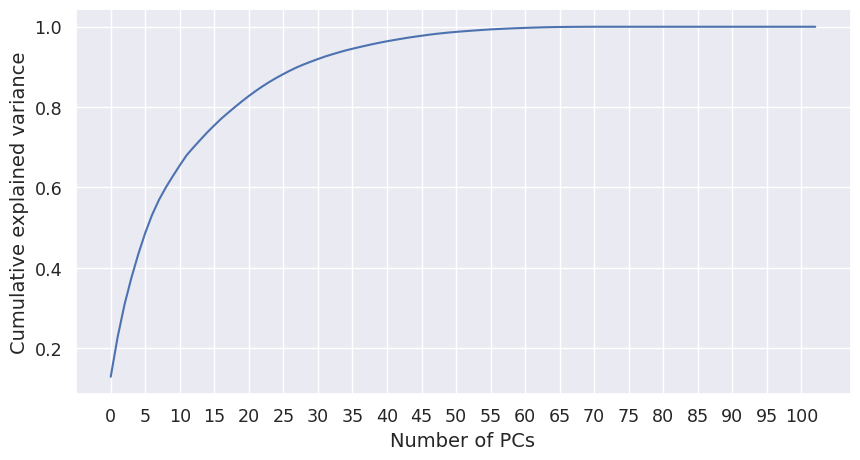

In [71]:
make_output_directory(Path("../results/pca/pecto/"), force=True, nodelete=True)
cumExpVar = plot_explained_variance(
    pecto_pca,
    pecto_num_of_components,
    file_path="../results/pca/pecto/pecto_explained_variance.png",
)

In [72]:
print(f"{pecto_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

100.0% of the variance in the data set was catpured by the PCA


Explained variance for 1PC: 0.1288094991239525
Explained variance for 2PC: 0.09867142062115815
Explained variance for 3PC: 0.08137220611258046
Explained variance for 4PC: 0.06666524273337604
Explained variance for 5PC: 0.05894511557943021
Explained variance for 6PC: 0.05261555241250664
Explained variance for 7PC: 0.045248770576620065
Explained variance for 8PC: 0.03724207873504617
Explained variance for 9PC: 0.031080659482280365
Explained variance for 10PC: 0.02781621702171926


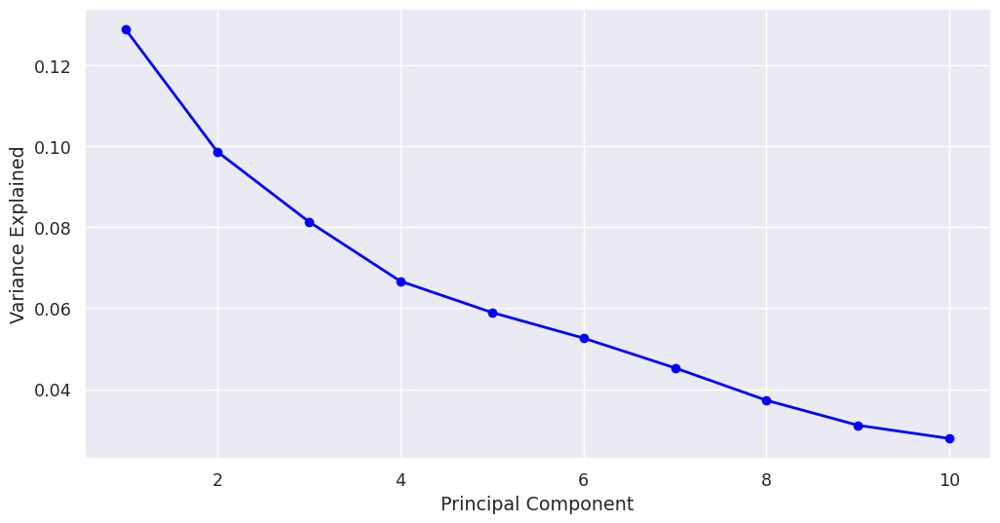

In [73]:
plot_scree(pecto_pca, nComp=10, file_path="../results/pca/pecto/pecto_scree_plot.png")

Not applying hue order
Applying style
Not applying style order


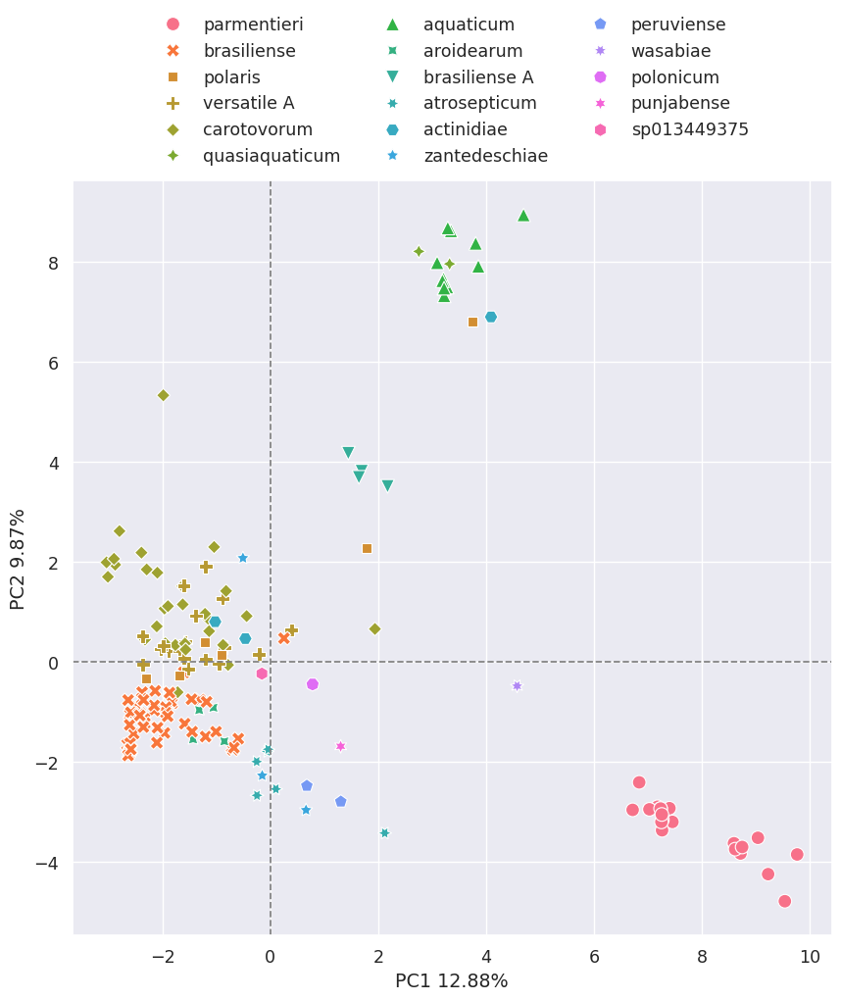

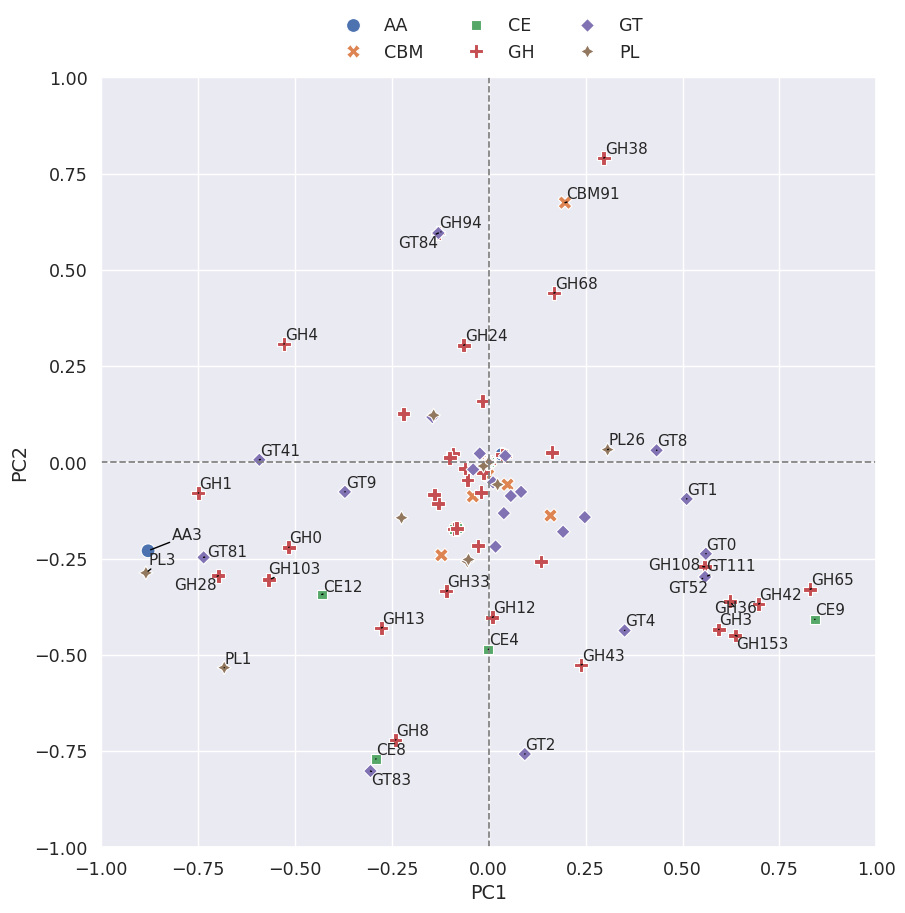

In [74]:
fam_freq_df_ggs['Species'] = list(fam_freq_df_pd['Species'])  # add column to use for colour scheme
temp_df = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Pectobacterium']
fam_freq_df_pecto['Species'] = list(temp_df['Species'])

pc1_pc2_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    1,
    2,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/pecto/pecto_pc1_pc2.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    1,
    2,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc1_pc2_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


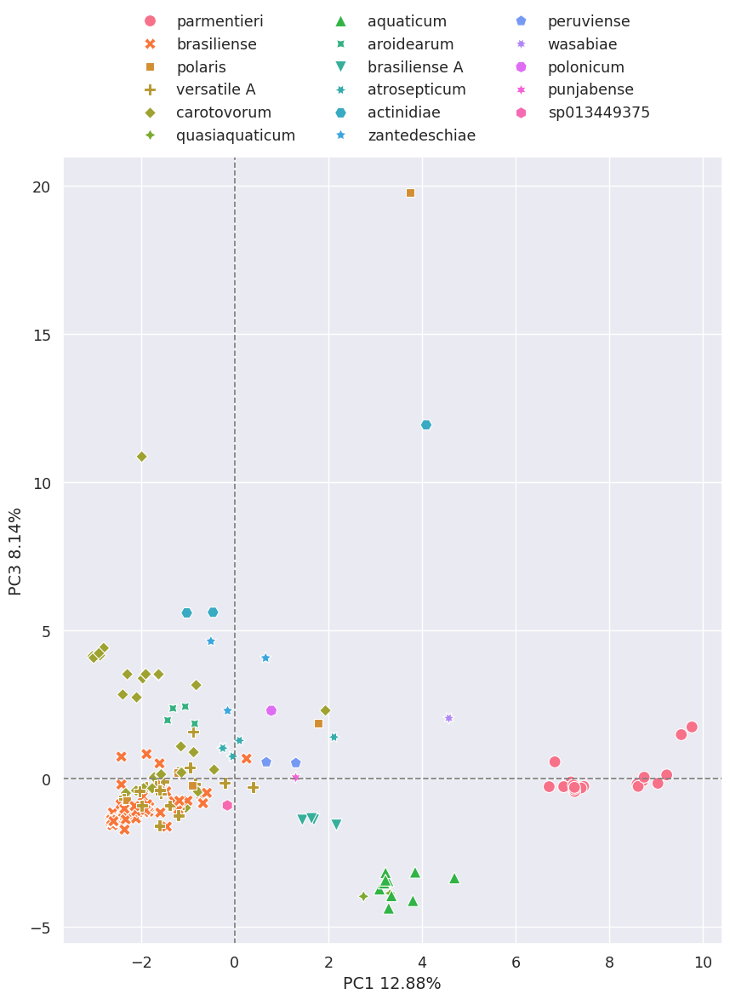

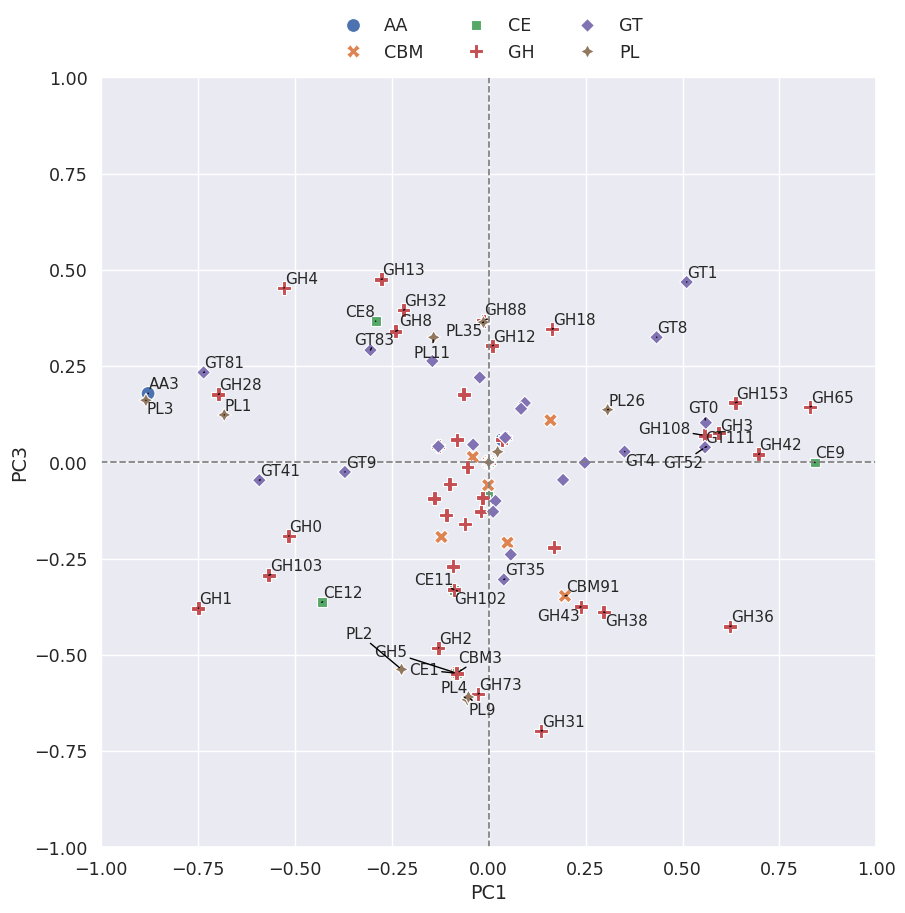

In [75]:
pc1_pc3_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    1,
    3,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/pecto/pecto_pc1_pc3.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    1,
    3,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc1_pc3_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


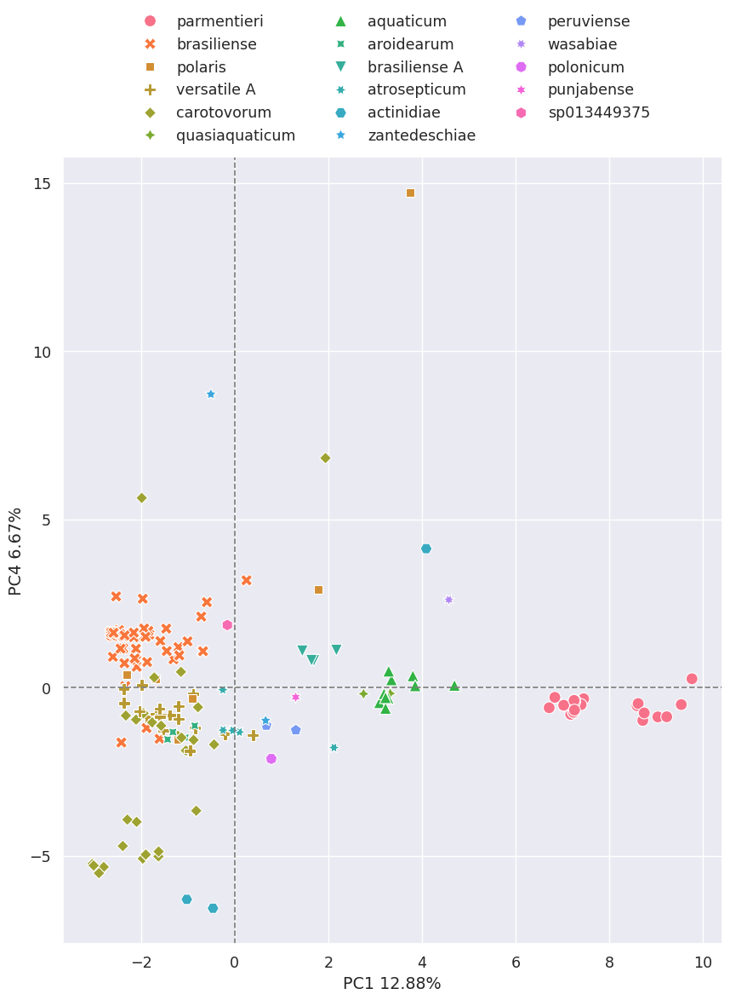

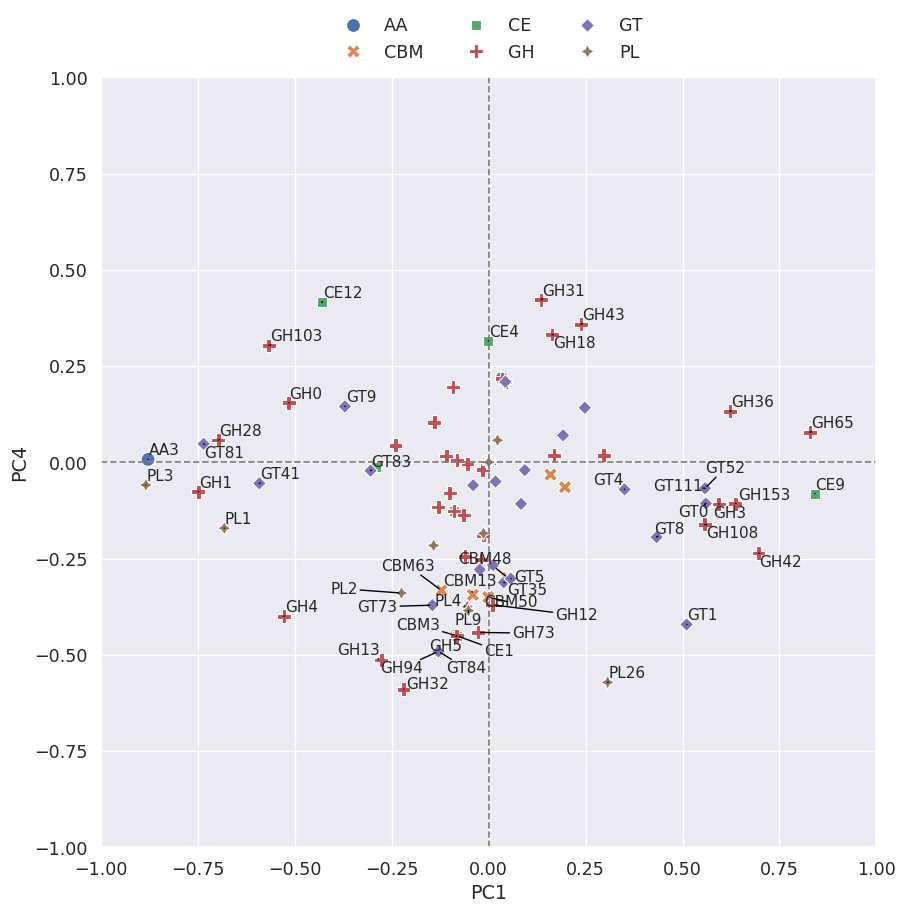

In [76]:
pc1_pc4_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    1,
    4,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/pecto/pecto_pc1_pc4.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    1,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc1_pc24_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


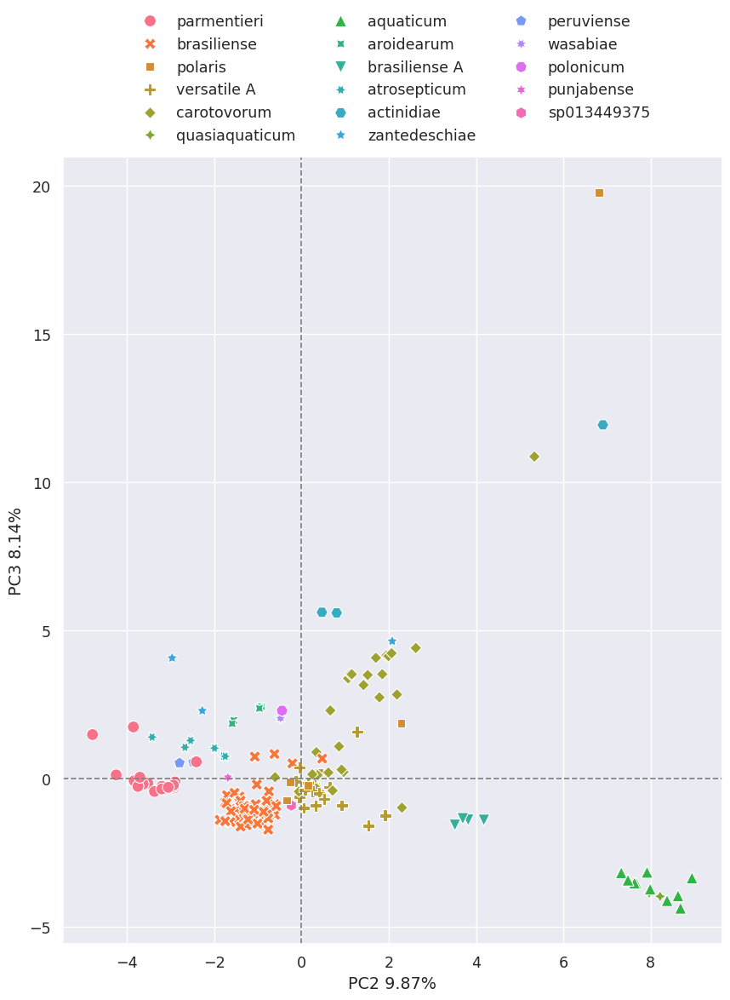

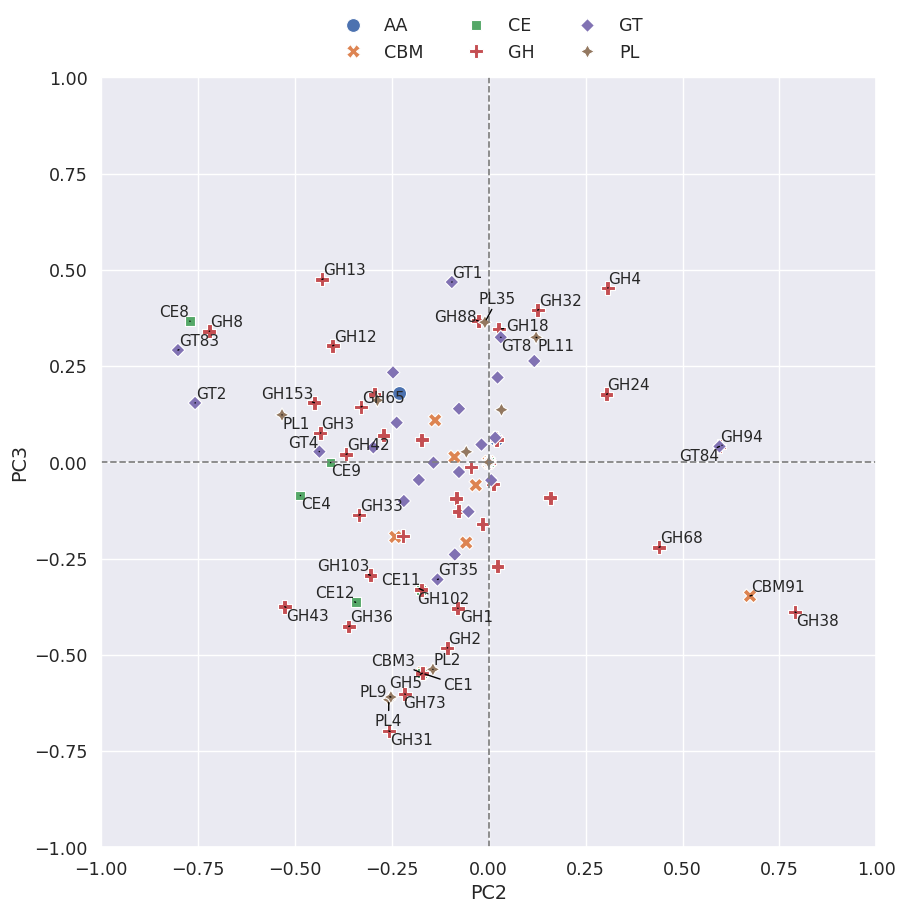

In [77]:
pc2_pc3_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    2,
    3,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/pecto/pecto_pc2_pc3.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    2,
    3,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc2_pc3_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


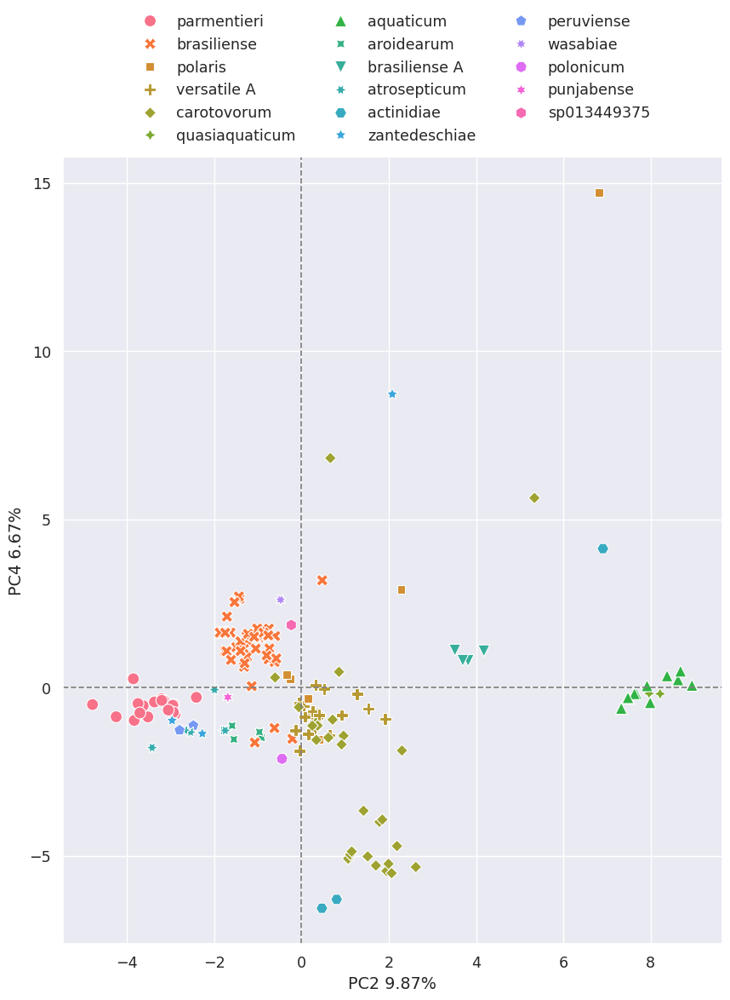

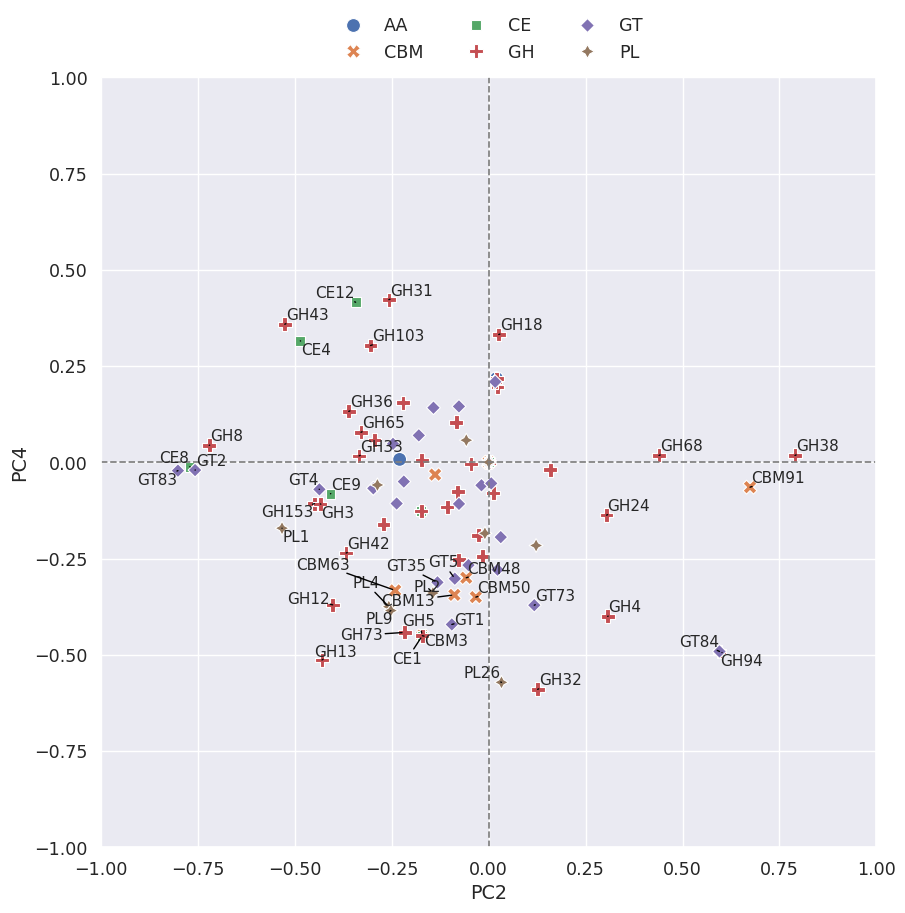

In [78]:
pc2_pc4_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    2,
    4,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/pecto/pecto_pc2_pc4.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    2,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc2_pc4_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


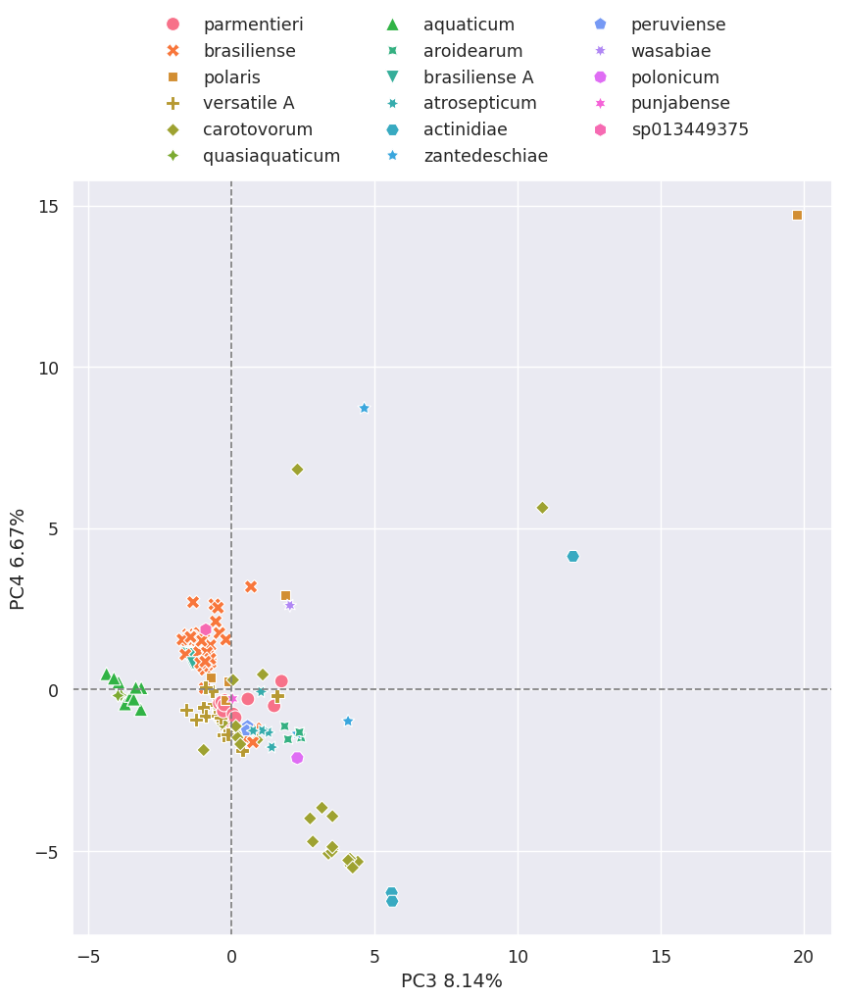

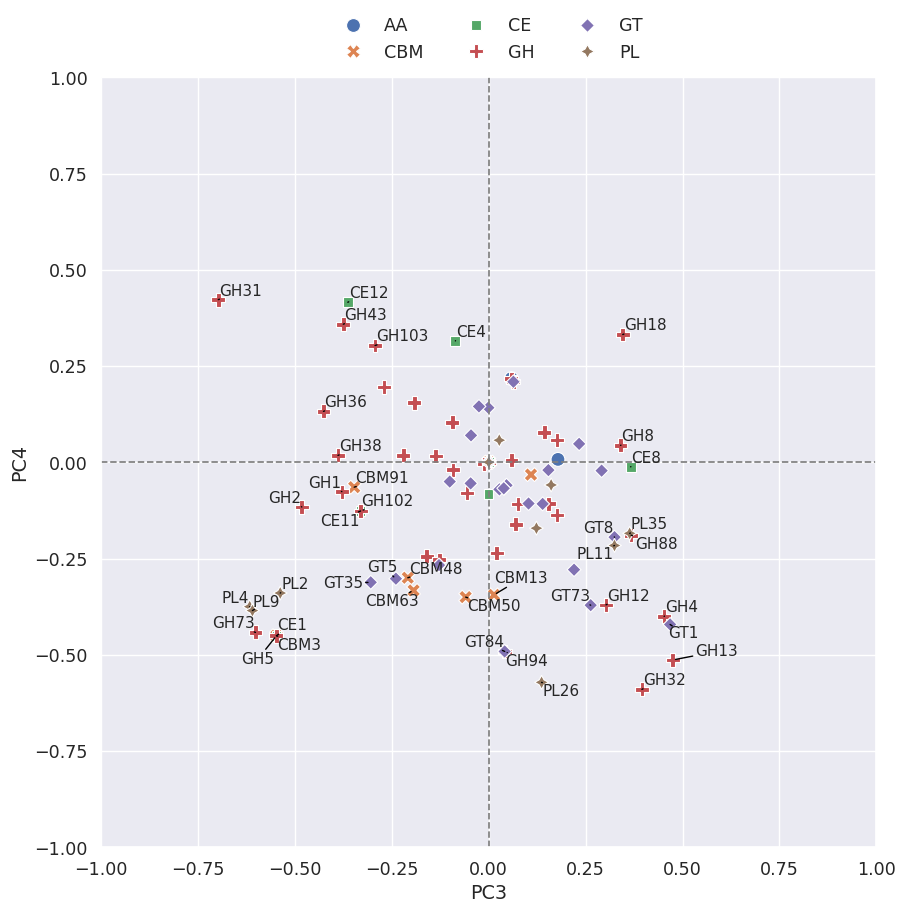

In [79]:
pc3_pc4_scatter_plt = plot_pca(
    pecto_pca,
    pecto_X_scaled,
    fam_freq_df_pecto,
    3,
    4,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/pecto/pecto_pc3_pc4.png",
)

plot_loadings(
    pecto_pca,
    fam_freq_df_pecto[fam_freq_df_pecto.columns[:-6]],
    3,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/pecto/pecto_pc3_pc4_loadings_plot",
    font_size=11,
    style=True,
)

The _P.carotovorum_ species repeated splits into two groups or clusters on the above PCA plots.

Annotate the genomes and look at the phylogenetic tree.

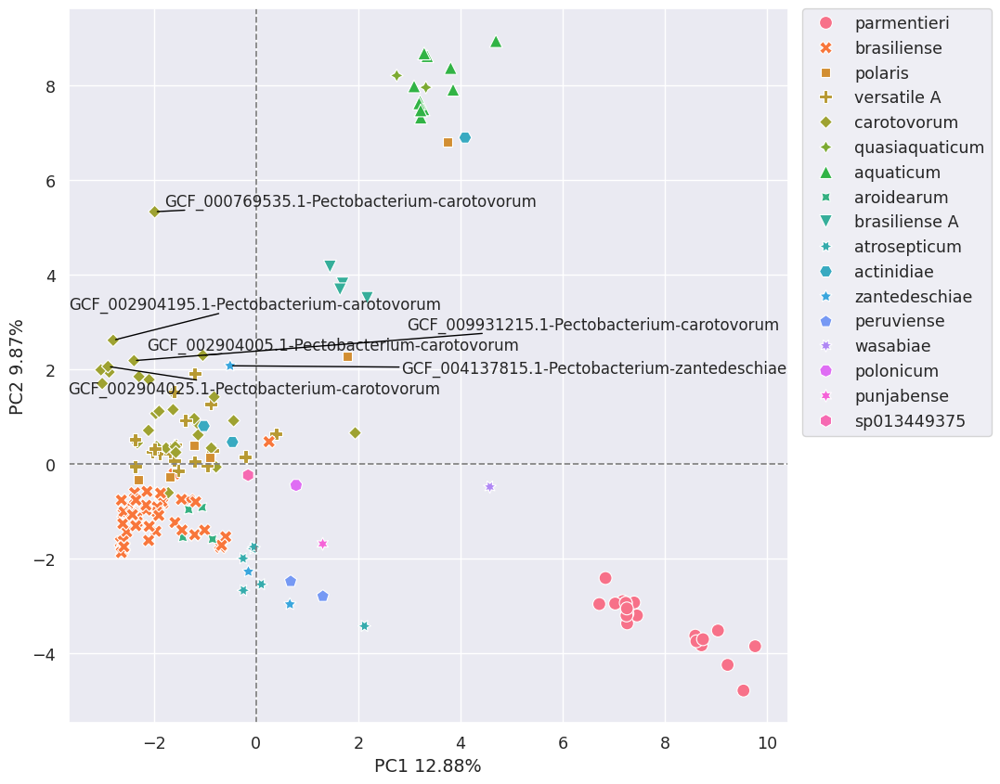

In [80]:
X_pca = pecto_pca.transform(pecto_X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

g = sns.scatterplot(
    x=X_pca[:,0],
    y=X_pca[:,1],
    data=fam_freq_df_pecto,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * pecto_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * pecto_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

genome_lbls = ["-".join(_) for _ in fam_freq_df_pecto.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if ((yval > 2) and (xval < 0))
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto/pecto_pc1_pc2_LABELLED.png', bbox_inches='tight', format='png')

In [81]:
import re
small_pc_group = [re.match(r"GCF_\d+.\d+-", _.properties()['text']).group()[:-1] for _ in texts]
with open("../data/genomic_accessions/small_p-carotovorum_grp", "w") as fh:
    for genome in small_pc_group:
        fh.write(f"{genome}\n")
        
a = ""
for g in small_pc_group:
    a += f" {g}"
a

' GCF_009931215.1 GCF_002904005.1 GCF_002904195.1 GCF_004137815.1 GCF_002904025.1 GCF_000769535.1'

In [82]:
large_pc_group = []
for i in range(len(fam_freq_df_pecto)):
    sp = fam_freq_df_pecto.iloc[i].name[-1]
    if sp.startswith("carotovorum"):
        gnm = fam_freq_df_pecto.iloc[i].name[0]
        if gnm not in small_pc_group:
            large_pc_group.append(gnm)
with open("../data/genomic_accessions/large_p-carotovorum_grp", "w") as fh:
    for genome in large_pc_group:
        fh.write(f"{genome}\n")

In [83]:
pc_group = []
for i in range(len(fam_freq_df_pecto)):
    genus = fam_freq_df_pecto.iloc[i].name[1]
    if genus == 'Pectobacterium':
        pc_group.append(gnm)
len(pc_group)

188

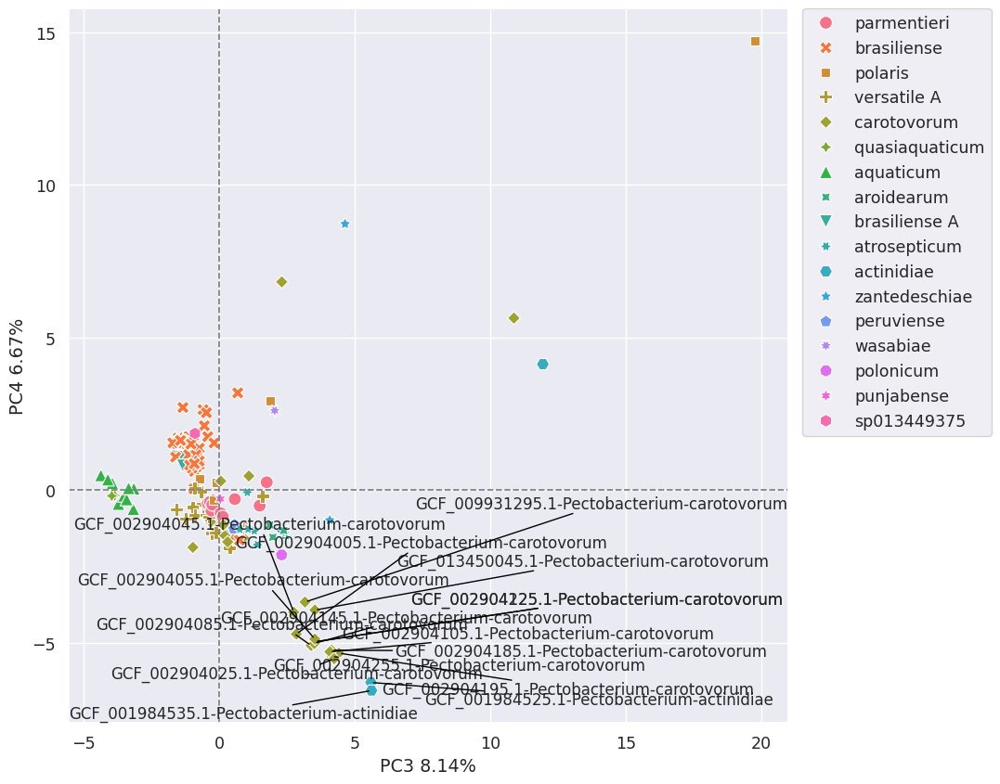

In [84]:
X_pca = pecto_pca.transform(pecto_X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

g = sns.scatterplot(
    x=X_pca[:,2],
    y=X_pca[:,3],
    data=fam_freq_df_pecto,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.xlabel(f"PC3 {100 * pecto_pca.explained_variance_ratio_[2]:.2f}%");
plt.ylabel(f"PC4 {100 * pecto_pca.explained_variance_ratio_[3]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

genome_lbls = ["-".join(_) for _ in fam_freq_df_pecto.index]
x_vals = X_pca[:,2]
y_vals = X_pca[:,3]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if ((yval < -2.5) and (xval > 2.5))
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/pecto/pecto_pc3_pc4_LABELLED.png', bbox_inches='tight', format='png')

### Dickeya

In [85]:
dic_num_of_components = len(fam_freq_df_dic)
dic_pca, dic_X_scaled = perform_pca(
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    dic_num_of_components,
)
dic_pca

PCA(n_components=90)

Output directory ../results/pca/dickeya exists, nodelete is True. Adding output to output directory.


Number of features needed to explain 0.95 fraction of total variance is 25. 


<Figure size 1200x600 with 0 Axes>

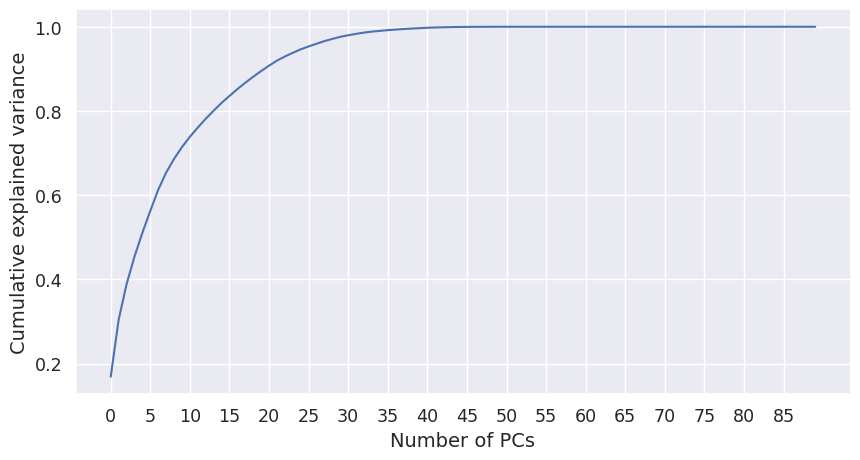

In [86]:
make_output_directory(Path("../results/pca/dickeya/"), force=True, nodelete=True)

cumExpVar = plot_explained_variance(
    dic_pca,
    dic_num_of_components,
    file_path="../results/pca/dickeya/dic_explained_variance.png",
)

In [87]:
print(f"{dic_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

100.0% of the variance in the data set was catpured by the PCA


Explained variance for 1PC: 0.16882456007544758
Explained variance for 2PC: 0.13528682331629904
Explained variance for 3PC: 0.08442204502051477
Explained variance for 4PC: 0.06560367524275842
Explained variance for 5PC: 0.05673883152920681
Explained variance for 6PC: 0.05198576365429983
Explained variance for 7PC: 0.050035678921381714
Explained variance for 8PC: 0.04088558780923047
Explained variance for 9PC: 0.032418292152083715
Explained variance for 10PC: 0.028025122685904142


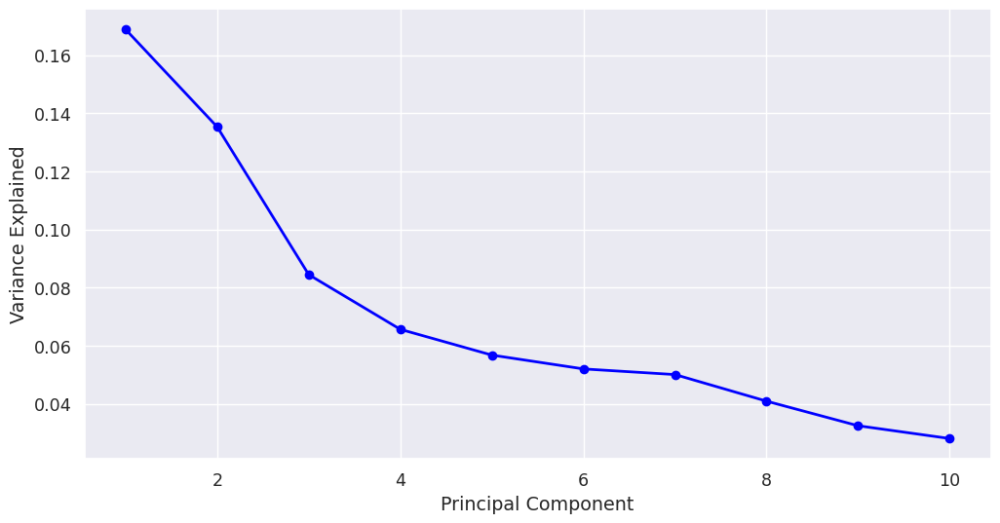

In [88]:
plot_scree(dic_pca, nComp=10, file_path="../results/pca/dickeya/dic_scree_plot.png")

Not applying hue order
Applying style
Not applying style order


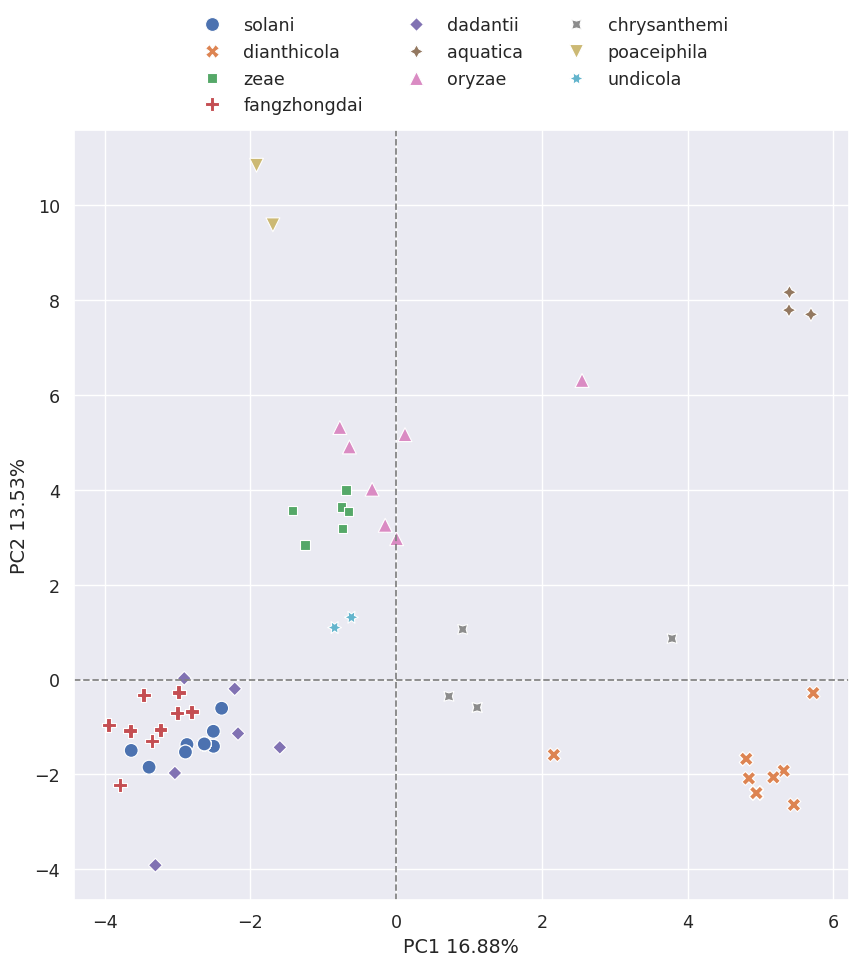

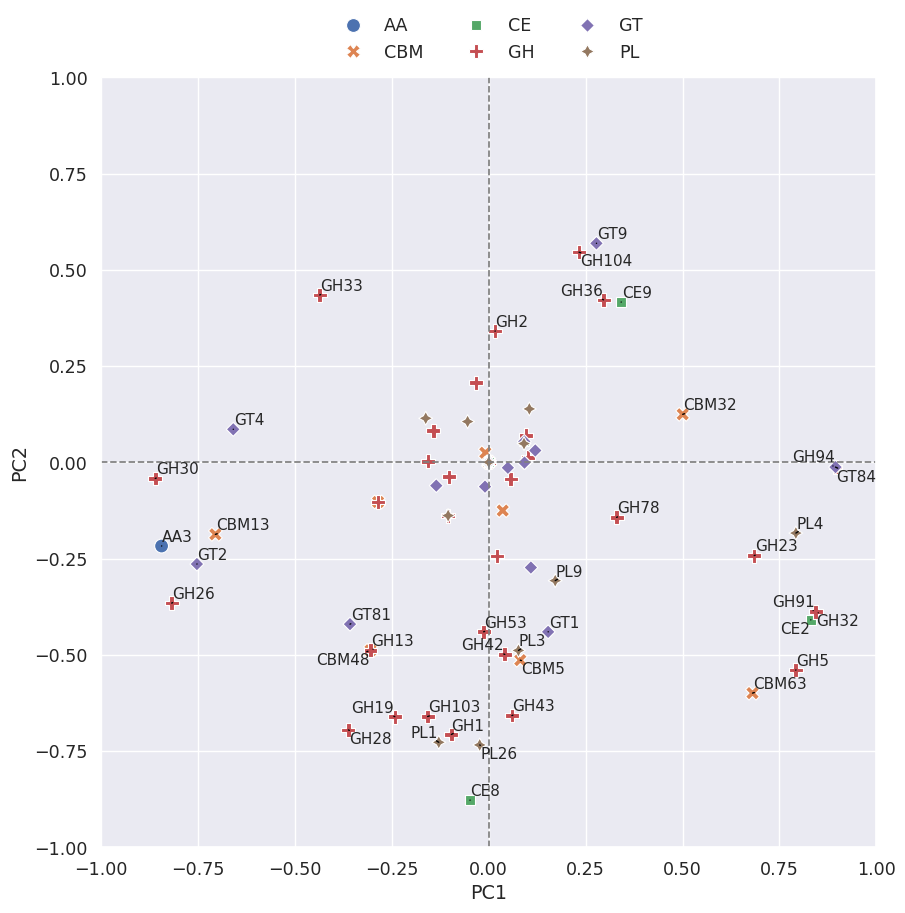

In [89]:
fam_freq_df_ggs['Species'] = list(fam_freq_df_pd['Species'])  # add column to use for colour scheme
temp_df = fam_freq_df_ggs[fam_freq_df_ggs['Genus'] == 'Dickeya']
fam_freq_df_dic['Species'] = list(temp_df['Species'])

pc1_pc2_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    1,
    2,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc2.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    1,
    2,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc2_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


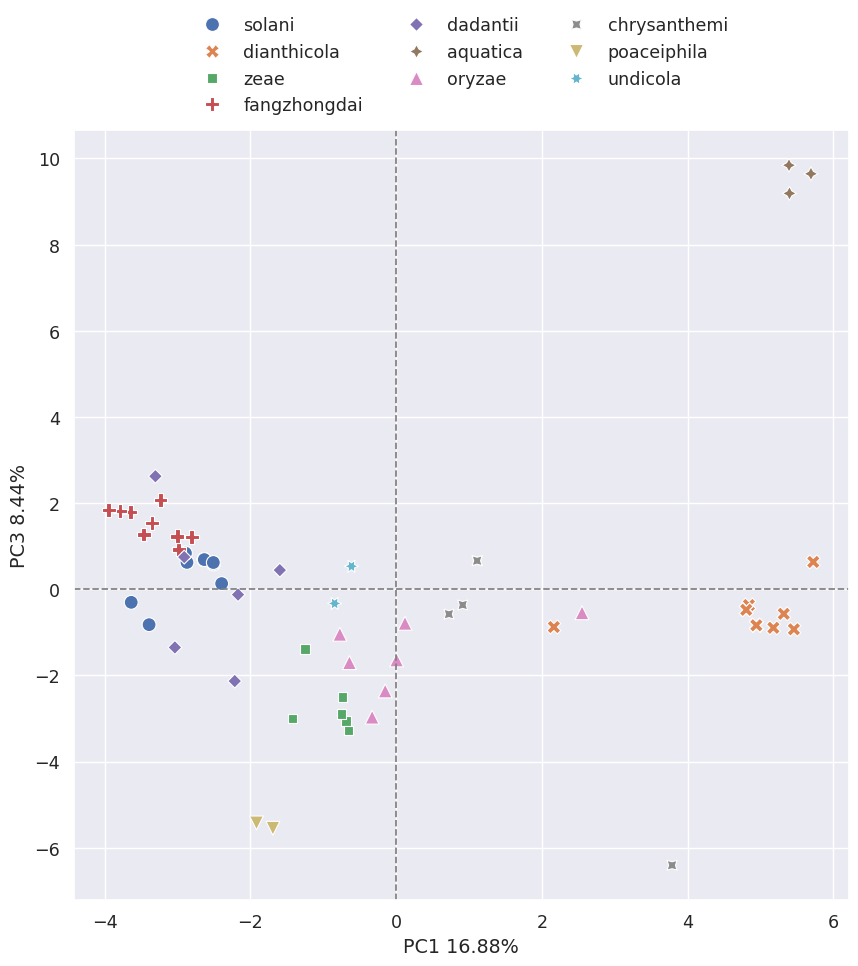

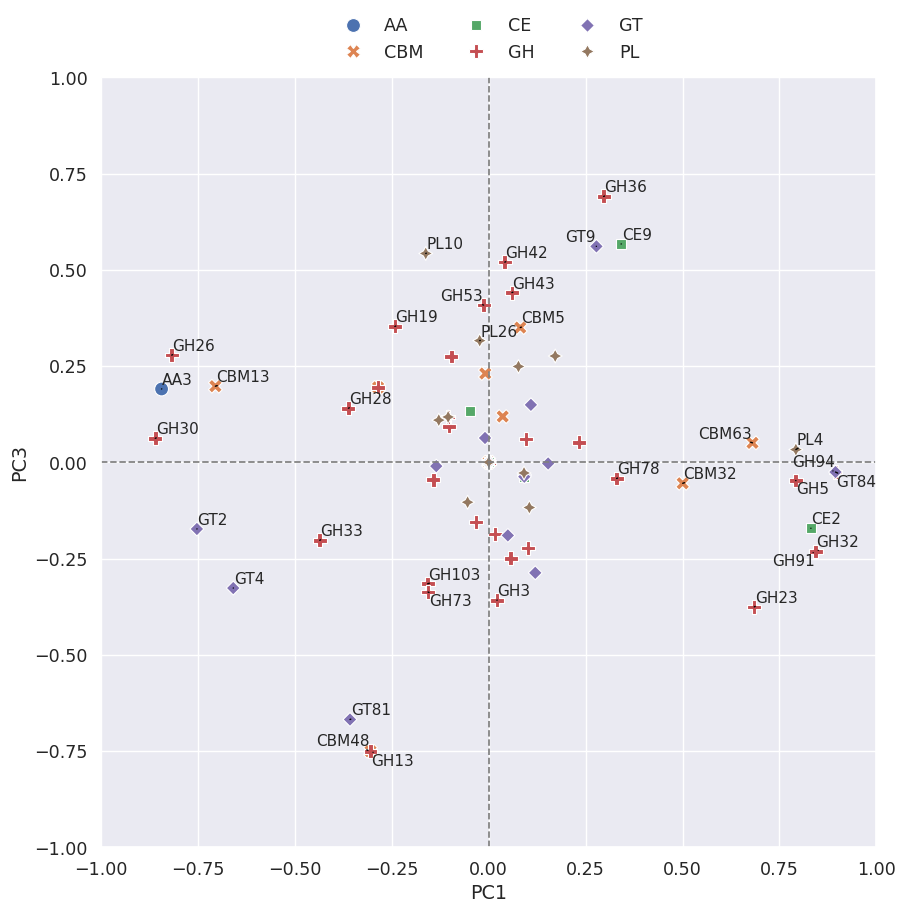

In [90]:
pc1_pc3_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    1,
    3,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc3.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    1,
    3,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc3_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


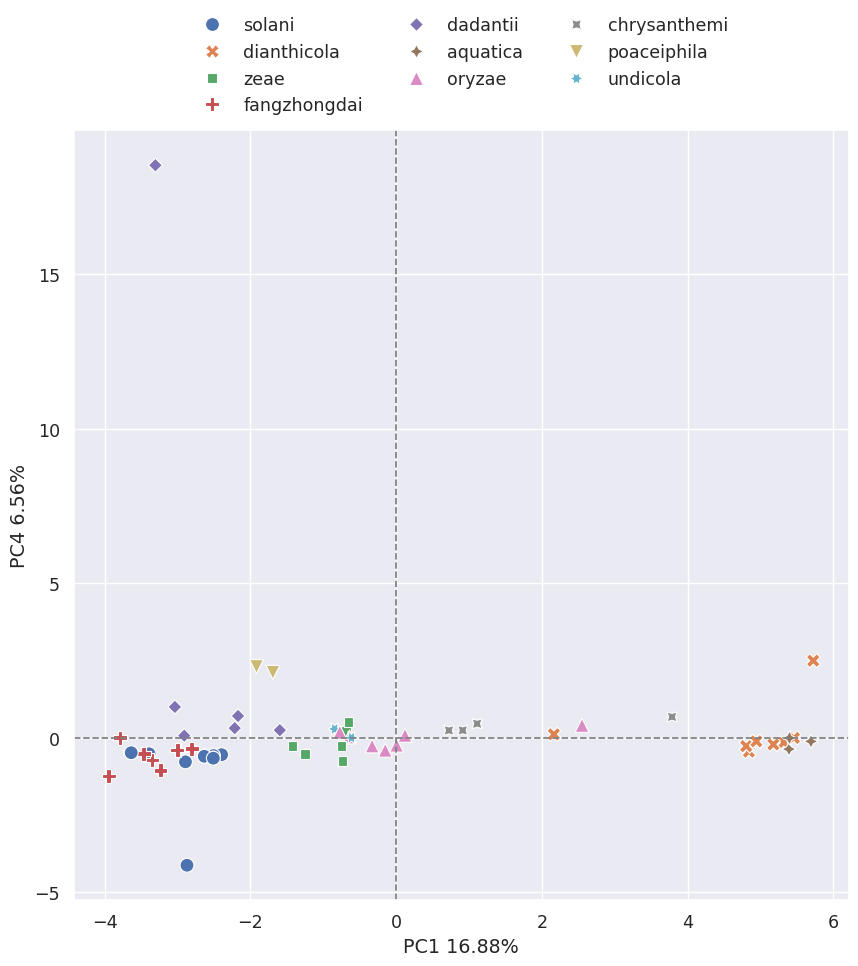

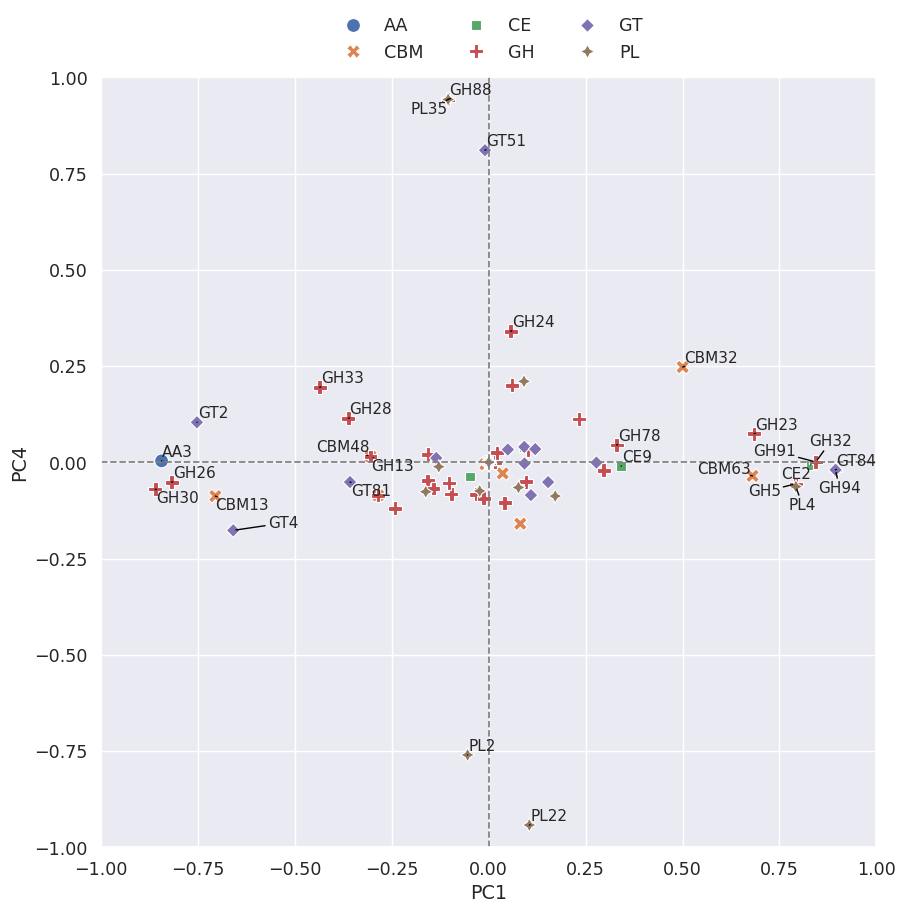

In [91]:
pc1_pc4_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    1,
    4,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc4.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    1,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc1_pc4_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


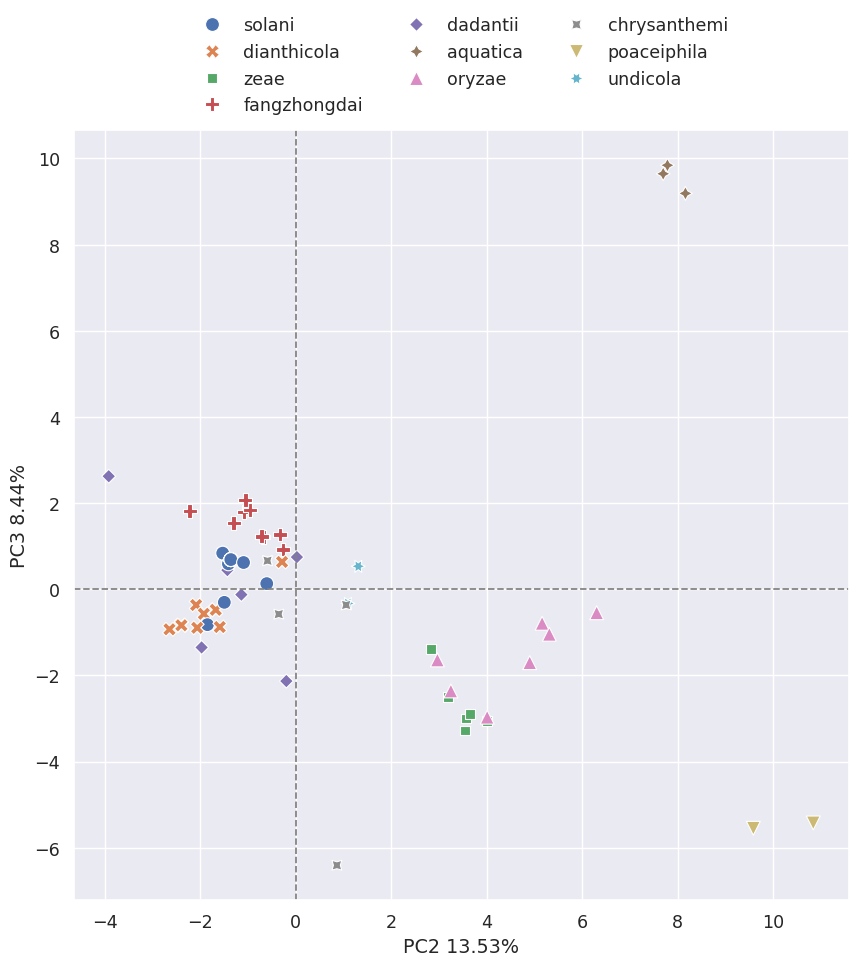

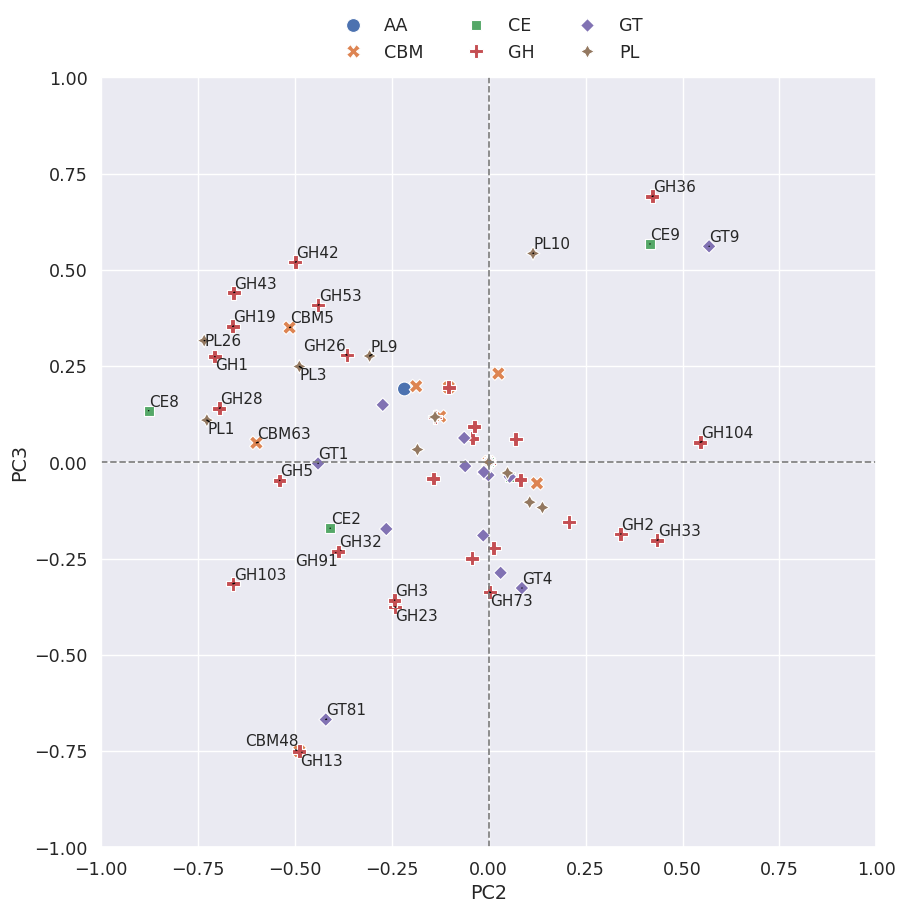

In [92]:
pc2_pc3_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    2,
    3,
    'Species',
    style='Species',
    figsize=(10,10),
    file_path="../results/pca/dickeya/dic_pc2_pc3.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    2,
    3,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc2_pc3_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


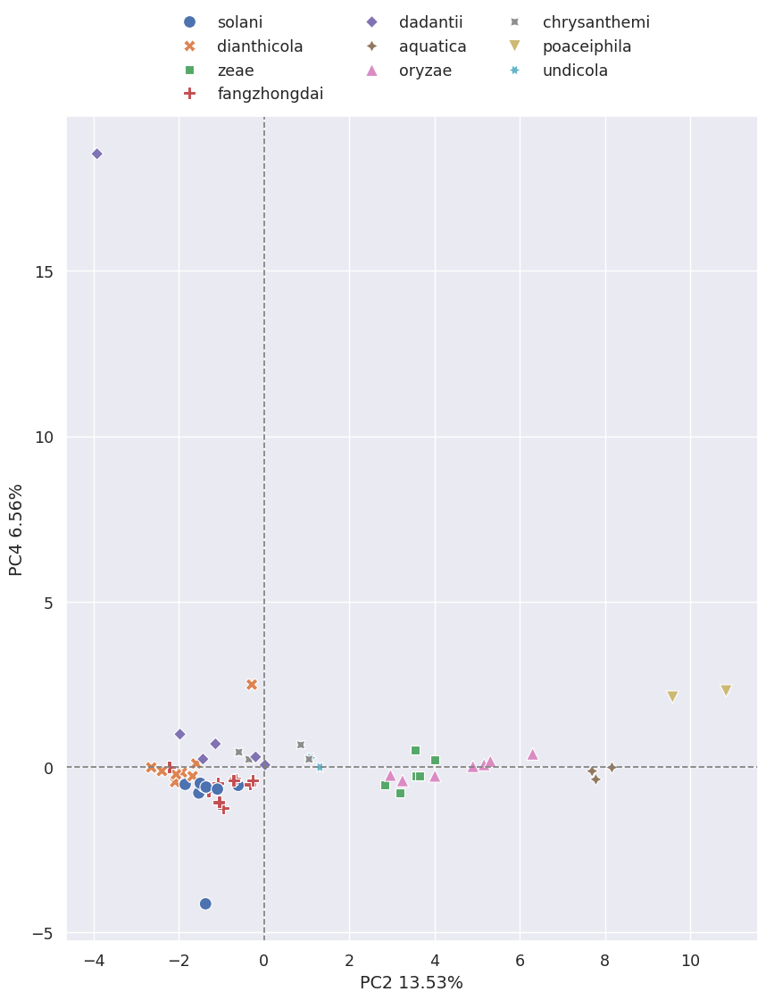

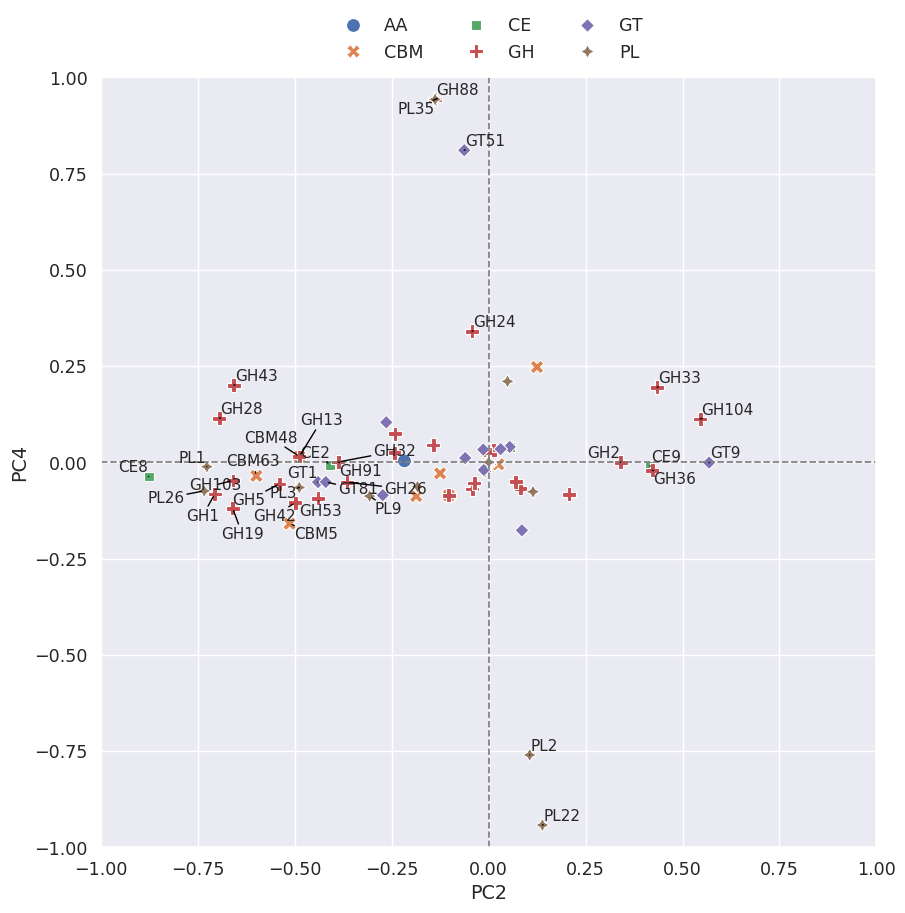

In [93]:
pc2_pc4_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    2,
    4,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/dickeya/dic_pc2_pc4.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    2,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc2_pc4_loadings_plot",
    font_size=11,
    style=True,
)

Not applying hue order
Applying style
Not applying style order


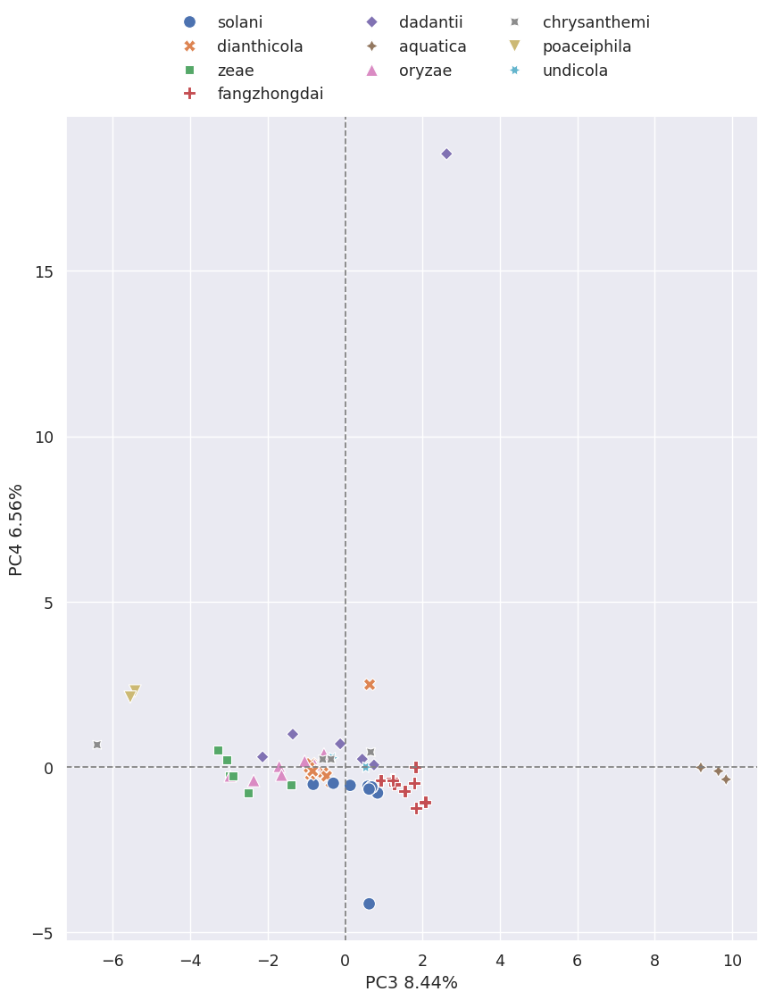

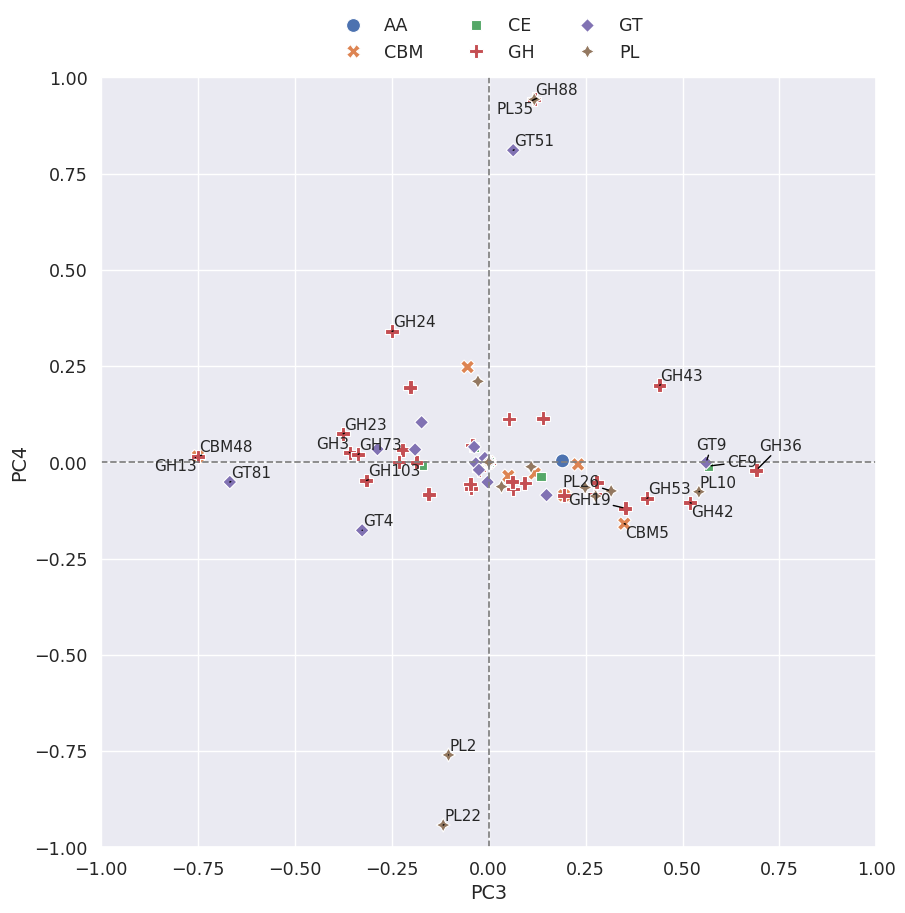

In [94]:
pc3_pc4_scatter_plt = plot_pca(
    dic_pca,
    dic_X_scaled,
    fam_freq_df_dic,
    3,
    4,
    'Species',
    style='Species',
    figsize=(10,12),
    file_path="../results/pca/dickeya/dic_pc3_pc4.png",
)

plot_loadings(
    dic_pca,
    fam_freq_df_dic[fam_freq_df_dic.columns[:-6]],
    3,
    4,
    threshold=0.3,
    fig_size=(10,10),
    file_path="../results/pca/dickeya/dic_pc3_pc4_loadings_plot",
    font_size=11,
    style=True,
)

PC4 separated out one _dadantii_ genome from all other _Dickeya_ genomes.

Regenerate the plot and label the genome.

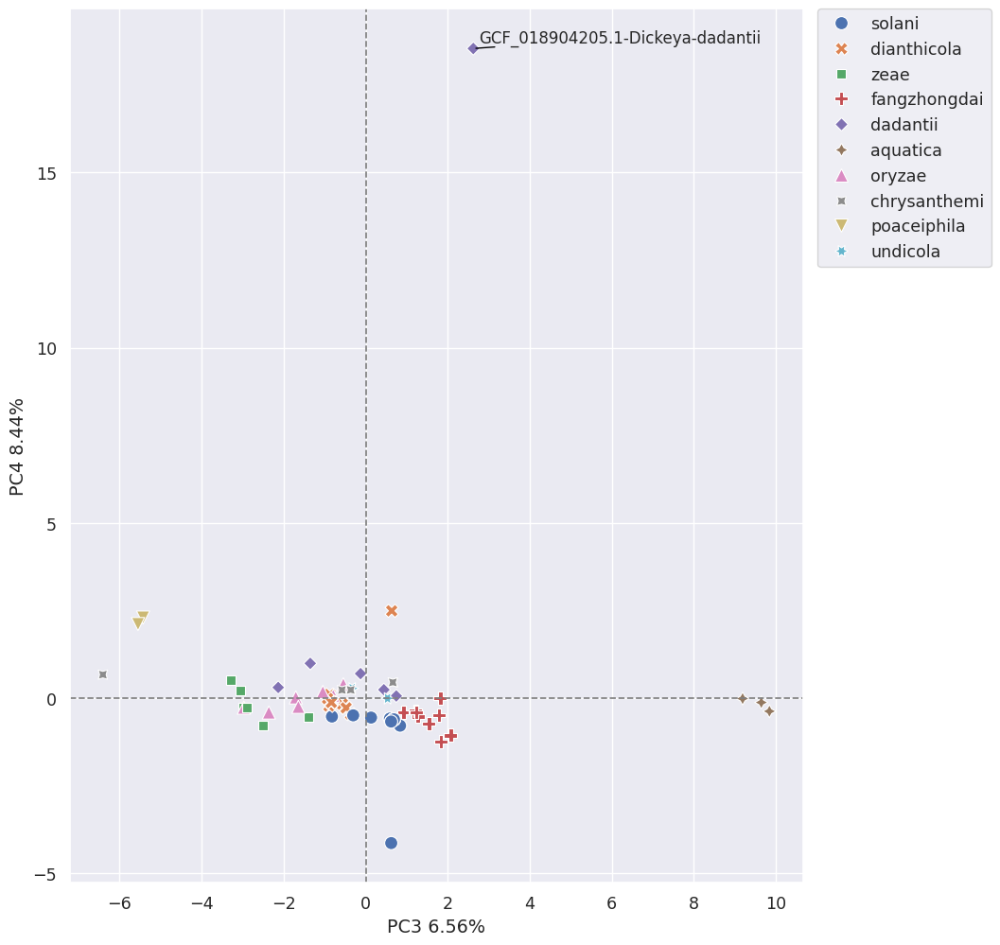

In [95]:
X_pca = dic_pca.transform(dic_X_scaled)

plt.figure(figsize=(10,12))
sns.set(font_scale=1.15)

g = sns.scatterplot(
    x=X_pca[:,2],
    y=X_pca[:,3],
    data=fam_freq_df_dic,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC4 {100 * dic_pca.explained_variance_ratio_[2]:.2f}%");
plt.xlabel(f"PC3 {100 * dic_pca.explained_variance_ratio_[3]:.2f}%");
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

genome_lbls = ["-".join(_) for _ in fam_freq_df_dic.index]
x_vals = X_pca[:,2]
y_vals = X_pca[:,3]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if (yval > 12)
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig('../results/pca/dickeya/dic_pc3_pc4_LABELLED.png', bbox_inches='tight', format='png')

Looking at the phylogenetic tree (which was reconstructed from SCOs by RaxML-NG), the _D.dadantii_ genome that is placed in isolation, is clustered with the other genomes from its species in the tree. However, the GCA\_018904205.1 genome was on a separate branch from the other genomes, and on a branch that diverged earlier.

# Intracellular and Extracellular CAZymes

The protein sequences of all CAZymes identified by dbCAN were parsed by SignalP ([Almagro et al., 2019](https://www.nature.com/articles/s41587-019-0036-z)), to predict the presence of signal peptides. Prediction of a signal peptide within a protein sequence was interrpreted as a prediction of an extracellular CAZyme, and thus no prediction of a signal peptide was interrpreted as the classification of an intracellular CAZyme.

> Almagro Armenteros JJ, Tsirigos KD, Sønderby CK, Petersen TN, Winther O, Brunak S, von Heijne G, Nielsen H. SignalP 5.0 improves signal peptide predictions using deep neural networks. Nat Biotechnol. 2019 Apr;37(4):420-423. doi: 10.1038/s41587-019-0036-z. Epub 2019 Feb 18. PMID: 30778233.

**Exploration of intracellular and extracellular CAZomes:**
1. [CAZome size](#cazome-size-IE)
    * Compare the number of CAZymes
    * Compare the proportion of the proteome represented by the CAZomes
2. [CAZy classes](#cazy-classes-IE)
    * The number of CAZymes per CAZy class
    * Mean (+/- SD) number of CAZymes per CAZy class per genus
3. [CAZy families](#cazy-families-IE)
    * Calculate CAZy family frequencies per genome
    * Plot a clustermap of CAZy family frequencies
4. [Core CAZome](#core-cazome-IE)
    * Identify families that are present in all genomes
    * Calculate the frequency of families in the core CAZome
    * [_Pectobacterium_](#pecto-core-cazome-IE) core CAZome
    * [_Dickeya_](#dic-core-cazome-IE)
5. [Always co-occurring families](#co-occurring-IE)
    * Identify CAZy families that are always present in the genome together
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus
    * Build an upset plot of co-occurring CAZy families
    * Compile a matrix with the indcidence data for each group of co-occurring CAZy families
6. [Principal Component Analysis (PCA)](#pca-IE)
    * Explore the association between the host range, global distribution and composition of the CAZome
    * Explore across all _Pectobacterium_ and _Dickeya_ genomes, and per genus

### Data

In [43]:
# build output dir
output_dir = Path("../results/ie_cazymes")
make_output_directory(output_dir, force=True, nodelete=True)

Output directory ../results/ie_cazymes exists, nodelete is True. Adding output to output directory.


In [44]:
# load data
ie_fgp_file = "../data/cazomes/pd_IE_fam_genomes_proteins"

ie_fgp_df = pd.read_table(ie_fgp_file, index_col="Unnamed: 0")

tax_csv_path = "../data/cazomes/fg_genome_taxs.csv"
tax_df = load_tax_data(tax_csv_path, genus=True, species=True)

ie_fgp_df = add_tax_data_from_tax_df(
    ie_fgp_df,
    tax_df,
    genus=True,
    species=True,
)

ie_fgp_df = ie_fgp_df[ie_fgp_df['Genus'] != 'Hafnia']
print(
    'Proteins:', len(set(ie_fgp_df['Protein'])),
    'Genera:', len(set(ie_fgp_df['Genus'])),
    'Genomes:', len(set(ie_fgp_df['Genome'])),
)

Proteins: 12399 Genera: 3 Genomes: 280


In [45]:
ie_fgp_df.head(2)

,Fam,Genome,Protein,Genus,Species
0,e_GH8,GCF_000365365.1,WP_024104087.1,Dickeya,dianthicola
1,i_GT51,GCF_000365365.1,WP_024104265.1,Dickeya,dianthicola


<a id="cazome-size-IE"> </a>
# 1. CAZome size

The number of CAZymee, total proteins, and CAZy families are calculated in `notebookes/explore_pecto_dic_cazomes.ipynb` notebook. This notebook explores the intracellular and extracellular CAZy families.

Calculate the number of intracellular families, extracellular families and families containing both intracellular and extracellular CAZymes.

In [4]:
def get_ie_fams(df):
    """Separate fams into extracellular only, intracellular only, and both intracellular and extracellular
    
    :param df: pandas df, cols = ['Family','Genome','Protein']
        Family set up as i_/e_{cazy family}
        
    Return 6 lists of protein accessions:
    1. All extracellular families
    2. All intracellular famileis
    3. extracellular only
    4. intracellular only
    5. both intracellular and extracellular
    6. all fams
    """
    fams = {}
    e_fams, i_fams = set(), set()
    e_only, i_only, both = set(), set(), set()
    
    for i in tqdm(range(len(df)), desc="Identifying extra-/intra-cellular CAZymes"):
        fam = df.iloc[i]['Fam'].split("_")[-1]
        try:
            fams[fam].add(df.iloc[i]['Fam'])
        except KeyError:
            fams[fam] = {df.iloc[i]['Fam']}
            
        if df.iloc[i]['Fam'].startswith('e'):
            e_fams.add(fam)
        else:
            i_fams.add(fam)
    
    for fam in fams:
        if len(fams[fam]) == 2:
            both.add(fam)
        
        else:
            if list(fams[fam])[0].startswith('e'):
                e_only.add(fam)
            else:
                i_only.add(fam)
    
    print(
        f"""
        Found {len(e_only)} families that are only extracellular.
        Found {len(i_only)} families that are only intracellular.
        Found {len(both)} families that are extracellular and intracellular.
        """
    )
    
    return e_fams, i_fams, e_only, i_only, both, e_fams.union(i_fams)


def cal_mean_ie_fams(df):
    """Calculate mean extracellular only, intracellular only, and both intracellular and extracellular families per genome
    +/- standard deviation (sd)
    
    :param df: pandas df, cols = ['Family','Genome','Protein']
        Family set up as i_/e_{cazy family}
        
    Return
    1. mean number of extracellular only families means per genome
    2. sd of extracellular only families means per genome
    3. mean number of intracellular only families means per genome
    4. sd of intracellular only families means per genome
    5. mean number of both intracellular and extracellular only families means per genome
    6. sd of both intracellular and extracellular only families means per genome
    """
    fams = {}  # {genome: fam{ e_fam, i_fam}}
    genome_counts = {} # {genome: {e: int, i: int: b: int}}
    
    genomes = set(df['Genome'])
    for genome in tqdm(genomes, desc='Getting genomes extra-/intra-cellular CAZymes'):
        fams[genome] = {}
        genome_rows = df[df['Genome'] == genome]
        for i in range(len(genome_rows)):
            fam = genome_rows.iloc[i]['Fam'].split("_")[-1]
            try:
                fams[genome][fam].add(genome_rows.iloc[i]['Fam'])
            except KeyError:
                fams[genome][fam] = {genome_rows.iloc[i]['Fam']}
        
        # count number of fams in each category
        e_only, i_only, both = 0, 0, 0
    
        for fam in fams[genome]:
            if len(fams[genome][fam]) == 2:
                both += 1

            else:
                if list(fams[genome][fam])[0].startswith('e'):
                    e_only += 1
                else:
                    i_only += 1
        genome_counts[genome] = {}
        genome_counts[genome]['e'] = e_only
        genome_counts[genome]['i'] = i_only
        genome_counts[genome]['b'] = both
    
    e_counts, i_counts, b_counts = [], [], []
    for genome in tqdm(genomes, desc='Calculating mena extra-/intra-cellular CAZymes'):
        e_counts.append(genome_counts[genome]['e'])
        i_counts.append(genome_counts[genome]['i'])
        b_counts.append(genome_counts[genome]['b'])
    
    return (
        np.mean(e_counts),
        np.std(e_counts),
        np.mean(i_counts),
        np.std(i_counts),
        np.mean(b_counts),
        np.std(b_counts),
    ) 

In [9]:
extra_fams, intra_fams, extra_only_fams, intra_only_fams, both_intra_extra_fams, all_fams = get_ie_fams(ie_fgp_df)
print("Extracellular only fams:")
for fam in extra_only_fams:
    print(f"- {fam}")
print("Intracellular only fams:")
for fam in intra_only_fams:
    print(f"- {fam}")
print("Both intra and extra celluar fams:")
for fam in both_intra_extra_fams:
    print(f"- {fam}")

Identifying extra-/intra-cellular CAZymes:   0%|          | 0/32232 [00:00<?, ?it/s]


        Found 9 families that are only extracellular.
        Found 53 families that are only intracellular.
        Found 35 families that are extracellular and intracellular.
        
Extracellular only fams:
- CBM63
- AA10
- CE2
- PL10
- CBM5
- CBM4
- GH171
- GH16
- CBM3
Intracellular only fams:
- GH4
- GH2
- GT35
- GH108
- GT20
- PL26
- GT81
- GH65
- GT30
- PL22
- GT1
- GH94
- GT84
- GH91
- GT56
- GH1
- GH32
- GH38
- GT101
- GH73
- GH104
- GH68
- GT2
- CBM48
- GT0
- GT32
- GT25
- GH113
- GT5
- GT9
- GH31
- CE11
- GT26
- GH19
- GT8
- GH77
- AA3
- PL11
- GT19
- GT111
- GT28
- GH33
- CE9
- GT11
- GT41
- GT52
- GT97
- GT73
- GH88
- GT14
- GH0
- GH42
- GH105
Both intra and extra celluar fams:
- GH53
- GH18
- GH30
- GH102
- CBM50
- CBM13
- GT83
- PL1
- CE8
- GH103
- GH26
- GH13
- GH24
- PL38
- GH43
- GH3
- GT51
- CE12
- GT4
- CE1
- PL2
- CE4
- GH153
- GH12
- GH5
- GH28
- PL9
- PL3
- PL35
- GH8
- GH23
- CBM32
- GH78
- PL4
- GH36


In [10]:
mean_e_fams, sd_e_fams, mean_i_fams, sd_i_fams, mean_b_fams, sd_b_fams = cal_mean_ie_fams(ie_fgp_df)
print(
    f"""
    Mean number of extracellular only fams per genome {round(mean_e_fams,3)} (+/- {round(sd_e_fams,3)} SD)
    Mean number of intracellular only fams per genome {round(mean_i_fams,3)} (+/- {round(sd_i_fams,3)} SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome {round(mean_b_fams,3)} (+/- {round(sd_b_fams,3)} SD)
    """
)

Getting genomes extra-/intra-cellular CAZymes:   0%|          | 0/280 [00:00<?, ?it/s]

Calculating mena extra-/intra-cellular CAZymes:   0%|          | 0/280 [00:00<?, ?it/s]


    Mean number of extracellular only fams per genome 12.018 (+/- 2.142 SD)
    Mean number of intracellular only fams per genome 39.996 (+/- 2.486 SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome 7.268 (+/- 1.176 SD)
    


## Calculate the CAZome size per genome

In [12]:
cazome_size_dict = {}
for genome in tqdm(set(ie_fgp_df['Genome']), desc="Counting extra-/intra-cellular CAZymes"):
    genome_rows = ie_fgp_df[ie_fgp_df['Genome'] == genome]
    
    fams, e_fams, i_fams = set(), set(), set()
    for ri in range(len(genome_rows)):
        fam = genome_rows.iloc[ri]['Fam'].split("_")[-1]
        fams.add(fam)
        
        if genome_rows.iloc[ri]['Fam'].startswith('e'):
            e_fams.add(fam)
        else:
            i_fams.add(fam)
            
    e_only, i_only, both, e_all, i_all = set(), set(), set(), set(), set()
    for fam in fams:
        if (fam in e_fams) and (fam in i_fams):
            both.add(fam)
        elif (fam in e_fams) and (fam not in i_fams):
            e_only.add(fam)
        elif (fam not in e_fams) and (fam in i_fams):
            i_only.add(fam)
            
    genus = list(genome_rows['Genus'])[0]
    try:
        cazome_size_dict[genus]
    except KeyError:
        cazome_size_dict[genus] = {}
    
    cazome_size_dict[genus][genome] = {
        'i_only': len(i_only),
        'e_only': len(e_only),
        'both': len(both),
        'e_all': len(e_fams),
        'i_all': len(i_fams),
    }
    
cazome_size_data = []
for genus in cazome_size_dict:
    for genome in cazome_size_dict[genus]:
        cazome_size_data.append([genus, genome, 'Both', cazome_size_dict[genus][genome]['both']])
        cazome_size_data.append([genus, genome, 'Intracellular-only', cazome_size_dict[genus][genome]['i_only']])
        cazome_size_data.append([genus, genome, 'Extracellular-only', cazome_size_dict[genus][genome]['e_only']])
        cazome_size_data.append([genus, genome, 'All-Intracellular', cazome_size_dict[genus][genome]['i_all']])
        cazome_size_data.append([genus, genome, 'All-Extracellular', cazome_size_dict[genus][genome]['e_all']])
cazome_size_df_ie = pd.DataFrame(cazome_size_data, columns=['Genus', 'Genome', 'FamGroup', 'Frequency'])
cazome_size_df_ie.head(10)

Counting extra-/intra-cellular CAZymes:   0%|          | 0/280 [00:00<?, ?it/s]

,Genus,Genome,FamGroup,Frequency
0,Dickeya,GCF_000406285.1,Both,8
1,Dickeya,GCF_000406285.1,Intracellular-only,39
2,Dickeya,GCF_000406285.1,Extracellular-only,10
3,Dickeya,GCF_000406285.1,All-Intracellular,47
4,Dickeya,GCF_000406285.1,All-Extracellular,18
5,Dickeya,GCF_014854775.1,Both,6
6,Dickeya,GCF_014854775.1,Intracellular-only,43
7,Dickeya,GCF_014854775.1,Extracellular-only,12
8,Dickeya,GCF_014854775.1,All-Intracellular,49
9,Dickeya,GCF_014854775.1,All-Extracellular,18


## Test for differences in CAZome sizes

* Test for differences between the genera per intracellular and extracellular families
* Test for differences between intracellular and extracellular families 

### Test for differences in number of extracellular only families between genera

In [16]:
cazome_size_df_ie_e_only = cazome_size_df_ie[cazome_size_df_ie['FamGroup'] != 'Extracellular-only']
model = ols('Frequency ~ Genus', data=cazome_size_df_ie_e_only).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,96.116565,48.058283,0.184397,0.831631
Residual,1117.0,291117.469149,260.624413,NaN,NaN


In [18]:
cazome_size_df_ie_e_only = cazome_size_df_ie[cazome_size_df_ie['FamGroup'] != 'All-Extracellular']
model = ols('Frequency ~ Genus', data=cazome_size_df_ie_e_only).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,97.175378,48.587689,0.159925,0.852227
Residual,1117.0,339361.923729,303.815509,NaN,NaN


No statistically signficant difference in the number of extracellular families (be it all extracellular families and families only found in the extracellular space) between the genera.

### Test for differences in number of intracellular only families between genera

In [19]:
cazome_size_df_ie_i_only = cazome_size_df_ie[cazome_size_df_ie['FamGroup'] != 'Intracellular-only']
model = ols('Frequency ~ Genus', data=cazome_size_df_ie_i_only).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,325.907523,162.953761,0.664362,0.514805
Residual,1117.0,273976.203191,245.278606,NaN,NaN


In [20]:
cazome_size_df_ie_i_only = cazome_size_df_ie[cazome_size_df_ie['FamGroup'] != 'All-Intracellular']
model = ols('Frequency ~ Genus', data=cazome_size_df_ie_i_only).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,265.540829,132.770414,0.82496,0.43852
Residual,1117.0,179771.886850,160.941707,NaN,NaN


No statistically signficant difference in the number of intracellular families (be that all intracellular families, and families found only in the intracellular space) between the genera.

### Test for differences in number of families that are both intracellular and extracellular between genera

In [21]:
cazome_size_df_ie_both = cazome_size_df_ie[cazome_size_df_ie['FamGroup'] != 'Both']
model = ols('Frequency ~ Genus', data=cazome_size_df_ie_both).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,204.507523,102.253761,0.475329,0.621806
Residual,1117.0,240291.203191,215.121937,NaN,NaN


No statitically signifcant difference in the number of families that are found in both the intracellular and extracellular space between the genera.

### Look at only _Pectobacterium_

In [102]:
p_extra_fams, p_intra_fams, p_extra_only_fams, p_intra_only_fams, p_both_intra_extra_fams, p_all_fams = get_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus']=='Pectobacterium']
)
print("Extracellular only fams:")
for fam in p_extra_only_fams:
    print(f"- {fam}")
print("Intracellular only fams:")
for fam in p_intra_only_fams:
    print(f"- {fam}")
print("Both intra and extra celluar fams:")
for fam in p_both_intra_extra_fams:
    print(f"- {fam}")

Identifying extra-/intra-cellular CAZymes:   0%|          | 0/21680 [00:00<?, ?it/s]


        Found 11 families that are only extracellular.
        Found 51 families that are only intracellular.
        Found 28 families that are extracellular and intracellular.
        
Extracellular only fams:
- CBM5
- GH30
- PL38
- CBM3
- CBM32
- GH16
- CBM63
- GH5
- AA10
- GH171
- CBM13
Intracellular only fams:
- GT5
- GT2
- GH32
- GT30
- GH73
- GT83
- GT0
- CE9
- GH104
- GH108
- GH19
- GT73
- GH38
- GH33
- CBM48
- GH2
- GT19
- GT52
- GT8
- PL22
- GT14
- GH1
- GT81
- GH31
- GH42
- GH94
- CE11
- GT111
- GH105
- GT26
- PL26
- GT41
- GT20
- PL11
- GT11
- GH4
- GH68
- GT35
- AA3
- GT32
- GT28
- GH65
- GH0
- GH88
- GT9
- GT25
- GT56
- GT84
- GT1
- GH77
- GT101
Both intra and extra celluar fams:
- PL2
- CE1
- GH36
- PL9
- GH13
- GH12
- GT51
- CE12
- PL3
- CBM50
- GH24
- PL35
- GH8
- CE4
- GH103
- GH43
- GH53
- GH23
- GH18
- GH28
- PL1
- CE8
- PL4
- GT4
- GH78
- GH153
- GH3
- GH102


In [103]:
mean_e_fams, sd_e_fams, mean_i_fams, sd_i_fams, mean_b_fams, sd_b_fams = cal_mean_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus'] == 'Pectobacterium']
)
print(
    f"""
    Mean number of extracellular only fams per genome {round(mean_e_fams,3)} (+/- {round(sd_e_fams,3)} SD)
    Mean number of intracellular only fams per genome {round(mean_i_fams,3)} (+/- {round(sd_i_fams,3)} SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome {round(mean_b_fams,3)} (+/- {round(sd_b_fams,3)} SD)
    """
)

Getting genomes extra-/intra-cellular CAZymes:   0%|          | 0/188 [00:00<?, ?it/s]

Calculating mena extra-/intra-cellular CAZymes:   0%|          | 0/188 [00:00<?, ?it/s]


    Mean number of extracellular only fams per genome 12.697 (+/- 2.101 SD)
    Mean number of intracellular only fams per genome 39.441 (+/- 2.428 SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome 7.441 (+/- 1.268 SD)
    


### Look at only _Dickeya_

In [104]:
d_extra_fams, d_intra_fams, d_extra_only_fams, d_intra_only_fams, d_both_intra_extra_fams, d_all_fams = get_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus']=='Dickeya']
)
print("Extracellular only fams:")
for fam in d_extra_only_fams:
    print(f"- {fam}")
print("Intracellular only fams:")
for fam in d_intra_only_fams:
    print(f"- {fam}")
print("Both intra and extra celluar fams:")
for fam in d_both_intra_extra_fams:
    print(f"- {fam}")

Identifying extra-/intra-cellular CAZymes:   0%|          | 0/10362 [00:00<?, ?it/s]


        Found 9 families that are only extracellular.
        Found 46 families that are only intracellular.
        Found 20 families that are extracellular and intracellular.
        
Extracellular only fams:
- GH8
- PL35
- PL38
- CBM4
- CE8
- PL10
- CBM63
- GH102
- CE2
Intracellular only fams:
- GT5
- GH32
- GT2
- GH73
- GT30
- GT0
- PL2
- CE9
- GH104
- GH19
- GH13
- GT51
- GH33
- CBM48
- GH2
- GT19
- GT8
- PL22
- GH1
- CBM32
- GH42
- GH31
- GH94
- GT81
- CE11
- CE4
- GH105
- GT26
- PL26
- GT41
- GH91
- AA3
- GH4
- GT35
- GT28
- GH0
- GT97
- GH88
- GT9
- GH113
- GT84
- GT56
- GH78
- GT1
- GH77
- GH5
Both intra and extra celluar fams:
- GT83
- CE1
- GH36
- PL9
- CBM13
- CE12
- PL3
- CBM50
- GH24
- GH26
- GH30
- GH103
- GH43
- GH53
- GH23
- PL4
- PL1
- GH28
- GT4
- GH3


In [105]:
mean_e_fams, sd_e_fams, mean_i_fams, sd_i_fams, mean_b_fams, sd_b_fams = cal_mean_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus'] == 'Dickeya']
)
print(
    f"""
    Mean number of extracellular only fams per genome {round(mean_e_fams,3)} (+/- {round(sd_e_fams,3)} SD)
    Mean number of intracellular only fams per genome {round(mean_i_fams,3)} (+/- {round(sd_i_fams,3)} SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome {round(mean_b_fams,3)} (+/- {round(sd_b_fams,3)} SD)
    """
)

Getting genomes extra-/intra-cellular CAZymes:   0%|          | 0/90 [00:00<?, ?it/s]

Calculating mena extra-/intra-cellular CAZymes:   0%|          | 0/90 [00:00<?, ?it/s]


    Mean number of extracellular only fams per genome 10.711 (+/- 1.352 SD)
    Mean number of intracellular only fams per genome 41.244 (+/- 2.089 SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome 6.911 (+/- 0.865 SD)
    


### Look at only _Musicola_

In [106]:
m_extra_fams, m_intra_fams, m_extra_only_fams, m_intra_only_fams, m_both_intra_extra_fams, m_all_fams = get_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus']=='Musicola']
)
print("Extracellular only fams:")
for fam in m_extra_only_fams:
    print(f"- {fam}")
print("Intracellular only fams:")
for fam in m_intra_only_fams:
    print(f"- {fam}")
print("Both intra and extra celluar fams:")
for fam in m_both_intra_extra_fams:
    print(f"- {fam}")

Identifying extra-/intra-cellular CAZymes:   0%|          | 0/190 [00:00<?, ?it/s]


        Found 7 families that are only extracellular.
        Found 36 families that are only intracellular.
        Found 7 families that are extracellular and intracellular.
        
Extracellular only fams:
- GH8
- GH30
- CE12
- GH103
- CE8
- CE1
- GH102
Intracellular only fams:
- GT5
- GT2
- GH32
- GH73
- GT30
- GT83
- PL2
- GT0
- CE9
- GH36
- GH104
- GH19
- GH13
- GT51
- GH38
- GH33
- CBM48
- PL38
- GH2
- GT19
- GT1
- GH24
- PL22
- GH1
- CE4
- GT81
- GH31
- CE11
- GT26
- GH105
- GT35
- GT28
- GT9
- GT56
- GH5
- GH77
Both intra and extra celluar fams:
- GH23
- CBM50
- GH28
- PL1
- GT4
- PL9
- GH3


In [107]:
mean_e_fams, sd_e_fams, mean_i_fams, sd_i_fams, mean_b_fams, sd_b_fams = cal_mean_ie_fams(
    ie_fgp_df[ie_fgp_df['Genus'] == 'Musicola']
)
print(
    f"""
    Mean number of extracellular only fams per genome {round(mean_e_fams,3)} (+/- {round(sd_e_fams,3)} SD)
    Mean number of intracellular only fams per genome {round(mean_i_fams,3)} (+/- {round(sd_i_fams,3)} SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome {round(mean_b_fams,3)} (+/- {round(sd_b_fams,3)} SD)
    """
)

Getting genomes extra-/intra-cellular CAZymes:   0%|          | 0/2 [00:00<?, ?it/s]

Calculating mena extra-/intra-cellular CAZymes:   0%|          | 0/2 [00:00<?, ?it/s]


    Mean number of extracellular only fams per genome 7.0 (+/- 0.0 SD)
    Mean number of intracellular only fams per genome 36.0 (+/- 0.0 SD)
    Mean number of families that are both 
        extra- and intra-cellular fams per genome 7.0 (+/- 0.0 SD)
    


<a id="cazy-classes-IE"> </a>
## 2. CAZy classes

Explore the frequence of extracellular and intracellular families per CAZy class.

In [32]:
CAZY_CLASSES = ['GH', 'GT', 'PL', 'CE', 'AA', 'CBM']

def calculate_ie_class_sizes(df, round_by=2):
    """Calculate the mean (+- SD) of CAZymes per CAZy class per grp.

    Num of CAZymes is the number of unique protein accessions.

    :param df: pandas df, columns = ['Family', 'Genome', 'Protein', 'Genus', 'Species']
    :param grp: str, tax rank to group genomes by, e.g. 'Genus' or 'Species'
    :param round_by: int, num of dp to round the mean and sd to, if None does not round

    Return
    * df columns ['CAZyClass', grp, 'MeanCazyClass', 'SdCazyClass', 'NumOfGenomes']
    * dict cazy_class_size_dict
    """
    cazy_class_size_dict = {}  # {class: 
    # {grp: {genome: {
    # 'proteins': set(protein id), 'numOfProteins': int}, 'extraC': set(Fam), 'intraC': set(Fam), 'Fams': set(fams)
    # }}}
    
    # split families into I, E or I+E - protein cannot be both
    # but a CAZy family could be both
    intra_extra_classifications = {}  # {protein: {'i' or 'e'}}
    for ri in tqdm(range(len(df)), desc="Getting i/e/i+e classifications"):
        intra_extra_cellular = df.iloc[ri]['Family'].split("_")[0]
        fam = df.iloc[ri]['Family'].split("_")[-1]
        try:
            intra_extra_classifications[fam].add(intra_extra_cellular)
        except KeyError:
            intra_extra_classifications[fam] = {intra_extra_cellular}
            
    for fam in intra_extra_classifications:
        if len(intra_extra_classifications[fam]) == 2:
            intra_extra_classifications[fam] = 'Both'
            
    # calculate means for
    # all fams in extracellular space (SI)
    # fams only in extracellular space
    # all fams in intracellular space (SI)
    # fams only in intracellular space
    # fams in both the intracellu
    
    cazome_sizes = {}  # {ie-group: {genus: {cazy_class: num CAZymes}}}
    for condition in [
        ['Both', 'E'],
        ['E'],
        ['Both', 'I'],
        ['I'],
        ['Both']
    ]:
        # identify relevant fams
        relevant_fams = []
        for fam in intra_extra_classifications:
            if intra_extra_classifications[fam] in condition:
                relevant_fams.append(fam)
                
        for ri in tqdm(range(len(df)), desc=f"Calculating CAZy class freqs for {str(condition)}"):
            fam = df.iloc[ri]['Family'].split("_")[-1]
            
            if fam in relevant_fams:
                protein_acc = df.iloc[ri]['Protein']
                cazy_class = re.match(r"\D{2,3}", fam).group()
                genus = df.iloc[ri]['Genus']
                genome = df.iloc[ri]['Genome']
                
                try:
                    cazome_sizes[str(condition)]
                except KeyError:
                    cazome_sizes[str(condition)] = {}
                    
                try:
                    cazome_sizes[str(condition)][genus]
                except KeyError:
                    cazome_sizes[str(condition)][genus] = {}
                    
                try:
                    cazome_sizes[str(condition)][genus][genome]
                except KeyError:
                    cazome_sizes[str(condition)][genus][genome] = {}
                    
                try:
                    cazome_sizes[str(condition)][genus][genome][cazy_class] += 1
                    cazome_sizes[str(condition)][genus][genome]['CAZymes'].add(protein_acc)
                except KeyError:
                    cazome_sizes[str(condition)][genus][genome] = {
                        'GH': 0,
                        'GT': 0,
                        'PL': 0,
                        'CE': 0,
                        'AA': 0,
                        'CBM': 0,
                        'CAZymes': set(),
                    }
                    cazome_sizes[str(condition)][genus][genome][cazy_class] += 1
                    cazome_sizes[str(condition)][genus][genome]['CAZymes'].add(protein_acc)
    
    # buid dataframe
    df_data = []
    for condition in cazome_sizes:
        for genus in cazome_sizes[condition]:
            for genome in cazome_sizes[condition][genus]:
                for cazy_class in cazome_sizes[condition][genus][genome]:
                    if cazy_class == 'CAZymes':
                        df_data.append([
                            genus,
                            genome,
                            cazy_class,
                            condition,
                            len(cazome_sizes[condition][genus][genome][cazy_class]),
                        ])
                    else:
                        df_data.append([
                            genus,
                            genome,
                            cazy_class,
                            condition,
                            cazome_sizes[condition][genus][genome][cazy_class],
                        ])
                        
    cazome_size_df = pd.DataFrame(df_data, columns=['Genus','Genome','CAZyClass','Condition','Frequency'])
    
    cazy_class_data = []
    # for each condition calculate mean number of cazymes per class
    for condition in [
        ['Both', 'E'],
        ['E'],
        ['Both', 'I'],
        ['I'],
        ['Both'],
    ]:
        for genus in ['Musicola', 'Dickeya', 'Pectobacterium']:
            for cazy_class in ['GH', 'GT', 'PL', 'CE', 'AA', 'CBM']:
                # filter to retrieve relevant rows
                filtered_df = cazome_size_df[
                    (
                    cazome_size_df['Condition'] == str(condition)) & (
                    cazome_size_df['Genus'] == genus) & (
                    cazome_size_df['CAZyClass'] == cazy_class)
                ]
                
                freqs = []  # freqs of cazy clsses for this genus
                percs = []  # percentage of cazome 
                
                for ri in range(len(filtered_df)):
                    freq = filtered_df.iloc[ri]['Frequency']
                    genome = filtered_df.iloc[ri]['Genome']
                    cazyme_count = len(set(df[df['Genome'] == genome]['Protein']))
                    
                    perc = (freq / cazyme_count) * 100
                    
                    freqs.append(freq)
                    percs.append(perc)
                    
                genus_mean_class_freq = np.mean(freqs)
                genus_mean_class_prec = np.mean(percs)

                genus_sd_class_freq = np.std(freqs)
                genus_sd_class_prec = np.std(percs)
                    
                if round_by is not None:
                    genus_mean_class_freq = round(genus_mean_class_freq, round_by)
                    genus_mean_class_prec = round(genus_mean_class_prec, round_by)
                    genus_sd_class_freq = round(genus_sd_class_freq, round_by)
                    genus_sd_class_prec = round(genus_sd_class_prec, round_by)   

                cazy_class_data.append(
                    [cazy_class, genus, condition,
                     genus_mean_class_freq, genus_sd_class_freq,
                     genus_mean_class_prec, genus_sd_class_prec,
                     len(set(df[df['Genus'] == 'Pectobacterium']['Genome']))]
                )
    
    col_names = ['CAZyClass', 'Genus', 'FamilyGroup', 'MeanCazyClass', 'SdCazyClass', 'MeanClassPerc', 'SdClassPerc', 'NumOfGenomes']
    cazy_class_mean_df = pd.DataFrame(cazy_class_data, columns=col_names)
    
    return cazome_size_df, cazy_class_mean_df


In [33]:
# get the number of FAMILIES per genome and the means
cazy_class_ie_freqs_df, cazy_class_ie_mean_df = calculate_ie_class_sizes(ie_fgp_df)
cazy_class_ie_mean_df

Getting i/e/i+e classifications:   0%|          | 0/32232 [00:00<?, ?it/s]

Calculating CAZy class freqs for ['Both', 'E']:   0%|          | 0/32232 [00:00<?, ?it/s]

Calculating CAZy class freqs for ['E']:   0%|          | 0/32232 [00:00<?, ?it/s]

Calculating CAZy class freqs for ['Both', 'I']:   0%|          | 0/32232 [00:00<?, ?it/s]

Calculating CAZy class freqs for ['I']:   0%|          | 0/32232 [00:00<?, ?it/s]

Calculating CAZy class freqs for ['Both']:   0%|          | 0/32232 [00:00<?, ?it/s]

/home/em/anaconda3/envs/cazomevolve/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/em/anaconda3/envs/cazomevolve/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/em/anaconda3/envs/cazomevolve/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/em/anaconda3/envs/cazomevolve/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/em/anaconda3/envs/cazomevolve/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [44]:
# Calculate number of intracellular and extracellular CAZymes per CAZy class
cazy_class_ie_size_dict = {}  # {genus: {genome: {cazy_class: {intra/extra: int}}}}

for ri in tqdm(range(len(ie_fgp_df)), desc="Getting i/e/i+e classifications"):
    intra_extra_cellular = ie_fgp_df.iloc[ri]['Family'].split("_")[0]
    fam = ie_fgp_df.iloc[ri]['Family'].split("_")[-1]
    cazy_class = re.match(r"\D{2,3}", fam).group()
    genus = ie_fgp_df.iloc[ri]['Genus']
    genome = ie_fgp_df.iloc[ri]['Genome']
    prot_id = ie_fgp_df.iloc[ri]['Protein']
    
    try:
        cazy_class_ie_size_dict[genus]
    except KeyError:
        cazy_class_ie_size_dict[genus] = {}
    
    try:
        cazy_class_ie_size_dict[genus][genome][cazy_class][intra_extra_cellular] += 1
        cazy_class_ie_size_dict[genus][genome]['CAZymes'].add(prot_id)
    except KeyError:
        cazy_class_ie_size_dict[genus][genome] = {
            'GH': {'i': 0, 'e': 0},
            'GT': {'i': 0, 'e': 0},
            'PL': {'i': 0, 'e': 0},
            'CE': {'i': 0, 'e': 0},
            'AA': {'i': 0, 'e': 0},
            'CBM': {'i': 0, 'e': 0},
            'CAZymes': set(),
        }
        # add data
        cazy_class_ie_size_dict[genus][genome][cazy_class][intra_extra_cellular] += 1
        cazy_class_ie_size_dict[genus][genome]['CAZymes'].add(prot_id)
    
# build df of these data per genome
class_ie_data = []
for genus in cazy_class_ie_size_dict:
    for genome in cazy_class_ie_size_dict[genus]:
        for cazy_class in cazy_class_ie_size_dict[genus][genome]:
            total_cazymes = len(cazy_class_ie_size_dict[genus][genome]['CAZymes'])
            if cazy_class == 'CAZymes':
                class_ie_data.append([
                    genus,
                    genome,
                    cazy_class,
                    'CAZymes',
                    total_cazymes,
                    100,
                ])
            else:
                for ie_class in cazy_class_ie_size_dict[genus][genome][cazy_class]:
                    perc = (cazy_class_ie_size_dict[genus][genome][cazy_class][ie_class] / total_cazymes)*100
                    class_ie_data.append([
                        genus,
                        genome,
                        cazy_class,
                        ie_class,
                        cazy_class_ie_size_dict[genus][genome][cazy_class][ie_class],
                        perc,
                    ])

class_genome_ie_counts = pd.DataFrame(
    class_ie_data,
    columns=['Genus','Genome','CAZyClass','Intra/Extra','Frequency','Percentage'],
)
class_genome_ie_counts.head(5)

Getting i/e/i+e classifications:   0%|          | 0/32232 [00:00<?, ?it/s]

,Genus,Genome,CAZyClass,Intra/Extra,Frequency,Percentage
0,Dickeya,GCF_000365365.1,GH,i,33,30.841121
1,Dickeya,GCF_000365365.1,GH,e,11,10.280374
2,Dickeya,GCF_000365365.1,GT,i,33,30.841121
3,Dickeya,GCF_000365365.1,GT,e,1,0.934579
4,Dickeya,GCF_000365365.1,PL,i,5,4.672897


In [89]:
# calculate means across genera
class_i_means = []
class_e_means = []
for genus in ['Pectobacterium', 'Dickeya', 'Musicola']:
    for cazy_class in ['GH','GT','PL','CE','AA','CBM']:
        if cazy_class == 'CAZymes':
            continue

        # get relevant rows
        i_rows = class_genome_ie_counts[
            (class_genome_ie_counts['Genus'] == genus) &
            (class_genome_ie_counts['CAZyClass'] == cazy_class) &
            (class_genome_ie_counts['Intra/Extra'] == 'i')
        ]
        e_rows = class_genome_ie_counts[
            (class_genome_ie_counts['Genus'] == genus) &
            (class_genome_ie_counts['CAZyClass'] == cazy_class) &
            (class_genome_ie_counts['Intra/Extra'] == 'e')
        ]
        
        # calculate mean of counts
        mean_class_i = round(np.mean(i_rows['Frequency']), 2)
        mean_class_e = round(np.mean(e_rows['Frequency']), 2)
        
        sd_class_i = round(np.std(i_rows['Frequency']), 2)
        sd_class_e = round(np.std(e_rows['Frequency']), 2)
                
        # calculate mean of percentages
        mean_class_i_perc = round(np.mean(i_rows['Percentage']), 2)
        mean_class_e_perc = round(np.mean(e_rows['Percentage']), 2)
        
        sd_class_i_perc = round(np.std(i_rows['Percentage']), 2)
        sd_class_e_perc = round(np.std(e_rows['Percentage']), 2)
        
        class_i_means.append([
            genus,
            cazy_class,
            'Intra',
            mean_class_i,
            sd_class_i,
            mean_class_i_perc,
            sd_class_i_perc,
        ])
        
        class_e_means.append([
            genus,
            cazy_class,
            'Extra',
            mean_class_e,
            sd_class_e,
            mean_class_e_perc,
            sd_class_e_perc,
        ])

class_i_means_df = pd.DataFrame(
    class_i_means,
    columns=['Genus','CAZy Class', 'Intra','MeanNumCAZymes','SdNum','MeanPercCAZymes', 'SdPerc'],
)
class_e_means_df = pd.DataFrame(
    class_e_means,
    columns=['Genus','CAZy Class', 'Extra','MeanNumCAZymes','SdNum','MeanPercCAZymes', 'SdPerc'],
)

class_i_means_df.to_csv("../results/cazy_classes/intracell_cazy_class.csv")
class_e_means_df.to_csv("../results/cazy_classes/extracell_cazy_class.csv")

class_e_means_df

,Genus,CAZy Class,Extra,MeanNumCAZymes,SdNum,MeanPercCAZymes,SdPerc
0,Pectobacterium,GH,Extra,13.81,1.92,12.34,1.23
1,Pectobacterium,GT,Extra,1.01,0.13,0.90,0.12
2,Pectobacterium,PL,Extra,10.20,0.76,9.16,0.71
3,Pectobacterium,CE,Extra,1.98,0.94,1.77,0.83
4,Pectobacterium,AA,Extra,0.01,0.10,0.01,0.09
5,Pectobacterium,CBM,Extra,6.12,0.85,5.48,0.65
6,Dickeya,GH,Extra,10.31,1.31,9.08,1.05
7,Dickeya,GT,Extra,1.11,0.31,0.98,0.26
8,Dickeya,PL,Extra,11.18,1.33,9.84,1.09
9,Dickeya,CE,Extra,3.01,0.67,2.64,0.53


## One-way ANOVA testing for differences between genera only

### Intracellular

#### GH

In [62]:
gh_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'GH') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=gh_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,894.598936,447.299468,53.95954,1.620992e-20
Residual,277.0,2296.201064,8.289535,NaN,NaN


In [63]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=gh_i['Frequency'],
    groups=gh_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GH_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-3.7667,0.1617,-8.617,1.0836,False
1,Dickeya,Pectobacterium,3.6642,0.0,2.7946,4.5338,True
2,Musicola,Pectobacterium,7.4309,0.001,2.6081,12.2536,True


#### GT

In [64]:
gt_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'GT') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=gt_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,3018.081991,1509.040995,109.579303,8.709733e-36
Residual,277.0,3814.628723,13.771223,NaN,NaN


In [65]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=gt_i['Frequency'],
    groups=gt_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GT_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-5.8,0.0753,-12.0516,0.4516,False
1,Dickeya,Pectobacterium,-7.0394,0.0,-8.1602,-5.9185,True
2,Musicola,Pectobacterium,-1.2394,0.8855,-7.4554,4.9767,False


#### PL

In [66]:
pl_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'PL') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=pl_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,35.900979,17.950490,14.309953,0.000001
Residual,277.0,347.470449,1.254406,NaN,NaN


In [67]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=pl_i['Frequency'],
    groups=pl_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_PL_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,0.2222,0.9584,-1.6646,2.109,False
1,Dickeya,Pectobacterium,-0.7565,0.0,-1.0948,-0.4182,True
2,Musicola,Pectobacterium,-0.9787,0.4369,-2.8548,0.8973,False


#### CE

In [68]:
ce_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'CE') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=ce_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,97.733983,48.866992,110.327203,5.740375e-36
Residual,277.0,122.691017,0.442928,NaN,NaN


In [69]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=ce_i['Frequency'],
    groups=ce_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CE_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-1.0111,0.0866,-2.1323,0.1101,False
1,Dickeya,Pectobacterium,1.2229,0.0,1.0219,1.4239,True
2,Musicola,Pectobacterium,2.234,0.0,1.1192,3.3488,True


#### AA

In [70]:
aa_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'AA') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=aa_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,5.43487,2.717435,14.105269,0.000001
Residual,277.0,53.36513,0.192654,NaN,NaN


In [71]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=aa_i['Frequency'],
    groups=aa_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_AA_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.5222,0.2209,-1.2616,0.2172,False
1,Dickeya,Pectobacterium,0.2703,0.0,0.1378,0.4029,True
2,Musicola,Pectobacterium,0.7926,0.0311,0.0573,1.5278,True


#### CBM

In [72]:
cbm_i = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'CBM') & 
    (class_genome_ie_counts['Intra/Extra'] == 'i')
     ]

model = ols('Frequency ~ Genus', data=cbm_i).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,8.611854,4.305927,14.257087,0.000001
Residual,277.0,83.659574,0.302020,NaN,NaN


In [73]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=cbm_i['Frequency'],
    groups=cbm_i['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CBM_intracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.3333,0.6732,-1.2591,0.5925,False
1,Dickeya,Pectobacterium,-0.3759,0.0,-0.5419,-0.2099,True
2,Musicola,Pectobacterium,-0.0426,0.9935,-0.9631,0.878,False


### Extracellular

#### GH

In [74]:
gh_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'GH') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=gh_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,787.890442,393.945221,128.622624,3.100027e-40
Residual,277.0,848.395272,3.062799,NaN,NaN


In [75]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=gh_e['Frequency'],
    groups=gh_e['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GH_extracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-2.3111,0.1563,-5.2593,0.6371,False
1,Dickeya,Pectobacterium,3.4974,0.0,2.9688,4.026,True
2,Musicola,Pectobacterium,5.8085,0.0,2.877,8.74,True


#### GT

In [76]:
gt_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'GT') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=gt_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,0.684287,0.342144,7.975197,0.000429
Residual,277.0,11.883570,0.042901,NaN,NaN


In [77]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=gt_e['Frequency'],
    groups=gt_e['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_GT_extracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.1111,0.7337,-0.46,0.2378,False
1,Dickeya,Pectobacterium,-0.1058,0.0003,-0.1684,-0.0432,True
2,Musicola,Pectobacterium,0.0053,0.9993,-0.3416,0.3523,False


#### PL

In [80]:
pl_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'PL') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=pl_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,99.037074,49.518537,51.015171,1.371204e-19
Residual,277.0,268.873641,0.970663,NaN,NaN


In [81]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=pl_e['Frequency'],
    groups=pl_e['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_PL_extracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-5.1778,0.0,-6.8375,-3.518,True
1,Dickeya,Pectobacterium,-0.981,0.0,-1.2785,-0.6834,True
2,Musicola,Pectobacterium,4.1968,0.0,2.5465,5.8471,True


#### CE

In [82]:
ce_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'CE') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=ce_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,65.806932,32.903466,44.050717,2.450038e-17
Residual,277.0,206.903783,0.746945,NaN,NaN


In [83]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=ce_e['Frequency'],
    groups=ce_e['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CE_extracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-0.0111,0.9998,-1.4671,1.4448,False
1,Dickeya,Pectobacterium,-1.0324,0.0,-1.2934,-0.7713,True
2,Musicola,Pectobacterium,-1.0213,0.2216,-2.469,0.4264,False


#### AA

In [84]:
aa_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'AA') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=aa_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,0.006991,0.003495,0.489324,0.613569
Residual,277.0,1.978723,0.007143,NaN,NaN


Count in how many genomes an extracellular AA was found.

In [8]:
extracellular_AAs = []  # (genome, fam)
for ri in range(len(ie_fgp_df)):
    fam = ie_fgp_df.iloc[ri]['Fam']
    if fam.startswith('e_AA'):
        extracellular_AAs.append( (fam, ie_fgp_df.iloc[ri]['Genome']) )
    
extracellular_AAs

[('e_AA10', 'GCF_000738125.1'), ('e_AA10', 'GCF_016415585.1')]

#### CBM

In [86]:
cbm_e = class_genome_ie_counts[
    (class_genome_ie_counts['CAZyClass'] == 'CBM') & 
    (class_genome_ie_counts['Intra/Extra'] == 'e')
     ]

model = ols('Frequency ~ Genus', data=cbm_e).fit()
anova_table = sm.stats.anova_lm(model)
anova_table

,df,sum_sq,mean_sq,F,PR(>F)
Genus,2.0,212.435655,106.217828,160.361514,5.472676e-47
Residual,277.0,183.475059,0.662365,NaN,NaN


In [87]:
# stat sig diff so use tukey hsd to test which pairs of analyses are sig diff
class_turkey = pairwise_tukeyhsd(
    endog=cbm_e['Frequency'],
    groups=cbm_e['Genus'],
    alpha=0.05,   # cut off
)
class_turkey_df = pd.DataFrame(
    class_turkey._results_table[1:],
    columns=class_turkey._results_table.data[0]
)
class_turkey_df.to_csv("../results/cazy_classes/class_CBM_extracellular_turkey_results.csv")
class_turkey_df

,group1,group2,meandiff,p-adj,lower,upper,reject
0,Dickeya,Musicola,-1.3111,0.0643,-2.6822,0.0599,False
1,Dickeya,Pectobacterium,1.8112,0.0,1.5654,2.057,True
2,Musicola,Pectobacterium,3.1223,0.0,1.7591,4.4856,True


<a id="cazy-families-IE"> </a>
# 3. CAZy families

Calculate the number of CAZymes per extracellular and intracellular CAZy family presented in each genome, where the number of CAZymes is the number of unqiue protein accessions. This value may be greater than the number of CAZymes in the genome because a CAZyme may be annotated with multiple CAZy families.

In [46]:
ie_fgp_df.columns=['Family','Genome','Protein','Genus','Species']
ie_fgp_df.head(1)

,Family,Genome,Protein,Genus,Species
0,e_GH8,GCF_000365365.1,WP_024104087.1,Dickeya,dianthicola


In [47]:
ie_fam_freq_df = build_fam_freq_df(ie_fgp_df, ['Genus', 'Species'])
make_output_directory(Path('../results/ie_cazymes/cazy_families/'), force=True, nodelete=True)
ie_fam_freq_df.to_csv(Path("../results/ie_cazymes/cazy_families/cazy_fam_freqs.csv"))
ie_fam_freq_df

The dataset contains 132 CAZy families


Counting fam frequencies: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 280/280 [00:13<00:00, 20.67it/s]
Output directory ../results/ie_cazymes/cazy_families exists, nodelete is True. Adding output to output directory.


,Genome,Genus,Species,e_AA10,e_CBM13,e_CBM3,e_CBM32,e_CBM4,e_CBM5,e_CBM50,...,i_PL1,i_PL11,i_PL2,i_PL22,i_PL26,i_PL3,i_PL35,i_PL38,i_PL4,i_PL9
0,GCF_003628715.1,Pectobacterium,parmentieri,0,1,1,1,0,0,3,...,1,0,1,1,1,0,0,0,0,0
1,GCF_001187965.2,Dickeya,fangzhongdai,0,1,0,0,1,0,3,...,1,0,1,1,1,1,0,0,0,0
2,GCF_016944315.1,Pectobacterium,brasiliense,0,0,1,1,0,0,3,...,1,0,1,1,1,1,0,0,0,0
3,GCF_016950195.1,Pectobacterium,brasiliense,0,1,1,1,0,0,3,...,1,1,1,1,1,1,0,0,1,1
4,GCF_013488025.1,Pectobacterium,carotovorum,0,0,0,1,0,0,3,...,1,0,1,1,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
275,GCF_003932035.1,Pectobacterium,versatile A,0,1,0,1,0,0,3,...,1,0,1,1,1,1,0,0,0,0
276,GCF_016949215.1,Pectobacterium,brasiliense A,0,1,0,1,0,0,3,...,0,0,1,1,1,0,0,0,1,1
277,GCF_000808295.1,Pectobacterium,brasiliense,0,1,0,1,0,0,3,...,1,0,1,1,0,1,0,0,0,1
278,GCF_002904105.1,Pectobacterium,carotovorum,0,1,0,1,0,0,3,...,1,1,1,1,1,1,0,0,0,0


## 3.1 Cluster map of all intracellular and extracellular CAZymes

Build clustermap of CAZy family frequencies, with additional row colours marking the genus classification of each genome (i.e. each row).

**Prepare the dataframe of CAZy family frequencies:**

Index `ie_fam_freq_df` so that each row name contains the genome, Genus and Species, so that the genomic accession, genus and species is included in the clustermap.

In [48]:
# index the taxonomy data and genome (ggs=genome_genus_species)
ie_fam_freq_df_ggs = copy(ie_fam_freq_df)  # so does not alter fam_freq_df
ie_fam_freq_df_ggs = ie_fam_freq_df_ggs.set_index(['Genome','Genus','Species'])
ie_fam_freq_df_ggs.head(1)

,,,e_AA10,e_CBM13,e_CBM3,e_CBM32,e_CBM4,e_CBM5,e_CBM50,e_CBM63,e_CE1,e_CE12,...,i_PL1,i_PL11,i_PL2,i_PL22,i_PL26,i_PL3,i_PL35,i_PL38,i_PL4,i_PL9
Genome,Genus,Species,,,,,,,,,,,,,,,,,,,,,
GCF_003628715.1,Pectobacterium,parmentieri,0,1,1,1,0,0,3,1,1,0,...,1,0,1,1,1,0,0,0,0,0


**Colour scheme:**

Define a colour scheme to colour code the rows by, in this case by the genus of the species.

To do this, add a column containing the data to be used to colour code each row, e.g. a genus. This extra column is removed by `build_row_colours()`. The dataframe that is parsed to `build_row_colours()` must be the dataframe that is used to generate a clustermap, otherwise Seaborn will not be able to map the row oclours correctly and no row colours will be produced.

In [114]:
# define a colour scheme to colour code rows by genus
ie_fam_freq_df_ggs['Genus'] = list(ie_fam_freq_df['Genus'])  # add column to use for colour scheme, is removed
ie_fam_freq_genus_row_colours, ie_fam_g_lut = build_row_colours(ie_fam_freq_df_ggs, 'Genus', 'Set2')

**Build a clustermap of CAZy family frequencies:**

Use the function `build_family_clustermap()` from `cazomevolve` to build clustermaps of the CAZy family frequencies, with different combinations of additional row colours. For example, the row colours could list the genus and/or species classification of each genome.

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


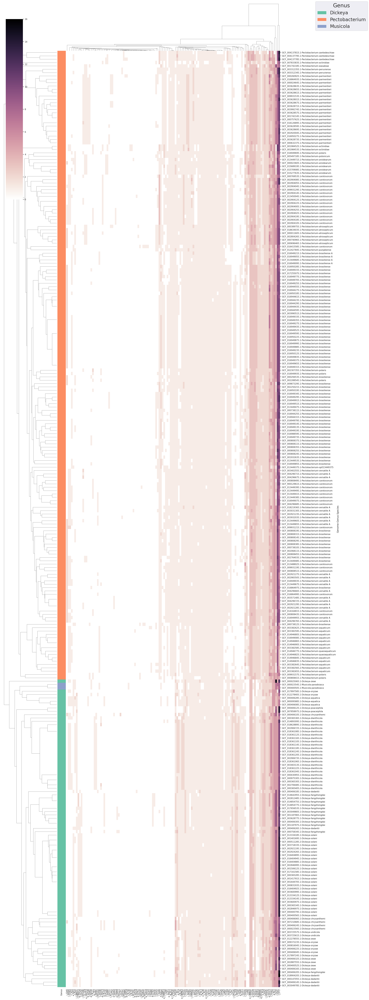

In [115]:
# make a figure that is full size, and all data is legible
build_family_clustermap(
    ie_fam_freq_df_ggs,
    row_colours=ie_fam_freq_genus_row_colours,
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_IE_fam_freq_clustermap.pdf"),
    file_format='pdf',
    lut=ie_fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.2,0.05),
    title_fontsize=28,
    legend_fontsize=24,
)

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


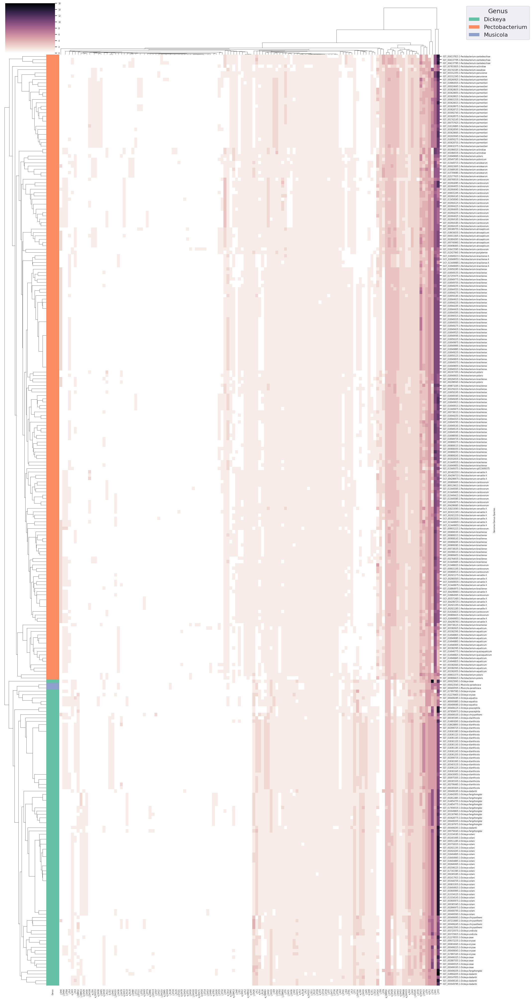

In [116]:
# make a figure the optimal size to fit in a paper
build_family_clustermap(
    ie_fam_freq_df_ggs,
    row_colours=ie_fam_freq_genus_row_colours,
    fig_size=(20,40),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_IE_fam_freq_clustermap.png"),
    file_format='png',
    font_scale=0.5,
    lut=ie_fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
    cbar_pos=(0.01, 0.95, 0.1, 0.05),  #left, bottom, width, height
)

## 3.2 Clustermap extracellular families

Plot families that are found in the extracellular space. Note some families are found in both the intracellular and extracellular space.

In [117]:
extrac_cols = [_ for _ in list(ie_fam_freq_df_ggs.columns) if _.startswith('e_')]
e_fam_freq_df_ggs = ie_fam_freq_df_ggs[extrac_cols]
e_fam_freq_df = ie_fam_freq_df[['Genome', 'Genus', 'Species'] + extrac_cols]

# define a colour scheme to colour code rows by genus
e_fam_freq_df_ggs['Genus'] = list(e_fam_freq_df['Genus'])  # add column to use for colour scheme, is removed
e_fam_freq_genus_row_colours, e_fam_g_lut = build_row_colours(e_fam_freq_df_ggs, 'Genus', 'Set2')

/tmp/ipykernel_479/1071892966.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e_fam_freq_df_ggs['Genus'] = list(e_fam_freq_df['Genus'])  # add column to use for colour scheme, is removed


/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


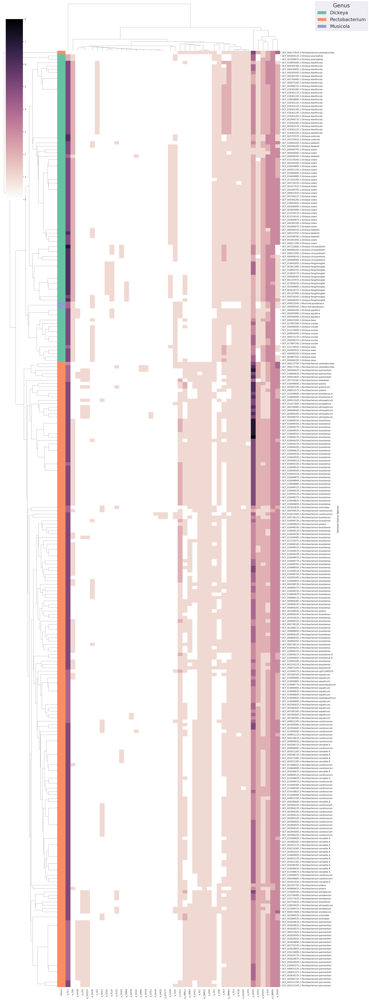

In [118]:
# make a figure that is full size, and all data is legible
build_family_clustermap(
    e_fam_freq_df_ggs,
    row_colours=e_fam_freq_genus_row_colours,
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_Extracellular_fam_freq_clustermap.pdf"),
    file_format='pdf',
    lut=e_fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.2,0.05),
    title_fontsize=28,
    legend_fontsize=24,
)

## 3.3 Clustermap intracellular only families

Plot families that are found in the intracellular space. Note some families are found in both the intracellular and extracellular space.

In [119]:
intrac_cols = [_ for _ in list(ie_fam_freq_df_ggs.columns) if _.startswith('i_')]
i_fam_freq_df_ggs = ie_fam_freq_df_ggs[intrac_cols]
i_fam_freq_df = ie_fam_freq_df[['Genome', 'Genus', 'Species'] + intrac_cols]

# define a colour scheme to colour code rows by genus
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme, is removed
i_fam_freq_genus_row_colours, i_fam_g_lut = build_row_colours(i_fam_freq_df_ggs, 'Genus', 'Set2')

/tmp/ipykernel_479/1362901214.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme, is removed


/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


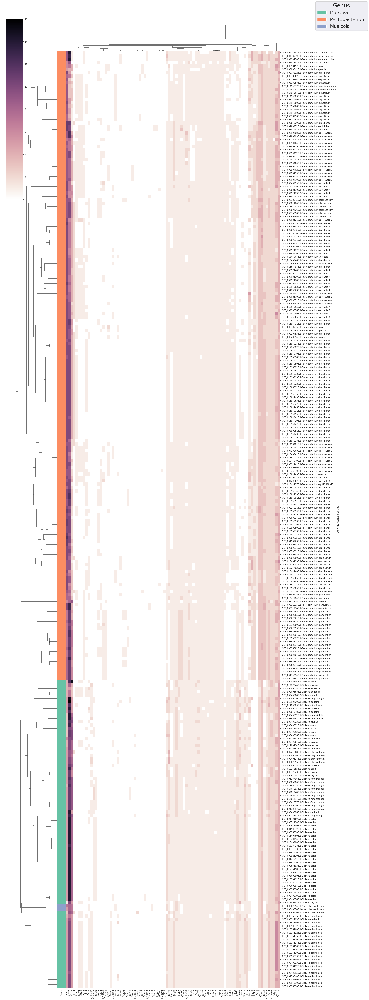

In [120]:
# make a figure that is full size, and all data is legible
build_family_clustermap(
    i_fam_freq_df_ggs,
    row_colours=i_fam_freq_genus_row_colours,
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_Intracellular_fam_freq_clustermap.pdf"),
    file_format='pdf',
    lut=i_fam_g_lut,
    legend_title='Genus',
    dendrogram_ratio=(0.2,0.05),
    title_fontsize=28,
    legend_fontsize=24,
)

## 3.5 Add species classifications

Looking at the species names in the clustermap, there appears to be clustering of the genomes in a manner that correlates not only with their genus classificaiton but also their species classification. Therefore, add an additional row of row-colours, marking the species classification of each genome.

In [121]:
# define a colour scheme to colour code rows by SPECIES
ie_fam_freq_df_ggs['Species'] = list(ie_fam_freq_df['Species'])  # add column to use for colour scheme, is removed
ie_fam_freq_species_row_colours, ie_fam_s_lut = build_row_colours(ie_fam_freq_df_ggs, 'Species', 'rainbow')

e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])
e_fam_freq_species_row_colours, e_fam_s_lut = build_row_colours(e_fam_freq_df_ggs, 'Species', 'rainbow')

i_fam_freq_df_ggs['Species'] = list(i_fam_freq_df['Species'])
i_fam_freq_species_row_colours, i_fam_s_lut = build_row_colours(i_fam_freq_df_ggs, 'Species', 'rainbow')

/tmp/ipykernel_479/3653240554.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])
/tmp/ipykernel_479/3653240554.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Species'] = list(i_fam_freq_df['Species'])


/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


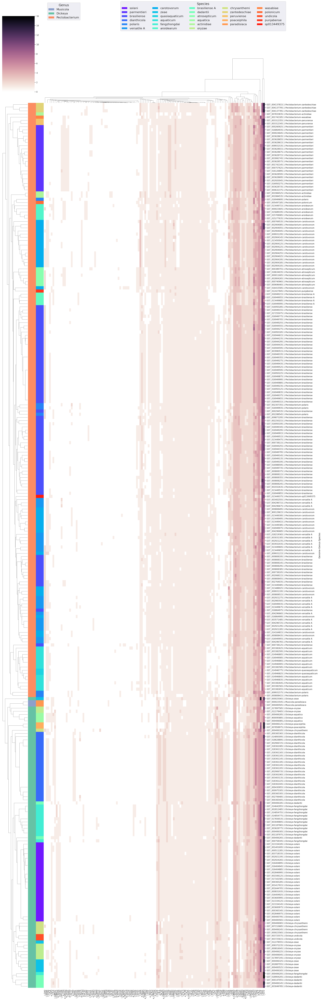

In [122]:
# make a figure the optimal size to fit in a paper
build_family_clustermap_multi_legend(
    df=ie_fam_freq_df_ggs,
    row_colours=[ie_fam_freq_genus_row_colours, ie_fam_freq_species_row_colours],
    luts=[ie_fam_g_lut, ie_fam_s_lut],
    legend_titles=['Genus', 'Species'],
    bbox_to_anchors=[(0.2,1.045), (0.63,1.04)],
    legend_cols=[1,5],
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_IE_genus_species_fam_freq_clustermap.pdf"),
    file_format='pdf',
    font_scale=1,
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
    cbar_pos=(0.01, 0.96, 0.1, 0.08),  #left, bottom, width, height
)

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


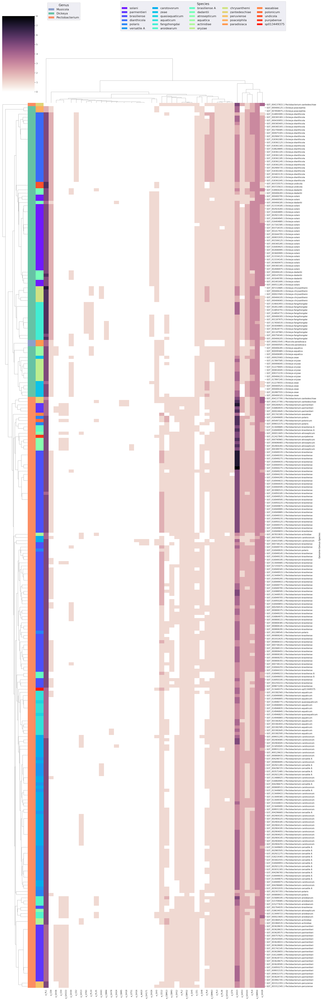

In [123]:
# make a figure the optimal size to fit in a paper
build_family_clustermap_multi_legend(
    df=e_fam_freq_df_ggs,
    row_colours=[e_fam_freq_genus_row_colours, e_fam_freq_species_row_colours],
    luts=[e_fam_g_lut, e_fam_s_lut],
    legend_titles=['Genus', 'Species'],
    bbox_to_anchors=[(0.2,1.045), (0.63,1.04)],
    legend_cols=[1,5],
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_Extracellular_genus_species_fam_freq_clustermap.pdf"),
    file_format='pdf',
    font_scale=1,
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
    cbar_pos=(0.01, 0.96, 0.1, 0.08),  #left, bottom, width, height
)

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


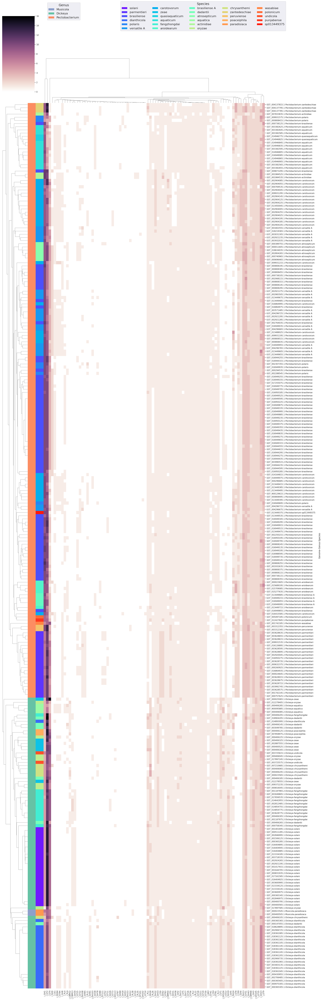

In [124]:
# make a figure the optimal size to fit in a paper
build_family_clustermap_multi_legend(
    df=i_fam_freq_df_ggs,
    row_colours=[i_fam_freq_genus_row_colours, i_fam_freq_species_row_colours],
    luts=[i_fam_g_lut, i_fam_s_lut],
    legend_titles=['Genus', 'Species'],
    bbox_to_anchors=[(0.2,1.045), (0.63,1.04)],
    legend_cols=[1,5],
    fig_size=(25,73),
    file_path=Path("../results/ie_cazymes/cazy_families/pd_Intracellular_genus_species_fam_freq_clustermap.pdf"),
    file_format='pdf',
    font_scale=1,
    dendrogram_ratio=(0.1,0.05),
    title_fontsize=18,
    legend_fontsize=16,
    cbar_pos=(0.01, 0.96, 0.1, 0.08),  #left, bottom, width, height
)

## 3.6 Genus specific fams

In [125]:
all_families = list(ie_fam_freq_df.columns)[3:]
# dict {group: {only unique fams}} and dict {group: {all fams}}
unique_grp_fams, group_fams = get_group_specific_fams(ie_fam_freq_df, 'Genus', all_families)
unique_grp_fams

Identifying Genus specific fams: 100%|█████████████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 24385.49it/s]


{'Dickeya': {'e_CBM4',
  'e_CE2',
  'e_GH26',
  'e_GT83',
  'e_PL10',
  'i_CBM13',
  'i_CBM32',
  'i_GH113',
  'i_GH26',
  'i_GH30',
  'i_GH91',
  'i_GT97'},
 'Pectobacterium': {'e_AA10',
  'e_CBM3',
  'e_CBM32',
  'e_CBM5',
  'e_CE4',
  'e_GH12',
  'e_GH13',
  'e_GH153',
  'e_GH16',
  'e_GH171',
  'e_GH18',
  'e_GH5',
  'e_GH78',
  'e_GT51',
  'e_PL2',
  'i_CE8',
  'i_GH102',
  'i_GH108',
  'i_GH12',
  'i_GH153',
  'i_GH18',
  'i_GH65',
  'i_GH68',
  'i_GH8',
  'i_GT101',
  'i_GT11',
  'i_GT111',
  'i_GT14',
  'i_GT20',
  'i_GT25',
  'i_GT32',
  'i_GT52',
  'i_GT73',
  'i_PL11',
  'i_PL35'},
 'Musicola': {'i_PL38'}}

<a id="core-cazome-IE"> </a>
# 4. The Core CAZome

Identify CAzy families that are present in every genome in the dataset using `identify_core_cazome()`, which takes the dataframe of CAZy family frequencies (with only CAZy families included in the columns, i.e no taxonomy columns). These families form the 'core CAZome'.

## 4.1 Core CAZome

In [126]:
ie_core_cazome = identify_core_cazome(ie_fam_freq_df_ggs)

ie_core_cazome = list(ie_core_cazome)
ie_core_cazome.sort()

print("The core CAZy families are:")
for fam in ie_core_cazome:
    print('-', fam)

Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 132/132 [00:00<00:00, 12327.40it/s]

The core CAZy families are:
- e_CBM50
- e_GH103
- e_GH23
- e_PL9
- i_GH1
- i_GH105
- i_GH13
- i_GH23
- i_GH3
- i_GT19
- i_GT2
- i_GT30
- i_GT51
- i_GT9


In [127]:
# filter the family freq df to include only those families in the core CAZome
ie_core_cazome_df = ie_fam_freq_df_ggs[ie_core_cazome]

ie_core_cazome_df_genus = copy(ie_core_cazome_df)  # to ensure core_cazome_df is not altereted
ie_core_cazome_df_genus = add_tax_column_from_row_index(ie_core_cazome_df_genus, 'Genus', 1)

ie_core_cazome_fggf_df, ie_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    ie_core_cazome_df_genus,
    'Genus',
    round_by=2,
)

ie_core_cazome_mean_freq_df = ie_core_cazome_mean_freq_df.sort_values("Family")
make_output_directory(Path("../results/ie_cazymes/core_cazome"), nodelete=True, force=True)
ie_core_cazome_mean_freq_df.to_csv(Path("../results/ie_cazymes/core_cazome/IE_core_cazome_freqs.csv"))

ie_core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|█████████████████████████████████████████████████████████████| 3/3 [00:00<00:00, 94.04it/s]
Output directory ../results/ie_cazymes/core_cazome exists, nodelete is True. Adding output to output directory.


,Family,Genus,MeanFreq,SdFreq
0,e_CBM50,Musicola,3.00,0.00
14,e_CBM50,Dickeya,2.98,0.15
28,e_CBM50,Pectobacterium,2.98,0.13
1,e_GH103,Musicola,1.00,0.00
15,e_GH103,Dickeya,1.82,0.38
29,e_GH103,Pectobacterium,1.41,0.49
2,e_GH23,Musicola,2.00,0.00
16,e_GH23,Dickeya,2.59,0.77
30,e_GH23,Pectobacterium,3.93,1.09
31,e_PL9,Pectobacterium,1.82,0.38


### 4.1.1 _Pectobacterium_

In [128]:
ie_fam_freq_df_ggs['Genus'] = list(ie_fam_freq_df['Genus'])
p_ie_fam_freq_df_ggs = ie_fam_freq_df_ggs[ie_fam_freq_df_ggs['Genus'] == 'Pectobacterium']
d_ie_fam_freq_df_ggs = ie_fam_freq_df_ggs[ie_fam_freq_df_ggs['Genus'] == 'Dickeya']
m_ie_fam_freq_df_ggs = ie_fam_freq_df_ggs[ie_fam_freq_df_ggs['Genus'] == 'Musicola']

ie_fam_freq_df_ggs = ie_fam_freq_df_ggs.drop('Genus', axis=1)
p_ie_fam_freq_df_ggs = p_ie_fam_freq_df_ggs.drop('Genus', axis=1)
d_ie_fam_freq_df_ggs = d_ie_fam_freq_df_ggs.drop('Genus', axis=1)
m_ie_fam_freq_df_ggs = m_ie_fam_freq_df_ggs.drop('Genus', axis=1)

In [129]:
set(p_ie_fam_freq_df_ggs['i_CE8'])

{0, 1, 2}

In [130]:
p_ie_core_cazome = identify_core_cazome(p_ie_fam_freq_df_ggs)

p_ie_core_cazome = list(p_ie_core_cazome)
p_ie_core_cazome.sort()

print("The core CAZy families are:")
for fam in p_ie_core_cazome:
    print('-', fam)

Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 132/132 [00:00<00:00, 12743.36it/s]

The core CAZy families are:
- e_CBM32
- e_CBM50
- e_GH103
- e_GH23
- e_GH28
- e_PL3
- e_PL9
- i_CE9
- i_GH1
- i_GH105
- i_GH13
- i_GH23
- i_GH3
- i_GH43
- i_GT19
- i_GT2
- i_GT28
- i_GT30
- i_GT51
- i_GT9
- i_PL22


In [131]:
# filter the family freq df to include only those families in the core CAZome
p_ie_core_cazome = p_ie_fam_freq_df_ggs[p_ie_core_cazome]

p_ie_core_cazome_df_genus = copy(p_ie_core_cazome)  # to ensure core_cazome_df is not altereted
p_ie_core_cazome_df_genus = add_tax_column_from_row_index(p_ie_core_cazome_df_genus, 'Genus', 1)

p_ie_core_cazome_fggf_df, p_ie_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    p_ie_core_cazome_df_genus,
    'Genus',
    round_by=2,
)

p_ie_core_cazome_mean_freq_df = p_ie_core_cazome_mean_freq_df.sort_values("Family")
p_ie_core_cazome_mean_freq_df.to_csv(Path("../results/ie_cazymes/core_cazome/pectobacterium_IE_core_cazome_freqs.csv"))

p_ie_core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|█████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 44.75it/s]


,Family,Genus,MeanFreq,SdFreq
0,e_CBM32,Pectobacterium,1.00,0.00
1,e_CBM50,Pectobacterium,2.98,0.13
2,e_GH103,Pectobacterium,1.41,0.49
3,e_GH23,Pectobacterium,3.93,1.09
4,e_GH28,Pectobacterium,2.89,0.38
5,e_PL3,Pectobacterium,1.00,0.00
6,e_PL9,Pectobacterium,1.82,0.38
7,i_CE9,Pectobacterium,1.11,0.31
8,i_GH1,Pectobacterium,9.35,1.13
9,i_GH105,Pectobacterium,1.99,0.07


### 4.1.2 _Dickeya_

In [132]:
d_ie_core_cazome = identify_core_cazome(d_ie_fam_freq_df_ggs)

d_ie_core_cazome = list(d_ie_core_cazome)
d_ie_core_cazome.sort()

print("The core CAZy families are:")
for fam in d_ie_core_cazome:
    print('-', fam)

Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 132/132 [00:00<00:00, 14932.39it/s]

The core CAZy families are:
- e_CBM50
- e_CE8
- e_GH102
- e_GH103
- e_GH23
- e_GH8
- e_GT4
- e_PL1
- e_PL3
- e_PL9
- i_CBM48
- i_CBM50
- i_CE11
- i_CE4
- i_GH1
- i_GH104
- i_GH105
- i_GH13
- i_GH23
- i_GH28
- i_GH3
- i_GH31
- i_GH32
- i_GH33
- i_GT1
- i_GT19
- i_GT2
- i_GT30
- i_GT35
- i_GT4
- i_GT41
- i_GT5
- i_GT51
- i_GT9


In [133]:
# filter the family freq df to include only those families in the core CAZome
d_ie_core_cazome = d_ie_fam_freq_df_ggs[d_ie_core_cazome]

d_ie_core_cazome_df_genus = copy(d_ie_core_cazome)  # to ensure core_cazome_df is not altereted
d_ie_core_cazome_df_genus = add_tax_column_from_row_index(d_ie_core_cazome_df_genus, 'Genus', 1)

d_ie_core_cazome_fggf_df, d_ie_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    d_ie_core_cazome_df_genus,
    'Genus',
    round_by=2,
)

d_ie_core_cazome_mean_freq_df = d_ie_core_cazome_mean_freq_df.sort_values("Family")
d_ie_core_cazome_mean_freq_df.to_csv(Path("../results/ie_cazymes/core_cazome/dickeya_IE_core_cazome_freqs.csv"))

d_ie_core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|█████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 32.82it/s]


,Family,Genus,MeanFreq,SdFreq
0,e_CBM50,Dickeya,2.98,0.15
1,e_CE8,Dickeya,1.79,0.41
2,e_GH102,Dickeya,1.00,0.00
3,e_GH103,Dickeya,1.82,0.38
4,e_GH23,Dickeya,2.59,0.77
5,e_GH8,Dickeya,1.00,0.00
6,e_GT4,Dickeya,1.00,0.00
7,e_PL1,Dickeya,5.13,0.67
8,e_PL3,Dickeya,1.00,0.00
9,e_PL9,Dickeya,2.62,0.55


### 4.1.3 _Musicola_

In [134]:
m_ie_core_cazome = identify_core_cazome(m_ie_fam_freq_df_ggs)

m_ie_core_cazome = list(m_ie_core_cazome)
m_ie_core_cazome.sort()

print("The core CAZy families are:")
for fam in m_ie_core_cazome:
    print('-', fam)

Identifying core CAZome: 100%|█████████████████████████████████████████████████████████████████████████| 132/132 [00:00<00:00, 15912.17it/s]

The core CAZy families are:
- e_CBM50
- e_CE1
- e_CE12
- e_CE8
- e_GH102
- e_GH103
- e_GH23
- e_GH28
- e_GH3
- e_GH30
- e_GH8
- e_GT4
- e_PL1
- e_PL9
- i_CBM48
- i_CBM50
- i_CE11
- i_CE4
- i_CE9
- i_GH1
- i_GH104
- i_GH105
- i_GH13
- i_GH19
- i_GH2
- i_GH23
- i_GH24
- i_GH28
- i_GH3
- i_GH31
- i_GH32
- i_GH33
- i_GH36
- i_GH38
- i_GH5
- i_GH73
- i_GH77
- i_GT0
- i_GT1
- i_GT19
- i_GT2
- i_GT26
- i_GT28
- i_GT30
- i_GT35
- i_GT4
- i_GT5
- i_GT51
- i_GT56
- i_GT81
- i_GT83
- i_GT9
- i_PL1
- i_PL2
- i_PL22
- i_PL38
- i_PL9


In [135]:
# filter the family freq df to include only those families in the core CAZome
m_ie_core_cazome = m_ie_fam_freq_df_ggs[m_ie_core_cazome]

m_ie_core_cazome_df_genus = copy(m_ie_core_cazome)  # to ensure core_cazome_df is not altereted
m_ie_core_cazome_df_genus = add_tax_column_from_row_index(m_ie_core_cazome_df_genus, 'Genus', 1)

m_ie_core_cazome_fggf_df, m_ie_core_cazome_mean_freq_df = build_fam_mean_freq_df(
    m_ie_core_cazome_df_genus,
    'Genus',
    round_by=2,
)

m_ie_core_cazome_mean_freq_df = m_ie_core_cazome_mean_freq_df.sort_values("Family")
m_ie_core_cazome_mean_freq_df.to_csv(Path("../results/ie_cazymes/core_cazome/musicola_IE_core_cazome_freqs.csv"))

m_ie_core_cazome_mean_freq_df

Building [Fam, grp, mean freq, sd freq] df: 100%|█████████████████████████████████████████████████████████████| 1/1 [00:00<00:00, 30.06it/s]


,Family,Genus,MeanFreq,SdFreq
0,e_CBM50,Musicola,3.0,0.0
1,e_CE1,Musicola,1.0,0.0
2,e_CE12,Musicola,1.0,0.0
3,e_CE8,Musicola,1.0,0.0
4,e_GH102,Musicola,1.0,0.0
5,e_GH103,Musicola,1.0,0.0
6,e_GH23,Musicola,2.0,0.0
7,e_GH28,Musicola,1.0,0.0
8,e_GH3,Musicola,1.0,0.0
9,e_GH30,Musicola,1.0,0.0


<a id="co-occurring-IE"> </a>
## 5. Families that always occur together

Identify CAZy families that are always present in the genome together - this approach does not tolerate one CAZy family ever appearing without the other family in the same genome.

**An iterative approach to identify co-occurring families:**

Iterate through the dataframe of CAZy family frequencies in _Pectobacterium_ and _Dickeya_ (`fam_freq_df_pd`) and identify the groups of always co-occurring CAZy families (i.e. those families that are always present together) and count the number of genomes in which the families are present together.

This is done using the `cazomevolve` function `calc_cooccuring_fam_freqs`, which returns a dictionary of groups of co-occurring CAZy families. The function takes as input:
1. The dataframe of CAZy family frequencies (it can include taxonomy information in columns)
2. A list of the CAZy families to analyse
3. (Optional) whether to include or exclude the core CAZome from the list of always co-occurring CAZy families.

In [136]:
make_output_directory(Path("../results/ie_cazymes/cooccurring_families/"), force=True, nodelete=True)

ie_cooccurring_fams_dict = calc_cooccuring_fam_freqs(
    ie_fam_freq_df,
    list(ie_fam_freq_df.columns[3:]),
    exclude_core_cazome=False,
)
ie_cooccurring_fams_dict

Output directory ../results/ie_cazymes/cooccurring_families exists, nodelete is True. Adding output to output directory.
Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 103/103 [00:00<00:00, 206408.65it/s]


{0: {'fams': {'e_AA10', 'e_GH171'}, 'freqs': {2}},
 1: {'fams': {'e_CBM5', 'e_GH18'}, 'freqs': {2}},
 2: {'fams': {'e_CBM50',
   'e_GH103',
   'e_GH23',
   'e_PL9',
   'i_GH1',
   'i_GH105',
   'i_GH13',
   'i_GH23',
   'i_GH3',
   'i_GT19',
   'i_GT2',
   'i_GT30',
   'i_GT51',
   'i_GT9'},
  'freqs': {280}},
 3: {'fams': {'e_CE4', 'e_GH153'}, 'freqs': {38}},
 4: {'fams': {'e_GH16', 'i_GT14'}, 'freqs': {1}},
 5: {'fams': {'e_PL1', 'i_CBM48'}, 'freqs': {279}},
 6: {'fams': {'i_CE11', 'i_GH32', 'i_GT4'}, 'freqs': {279}},
 7: {'fams': {'i_GH94', 'i_GT84'}, 'freqs': {97}},
 8: {'fams': {'i_GT0', 'i_GT26'}, 'freqs': {278}},
 9: {'fams': {'i_GT111', 'i_GT52'}, 'freqs': {9}},
 10: {'fams': {'i_GT20', 'i_PL35'}, 'freqs': {2}}}

In [137]:
# Pectobacterium
p_ie_fam_freq_df = ie_fam_freq_df[ie_fam_freq_df['Genus'] == 'Pectobacterium']
p_ie_cooccurring_fams_dict = calc_cooccuring_fam_freqs(
    p_ie_fam_freq_df,
    list(p_ie_fam_freq_df.columns[3:]),
    exclude_core_cazome=False,
)
p_ie_cooccurring_fams_dict

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 233/233 [00:00<00:00, 177718.28it/s]


{0: {'fams': {'e_AA10', 'e_GH171'}, 'freqs': {2}},
 1: {'fams': {'e_CBM32',
   'e_CBM50',
   'e_GH103',
   'e_GH23',
   'e_GH28',
   'e_PL3',
   'e_PL9',
   'i_CE9',
   'i_GH1',
   'i_GH105',
   'i_GH13',
   'i_GH23',
   'i_GH3',
   'i_GH43',
   'i_GT19',
   'i_GT2',
   'i_GT28',
   'i_GT30',
   'i_GT51',
   'i_GT9',
   'i_PL22'},
  'freqs': {188}},
 2: {'fams': {'e_CBM5', 'e_GH18'}, 'freqs': {2}},
 3: {'fams': {'e_CE4', 'e_GH153'}, 'freqs': {38}},
 4: {'fams': {'e_GH16', 'i_GT14'}, 'freqs': {1}},
 5: {'fams': {'e_PL1', 'i_CBM48', 'i_GT0', 'i_GT26', 'i_GT56'},
  'freqs': {187}},
 6: {'fams': {'i_CE11', 'i_GH32', 'i_GT4', 'i_PL2'}, 'freqs': {187}},
 7: {'fams': {'i_GH94', 'i_GT84'}, 'freqs': {67}},
 8: {'fams': {'i_GT111', 'i_GT52'}, 'freqs': {9}},
 9: {'fams': {'i_GT20', 'i_PL35'}, 'freqs': {2}}}

In [138]:
# co-occurring cazy families in dickeya
d_ie_fam_freq_df = ie_fam_freq_df[ie_fam_freq_df['Genus'] == 'Dickeya']
d_ie_cooccurring_fams_dict = calc_cooccuring_fam_freqs(
    d_ie_fam_freq_df,
    list(d_ie_fam_freq_df.columns[3:]),
    exclude_core_cazome=False,
)
d_ie_cooccurring_fams_dict

Combining pairs of co-occurring families: 100%|███████████████████████████████████████████████████████| 566/566 [00:00<00:00, 333611.03it/s]


{0: {'fams': {'e_CBM50',
   'e_CE8',
   'e_GH102',
   'e_GH103',
   'e_GH23',
   'e_GH8',
   'e_GT4',
   'e_PL1',
   'e_PL3',
   'e_PL9',
   'i_CBM48',
   'i_CBM50',
   'i_CE11',
   'i_CE4',
   'i_GH1',
   'i_GH104',
   'i_GH105',
   'i_GH13',
   'i_GH23',
   'i_GH28',
   'i_GH3',
   'i_GH31',
   'i_GH32',
   'i_GH33',
   'i_GT1',
   'i_GT19',
   'i_GT2',
   'i_GT30',
   'i_GT35',
   'i_GT4',
   'i_GT41',
   'i_GT5',
   'i_GT51',
   'i_GT9'},
  'freqs': {90}},
 1: {'fams': {'e_CE12', 'e_GH36'}, 'freqs': {3}},
 2: {'fams': {'e_PL35', 'i_GH88'}, 'freqs': {1}},
 3: {'fams': {'i_GH19', 'i_GH5'}, 'freqs': {88}},
 4: {'fams': {'i_GH94', 'i_GT84'}, 'freqs': {30}},
 5: {'fams': {'i_GT0', 'i_GT26'}, 'freqs': {89}}}

### Build an upset plot of co-occurring CAZy families

Build an upsetplot (using the Python package `upsetplot`) to visulise the groups of always co-occurring CAZy families, additionally it will plot the number of genomes in which each group of co-occurring CAZy families were present.

First compile the data/membership for the upset plot by:
1. Creating an empty list to store the upset plot data
2. Adding to the empty list the data contained in each dictionary of co-occurring CAZy families by using the `add_to_upsetplot_membership()` function

In [139]:
upsetplot_membership = []
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, ie_cooccurring_fams_dict)
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, p_ie_cooccurring_fams_dict)
upsetplot_membership = add_to_upsetplot_membership(upsetplot_membership, d_ie_cooccurring_fams_dict)
len(upsetplot_membership)

2251

/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/upsetplot/plotting.py:662: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['#0000002e' '#0000002e' '#0000002e' ... '#0000002e' '#0000002e'
 '#0000002e']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  styles["edgecolor"].fillna(styles["facecolor"], inplace=True)
/home/hobnobmancer/anaconda3/envs/pectobacteriaceae/lib/python3.11/site-packages/upsetplot/plotting.py:663: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'solid' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  styles["linestyle"].fillna("solid", inplace=True)


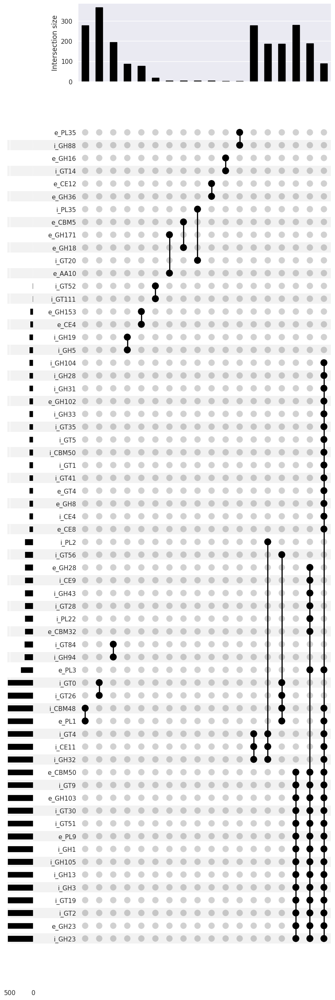

In [140]:
pecto_dic_upsetplot = build_upsetplot(
    upsetplot_membership,
    file_path='../results/ie_cazymes/cooccurring_families/pd_cooccurring_fams.svg',
)

**Break down the incidences per genus:**

The upset plot generates a bar chart showing the number of genomes that each group of co-occuring CAZy families appeared in. However, this plots the total number across each of the groups (i.e. _Pectobacterium_, _Dickeya_, and both).

To break down the indidence (i.e. the number of genomes that each group of co-occurring CAZy families were present in) per group, a dataframe listing each group of co-occurring CAZy families, the group (i.e. genus), and the respective frequency must be generated. This dataframe can then be used to generate a proportional area plot (or matrix plot), breaking down the incidence per group (i.e. genus).

The groups of co-occurring CAZy families must be listed in the same order as they are presented in the upset plot.

Compiling the data of the incidence of each grp of co-occurring CAZy families per group of interest (e.g. per genus), into a single dataframe.

Create an empty list to store all data for the dataframe, then use `add_upsetplot_grp_freqs` to add data of the incidence per group of co-occurring CAZy families to the list. `build_upsetplot_matrix` is then used to build the dataframe.

In [141]:
upset_plot_groups = get_upsetplot_grps(upsetplot_membership)

ie_cooccurring_grp_freq_data = []  # empty list to store data for the df

for fam_grp in upset_plot_groups:
    added = False
    
    for grp_num in ie_cooccurring_fams_dict:
        fams = list(ie_cooccurring_fams_dict[grp_num]['fams'])
        fams.sort()
        fam_grp = list(fam_grp)
        fam_grp.sort()
        if fams == fam_grp:
            freq = list(ie_cooccurring_fams_dict[grp_num]['freqs'])[0]
            ie_cooccurring_grp_freq_data.append(["+".join(fam_grp), 'Both', freq])
            added = True
    
    if added:
        continue
        
    # pecto_cooccurring_fams_dict
    for grp_num in p_ie_cooccurring_fams_dict:
        fams = list(p_ie_cooccurring_fams_dict[grp_num]['fams'])
        fams.sort()
        fam_grp = list(fam_grp)
        fam_grp.sort()
        if fams == fam_grp:
            freq = list(p_ie_cooccurring_fams_dict[grp_num]['freqs'])[0]
            ie_cooccurring_grp_freq_data.append(["+".join(fam_grp), 'Pectobacterium', freq])
            added = True
    
    if added:
        continue
    
    # dic_cooccurring_fams_dict
    for grp_num in d_ie_cooccurring_fams_dict:
        fams = list(d_ie_cooccurring_fams_dict[grp_num]['fams'])
        fams.sort()
        fam_grp = list(fam_grp)
        fam_grp.sort()
        if fams == fam_grp:
            freq = list(d_ie_cooccurring_fams_dict[grp_num]['freqs'])[0]
            ie_cooccurring_grp_freq_data.append(["+".join(fam_grp), 'Dickeya', freq])
            added = True
    
    if added:
        continue

ie_cooccurring_fams_freq_df = pd.DataFrame(ie_cooccurring_grp_freq_data, columns=['Families', 'Genus', 'Incidence'])
ie_cooccurring_fams_freq_df.to_csv('../results/ie_cazymes/cooccurring_families/cooccurring_fams_freqs.csv')
ie_cooccurring_fams_freq_df

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████| 18/18 [00:00<00:00, 46.90it/s]


,Families,Genus,Incidence
0,e_PL1+i_CBM48,Both,279
1,i_GT0+i_GT26,Both,278
2,i_GH94+i_GT84,Both,97
3,i_GH19+i_GH5,Dickeya,88
4,e_CE4+e_GH153,Both,38
5,i_GT111+i_GT52,Both,9
6,e_AA10+e_GH171,Both,2
7,e_CBM5+e_GH18,Both,2
8,i_GT20+i_PL35,Both,2
9,e_CE12+e_GH36,Dickeya,3


<a id="pca-IE"></a>
# 6. Principal Component Analysis (PCA)

Use principal component analysis to identify individual and groups of CAZy families that are strongly associated with divergence between the composition of _Pectobacterium_ and _Dickeya_ CAZomes in terms of CAZy family frequencies. 

Use the `cazomevolve` function `perform_pca()` to perform a PCA on a dataframe where each row is a genome, and each column the frequency of a unique CAZy family - the columns in the dataframe must only contain numerical data (i.e. no taxonomic data).

## 6.1 PCA of all intracellular and extracellular families

In [49]:
num_of_components = len(ie_fam_freq_df_ggs.columns)
ie_pca, ie_X_scaled = perform_pca(ie_fam_freq_df_ggs, num_of_components)
ie_pca

PCA(n_components=132)

**Explained cumulative variance:**

Explore the amount of variance in the dataset that is captured by the dimensional reduction performed by the PCA.

Output directory ../results/ie_cazymes/ie_pca exists, nodelete is True. Adding output to output directory.


99.99999999999999% of the variance in the data set was catpured by the PCA
Number of features needed to explain 0.95 fraction of total variance is 54. 


<Figure size 640x480 with 0 Axes>

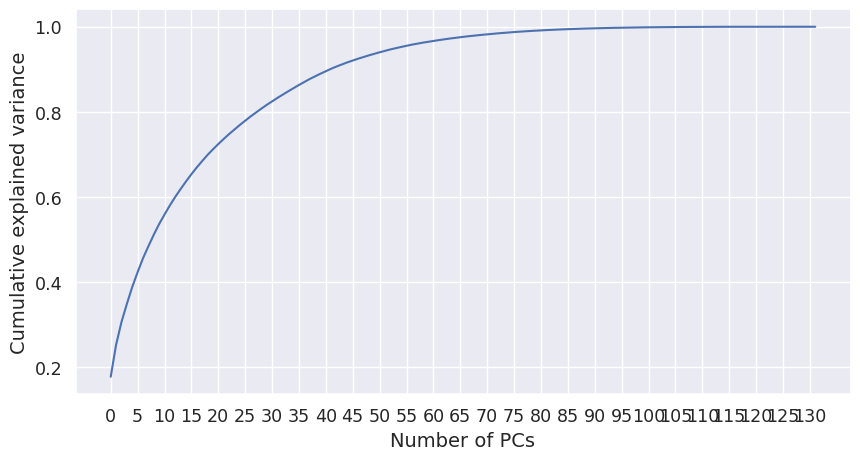

In [50]:
make_output_directory(Path("../results/ie_cazymes/ie_pca"), force=True, nodelete=True)

print(f"{ie_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

cumExpVar = plot_explained_variance(
    ie_pca,
    num_of_components,
    file_path="../results/ie_cazymes/ie_pca/pd_pca_IE_explained_variance.png",
);

**Variance captured per PC:**

Explore the variance in the data that is captured by each PC.

Explained variance for 1PC: 0.1765287991150689
Explained variance for 2PC: 0.07549420462384315
Explained variance for 3PC: 0.05334584963764608
Explained variance for 4PC: 0.04255729388516406
Explained variance for 5PC: 0.03983585897385492
Explained variance for 6PC: 0.03485669828840418
Explained variance for 7PC: 0.032585872785581955
Explained variance for 8PC: 0.028281453025477233
Explained variance for 9PC: 0.0271542013466034
Explained variance for 10PC: 0.025161493425666807


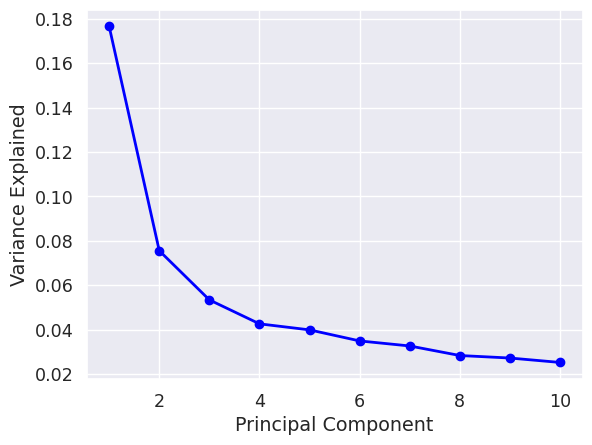

In [51]:
plot_scree(ie_pca, nComp=10, file_path="../results/ie_cazymes/ie_pca/pd_pca_IE_scree.png")

### Scatter and loadings plots

To explore the variance captured by each PC, plot different combinations of PCs onto a scatter plot where each axis represents a different PC and each point on the plot is a genome in the data set, using the `plot_pca()` function.

`plot_pca()` takes 6 positional argumets:
1. PCA object from `peform_pca()`
2. Scaling object (X_scaled) from `perform_pca()`
3. The dataframe of CAZy family frequencies, if you want to colour code the genomes by a specific grouping (i.e. by Genus), an additional column containing the grouping information needs to be added to the dataframe (e.g. listing the genus per genome)
4. The number of the first PC to be plotted, e.g. 1 for PC1 - int
5. The number of the second PC to be plotted, e.g. 2 for PC2 - int
6. The method to colour code the genomes by (e.g. 'Genus') - needs to match the name of the column containing the data in the dataframe of CAZy family frequencies

Owing to the majoirty of the variance captured by the PCA being captured by PCs 1-4, all possible combinations of these PCs were explored.

### PC1 - PC4

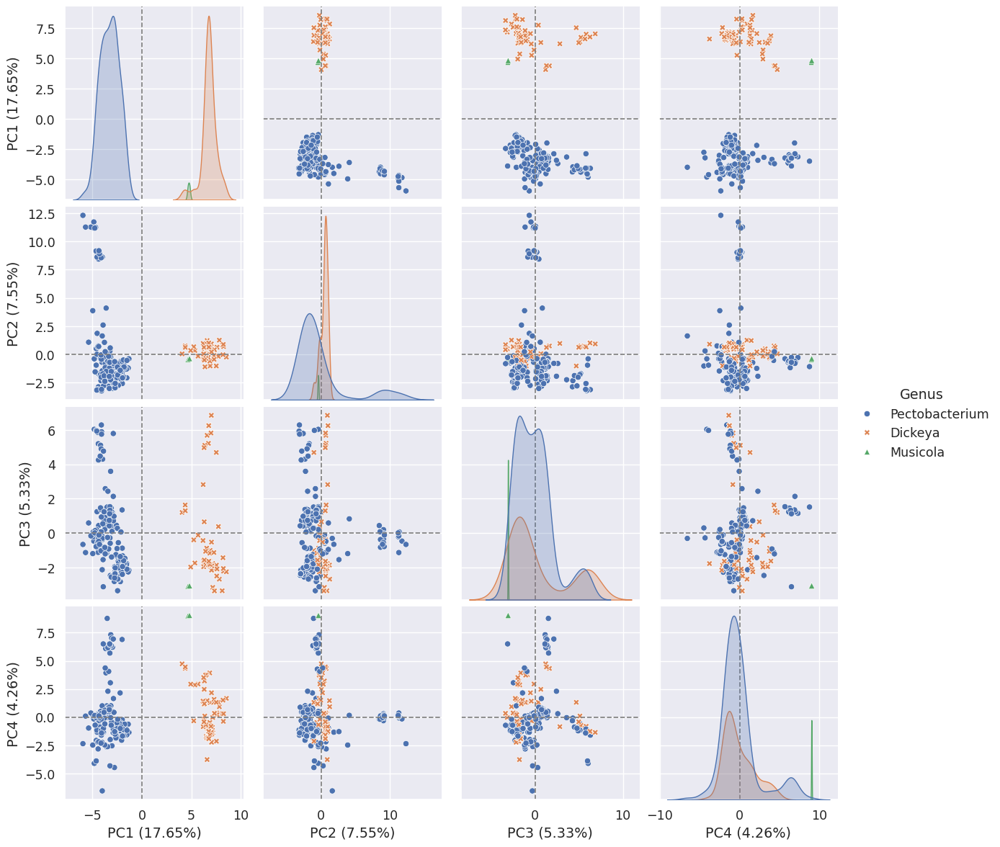

In [61]:
ie_fam_freq_df_ggs_pc = copy(ie_fam_freq_df_ggs)
ie_fam_freq_df_ggs_pc['Genus'] = list(ie_fam_freq_df['Genus'])
X_pca = ie_pca.transform(ie_X_scaled)

colnames = []
for i in range(4):
    ie_fam_freq_df_ggs_pc[f'PC{i+1} ({round(ie_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(ie_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    ie_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Genus",
    diag_kind="kde",
    markers=['o','X', '^'],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/ie_pca/pd_pc_screen_genus.svg',
    bbox_inches='tight',
    format='svg'
)

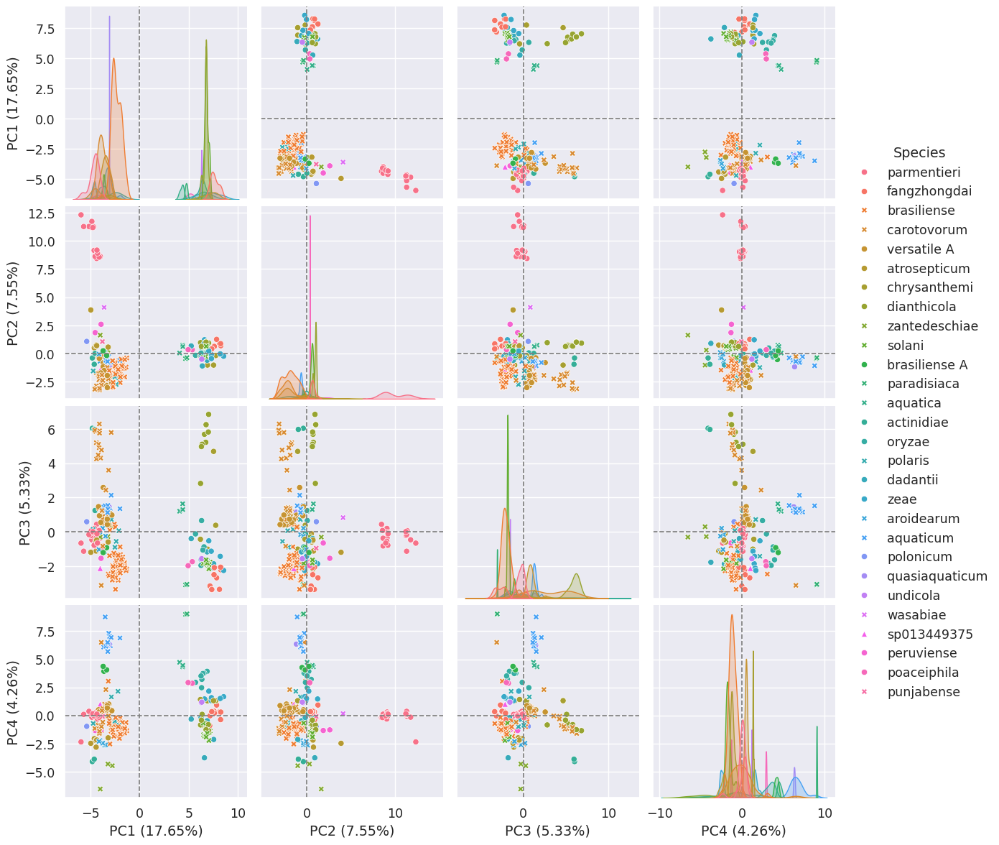

In [62]:
try:
    ie_fam_freq_df_ggs_pc = ie_fam_freq_df_ggs_pc.drop('Genus', axis=1)
except KeyError:
    pass
ie_fam_freq_df_ggs_pc['Species'] = list(ie_fam_freq_df['Species'])

colnames = []
for i in range(4):
    ie_fam_freq_df_ggs_pc[f'PC{i+1} ({round(ie_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(ie_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    ie_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Species",
    diag_kind="kde",
    markers=[
        'o', 'o', 'X', 'X', 'o', 'o',
        'o', 'o', 'X', 'X', 'o', 'X',
        'X', 'o', 'o', 'X', 'o', 'o',
        'X', 'X', 'o', 'o', 'o', 'X',
        '^', 'o', 'o', 'X',
    ],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/ie_pca/pd_pc_screen_specis.svg',
    bbox_inches='tight',
    format='svg'
)

Create a new function to handling building the loadings plot as the function in `cazomevolve` does not expect the CAZy families to have additional prefixes.

In [52]:
def plot_ie_loadings(
    pca,
    fam_df,
    first_pc,
    second_pc,
    style=False,
    threshold=0.7,
    font_scale=1.15,
    font_size=12,
    dpi=300,
    fig_size=(16,16),
    file_path=None,
    file_format='png',
    marker_size=100,
):
    """Build loadings plot for intracellular/extracellular CAZyme data
    
    :param pca: sklearn pca object
    :param fam_df: cazy family frequncy df
    :param first_pc: int, number of the first PC, e.g. PC1 == 1
    :param second_pc: int, number of the second PC e.g. PC2 == 2
    :param style: boolean, change shape of points depending on CAZy class
    :param threshold: correlation cut off for showing labels
        Only families with a value greater than the threshold
        will be annotated
    :param font_scale: scale font
    :param font_size: font size of family labels
    :param fig_size: tuple (width, height) of final plot
    :param file_path: str, path to write out a figure.
    
    Return labels - CAZy family annotations for families >= threshold
    """
    sns.set(font_scale=font_scale)

    # calculate loading = variables x loadings, returns an array
    loadings = pca.components_.T * np.sqrt(pca.explained_variance_)
    # get labels of variables, i.e. cazy families
    loadings_labels = list(fam_df.columns)

    for col in ['Kingdom', 'Phylum', 'Class', 'Order', 'Tax_Family', 'Genus', 'Species', 'Genome', 'Genomes']:
        try:
            loadings_labels.remove(col)
        except (KeyError, ValueError):
            pass

    loadings_x = loadings[:,(first_pc-1)]
    loadings_y = loadings[:,(second_pc-1)]

    loadings_df = pd.DataFrame()
    loadings_df['loadings_x'] = loadings_x
    loadings_df['loadings_y'] = loadings_y

    cazy_class = []
    for lbl in loadings_labels:
        lbl = lbl.split("_")[1]
        if lbl.startswith('GH'):
            cazy_class.append('GH')
        elif lbl.startswith('GT'):
            cazy_class.append('GT')
        elif lbl.startswith('PL'):
            cazy_class.append('PL')
        elif lbl.startswith('CE'):
            cazy_class.append('CE')
        elif lbl.startswith('AA'):
            cazy_class.append('AA')
        else:
            cazy_class.append('CBM')

    loadings_df['cazy_class'] = cazy_class

    plt.figure(figsize=fig_size)
    if style:
        g = sns.scatterplot(
            x=loadings_x,
            y=loadings_y,
            data=loadings_df,
            hue=cazy_class,
            s=marker_size,
            style=cazy_class,
        );
    else:
        g = sns.scatterplot(
            x=loadings_x,
            y=loadings_y,
            data=loadings_df,
            hue=cazy_class,
            s=marker_size,
        );
    g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
    g.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    g.set(xlim=(-1,1),ylim=(-1,1));
    plt.ylabel(f"PC{second_pc}") 
    plt.xlabel(f"PC{first_pc}")

    texts = [
        plt.text(
            xval,
            yval,
            lbl,
            ha='center',
            va='center',
            fontsize=font_size,
        ) for (xval, yval, lbl) in zip(
            loadings_x, loadings_y, loadings_labels
        ) if abs(xval) > threshold or abs(yval) > threshold
    ]
    adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

    sns.move_legend(g, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False);

    if file_path is not None:
        plt.savefig(file_path, dpi=dpi, bbox_inches='tight', format=file_format)
        
    return texts

Plot PCA plots separately.

Not applying hue order
Applying style
Not applying style order
Not applying hue order
Applying style
Not applying style order
CBM13
CBM32
CE1
CE12
CE4
CE8
GH28
GH3
GH5
GH8
PL1


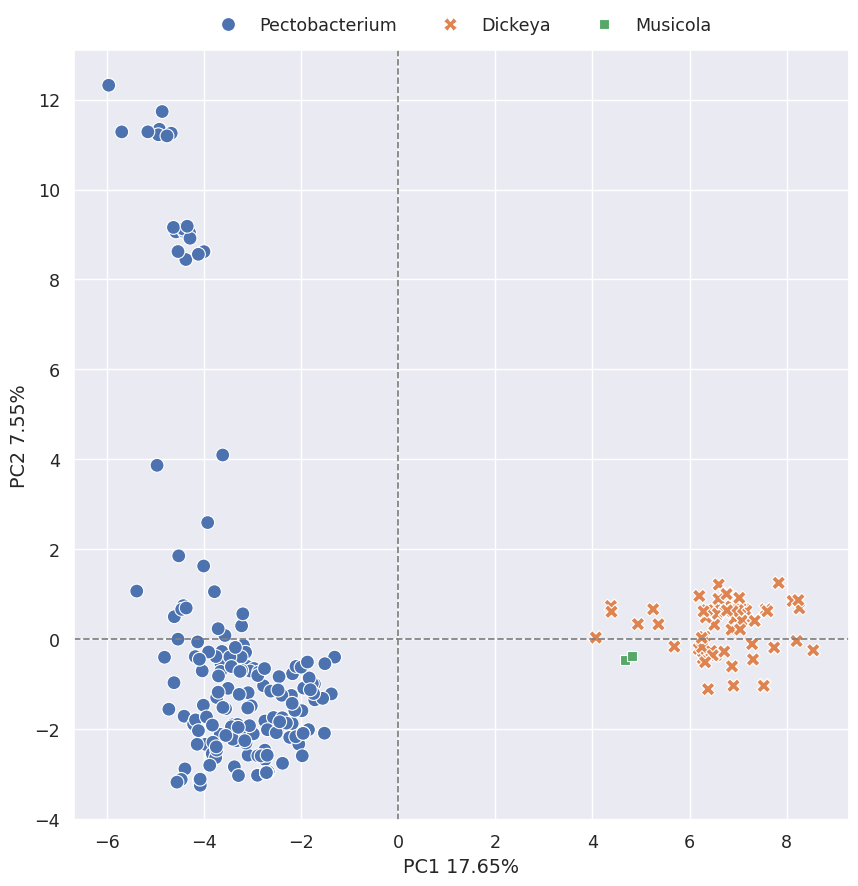

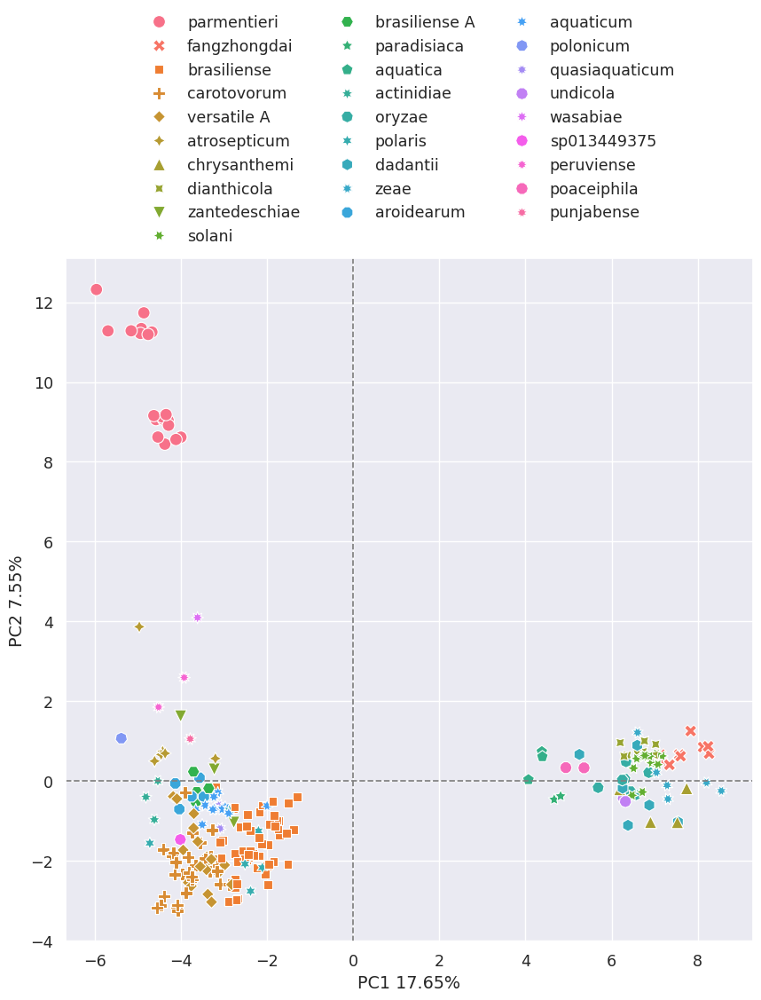

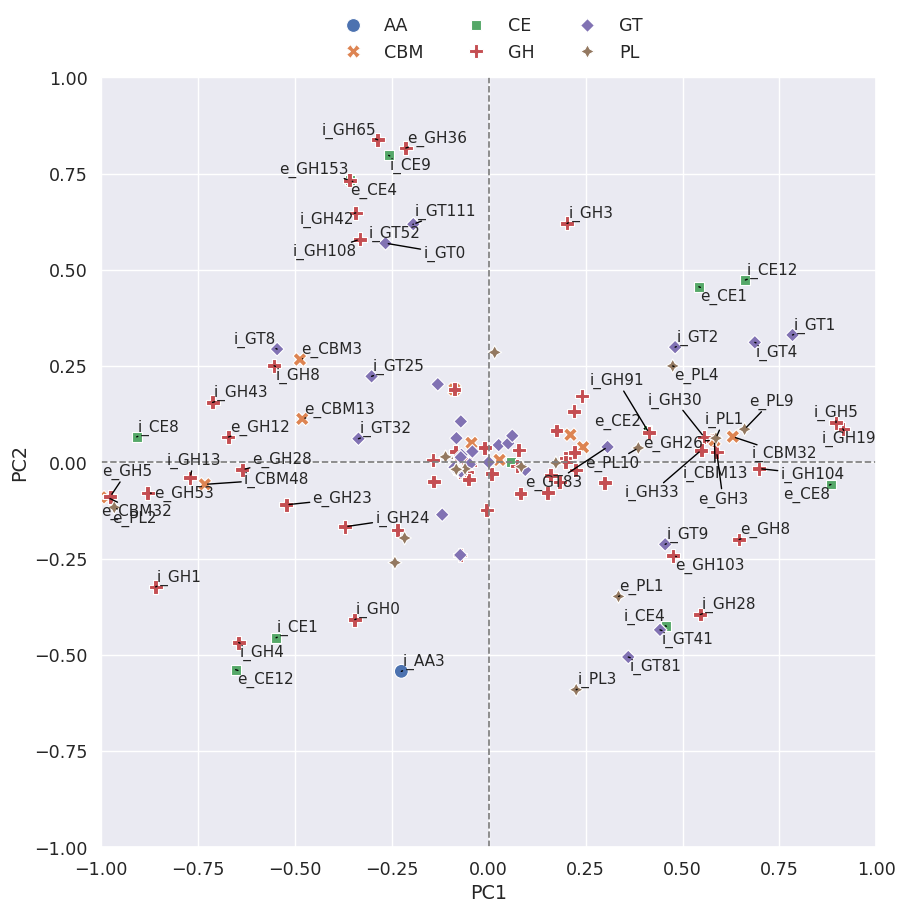

In [53]:
ie_fam_freq_df_ggs['Genus'] = list(ie_fam_freq_df['Genus'])  # add column to use for colour scheme
ie_fam_freq_df_ggs['Species'] = list(ie_fam_freq_df['Species'])  # add column to use for colour scheme

pc1_pc2_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    2,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc2.png",
)

pc1_pc2_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    2,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc2_species.png",
)

pc1_pc2_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    1,
    2,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc2_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc2_labels = [_._text for _ in pc1_pc2_labels]
pc1_pc2_fams = {}
for fam in pc1_pc2_labels:
    try:
        pc1_pc2_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc2_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc2_fams:
    if len(pc1_pc2_fams[fam]) == 2:
        print(fam)


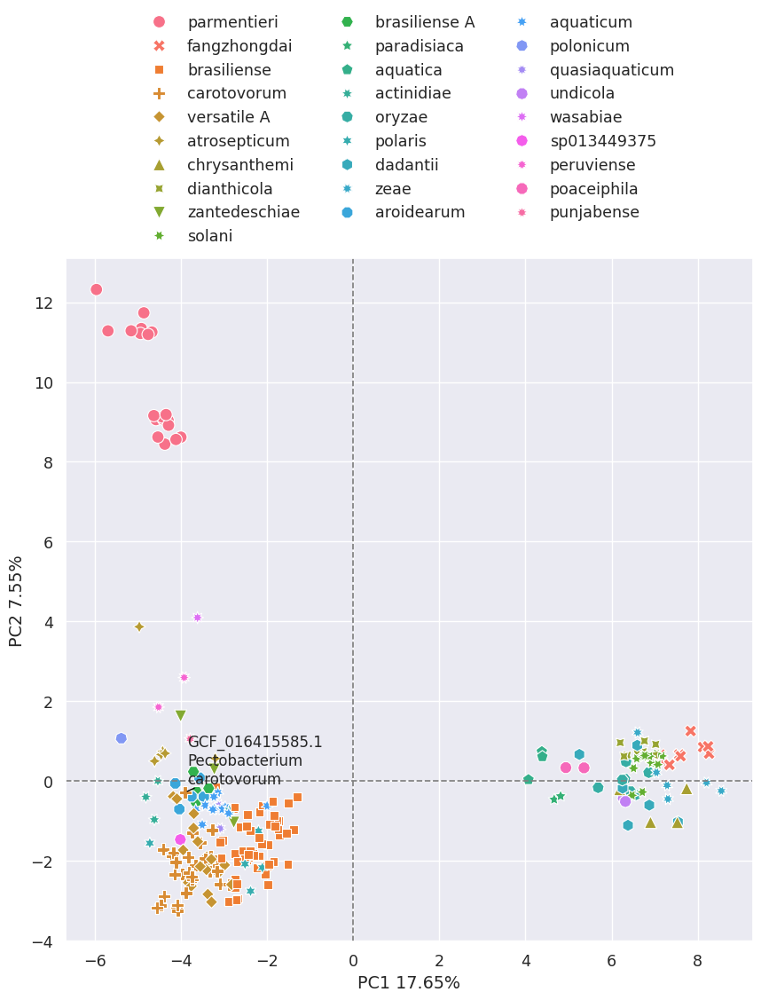

In [59]:
X_pca = ie_pca.transform(ie_X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

g = sns.scatterplot(
    x=X_pca[:,0],  # PC1
    y=X_pca[:,1],  # PC2
    data=ie_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC2 {100 * ie_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * ie_pca.explained_variance_ratio_[0]:.2f}%");
sns.move_legend(g, "lower center", bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False);

genome_lbls = ["\n".join(_) for _ in ie_fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,1]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if (lbl.find('GCF_016415585.1') != -1)
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig(
    "../results/ie_cazymes/ie_pca/ie_pc1_pc2_species.png",
    bbox_inches='tight',
    format='png',
)

Not applying hue order
Applying style
Not applying style order
CBM13
CBM32
CE1
CE12
CE4
CE8
GH13
GH23
GH28
GH5
GH8
PL1


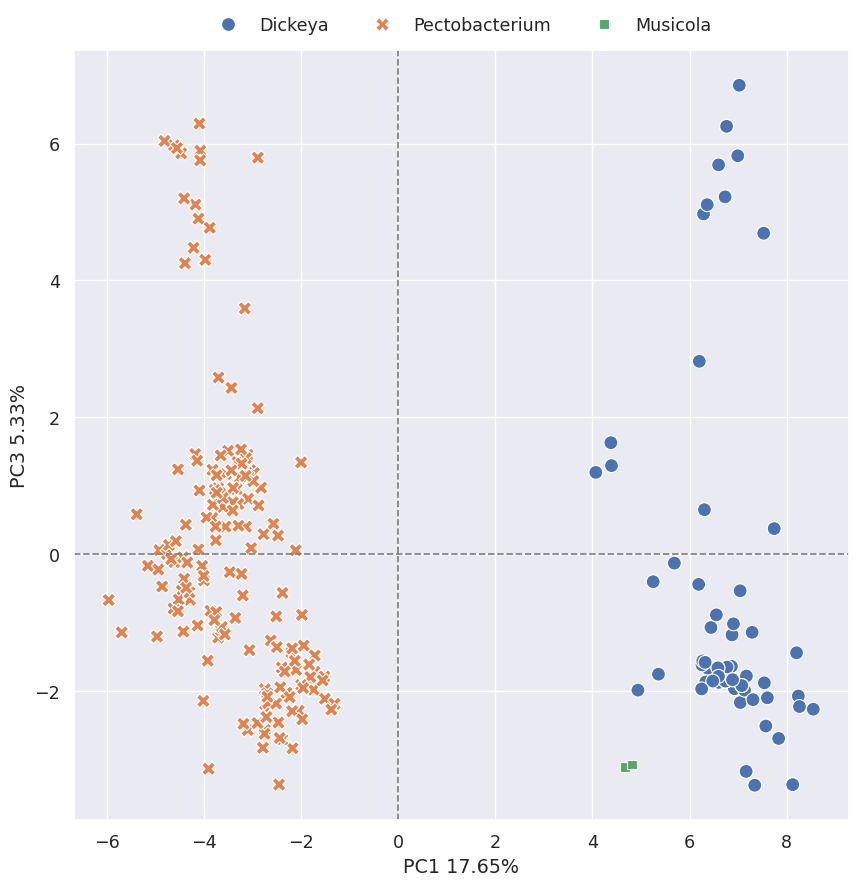

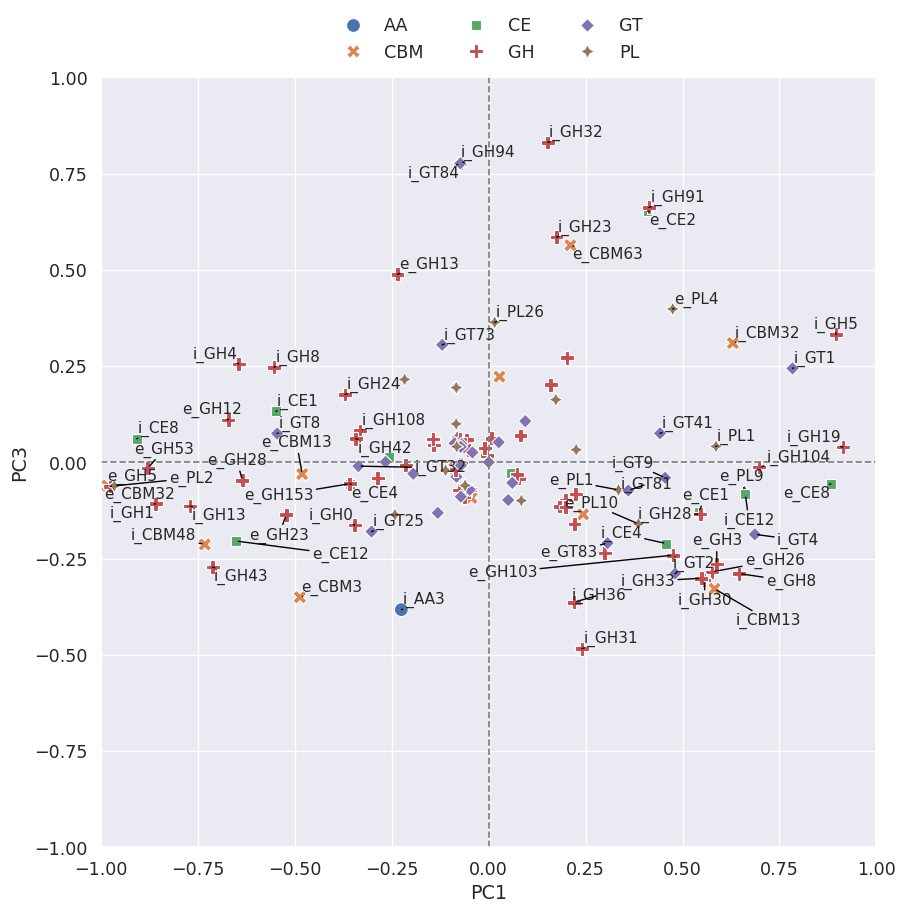

In [149]:
pc1_pc3_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc3.png",
)

pc1_pc3_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    3,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc3_species.png",
)

pc1_pc3_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    1,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc3_labels = [_._text for _ in pc1_pc3_labels]
pc1_pc3_fams = {}
for fam in pc1_pc3_labels:
    try:
        pc1_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc3_fams:
    if len(pc1_pc3_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order
CBM13
CBM32
CE1
CE12
CE4
CE8
GH28
GH5
GH8
GT83
PL1
PL3


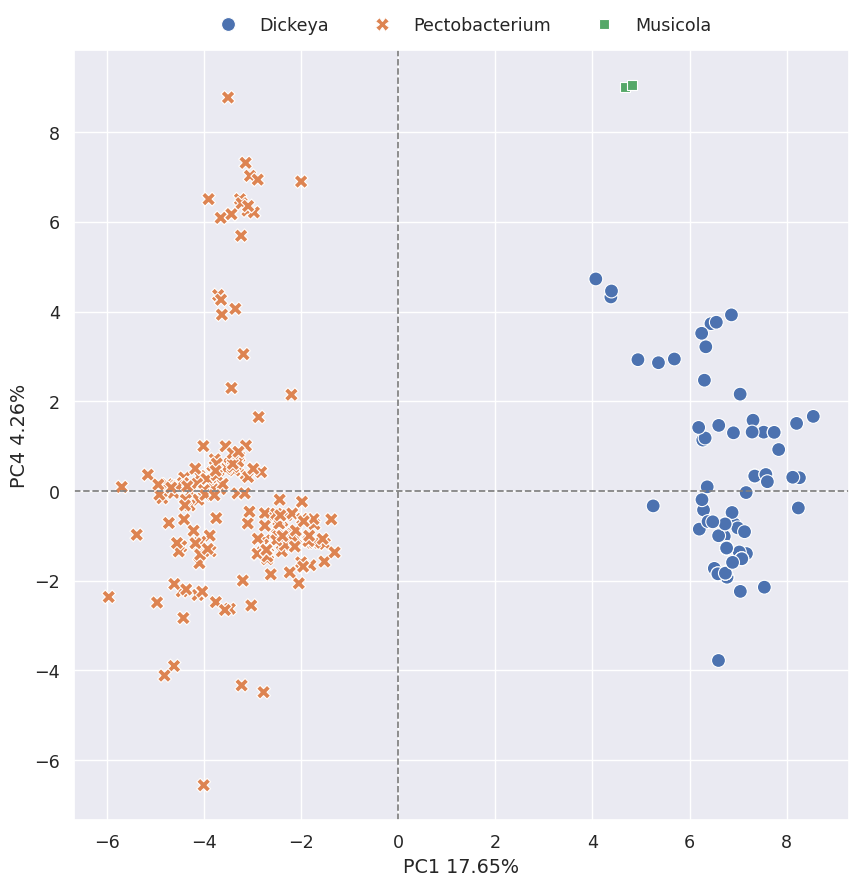

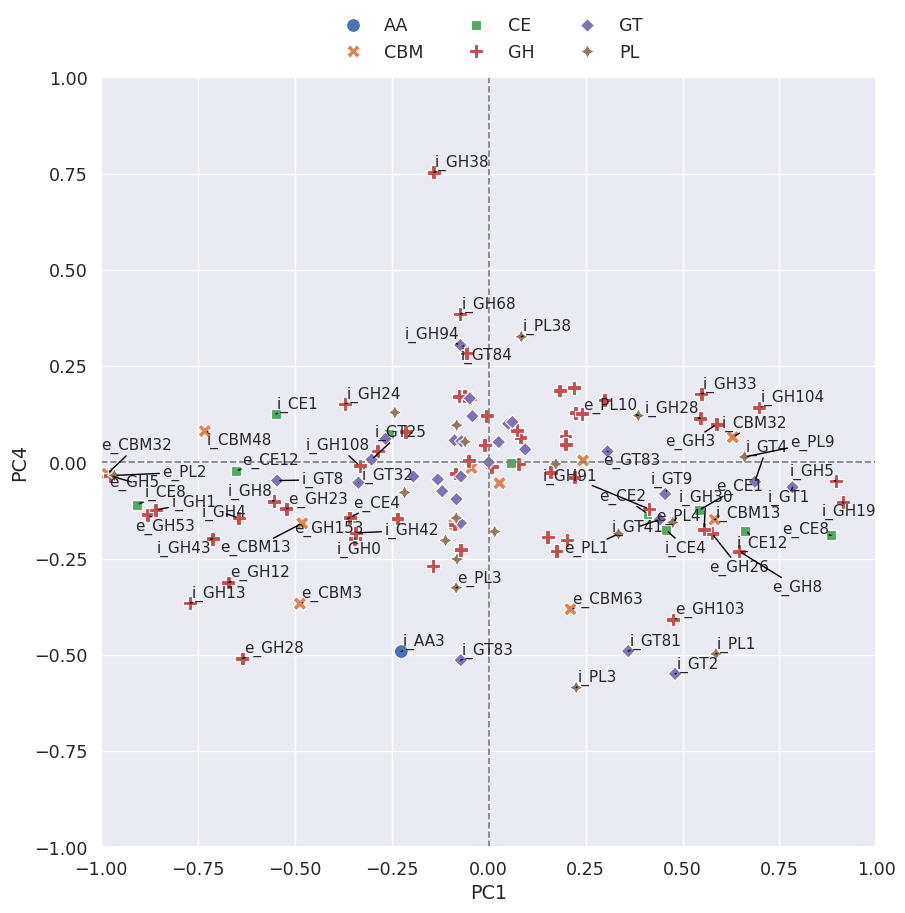

In [150]:
pc1_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc4.png",
)

pc1_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    1,
    4,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc4_species.png",
)

pc1_pc4_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    1,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc1_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc4_labels = [_._text for _ in pc1_pc4_labels]
pc1_pc4_fams = {}
for fam in pc1_pc4_labels:
    try:
        pc1_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc4_fams:
    if len(pc1_pc4_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order
CE1
CE12
CE4
GH36


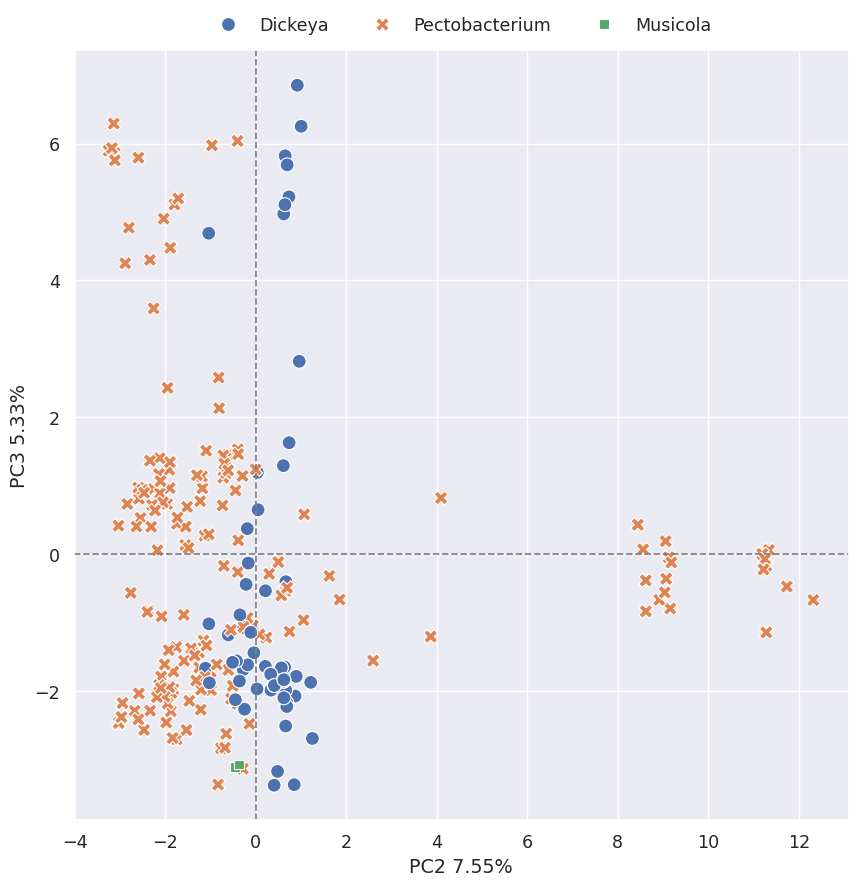

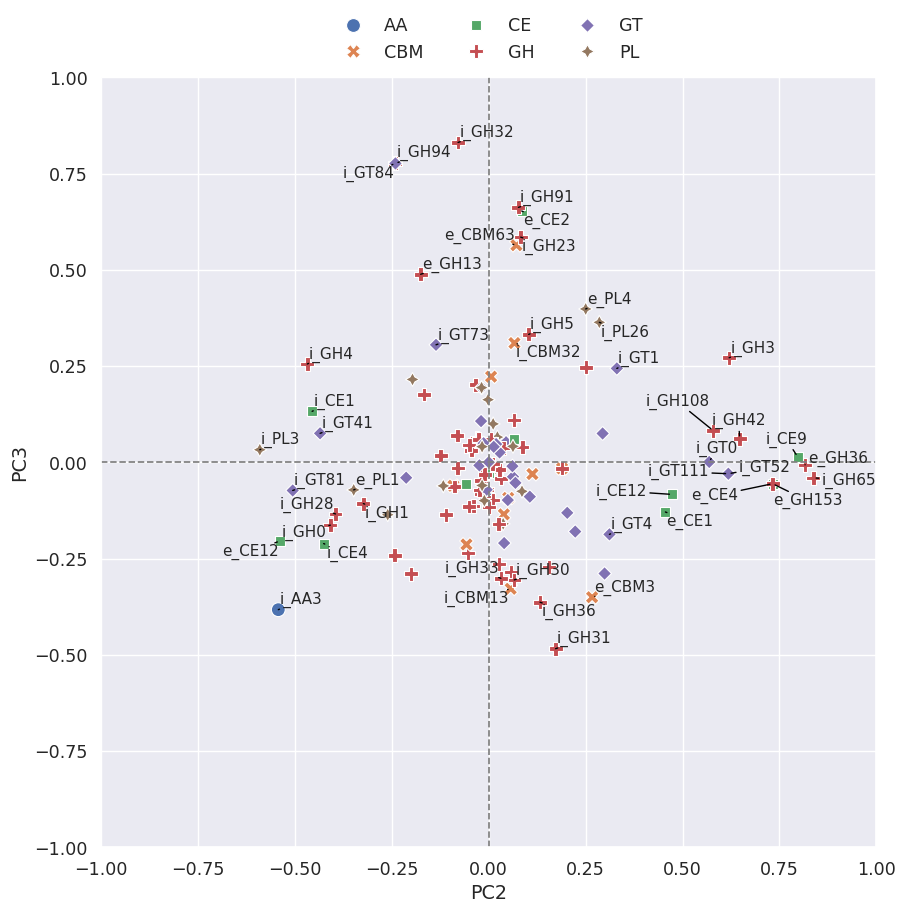

In [151]:
pc2_pc3_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    2,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc3.png",
)

pc2_pc3_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    2,
    3,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc3_species.png",
)

pc2_pc3_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    2,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc3_labels = [_._text for _ in pc2_pc3_labels]
pc2_pc3_fams = {}
for fam in pc2_pc3_labels:
    try:
        pc2_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc3_fams:
    if len(pc2_pc3_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order
CE1
CE12
CE4
GH28
PL1
PL3


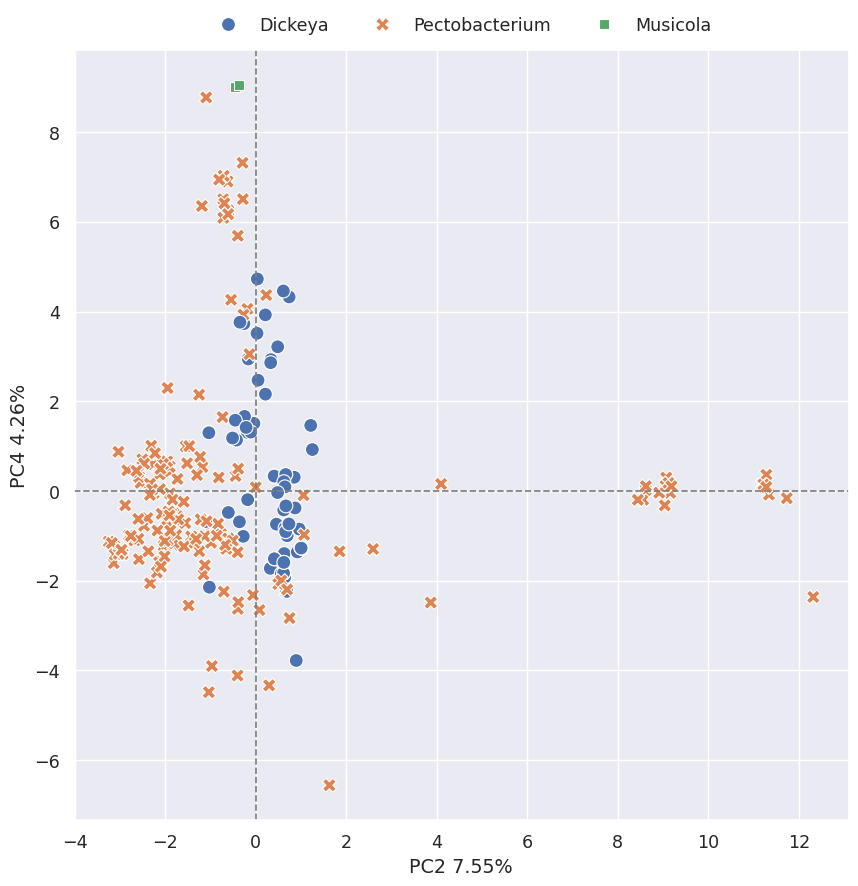

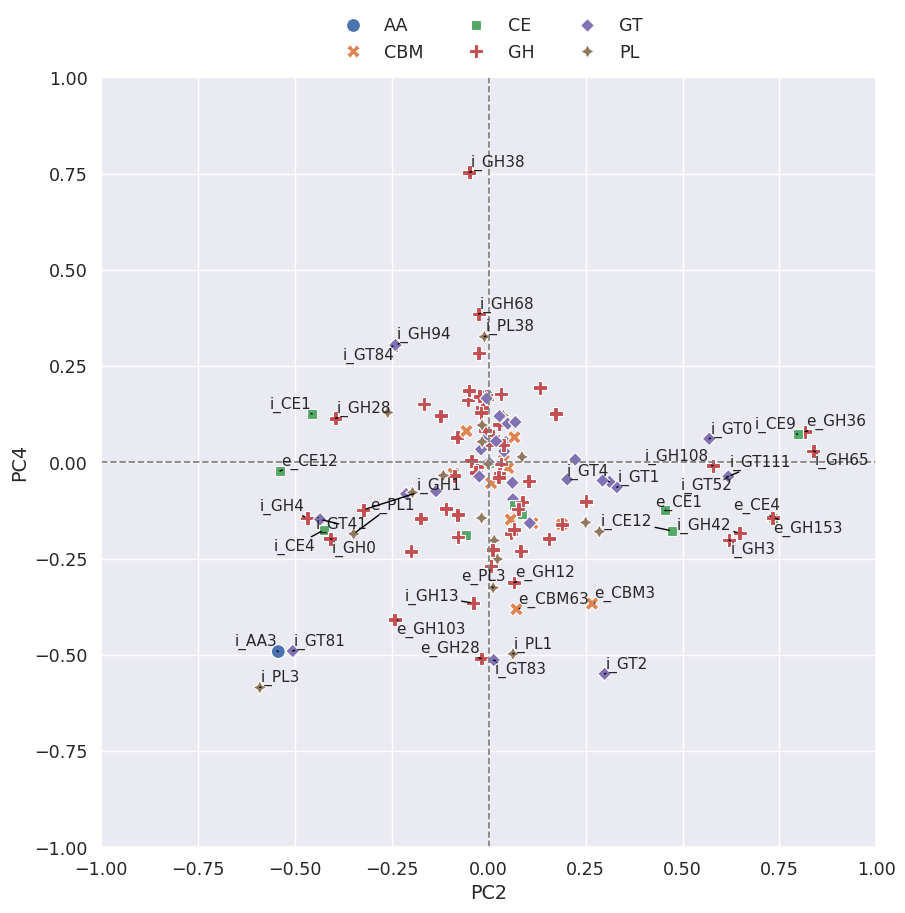

In [152]:
pc2_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    2,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc4.png",
)

pc2_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    2,
    4,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc4_species.png",
)

pc2_pc4_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    2,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc2_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc4_labels = [_._text for _ in pc2_pc4_labels]
pc2_pc4_fams = {}
for fam in pc2_pc4_labels:
    try:
        pc2_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc4_fams:
    if len(pc2_pc4_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order
GH13
PL3


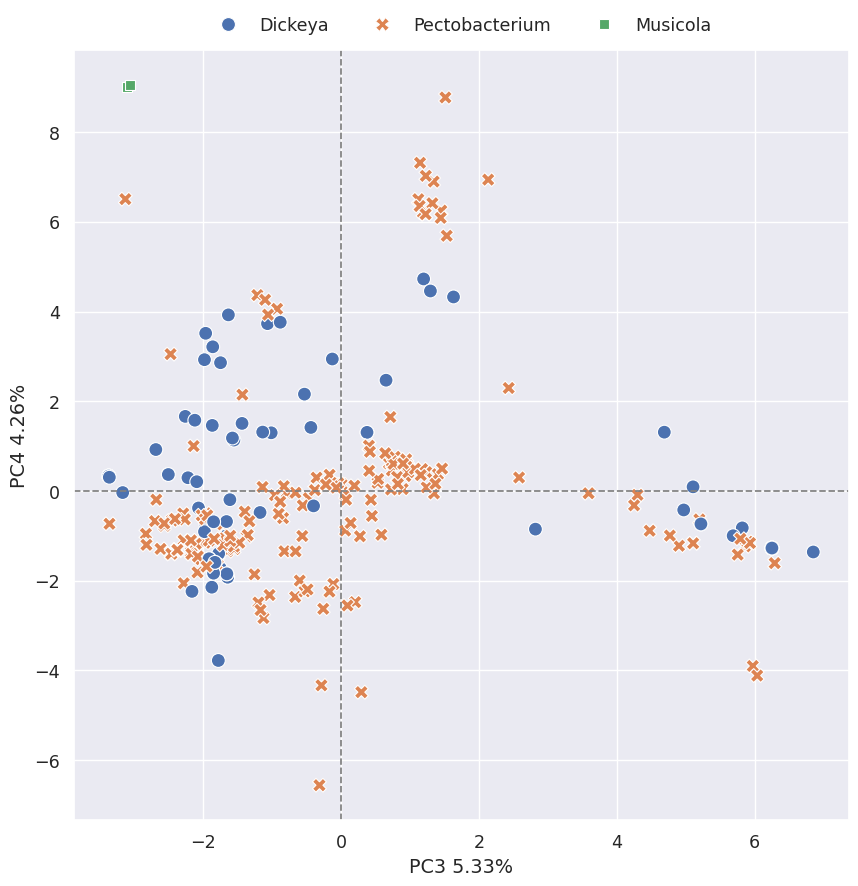

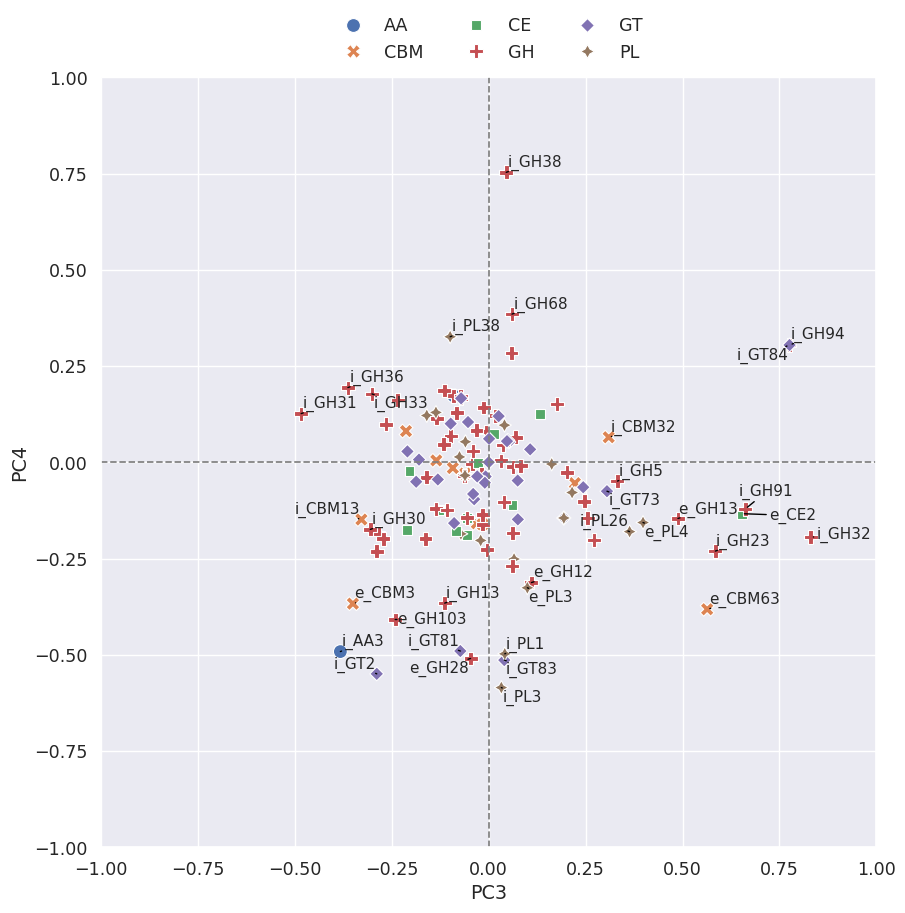

In [153]:
pc3_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    3,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/ie_pca/ie_pc3_pc4.png",
)

pc3_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    3,
    4,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/ie_pc3_pc4_species.png",
)

pc3_pc4_labels = plot_ie_loadings(
    ie_pca,
    ie_fam_freq_df_ggs,
    3,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/ie_pca/ie_pc3_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc3_pc4_labels = [_._text for _ in pc3_pc4_labels]
pc3_pc4_fams = {}
for fam in pc3_pc4_labels:
    try:
        pc3_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc3_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc3_pc4_fams:
    if len(pc3_pc4_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order


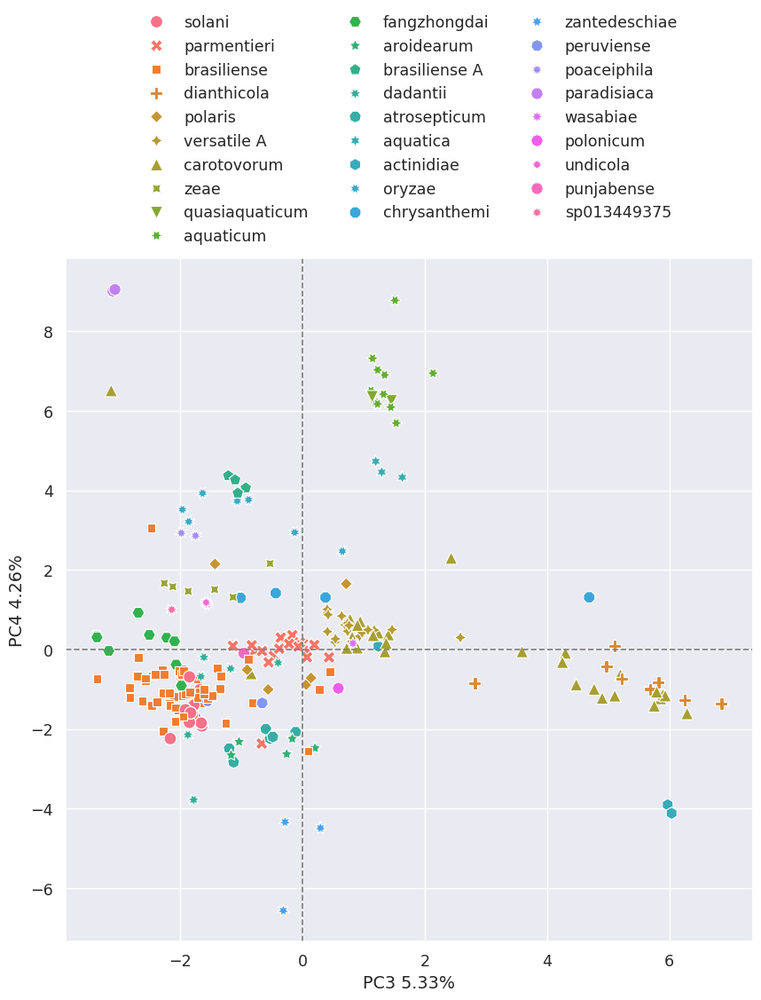

In [154]:
ie_fam_freq_df_ggs['Species'] = list(ie_fam_freq_df['Species'])
pc3_pc4_scatter_plt = plot_pca(
    ie_pca,
    ie_X_scaled,
    ie_fam_freq_df_ggs,
    3,
    4,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/ie_pca/pca_ie_3_vs_4_species.svg",
    file_format='svg',
)

## 6.2 PCA of intracellular families

This includes all families that were identified to have intracellular CAZymes (i.e. a signal peptide was not prediced to be present by SignalP). This can include families with CAZymes also found in the extracellular space (i.e. a signal peptide was predicted to be presented in some family members).

Output directory ../results/ie_cazymes/i_pca exists, nodelete is True. Adding output to output directory.


PCA(n_components=88)
100.0% of the variance in the data set was catpured by the PCA
Number of features needed to explain 0.95 fraction of total variance is 45. 


<Figure size 1200x600 with 0 Axes>

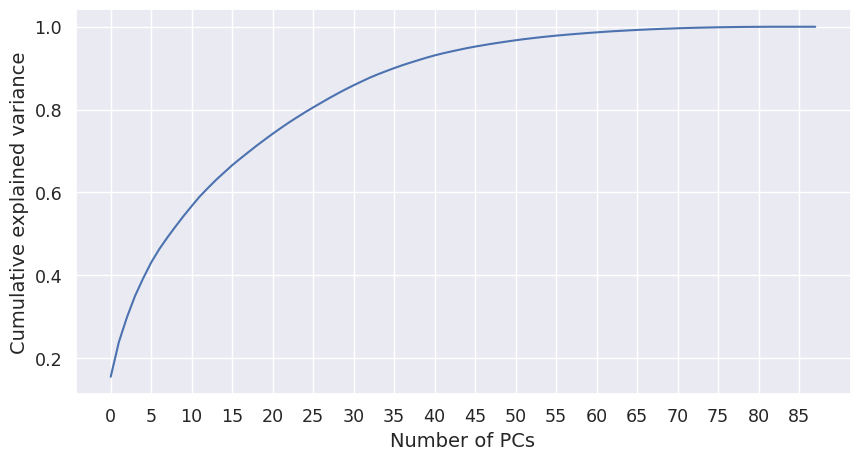

In [155]:
i_fam_freq_df_ggs = ie_fam_freq_df_ggs[intrac_cols]

num_of_components = len(i_fam_freq_df_ggs.columns)
i_pca, i_X_scaled = perform_pca(i_fam_freq_df_ggs, num_of_components)
print(i_pca)

make_output_directory(Path("../results/ie_cazymes/i_pca"), force=True, nodelete=True)

print(f"{i_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

cumExpVar = plot_explained_variance(
    i_pca,
    num_of_components,
    file_path="../results/ie_cazymes/i_pca/pd_pca_IE_explained_variance.png",
)

Explained variance for 1PC: 0.15454683976067185
Explained variance for 2PC: 0.0834828523639291
Explained variance for 3PC: 0.060125503307268735
Explained variance for 4PC: 0.05148887607075085
Explained variance for 5PC: 0.04248178246293622
Explained variance for 6PC: 0.038646206680417954
Explained variance for 7PC: 0.03223334516416426
Explained variance for 8PC: 0.028157400721296664
Explained variance for 9PC: 0.02629539533978042
Explained variance for 10PC: 0.025459789770284326


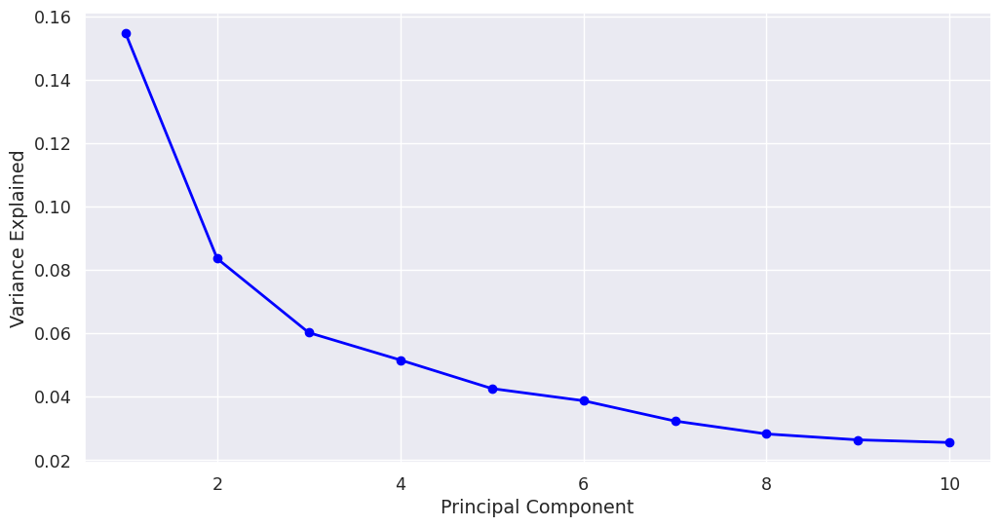

In [156]:
plot_scree(i_pca, nComp=10, file_path="../results/ie_cazymes/i_pca/pd_pca_IE_scree.png")

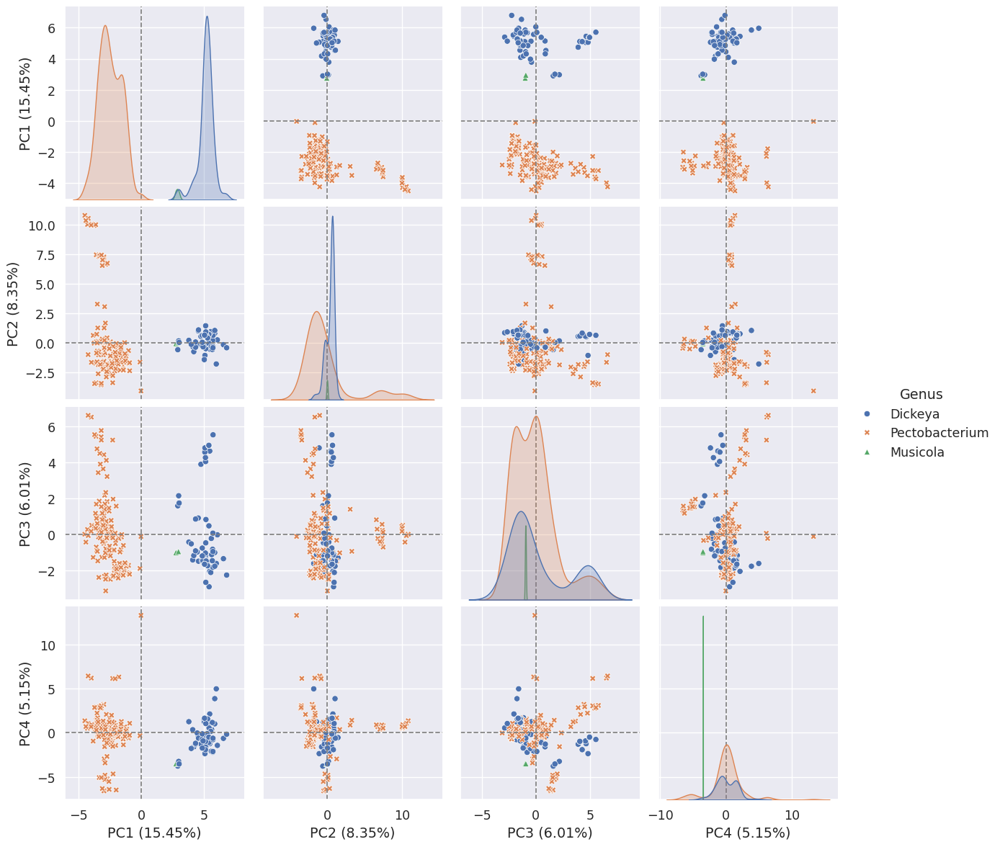

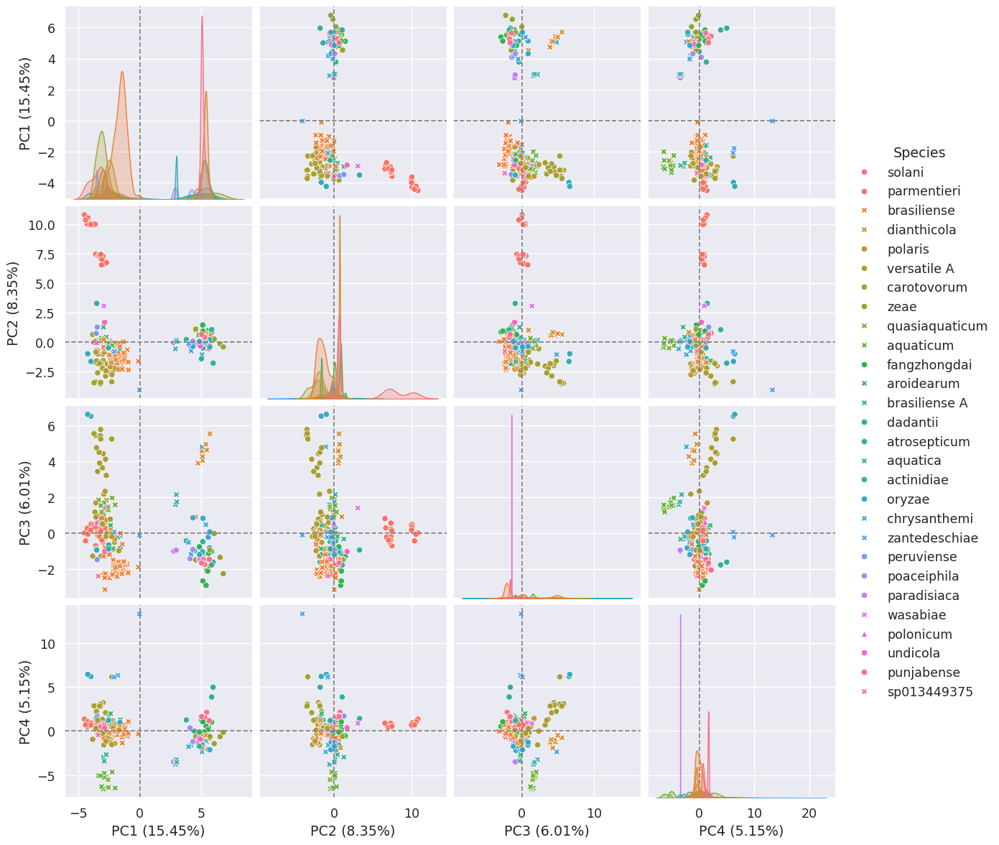

In [157]:
# multiplot
i_fam_freq_df_ggs_pc = copy(i_fam_freq_df_ggs)
i_fam_freq_df_ggs_pc['Genus'] = list(i_fam_freq_df['Genus'])
X_pca = i_pca.transform(i_X_scaled)

colnames = []
for i in range(4):
    i_fam_freq_df_ggs_pc[f'PC{i+1} ({round(i_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(i_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    i_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Genus",
    diag_kind="kde",
    markers=['o','X', '^'],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/i_pca/pd_pc_screen_genus.svg',
    bbox_inches='tight',
    format='svg'
)

try:
    i_fam_freq_df_ggs_pc = i_fam_freq_df_ggs_pc.drop('Genus', axis=1)
except KeyError:
    pass
i_fam_freq_df_ggs_pc['Species'] = list(i_fam_freq_df['Species'])

colnames = []
for i in range(4):
    i_fam_freq_df_ggs_pc[f'PC{i+1} ({round(i_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(i_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    i_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Species",
    diag_kind="kde",
    markers=[
        'o', 'o', 'X', 'X', 'o', 'o',
        'o', 'o', 'X', 'X', 'o', 'X',
        'X', 'o', 'o', 'X', 'o', 'o',
        'X', 'X', 'o', 'o', 'o', 'X',
        '^', 'o', 'o', 'X',
    ],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/i_pca/pd_pc_screen_species.svg',
    bbox_inches='tight',
    format='svg'
)

Plot each PC separately.

/tmp/ipykernel_479/83899765.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


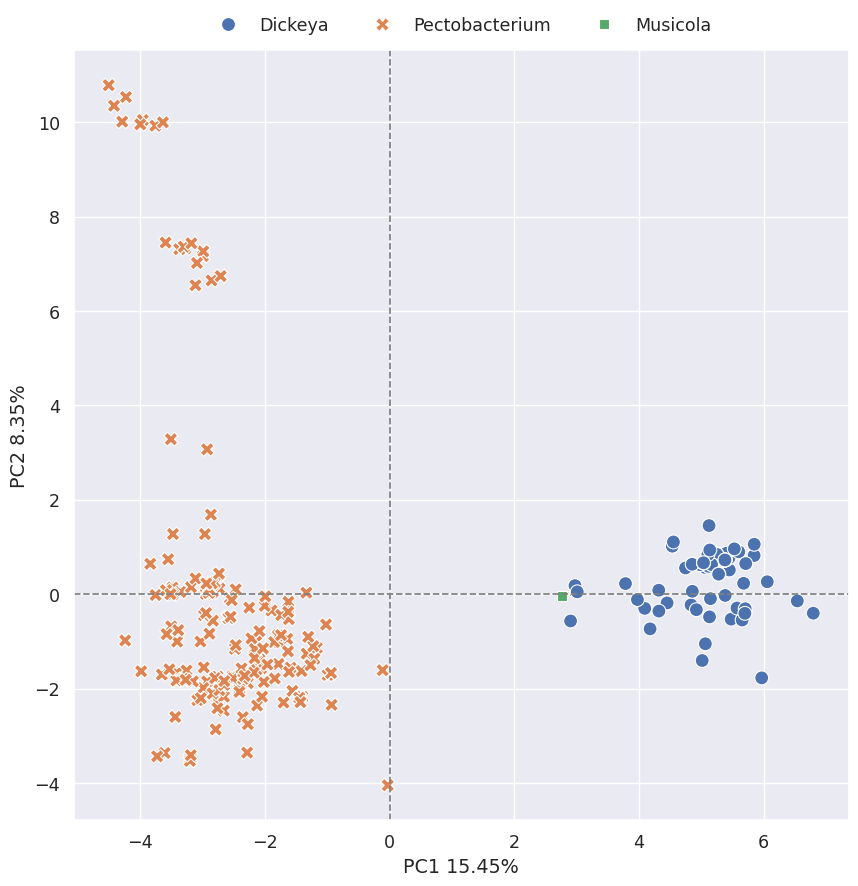

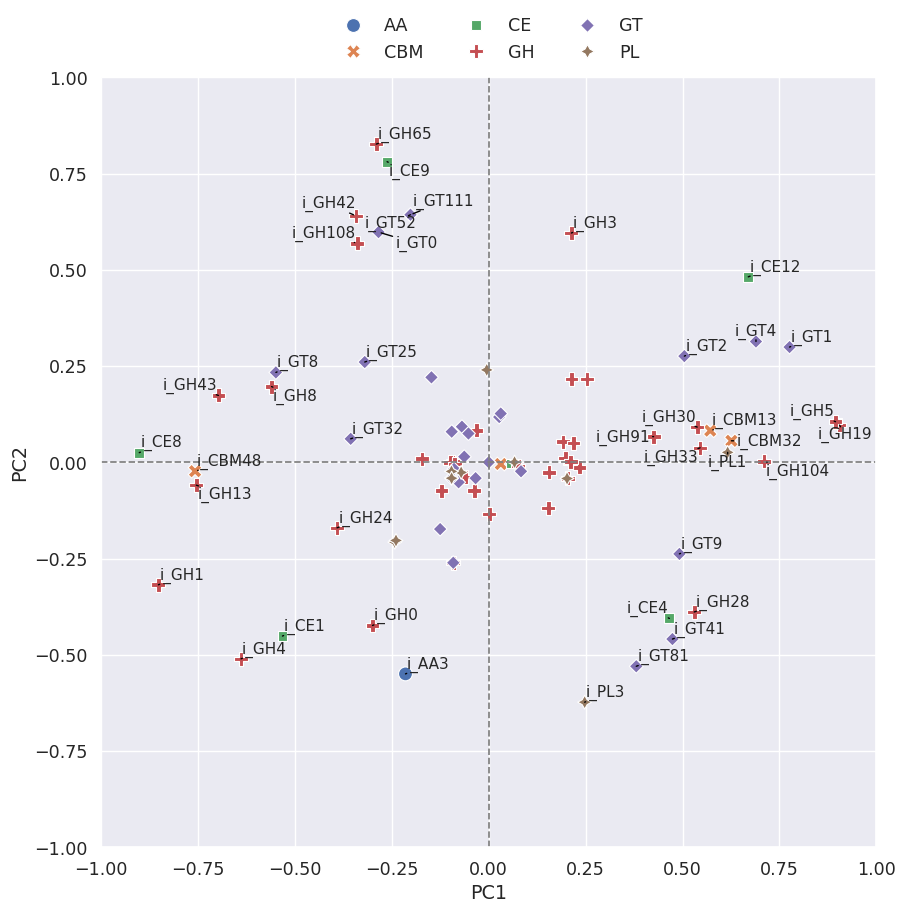

In [158]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc1_pc2_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    1,
    2,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc2.png",
)

pc1_pc2_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    1,
    2,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc2_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc2_labels = [_._text for _ in pc1_pc2_labels]
pc1_pc2_fams = {}
for fam in pc1_pc2_labels:
    try:
        pc1_pc2_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc2_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc2_fams:
    if len(pc1_pc2_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/664309407.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


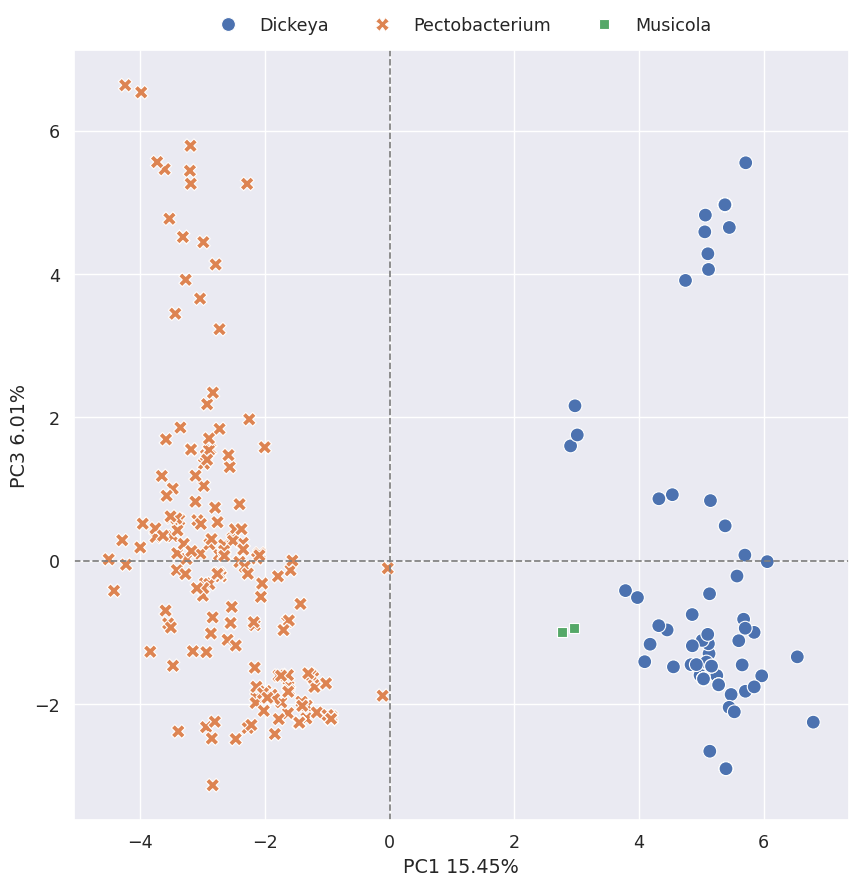

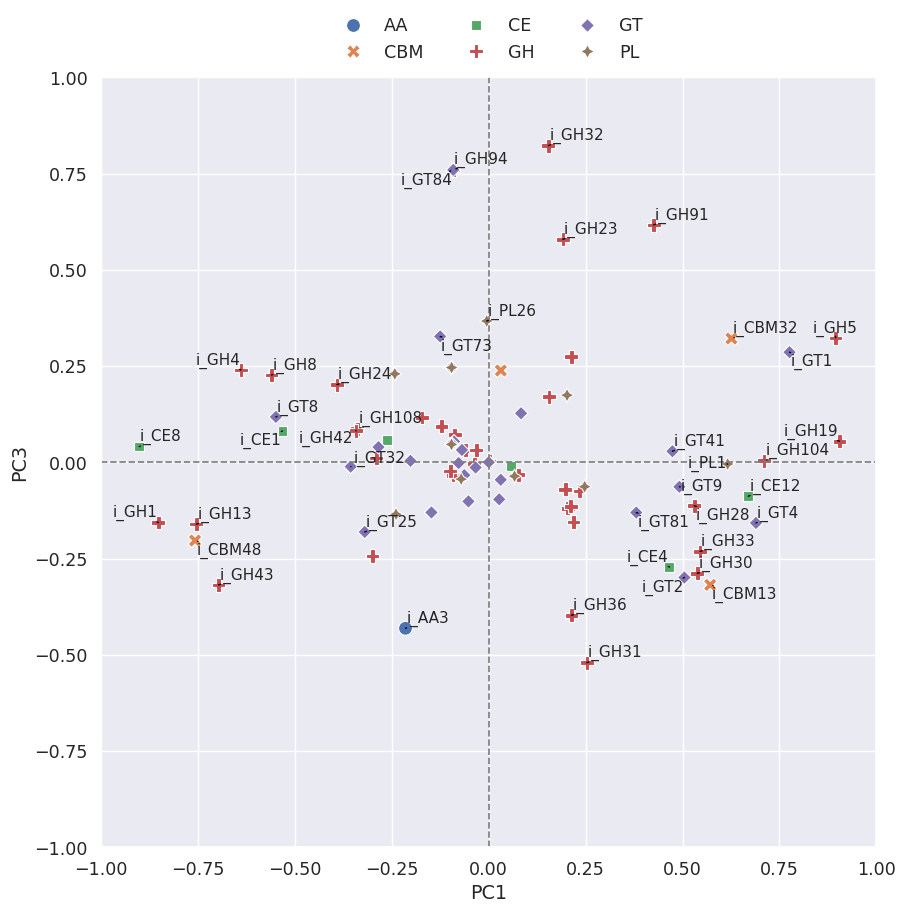

In [159]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc1_pc3_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    1,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc3.png",
)

pc1_pc3_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    1,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc3_labels = [_._text for _ in pc1_pc3_labels]
pc1_pc3_fams = {}
for fam in pc1_pc3_labels:
    try:
        pc1_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc3_fams:
    if len(pc1_pc3_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/1551041151.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


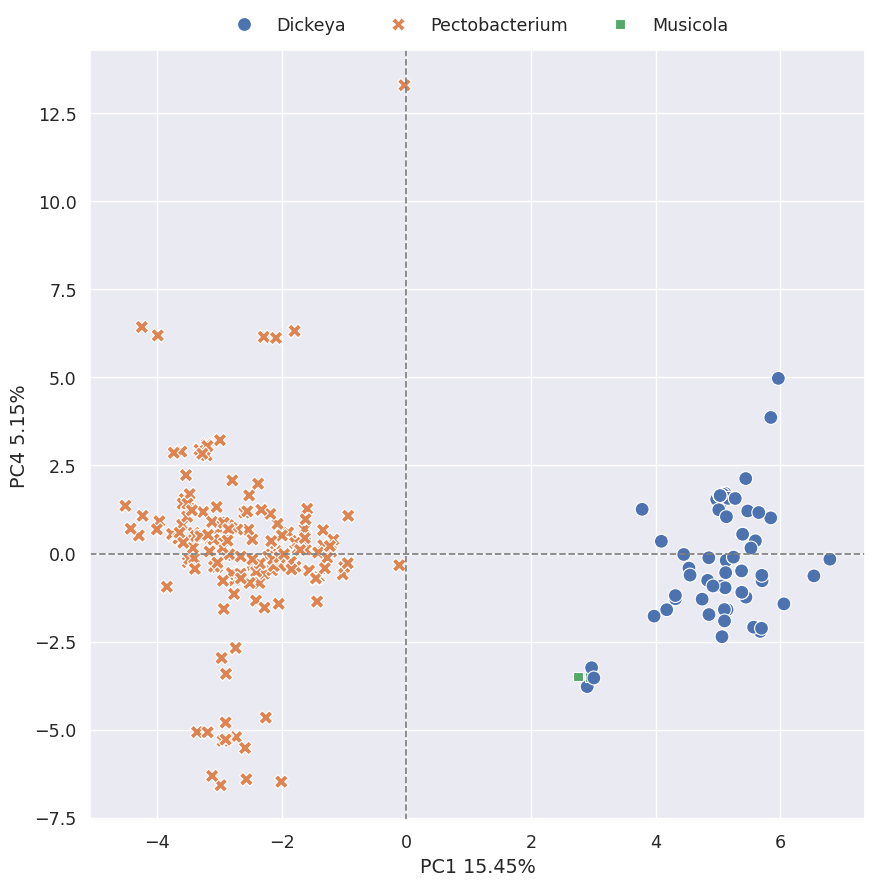

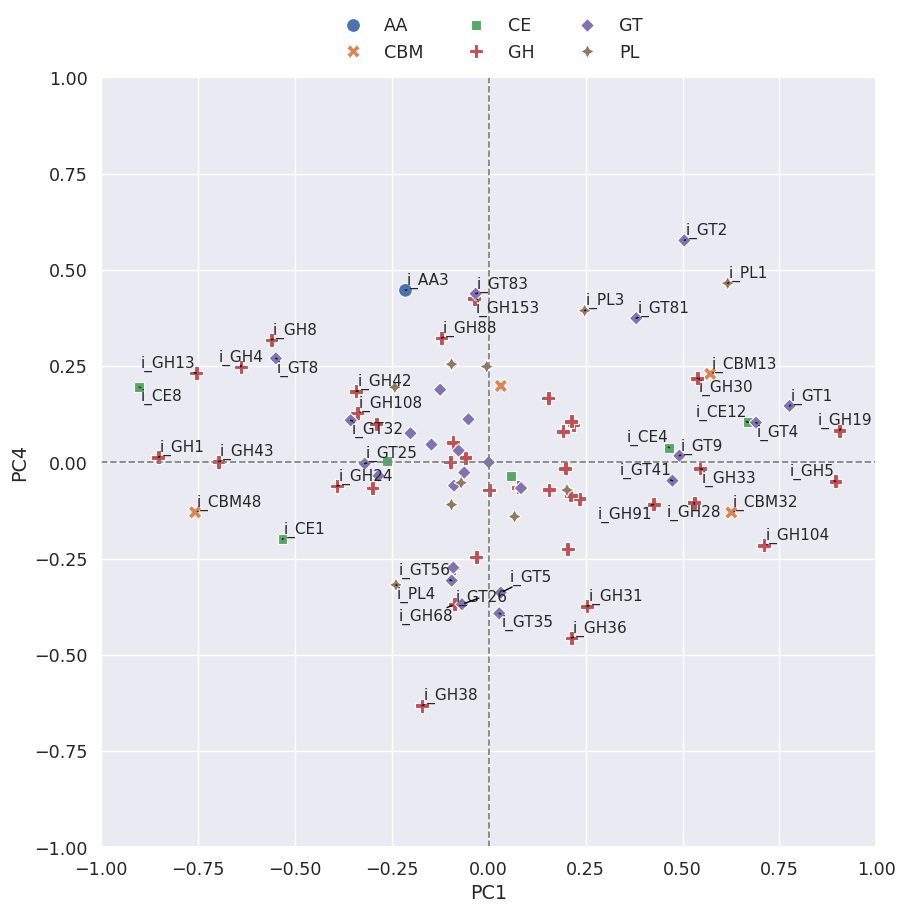

In [160]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc1_pc4_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    1,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc4.png",
)

pc1_pc4_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    1,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc1_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc4_labels = [_._text for _ in pc1_pc4_labels]
pc1_pc4_fams = {}
for fam in pc1_pc4_labels:
    try:
        pc1_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc4_fams:
    if len(pc1_pc4_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/878882969.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


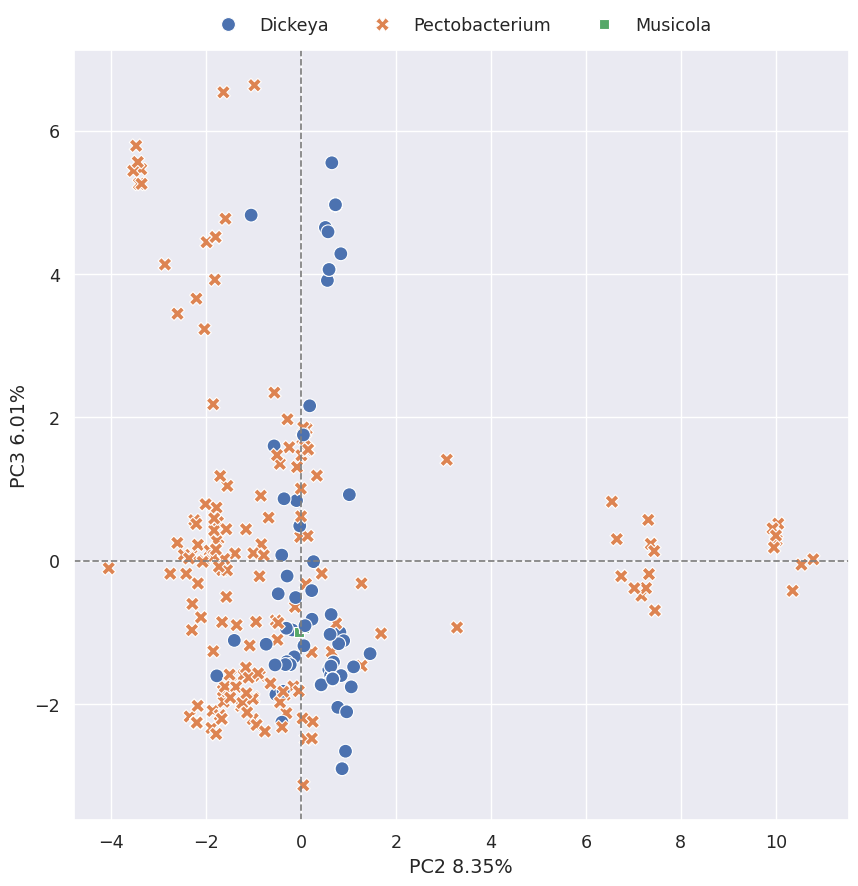

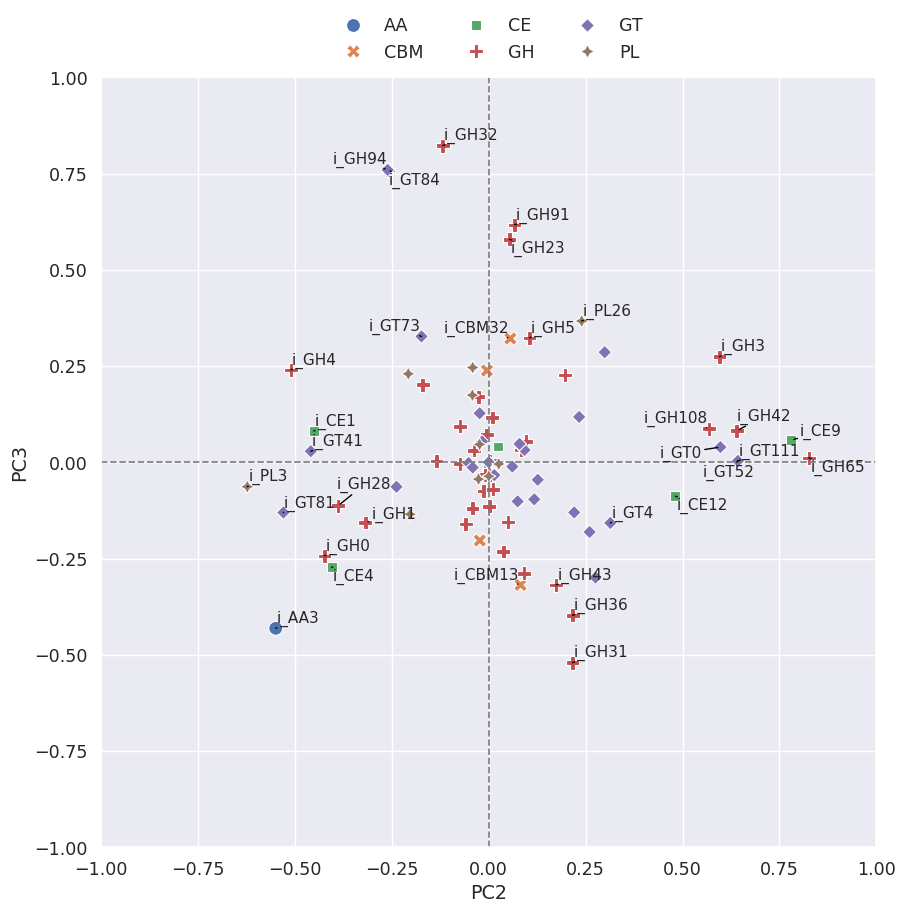

In [161]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc2_pc3_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    2,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc2_pc3.png",
)

pc2_pc3_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    2,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc2_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc3_labels = [_._text for _ in pc2_pc3_labels]
pc2_pc3_fams = {}
for fam in pc2_pc3_labels:
    try:
        pc2_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc3_fams:
    if len(pc2_pc3_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/1749631204.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


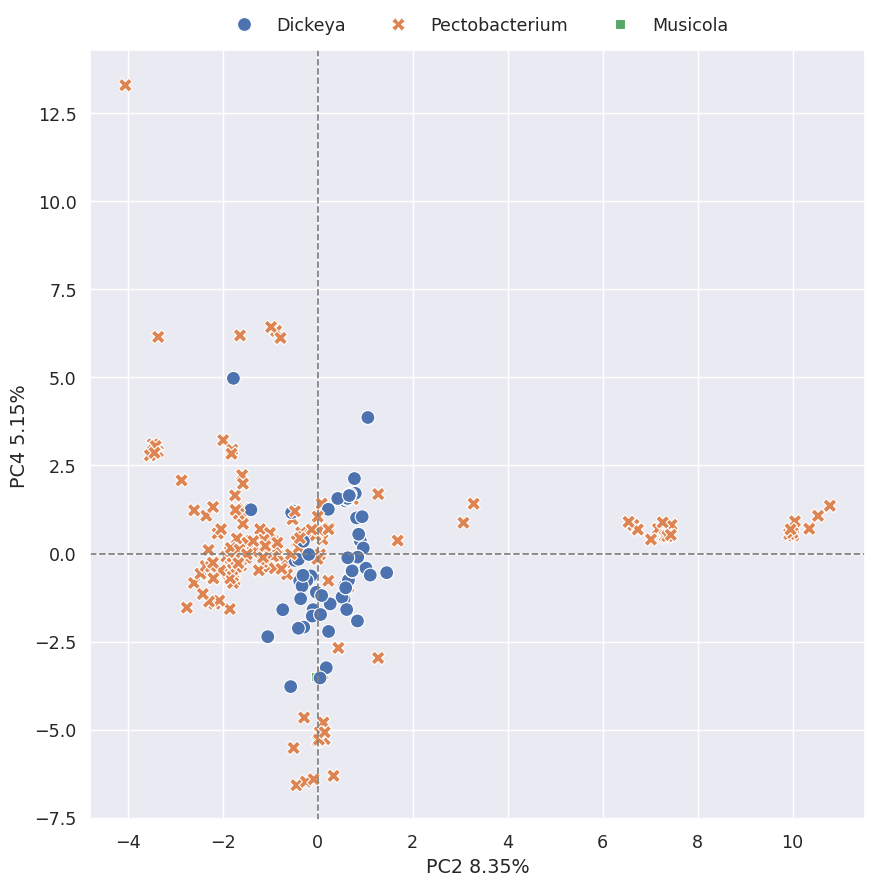

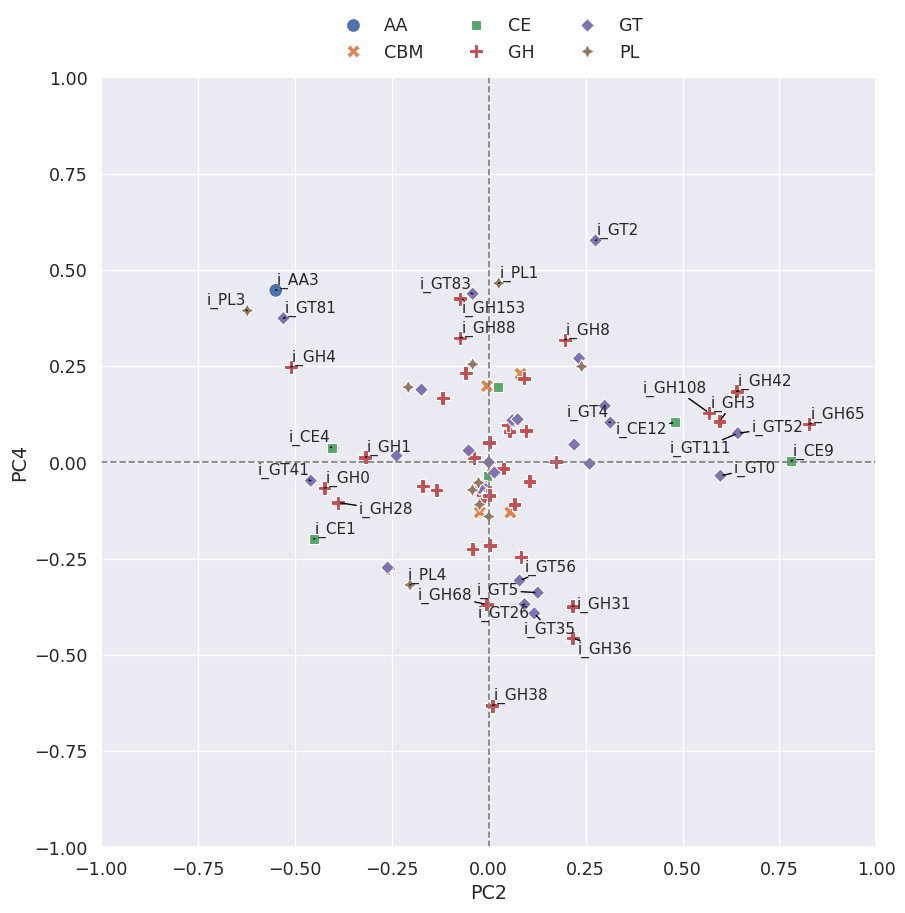

In [162]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc2_pc4_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    2,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc2_pc4.png",
)

pc2_pc4_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    2,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc2_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc4_labels = [_._text for _ in pc2_pc4_labels]
pc2_pc4_fams = {}
for fam in pc2_pc4_labels:
    try:
        pc2_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc4_fams:
    if len(pc2_pc4_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/40578501.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


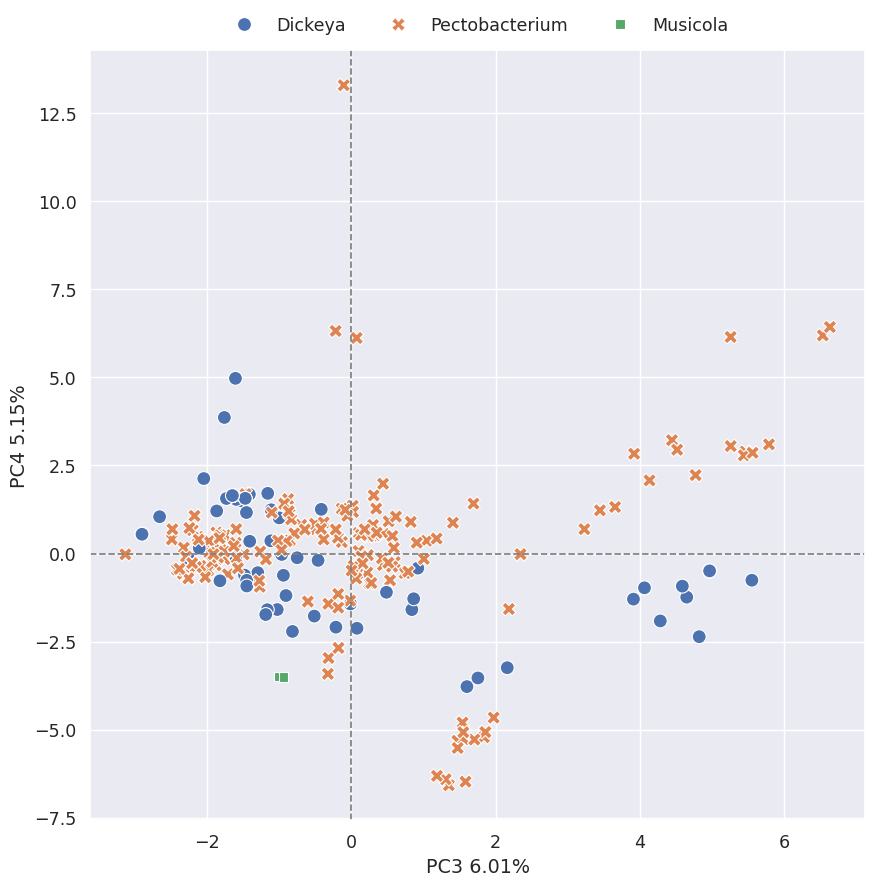

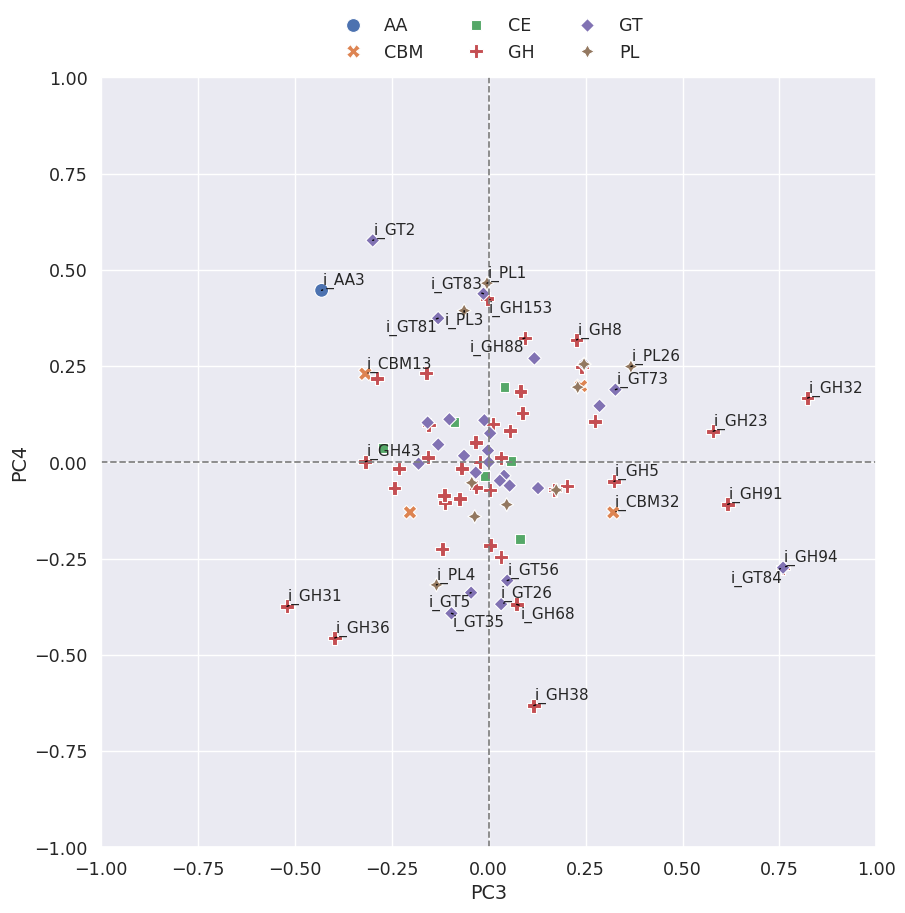

In [163]:
i_fam_freq_df_ggs['Genus'] = list(i_fam_freq_df['Genus'])  # add column to use for colour scheme

pc3_pc4_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    3,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/i_pca/i_pc3_pc4.png",
)

pc3_pc4_labels = plot_ie_loadings(
    i_pca,
    i_fam_freq_df_ggs,
    3,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/i_pca/i_pc3_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc3_pc4_labels = [_._text for _ in pc3_pc4_labels]
pc3_pc4_fams = {}
for fam in pc3_pc4_labels:
    try:
        pc3_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc3_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc3_pc4_fams:
    if len(pc3_pc4_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/454184917.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  i_fam_freq_df_ggs['Species'] = list(i_fam_freq_df['Species'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


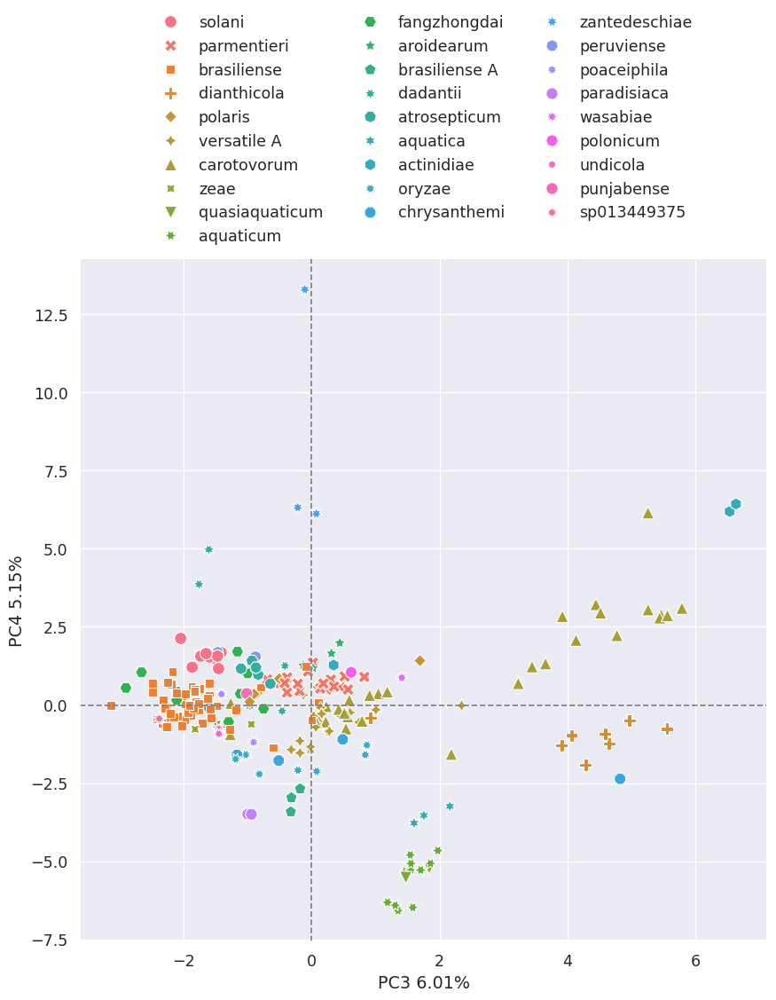

In [164]:
i_fam_freq_df_ggs['Species'] = list(i_fam_freq_df['Species'])  # add column to use for colour scheme

pc3_pc4_scatter_plt = plot_pca(
    i_pca,
    i_X_scaled,
    i_fam_freq_df_ggs,
    3,
    4,
    'Species',
    figsize=(10,10),
    style='Species',
    file_path="../results/ie_cazymes/i_pca/i_pc3_pc4_species.png",
)

## 6.3 PCA of extracellular families

This includes all families that were identified to have extracellular CAZymes (i.e. a signal peptide was prediced to be present by SignalP). This can include families with CAZymes also found in the intracellular space (i.e. a signal peptide was not predicted to be presented in some family members).

Output directory ../results/ie_cazymes/e_pca exists, nodelete is True. Adding output to output directory.


PCA(n_components=44)
100.0% of the variance in the data set was catpured by the PCA
Number of features needed to explain 0.95 fraction of total variance is 26. 


<Figure size 1200x600 with 0 Axes>

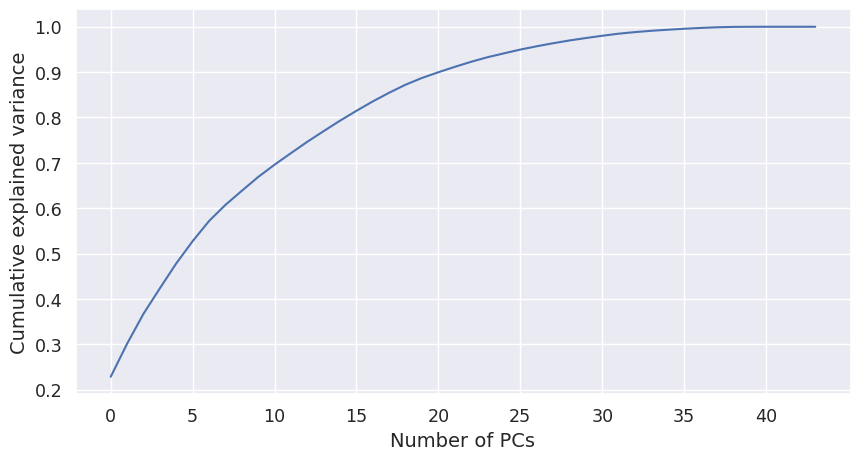

In [165]:
e_fam_freq_df_ggs = ie_fam_freq_df_ggs[extrac_cols]

num_of_components = len(e_fam_freq_df_ggs.columns)
e_pca, e_X_scaled = perform_pca(e_fam_freq_df_ggs, num_of_components)
print(e_pca)

make_output_directory(Path("../results/ie_cazymes/e_pca"), force=True, nodelete=True)

print(f"{e_pca.explained_variance_ratio_.sum() * 100}% of the variance in the data set was catpured by the PCA")

cumExpVar = plot_explained_variance(
    e_pca,
    num_of_components,
    file_path="../results/ie_cazymes/e_pca/pd_pca_IE_explained_variance.png",
)

Explained variance for 1PC: 0.22852140989711353
Explained variance for 2PC: 0.07286778687197029
Explained variance for 3PC: 0.0659550653530078
Explained variance for 4PC: 0.05615341356754494
Explained variance for 5PC: 0.05490691317249101
Explained variance for 6PC: 0.04899328522245456
Explained variance for 7PC: 0.044316222567705996
Explained variance for 8PC: 0.035613504034801194
Explained variance for 9PC: 0.031087555865400594
Explained variance for 10PC: 0.03047734378659763


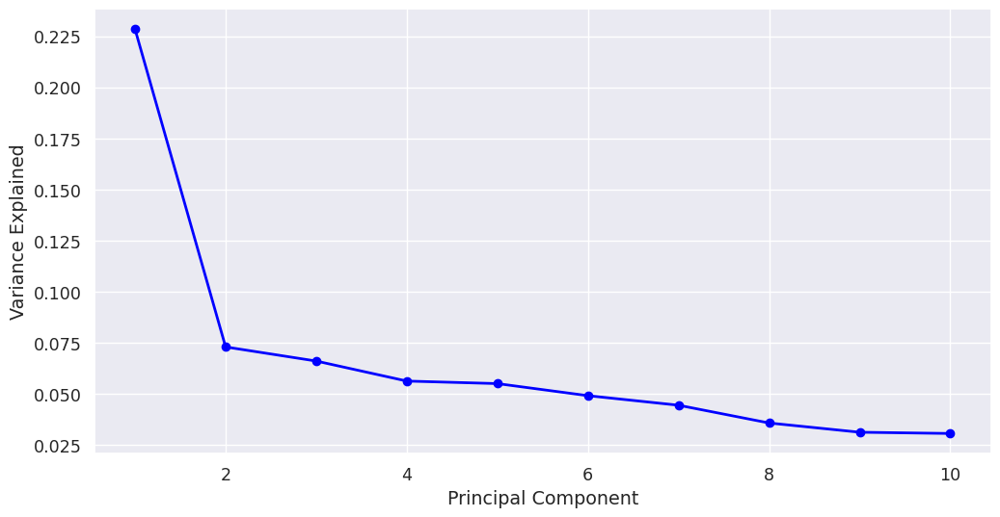

In [166]:
plot_scree(e_pca, nComp=10, file_path="../results/ie_cazymes/e_pca/pd_pca_E_scree.png")

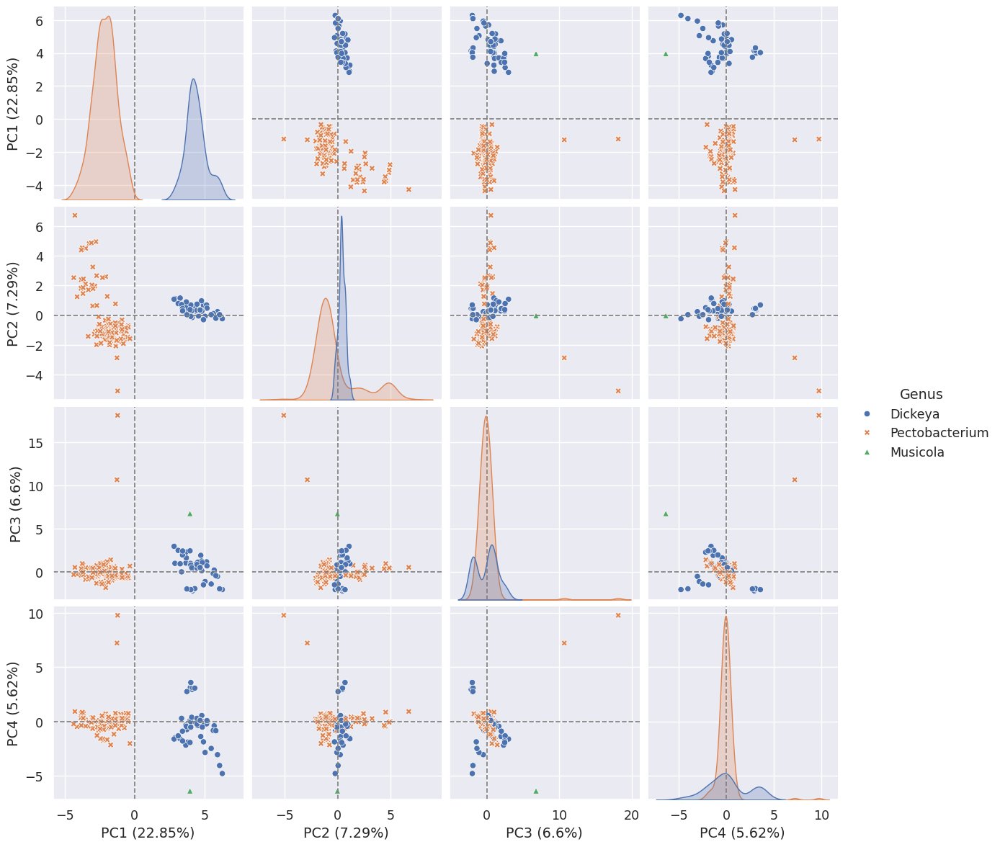

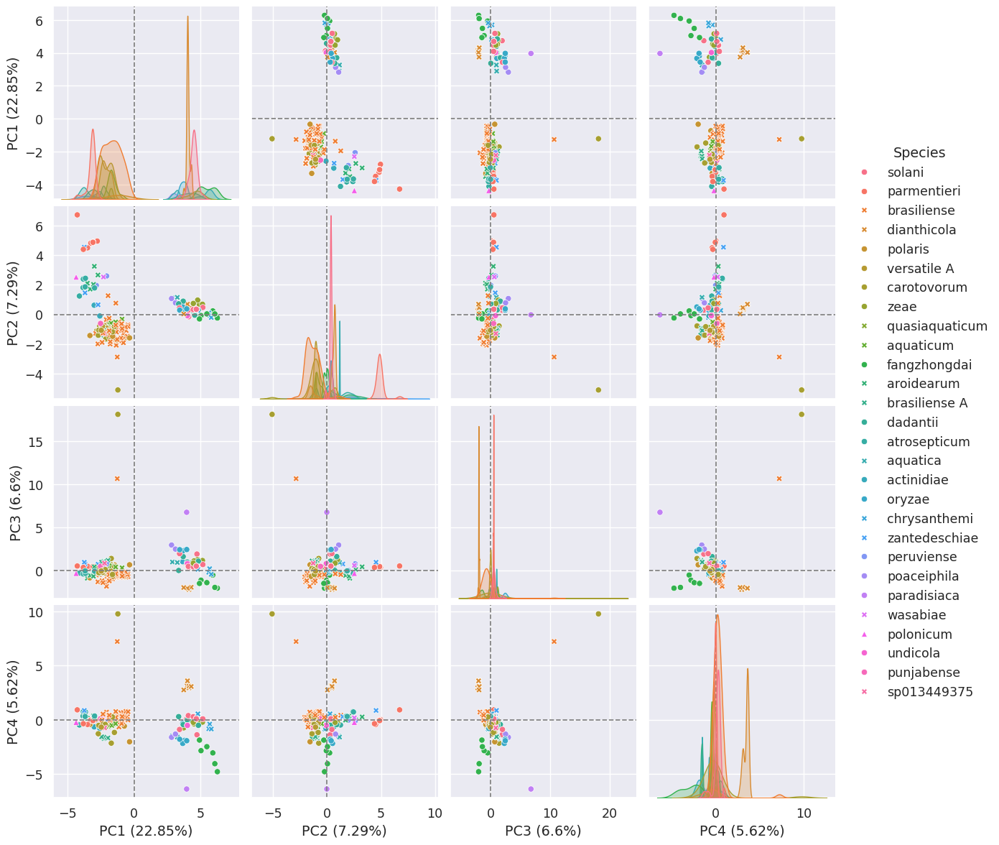

In [167]:
# multiplot
e_fam_freq_df_ggs_pc = copy(e_fam_freq_df_ggs)
e_fam_freq_df_ggs_pc['Genus'] = list(e_fam_freq_df['Genus'])
X_pca = e_pca.transform(e_X_scaled)

colnames = []
for i in range(4):
    e_fam_freq_df_ggs_pc[f'PC{i+1} ({round(e_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(e_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    e_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Genus",
    diag_kind="kde",
    markers=['o','X', '^'],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/e_pca/pd_pc_screen_genus.svg',
    bbox_inches='tight',
    format='svg'
)

try:
    e_fam_freq_df_ggs_pc = e_fam_freq_df_ggs_pc.drop('Genus', axis=1)
except KeyError:
    pass
e_fam_freq_df_ggs_pc['Species'] = list(e_fam_freq_df['Species'])

colnames = []
for i in range(4):
    e_fam_freq_df_ggs_pc[f'PC{i+1} ({round(e_pca.explained_variance_ratio_[i] * 100, 2)}%)'] = X_pca[:,i]
    colnames.append(f'PC{i+1} ({round(e_pca.explained_variance_ratio_[i] * 100, 2)}%)')
    
g = sns.pairplot(
    e_fam_freq_df_ggs_pc,
    vars=colnames,
    hue="Species",
    diag_kind="kde",
    markers=[
        'o', 'o', 'X', 'X', 'o', 'o',
        'o', 'o', 'X', 'X', 'o', 'X',
        'X', 'o', 'o', 'X', 'o', 'o',
        'X', 'X', 'o', 'o', 'o', 'X',
        '^', 'o', 'o', 'X',
    ],
    height=3,
);

i = 0
for ax in g.axes.ravel():
    if ax is None:
        continue
    if i not in [0,5,10,15]:
        ax.axhline(0, linestyle='--', color='grey', linewidth=1.25);
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    else:
        ax.axvline(0, linestyle='--', color='grey', linewidth=1.25);
    i += 1
    
plt.savefig(
    '../results/ie_cazymes/e_pca/pd_pc_screen_species.svg',
    bbox_inches='tight',
    format='svg'
)

Plot PC separately

/tmp/ipykernel_479/1787893727.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e_fam_freq_df_ggs['Genus'] = list(e_fam_freq_df['Genus'])  # add column to use for colour scheme


Not applying hue order
Applying style
Not applying style order


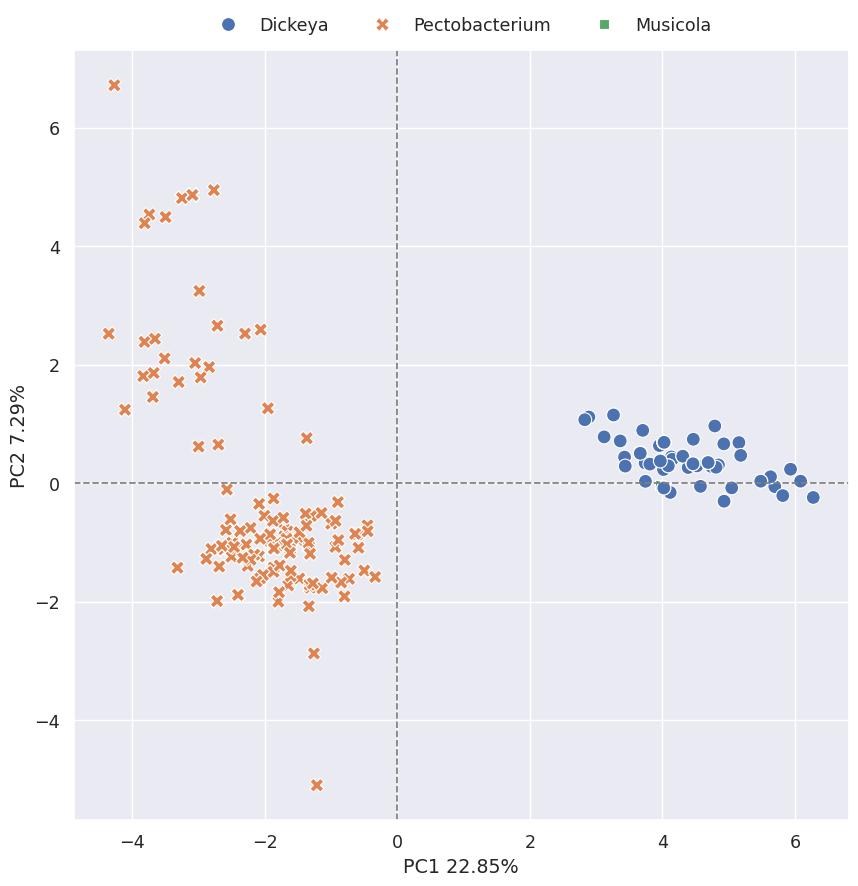

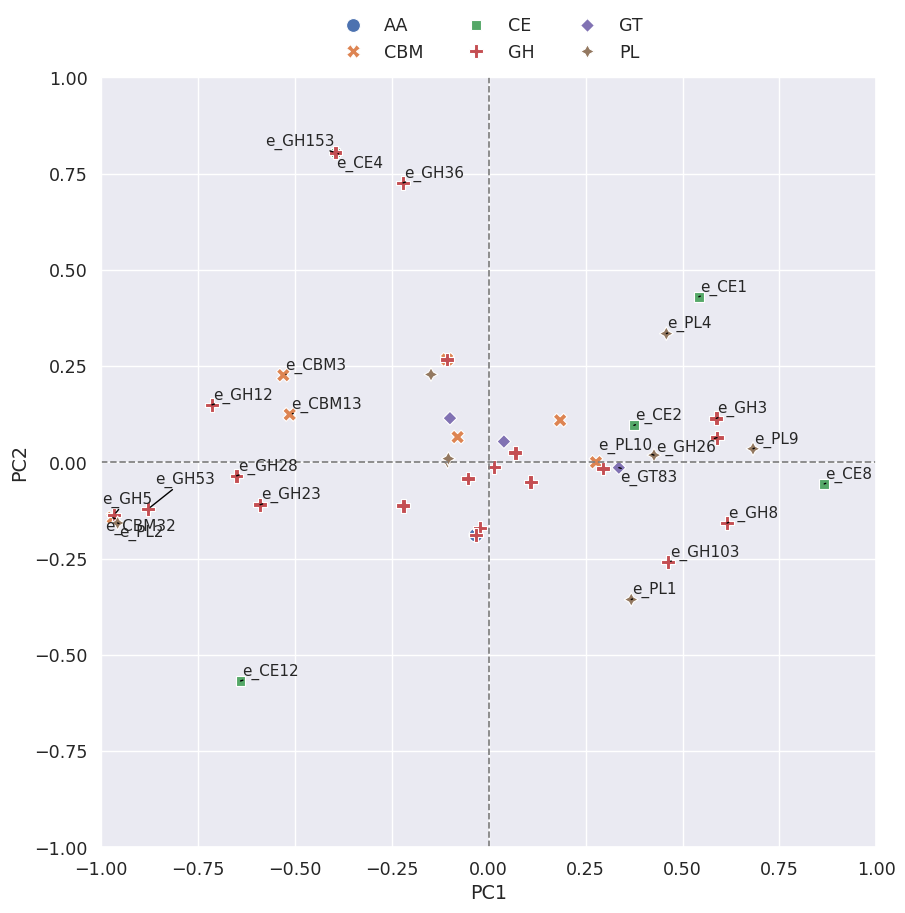

In [168]:
e_fam_freq_df_ggs['Genus'] = list(e_fam_freq_df['Genus'])  # add column to use for colour scheme

pc1_pc2_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    1,
    2,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc2.png",
)

pc1_pc2_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    1,
    2,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc2_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc2_labels = [_._text for _ in pc1_pc2_labels]
pc1_pc2_fams = {}
for fam in pc1_pc2_labels:
    try:
        pc1_pc2_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc2_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc2_fams:
    if len(pc1_pc2_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order


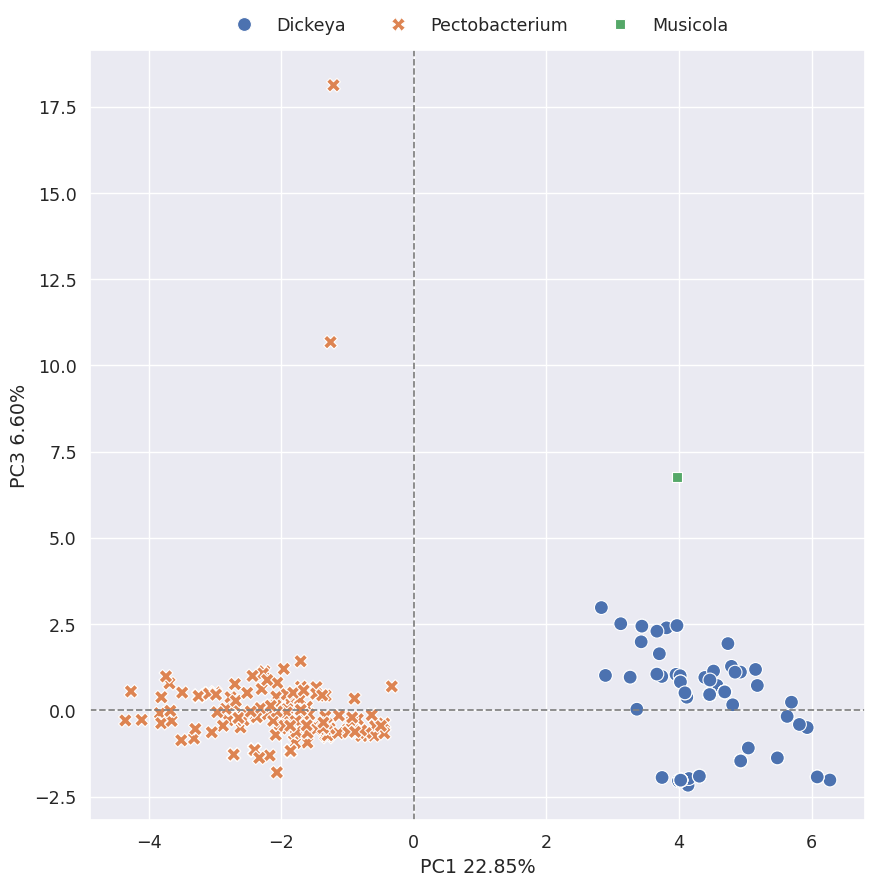

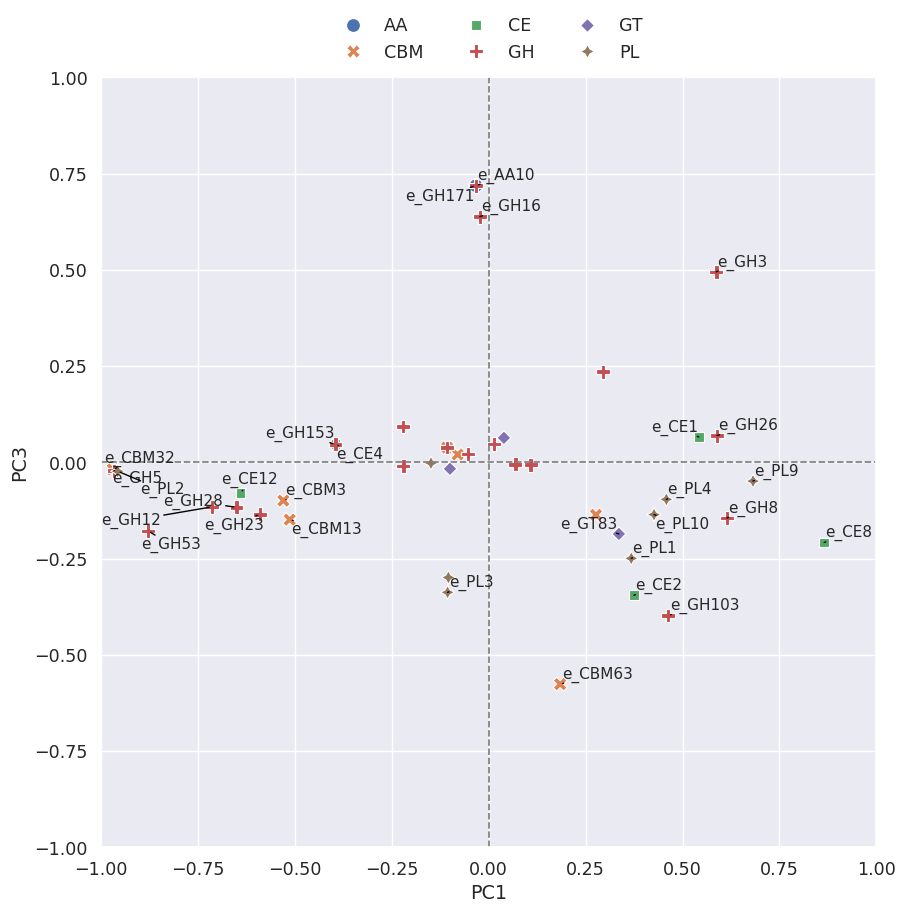

In [169]:
pc1_pc3_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    1,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc3.png",
)

pc1_pc3_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    1,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc3_labels = [_._text for _ in pc1_pc3_labels]
pc1_pc3_fams = {}
for fam in pc1_pc3_labels:
    try:
        pc1_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc3_fams:
    if len(pc1_pc3_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/343031468.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])


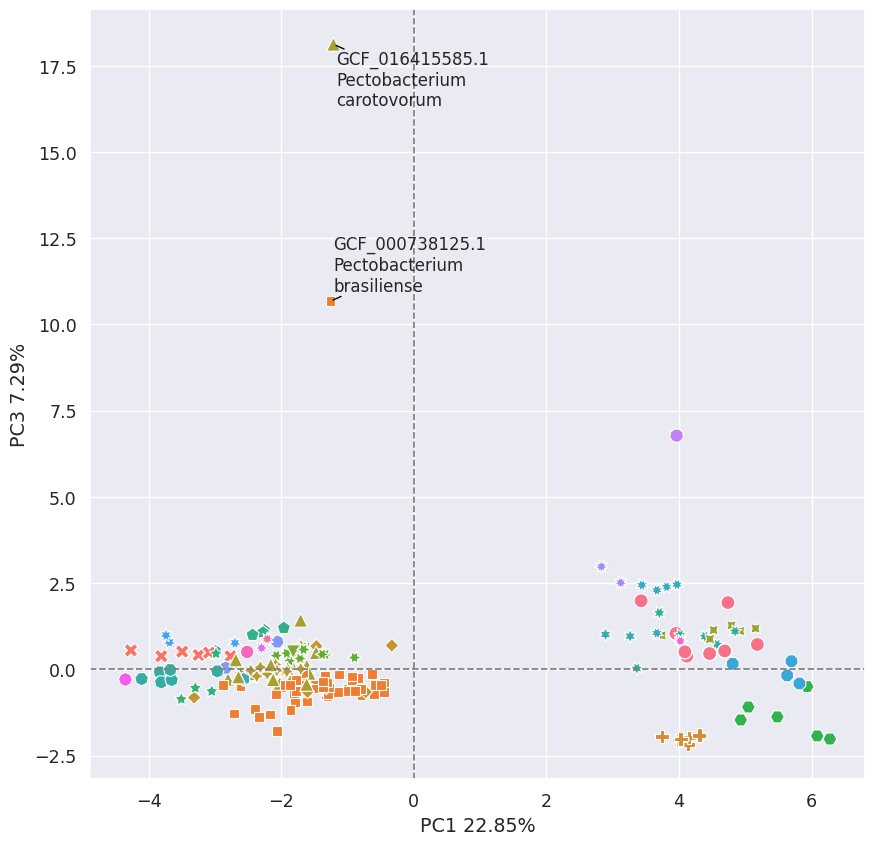

In [170]:
# plot pc 1 vs pc 3 - labelling pectobacterium species that are isolated from the rest of the group
X_pca = e_pca.transform(e_X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])

g = sns.scatterplot(
    x=X_pca[:,0],  # PC1
    y=X_pca[:,2],  # PC3
    data=e_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC3 {100 * e_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * e_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend([],[], frameon=False);

genome_lbls = ["\n".join(_) for _ in e_fam_freq_df_ggs.index]
x_vals = X_pca[:,0]
y_vals = X_pca[:,2]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if (yval > 10)
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig(
    "../results/ie_cazymes/e_pca/e_pc1_pc3_annotated_loadings.png",
    bbox_inches='tight',
    format='png',
)

Not applying hue order
Applying style
Not applying style order


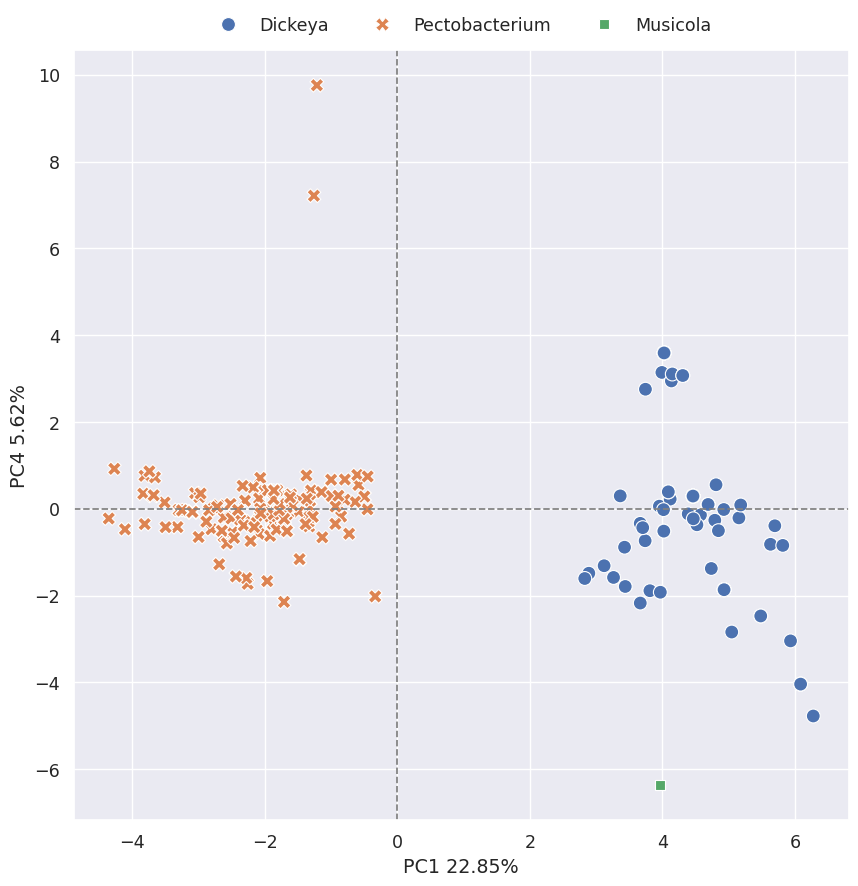

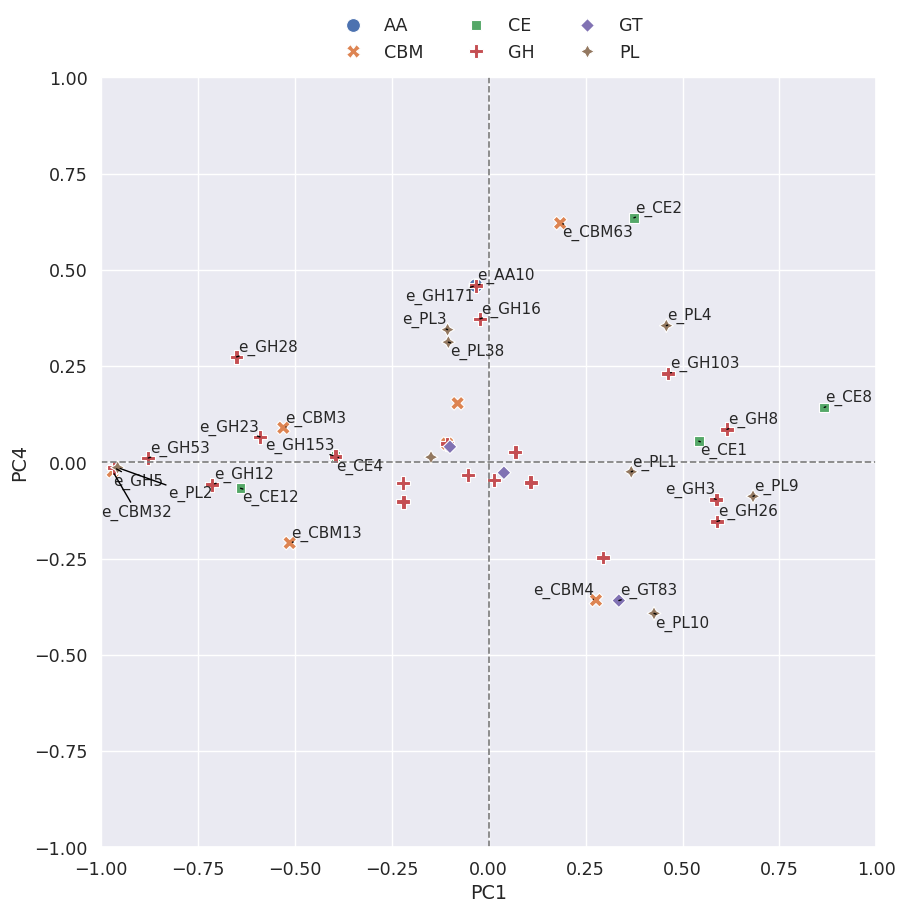

In [171]:
pc1_pc4_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    1,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc4.png",
)

pc1_pc4_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    1,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc1_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc1_pc4_labels = [_._text for _ in pc1_pc4_labels]
pc1_pc4_fams = {}
for fam in pc1_pc4_labels:
    try:
        pc1_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc1_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc1_pc4_fams:
    if len(pc1_pc4_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order


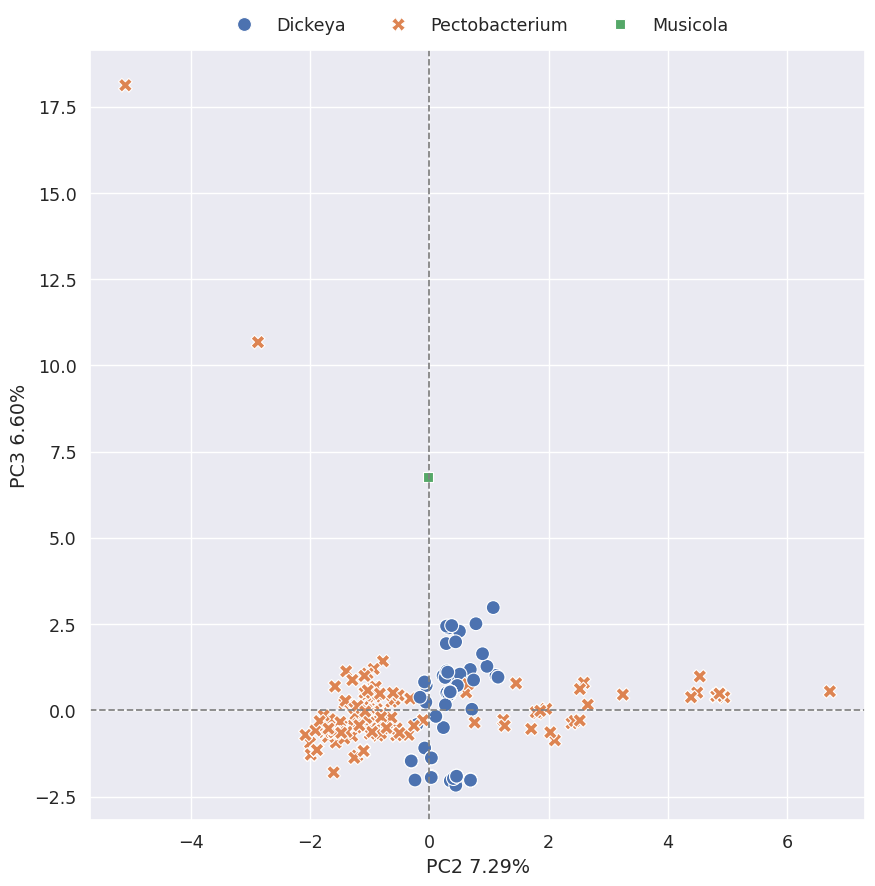

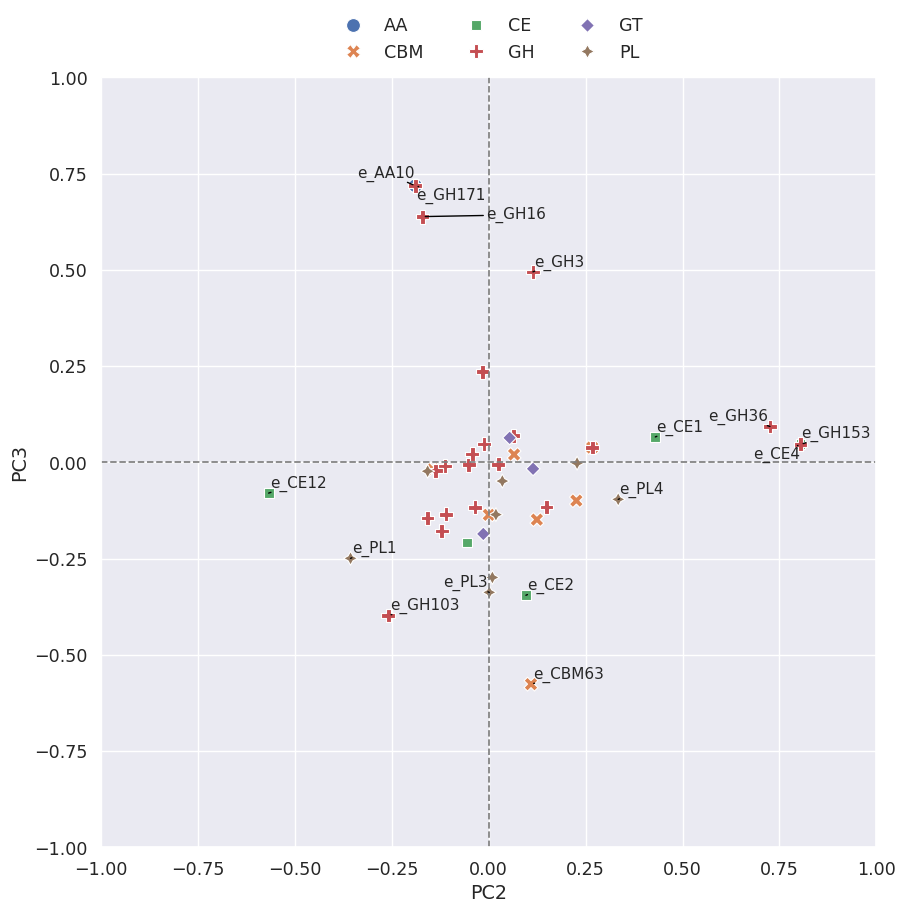

In [172]:
pc2_pc3_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    2,
    3,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc2_pc3.png",
)

pc2_pc3_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    2,
    3,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc2_pc3_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc3_labels = [_._text for _ in pc2_pc3_labels]
pc2_pc3_fams = {}
for fam in pc2_pc3_labels:
    try:
        pc2_pc3_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc3_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc3_fams:
    if len(pc2_pc3_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order


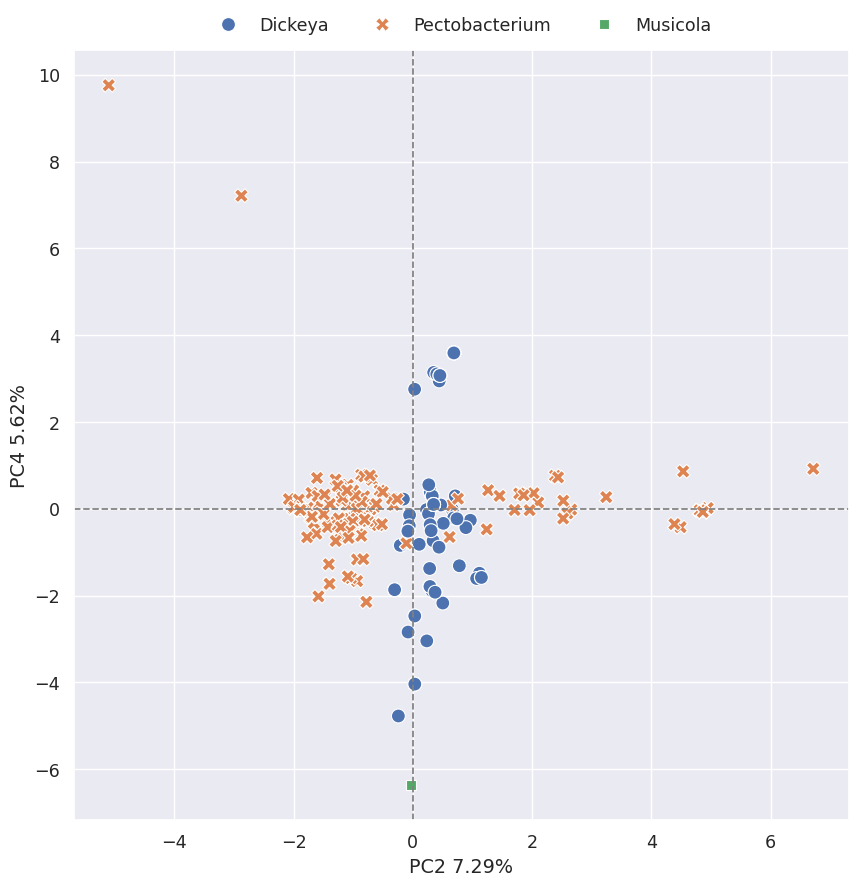

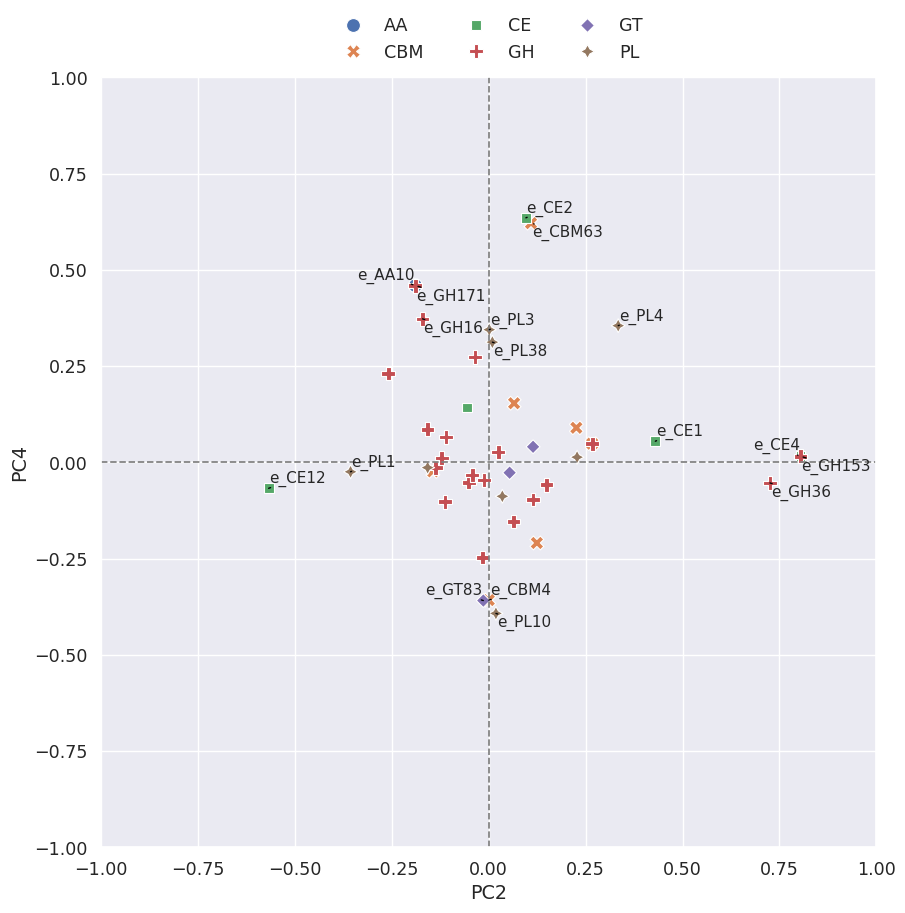

In [173]:
pc2_pc4_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    2,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc2_pc4.png",
)

pc2_pc4_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    2,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc2_pc4_loadings.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc2_pc4_labels = [_._text for _ in pc2_pc4_labels]
pc2_pc4_fams = {}
for fam in pc2_pc4_labels:
    try:
        pc2_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc2_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc2_pc4_fams:
    if len(pc2_pc4_fams[fam]) == 2:
        print(fam)

Not applying hue order
Applying style
Not applying style order


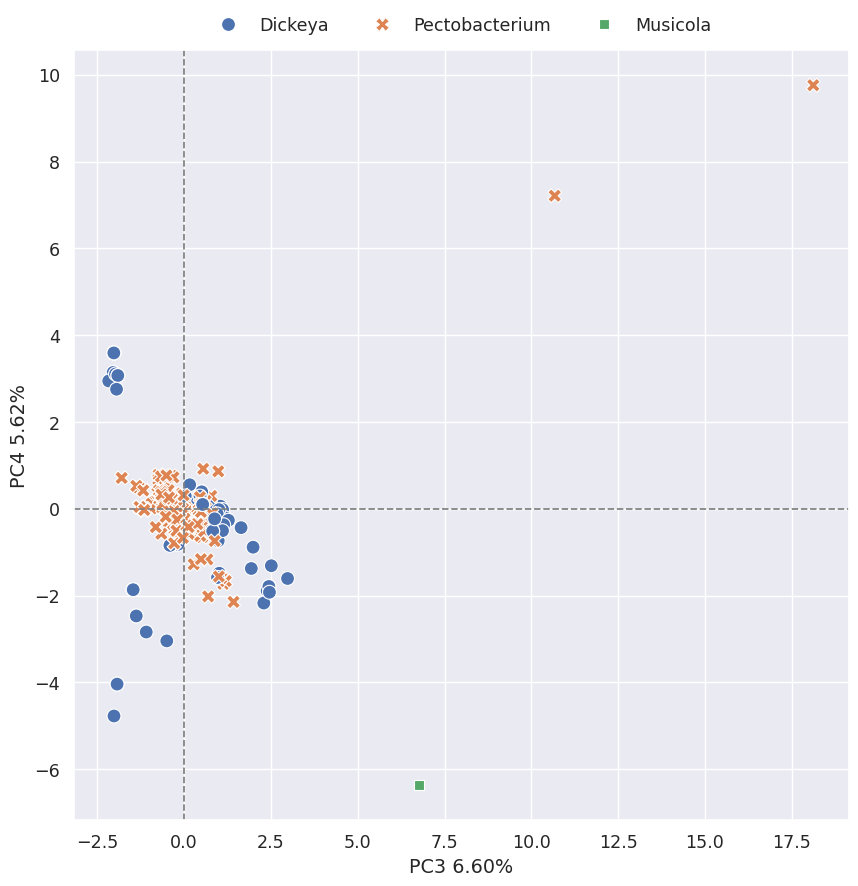

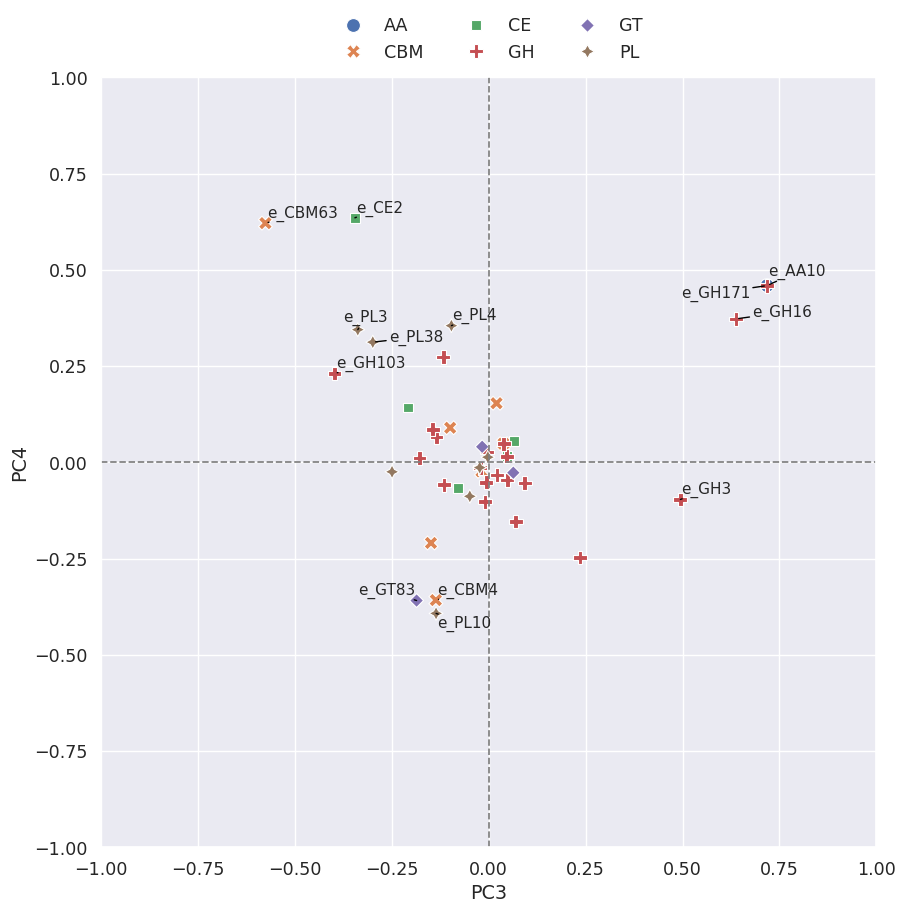

In [174]:
pc3_pc4_scatter_plt = plot_pca(
    e_pca,
    e_X_scaled,
    e_fam_freq_df_ggs,
    3,
    4,
    'Genus',
    figsize=(10,10),
    style='Genus',
    file_path="../results/ie_cazymes/e_pca/e_pc3_pc4.png",
)

pc3_pc4_labels = plot_ie_loadings(
    e_pca,
    e_fam_freq_df_ggs,
    3,
    4,
    style=True,
    threshold=0.3,
    fig_size=(10,10),
    font_size=11,
    file_path="../results/ie_cazymes/e_pca/e_pc3_pc4.png",
)

# identify families where both the intracellular and extracellular families were annotated
pc3_pc4_labels = [_._text for _ in pc3_pc4_labels]
pc3_pc4_fams = {}
for fam in pc3_pc4_labels:
    try:
        pc3_pc4_fams[fam.split("_")[1]].add(fam)
    except KeyError:
        pc3_pc4_fams[fam.split("_")[1]] = {fam}
for fam in pc3_pc4_fams:
    if len(pc3_pc4_fams[fam]) == 2:
        print(fam)

/tmp/ipykernel_479/1795624431.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])


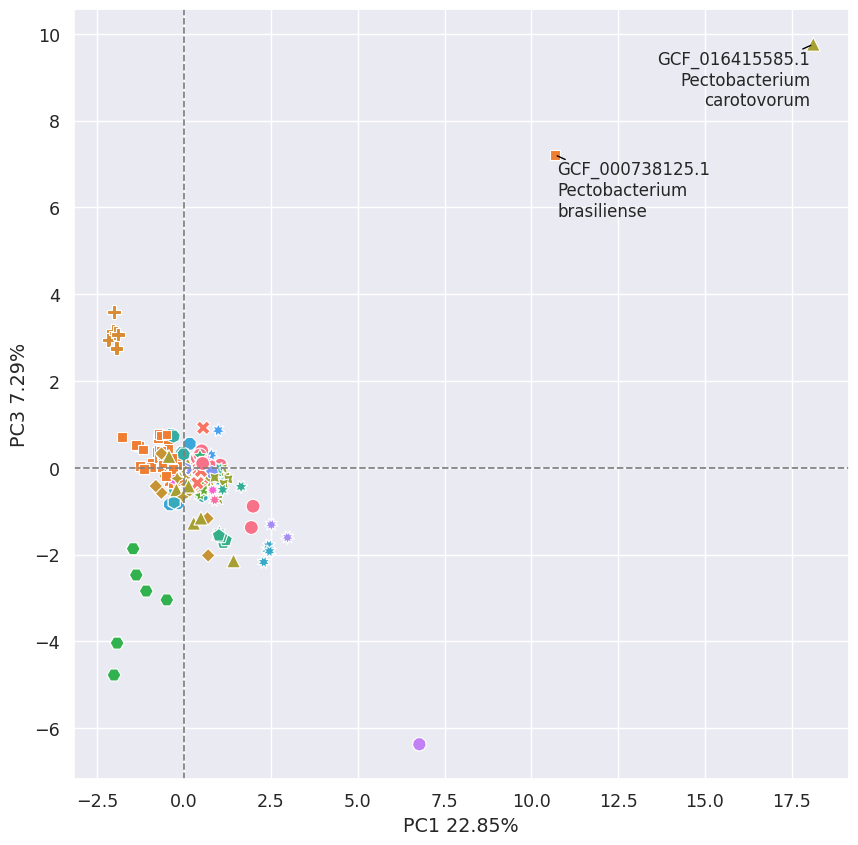

In [175]:
# plot pc 3 vs pc 4 - labelling pectobacterium species that are isolated from the rest of the group
X_pca = e_pca.transform(e_X_scaled)

plt.figure(figsize=(10,10))
sns.set(font_scale=1.15)

e_fam_freq_df_ggs['Species'] = list(e_fam_freq_df['Species'])

g = sns.scatterplot(
    x=X_pca[:,2],  # PC3
    y=X_pca[:,3],  # PC4
    data=e_fam_freq_df_ggs,
    hue='Species',
    style='Species',
    s=100,
    markers=True,
)

g.axhline(0, linestyle='--', color='grey', linewidth=1.25);
g.axvline(0, linestyle='--', color='grey', linewidth=1.25);

plt.ylabel(f"PC3 {100 * e_pca.explained_variance_ratio_[1]:.2f}%");
plt.xlabel(f"PC1 {100 * e_pca.explained_variance_ratio_[0]:.2f}%");
plt.legend([],[], frameon=False);

genome_lbls = ["\n".join(_) for _ in e_fam_freq_df_ggs.index]
x_vals = X_pca[:,2]
y_vals = X_pca[:,3]

texts = [
    plt.text(
        xval,
        yval,
        lbl,
        ha='center',
        va='center',
        fontsize=12,
    ) for (xval, yval, lbl) in zip(
        x_vals, y_vals, genome_lbls
    ) if (xval > 10)
]
adjustText.adjust_text(texts, arrowprops=dict(arrowstyle='-', color='black'));

plt.savefig(
   "../results/ie_cazymes/e_pca/e_pc3_pc4_species.png",
    bbox_inches='tight',
    format='png',
)